In [1]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from glob import glob
from sklearn.model_selection import train_test_split
from torchvision import transforms
from torch.optim.lr_scheduler import CosineAnnealingLR
import matplotlib.pyplot as plt
from tqdm import tqdm

In [2]:
from google.colab import drive
drive.mount('/content/drive')

print(os.path.exists('/content/drive/MyDrive/Copie de PFA_Final'))
print(os.listdir('/content/drive/MyDrive/Copie de PFA_Final'))
print(os.listdir('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/images'))


Mounted at /content/drive
True
['new_data']
['Blast_PCRM_1202182 D5_0.bmp', 'Blast_PCRM_1202182 D5_1.bmp', 'Blast_PCRM_1202182 D5_2.bmp', 'Blast_PCRM_1202182 D5_3.bmp', 'Blast_PCRM_1202182 D5_4.bmp', 'Blast_PCRM_R16-0204A_0.bmp', 'Blast_PCRM_R16-0204A_1.bmp', 'Blast_PCRM_R16-0204A_2.bmp', 'Blast_PCRM_R16-0204A_3.bmp', 'Blast_PCRM_R16-0204A_4.bmp', 'Blast_PCRM_R12-0326b_0.bmp', 'Blast_PCRM_R12-0326b_1.bmp', 'Blast_PCRM_R12-0326b_2.bmp', 'Blast_PCRM_R12-0326b_3.bmp', 'Blast_PCRM_R12-0326b_4.bmp', 'Blast_PCRM_R13-0027_0.bmp', 'Blast_PCRM_R13-0027_1.bmp', 'Blast_PCRM_R13-0027_2.bmp', 'Blast_PCRM_R13-0027_3.bmp', 'Blast_PCRM_R13-0027_4.bmp', 'Blast_PCRM_R14-0374b_0.bmp', 'Blast_PCRM_R14-0374b_1.bmp', 'Blast_PCRM_R14-0374b_2.bmp', 'Blast_PCRM_R14-0374b_3.bmp', 'Blast_PCRM_R14-0374b_4.bmp', 'Blast_PCRM_R16-0274A_0.bmp', 'Blast_PCRM_R16-0274A_1.bmp', 'Blast_PCRM_R16-0274A_2.bmp', 'Blast_PCRM_R16-0274A_3.bmp', 'Blast_PCRM_R16-0274A_4.bmp', 'Blast_PCRM_R12-0358a_0.bmp', 'Blast_PCRM_R12-0358a_1.b

In [3]:
SIZE = 256
BATCH_SIZE = 8
EPOCHS = 100
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
class SegmentationDataset(Dataset):
    def __init__(self, image_paths, mask_paths):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((SIZE, SIZE)),
        ])

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = cv2.imread(self.image_paths[idx])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (SIZE, SIZE)) / 255.0

        mask = cv2.imread(self.mask_paths[idx], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, (SIZE, SIZE)) / 255.0
        mask = np.expand_dims(mask, axis=0)

        image = torch.from_numpy(image).permute(2, 0, 1).float()
        mask = torch.from_numpy(mask).float()

        return image, mask

In [5]:
def get_confusion(y_true, y_pred, threshold=0.5):
    y_pred = (y_pred > threshold).float()
    y_true = y_true.float()

    TP = (y_true * y_pred).sum()
    TN = ((1 - y_true) * (1 - y_pred)).sum()
    FP = ((1 - y_true) * y_pred).sum()
    FN = (y_true * (1 - y_pred)).sum()

    return TP, TN, FP, FN

def dice_score(y_true, y_pred):
    TP, _, FP, FN = get_confusion(y_true, y_pred)
    return (2 * TP + 1e-6) / (2 * TP + FP + FN + 1e-6)

def mean_iou(y_true, y_pred):
    TP, _, FP, FN = get_confusion(y_true, y_pred)
    return (TP + 1e-6) / (TP + FP + FN + 1e-6)

def accuracy(y_true, y_pred):
    TP, TN, FP, FN = get_confusion(y_true, y_pred)
    return (TP + TN + 1e-6) / (TP + TN + FP + FN + 1e-6)

def sensitivity(y_true, y_pred):
    TP, _, _, FN = get_confusion(y_true, y_pred)
    return (TP + 1e-6) / (TP + FN + 1e-6)

def specificity(y_true, y_pred):
    _, TN, FP, _ = get_confusion(y_true, y_pred)
    return (TN + 1e-6) / (TN + FP + 1e-6)

In [10]:
class BCEDiceLoss(nn.Module):
    def __init__(self, lambda1=1, lambda2=1):
        super(BCEDiceLoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
        self.lambda1 = lambda1
        self.lambda2 = lambda2

    def forward(self, outputs, targets):
        bce_loss = self.bce(outputs, targets)
        intersection = (outputs * targets).sum()
        dice_loss = 1 - (2 * intersection + 1) / (outputs.sum() + targets.sum() + 1)
        return self.lambda1 * bce_loss + self.lambda2 * dice_loss

In [6]:
train_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/images/*.bmp'))
train_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/GT_ZP/*.bmp'))
valid_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/valid/images/*.bmp'))
valid_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/valid/GT_ZP/*.bmp'))
test_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/test/images/*.bmp'))
test_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/test/GT_ZP/*.bmp'))

train_dataset = SegmentationDataset(train_x, train_y)
valid_dataset = SegmentationDataset(valid_x, valid_y)
test_dataset  = SegmentationDataset(test_x, test_y)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE)
test_loader  = DataLoader(test_dataset, batch_size=BATCH_SIZE)

print("Training:", len(train_dataset))
print("Validation:", len(valid_dataset))
print("Testing:", len(test_dataset))

Training: 995
Validation: 25
Testing: 25


In [7]:
import torch
from torch import nn
import torch.nn.functional as F

from timm.models.layers import trunc_normal_
import math


class DepthWiseConv2d(nn.Module):
    def __init__(self, dim_in, dim_out, kernel_size=3, padding=1, stride=1, dilation=1):
        super().__init__()

        self.conv1 = nn.Conv2d(dim_in, dim_in, kernel_size=kernel_size, padding=padding,
                      stride=stride, dilation=dilation, groups=dim_in)
        self.norm_layer = nn.GroupNorm(4, dim_in)
        self.conv2 = nn.Conv2d(dim_in, dim_out, kernel_size=1)

    def forward(self, x):
        return self.conv2(self.norm_layer(self.conv1(x)))

class GatedAttentionUnit(nn.Module):
    def __init__(self, in_c, out_c, kernel_size):
        super().__init__()
        self.w1 = nn.Sequential(
            DepthWiseConv2d(in_c, in_c, kernel_size, padding=kernel_size//2),
            nn.Sigmoid()
        )

        self.w2 = nn.Sequential(
            DepthWiseConv2d(in_c, in_c, kernel_size + 2, padding=(kernel_size + 2)//2),
            nn.GELU()
        )
        self.wo = nn.Sequential(
            DepthWiseConv2d(in_c, out_c, kernel_size),
            nn.GELU()
        )

        self.cw = nn.Conv2d(in_c, out_c, 1)

    def forward(self, x):
        x1, x2 = self.w1(x), self.w2(x)
        out = self.wo(x1 * x2) + self.cw(x)
        return out


class DilatedGatedAttention(nn.Module):
    def __init__(self, in_c, out_c, k_size=3, dilated_ratio=[7, 5, 2, 1]):
        super().__init__()

        self.mda0 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[0]-1))//2,
                             dilation=dilated_ratio[0], groups=in_c//4)
        self.mda1 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[1]-1))//2,
                             dilation=dilated_ratio[1], groups=in_c//4)
        self.mda2 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[2]-1))//2,
                             dilation=dilated_ratio[2], groups=in_c//4)
        self.mda3 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[3]-1))//2,
                             dilation=dilated_ratio[3], groups=in_c//4)
        self.norm_layer = nn.GroupNorm(4, in_c)
        self.conv = nn.Conv2d(in_c, in_c, 1)

        self.gau = GatedAttentionUnit(in_c, out_c, 3)

    def forward(self, x):
        x = torch.chunk(x, 4, dim=1)
        x0 = self.mda0(x[0])
        x1 = self.mda1(x[1])
        x2 = self.mda2(x[2])
        x3 = self.mda3(x[3])
        x = F.gelu(self.conv(self.norm_layer(torch.cat((x0, x1, x2, x3), dim=1))))
        x = self.gau(x)
        return x


class EAblock(nn.Module):
    def __init__(self, in_c):
        super().__init__()

        self.conv1 = nn.Conv2d(in_c, in_c, 1)

        self.k = in_c * 4
        self.linear_0 = nn.Conv1d(in_c, self.k, 1, bias=False)

        self.linear_1 = nn.Conv1d(self.k, in_c, 1, bias=False)
        self.linear_1.weight.data = self.linear_0.weight.data.permute(1, 0, 2)

        self.conv2 = nn.Conv2d(in_c, in_c, 1, bias=False)
        self.norm_layer = nn.GroupNorm(4, in_c)

    def forward(self, x):
        idn = x
        x = self.conv1(x)

        b, c, h, w = x.size()
        x = x.view(b, c, h*w)   # b * c * n

        attn = self.linear_0(x) # b, k, n
        attn = F.softmax(attn, dim=-1) # b, k, n

        attn = attn / (1e-9 + attn.sum(dim=1, keepdim=True)) #  # b, k, n
        x = self.linear_1(attn) # b, c, n

        x = x.view(b, c, h, w)
        x = self.norm_layer(self.conv2(x))
        x = x + idn
        x = F.gelu(x)
        return x


class Channel_Att_Bridge(nn.Module):
    def __init__(self, c_list, split_att='fc'):
        super().__init__()
        c_list_sum = sum(c_list) - c_list[-1]
        self.split_att = split_att
        self.avgpool = nn.AdaptiveAvgPool2d(1)
        self.get_all_att = nn.Conv1d(1, 1, kernel_size=3, padding=1, bias=False)
        self.att1 = nn.Linear(c_list_sum, c_list[0]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[0], 1)
        self.att2 = nn.Linear(c_list_sum, c_list[1]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[1], 1)
        self.att3 = nn.Linear(c_list_sum, c_list[2]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[2], 1)
        self.att4 = nn.Linear(c_list_sum, c_list[3]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[3], 1)
        self.att5 = nn.Linear(c_list_sum, c_list[4]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[4], 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, t1, t2, t3, t4, t5):
        att = torch.cat((self.avgpool(t1),
                         self.avgpool(t2),
                         self.avgpool(t3),
                         self.avgpool(t4),
                         self.avgpool(t5)), dim=1)
        att = self.get_all_att(att.squeeze(-1).transpose(-1, -2))
        if self.split_att != 'fc':
            att = att.transpose(-1, -2)
        att1 = self.sigmoid(self.att1(att))
        att2 = self.sigmoid(self.att2(att))
        att3 = self.sigmoid(self.att3(att))
        att4 = self.sigmoid(self.att4(att))
        att5 = self.sigmoid(self.att5(att))
        if self.split_att == 'fc':
            att1 = att1.transpose(-1, -2).unsqueeze(-1).expand_as(t1)
            att2 = att2.transpose(-1, -2).unsqueeze(-1).expand_as(t2)
            att3 = att3.transpose(-1, -2).unsqueeze(-1).expand_as(t3)
            att4 = att4.transpose(-1, -2).unsqueeze(-1).expand_as(t4)
            att5 = att5.transpose(-1, -2).unsqueeze(-1).expand_as(t5)
        else:
            att1 = att1.unsqueeze(-1).expand_as(t1)
            att2 = att2.unsqueeze(-1).expand_as(t2)
            att3 = att3.unsqueeze(-1).expand_as(t3)
            att4 = att4.unsqueeze(-1).expand_as(t4)
            att5 = att5.unsqueeze(-1).expand_as(t5)

        return att1, att2, att3, att4, att5


class Spatial_Att_Bridge(nn.Module):
    def __init__(self):
        super().__init__()
        self.shared_conv2d = nn.Sequential(nn.Conv2d(2, 1, 7, stride=1, padding=9, dilation=3),
                                          nn.Sigmoid())

    def forward(self, t1, t2, t3, t4, t5):
        t_list = [t1, t2, t3, t4, t5]
        att_list = []
        for t in t_list:
            avg_out = torch.mean(t, dim=1, keepdim=True)
            max_out, _ = torch.max(t, dim=1, keepdim=True)
            att = torch.cat([avg_out, max_out], dim=1)
            att = self.shared_conv2d(att)
            att_list.append(att)
        return att_list[0], att_list[1], att_list[2], att_list[3], att_list[4]


class SC_Att_Bridge(nn.Module):
    def __init__(self, c_list, split_att='fc'):
        super().__init__()

        self.catt = Channel_Att_Bridge(c_list, split_att=split_att)
        self.satt = Spatial_Att_Bridge()

    def forward(self, t1, t2, t3, t4, t5):
        r1, r2, r3, r4, r5 = t1, t2, t3, t4, t5

        satt1, satt2, satt3, satt4, satt5 = self.satt(t1, t2, t3, t4, t5)
        t1, t2, t3, t4, t5 = satt1 * t1, satt2 * t2, satt3 * t3, satt4 * t4, satt5 * t5

        r1_, r2_, r3_, r4_, r5_ = t1, t2, t3, t4, t5
        t1, t2, t3, t4, t5 = t1 + r1, t2 + r2, t3 + r3, t4 + r4, t5 + r5

        catt1, catt2, catt3, catt4, catt5 = self.catt(t1, t2, t3, t4, t5)
        t1, t2, t3, t4, t5 = catt1 * t1, catt2 * t2, catt3 * t3, catt4 * t4, catt5 * t5

        return t1 + r1_, t2 + r2_, t3 + r3_, t4 + r4_, t5 + r5_


class MALUNet(nn.Module):

    def __init__(self, num_classes=1, input_channels=3, c_list=[8,16,24,32,48,64],
                split_att='fc', bridge=True):
        super().__init__()

        self.bridge = bridge

        self.encoder1 = nn.Sequential(
            nn.Conv2d(input_channels, c_list[0], 3, stride=1, padding=1),
        )
        self.encoder2 =nn.Sequential(
            nn.Conv2d(c_list[0], c_list[1], 3, stride=1, padding=1),
        )
        self.encoder3 = nn.Sequential(
            nn.Conv2d(c_list[1], c_list[2], 3, stride=1, padding=1),
        )
        self.encoder4 = nn.Sequential(
            EAblock(c_list[2]),
            DilatedGatedAttention(c_list[2], c_list[3]),
        )
        self.encoder5 = nn.Sequential(
            EAblock(c_list[3]),
            DilatedGatedAttention(c_list[3], c_list[4]),
        )
        self.encoder6 = nn.Sequential(
            EAblock(c_list[4]),
            DilatedGatedAttention(c_list[4], c_list[5]),
        )

        if bridge:
            self.scab = SC_Att_Bridge(c_list, split_att)
            print('SC_Att_Bridge was used')

        self.decoder1 = nn.Sequential(
            DilatedGatedAttention(c_list[5], c_list[4]),
            EAblock(c_list[4]),
        )
        self.decoder2 = nn.Sequential(
            DilatedGatedAttention(c_list[4], c_list[3]),
            EAblock(c_list[3]),
        )
        self.decoder3 = nn.Sequential(
            DilatedGatedAttention(c_list[3], c_list[2]),
            EAblock(c_list[2]),
        )
        self.decoder4 = nn.Sequential(
            nn.Conv2d(c_list[2], c_list[1], 3, stride=1, padding=1),
        )
        self.decoder5 = nn.Sequential(
            nn.Conv2d(c_list[1], c_list[0], 3, stride=1, padding=1),
        )
        self.ebn1 = nn.GroupNorm(4, c_list[0])
        self.ebn2 = nn.GroupNorm(4, c_list[1])
        self.ebn3 = nn.GroupNorm(4, c_list[2])
        self.ebn4 = nn.GroupNorm(4, c_list[3])
        self.ebn5 = nn.GroupNorm(4, c_list[4])
        self.dbn1 = nn.GroupNorm(4, c_list[4])
        self.dbn2 = nn.GroupNorm(4, c_list[3])
        self.dbn3 = nn.GroupNorm(4, c_list[2])
        self.dbn4 = nn.GroupNorm(4, c_list[1])
        self.dbn5 = nn.GroupNorm(4, c_list[0])

        self.final = nn.Conv2d(c_list[0], num_classes, kernel_size=1)

        self.apply(self._init_weights)

    def _init_weights(self, m):
        if isinstance(m, nn.Linear):
            trunc_normal_(m.weight, std=.02)
            if isinstance(m, nn.Linear) and m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Conv1d):
                n = m.kernel_size[0] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
        elif isinstance(m, nn.Conv2d):
            fan_out = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
            fan_out //= m.groups
            m.weight.data.normal_(0, math.sqrt(2.0 / fan_out))
            if m.bias is not None:
                m.bias.data.zero_()

    def forward(self, x):

        out = F.gelu(F.max_pool2d(self.ebn1(self.encoder1(x)),2,2))
        t1 = out # b, c0, H/2, W/2

        out = F.gelu(F.max_pool2d(self.ebn2(self.encoder2(out)),2,2))
        t2 = out # b, c1, H/4, W/4

        out = F.gelu(F.max_pool2d(self.ebn3(self.encoder3(out)),2,2))
        t3 = out # b, c2, H/8, W/8

        out = F.gelu(F.max_pool2d(self.ebn4(self.encoder4(out)),2,2))
        t4 = out # b, c3, H/16, W/16

        out = F.gelu(F.max_pool2d(self.ebn5(self.encoder5(out)),2,2))
        t5 = out # b, c4, H/32, W/32

        if self.bridge: t1, t2, t3, t4, t5 = self.scab(t1, t2, t3, t4, t5)

        out = F.gelu(self.encoder6(out)) # b, c5, H/32, W/32

        out5 = F.gelu(self.dbn1(self.decoder1(out))) # b, c4, H/32, W/32
        out5 = torch.add(out5, t5) # b, c4, H/32, W/32

        out4 = F.gelu(F.interpolate(self.dbn2(self.decoder2(out5)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c3, H/16, W/16
        out4 = torch.add(out4, t4) # b, c3, H/16, W/16

        out3 = F.gelu(F.interpolate(self.dbn3(self.decoder3(out4)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c2, H/8, W/8
        out3 = torch.add(out3, t3) # b, c2, H/8, W/8

        out2 = F.gelu(F.interpolate(self.dbn4(self.decoder4(out3)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c1, H/4, W/4
        out2 = torch.add(out2, t2) # b, c1, H/4, W/4

        out1 = F.gelu(F.interpolate(self.dbn5(self.decoder5(out2)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c0, H/2, W/2
        out1 = torch.add(out1, t1) # b, c0, H/2, W/2

        out0 = F.interpolate(self.final(out1),scale_factor=(2,2),mode ='bilinear',align_corners=True) # b, num_class, H, W

        return torch.sigmoid(out0)

/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


In [8]:
model = MALUNet().to(DEVICE)

optimizer = optim.AdamW(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=50, eta_min=0.00001)

SC_Att_Bridge was used


In [ ]:
# Training loop with evaluation metrics
for epoch in range(EPOCHS):
    model.train()
    total_loss = 0
    for images, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}"):
        images, masks = images.to(DEVICE), masks.to(DEVICE)

        optimizer.zero_grad()
        preds = model(images)  # Model already applies sigmoid in the output

        loss = BCEDiceLoss()(preds, masks)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    scheduler.step()

    # Validation phase
    model.eval()
    with torch.no_grad():
        val_dice = []
        val_miou = []
        val_accuracy = []
        val_sensitivity = []
        val_specificity = []

        for images, masks in valid_loader:
            images, masks = images.to(DEVICE), masks.to(DEVICE)
            preds = model(images)  # Model already applies sigmoid in the output

            # Compute confusion matrix for the predictions
            TP, TN, FP, FN = get_confusion(masks, preds)

            # Compute evaluation metrics
            val_dice.append(dice_score(masks, preds).item())
            val_miou.append(mean_iou(masks, preds).item())
            val_accuracy.append(accuracy(masks, preds).item())
            val_sensitivity.append(sensitivity(masks, preds).item())
            val_specificity.append(specificity(masks, preds).item())

        # Print out the evaluation metrics for the current epoch
        print(f"Epoch {epoch+1}: Loss = {total_loss:.4f}, "
              f"Val Dice = {np.mean(val_dice):.4f}, "
              f"Val mIoU = {np.mean(val_miou):.4f}, "
              f"Val Accuracy = {np.mean(val_accuracy):.4f}, "
              f"Val Sensitivity = {np.mean(val_sensitivity):.4f}, "
              f"Val Specificity = {np.mean(val_specificity):.4f}")

Epoch 1/100: 100%|██████████| 125/125 [12:51<00:00,  6.17s/it]


Epoch 1: Loss = 133.3565, Val Dice = 0.7884, Val mIoU = 0.6527, Val Accuracy = 0.9385, Val Sensitivity = 0.8532, Val Specificity = 0.9547


Epoch 2/100: 100%|██████████| 125/125 [01:31<00:00,  1.36it/s]


Epoch 2: Loss = 113.6530, Val Dice = 0.8169, Val mIoU = 0.6913, Val Accuracy = 0.9450, Val Sensitivity = 0.9036, Val Specificity = 0.9527


Epoch 3/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 3: Loss = 109.7192, Val Dice = 0.8304, Val mIoU = 0.7108, Val Accuracy = 0.9517, Val Sensitivity = 0.8660, Val Specificity = 0.9675


Epoch 4/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 4: Loss = 107.1578, Val Dice = 0.8277, Val mIoU = 0.7075, Val Accuracy = 0.9508, Val Sensitivity = 0.8765, Val Specificity = 0.9626


Epoch 5/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 5: Loss = 105.3458, Val Dice = 0.7967, Val mIoU = 0.6664, Val Accuracy = 0.9499, Val Sensitivity = 0.7522, Val Specificity = 0.9800


Epoch 6/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 6: Loss = 104.3195, Val Dice = 0.8330, Val mIoU = 0.7145, Val Accuracy = 0.9517, Val Sensitivity = 0.8812, Val Specificity = 0.9634


Epoch 7/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 7: Loss = 103.1043, Val Dice = 0.8236, Val mIoU = 0.7012, Val Accuracy = 0.9535, Val Sensitivity = 0.8034, Val Specificity = 0.9766


Epoch 8/100: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 8: Loss = 101.9849, Val Dice = 0.8400, Val mIoU = 0.7258, Val Accuracy = 0.9557, Val Sensitivity = 0.8672, Val Specificity = 0.9695


Epoch 9/100: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 9: Loss = 100.4194, Val Dice = 0.8244, Val mIoU = 0.7032, Val Accuracy = 0.9525, Val Sensitivity = 0.8355, Val Specificity = 0.9709


Epoch 10/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 10: Loss = 99.1717, Val Dice = 0.8398, Val mIoU = 0.7251, Val Accuracy = 0.9547, Val Sensitivity = 0.8777, Val Specificity = 0.9668


Epoch 11/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 11: Loss = 98.1469, Val Dice = 0.8406, Val mIoU = 0.7266, Val Accuracy = 0.9568, Val Sensitivity = 0.8473, Val Specificity = 0.9735


Epoch 12/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 12: Loss = 97.3116, Val Dice = 0.8485, Val mIoU = 0.7383, Val Accuracy = 0.9576, Val Sensitivity = 0.8803, Val Specificity = 0.9691


Epoch 13/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 13: Loss = 96.8031, Val Dice = 0.8359, Val mIoU = 0.7204, Val Accuracy = 0.9542, Val Sensitivity = 0.8796, Val Specificity = 0.9648


Epoch 14/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 14: Loss = 96.0605, Val Dice = 0.8504, Val mIoU = 0.7408, Val Accuracy = 0.9585, Val Sensitivity = 0.8677, Val Specificity = 0.9720


Epoch 15/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 15: Loss = 95.1906, Val Dice = 0.8497, Val mIoU = 0.7397, Val Accuracy = 0.9579, Val Sensitivity = 0.8798, Val Specificity = 0.9704


Epoch 16/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 16: Loss = 94.6353, Val Dice = 0.8517, Val mIoU = 0.7427, Val Accuracy = 0.9592, Val Sensitivity = 0.8627, Val Specificity = 0.9742


Epoch 17/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 17: Loss = 94.2916, Val Dice = 0.8568, Val mIoU = 0.7510, Val Accuracy = 0.9614, Val Sensitivity = 0.8606, Val Specificity = 0.9765


Epoch 18/100: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 18: Loss = 93.8596, Val Dice = 0.8573, Val mIoU = 0.7514, Val Accuracy = 0.9609, Val Sensitivity = 0.8663, Val Specificity = 0.9755


Epoch 19/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 19: Loss = 93.2270, Val Dice = 0.8443, Val mIoU = 0.7319, Val Accuracy = 0.9564, Val Sensitivity = 0.8746, Val Specificity = 0.9684


Epoch 20/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 20: Loss = 92.7725, Val Dice = 0.8439, Val mIoU = 0.7324, Val Accuracy = 0.9588, Val Sensitivity = 0.8426, Val Specificity = 0.9759


Epoch 21/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 21: Loss = 92.3007, Val Dice = 0.8612, Val mIoU = 0.7565, Val Accuracy = 0.9613, Val Sensitivity = 0.8657, Val Specificity = 0.9768


Epoch 22/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 22: Loss = 91.9332, Val Dice = 0.8510, Val mIoU = 0.7418, Val Accuracy = 0.9595, Val Sensitivity = 0.8516, Val Specificity = 0.9763


Epoch 23/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 23: Loss = 91.6067, Val Dice = 0.8545, Val mIoU = 0.7469, Val Accuracy = 0.9606, Val Sensitivity = 0.8500, Val Specificity = 0.9781


Epoch 24/100: 100%|██████████| 125/125 [01:30<00:00,  1.37it/s]


Epoch 24: Loss = 91.1619, Val Dice = 0.8421, Val mIoU = 0.7292, Val Accuracy = 0.9591, Val Sensitivity = 0.8207, Val Specificity = 0.9800


Epoch 25/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 25: Loss = 90.7813, Val Dice = 0.8492, Val mIoU = 0.7396, Val Accuracy = 0.9572, Val Sensitivity = 0.9005, Val Specificity = 0.9660


Epoch 26/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 26: Loss = 90.5723, Val Dice = 0.8511, Val mIoU = 0.7423, Val Accuracy = 0.9598, Val Sensitivity = 0.8527, Val Specificity = 0.9761


Epoch 27/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 27: Loss = 90.3301, Val Dice = 0.8565, Val mIoU = 0.7496, Val Accuracy = 0.9611, Val Sensitivity = 0.8457, Val Specificity = 0.9792


Epoch 28/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 28: Loss = 89.7528, Val Dice = 0.8483, Val mIoU = 0.7380, Val Accuracy = 0.9593, Val Sensitivity = 0.8429, Val Specificity = 0.9768


Epoch 29/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 29: Loss = 89.4135, Val Dice = 0.8538, Val mIoU = 0.7458, Val Accuracy = 0.9606, Val Sensitivity = 0.8479, Val Specificity = 0.9779


Epoch 30/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 30: Loss = 89.0459, Val Dice = 0.8564, Val mIoU = 0.7498, Val Accuracy = 0.9610, Val Sensitivity = 0.8540, Val Specificity = 0.9776


Epoch 31/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 31: Loss = 88.7130, Val Dice = 0.8546, Val mIoU = 0.7472, Val Accuracy = 0.9603, Val Sensitivity = 0.8605, Val Specificity = 0.9761


Epoch 32/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 32: Loss = 88.3920, Val Dice = 0.8444, Val mIoU = 0.7326, Val Accuracy = 0.9586, Val Sensitivity = 0.8410, Val Specificity = 0.9764


Epoch 33/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 33: Loss = 88.0236, Val Dice = 0.8476, Val mIoU = 0.7373, Val Accuracy = 0.9592, Val Sensitivity = 0.8478, Val Specificity = 0.9761


Epoch 34/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 34: Loss = 87.8290, Val Dice = 0.8475, Val mIoU = 0.7369, Val Accuracy = 0.9596, Val Sensitivity = 0.8362, Val Specificity = 0.9784


Epoch 35/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 35: Loss = 87.6101, Val Dice = 0.8477, Val mIoU = 0.7373, Val Accuracy = 0.9594, Val Sensitivity = 0.8433, Val Specificity = 0.9772


Epoch 36/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 36: Loss = 87.3211, Val Dice = 0.8510, Val mIoU = 0.7419, Val Accuracy = 0.9591, Val Sensitivity = 0.8636, Val Specificity = 0.9738


Epoch 37/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 37: Loss = 87.1442, Val Dice = 0.8500, Val mIoU = 0.7401, Val Accuracy = 0.9596, Val Sensitivity = 0.8451, Val Specificity = 0.9777


Epoch 38/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 38: Loss = 86.9891, Val Dice = 0.8505, Val mIoU = 0.7411, Val Accuracy = 0.9596, Val Sensitivity = 0.8512, Val Specificity = 0.9764


Epoch 39/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 39: Loss = 86.7532, Val Dice = 0.8454, Val mIoU = 0.7339, Val Accuracy = 0.9586, Val Sensitivity = 0.8437, Val Specificity = 0.9762


Epoch 40/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 40: Loss = 86.5650, Val Dice = 0.8429, Val mIoU = 0.7303, Val Accuracy = 0.9580, Val Sensitivity = 0.8428, Val Specificity = 0.9757


Epoch 41/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 41: Loss = 86.3990, Val Dice = 0.8424, Val mIoU = 0.7294, Val Accuracy = 0.9581, Val Sensitivity = 0.8360, Val Specificity = 0.9770


Epoch 42/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 42: Loss = 86.2117, Val Dice = 0.8414, Val mIoU = 0.7281, Val Accuracy = 0.9579, Val Sensitivity = 0.8371, Val Specificity = 0.9763


Epoch 43/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 43: Loss = 86.2037, Val Dice = 0.8405, Val mIoU = 0.7268, Val Accuracy = 0.9577, Val Sensitivity = 0.8362, Val Specificity = 0.9762


Epoch 44/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 44: Loss = 86.1166, Val Dice = 0.8424, Val mIoU = 0.7294, Val Accuracy = 0.9580, Val Sensitivity = 0.8361, Val Specificity = 0.9768


Epoch 45/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 45: Loss = 86.0488, Val Dice = 0.8415, Val mIoU = 0.7281, Val Accuracy = 0.9578, Val Sensitivity = 0.8354, Val Specificity = 0.9767


Epoch 46/100: 100%|██████████| 125/125 [01:28<00:00,  1.40it/s]


Epoch 46: Loss = 86.0089, Val Dice = 0.8413, Val mIoU = 0.7279, Val Accuracy = 0.9579, Val Sensitivity = 0.8344, Val Specificity = 0.9768


Epoch 47/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 47: Loss = 85.9904, Val Dice = 0.8407, Val mIoU = 0.7270, Val Accuracy = 0.9578, Val Sensitivity = 0.8330, Val Specificity = 0.9769


Epoch 48/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 48: Loss = 85.9211, Val Dice = 0.8409, Val mIoU = 0.7273, Val Accuracy = 0.9577, Val Sensitivity = 0.8344, Val Specificity = 0.9766


Epoch 49/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 49: Loss = 85.9497, Val Dice = 0.8406, Val mIoU = 0.7268, Val Accuracy = 0.9577, Val Sensitivity = 0.8344, Val Specificity = 0.9765


Epoch 50/100: 100%|██████████| 125/125 [01:28<00:00,  1.42it/s]


Epoch 50: Loss = 85.8793, Val Dice = 0.8404, Val mIoU = 0.7265, Val Accuracy = 0.9577, Val Sensitivity = 0.8331, Val Specificity = 0.9767


Epoch 51/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 51: Loss = 85.8850, Val Dice = 0.8403, Val mIoU = 0.7264, Val Accuracy = 0.9576, Val Sensitivity = 0.8331, Val Specificity = 0.9767


Epoch 52/100: 100%|██████████| 125/125 [01:28<00:00,  1.42it/s]


Epoch 52: Loss = 85.8527, Val Dice = 0.8399, Val mIoU = 0.7259, Val Accuracy = 0.9576, Val Sensitivity = 0.8316, Val Specificity = 0.9769


Epoch 53/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 53: Loss = 85.8679, Val Dice = 0.8399, Val mIoU = 0.7258, Val Accuracy = 0.9576, Val Sensitivity = 0.8319, Val Specificity = 0.9768


Epoch 54/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 54: Loss = 85.8852, Val Dice = 0.8396, Val mIoU = 0.7254, Val Accuracy = 0.9575, Val Sensitivity = 0.8322, Val Specificity = 0.9766


Epoch 55/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 55: Loss = 85.9067, Val Dice = 0.8396, Val mIoU = 0.7255, Val Accuracy = 0.9575, Val Sensitivity = 0.8326, Val Specificity = 0.9765


Epoch 56/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 56: Loss = 85.8438, Val Dice = 0.8389, Val mIoU = 0.7245, Val Accuracy = 0.9573, Val Sensitivity = 0.8335, Val Specificity = 0.9762


Epoch 57/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 57: Loss = 85.8941, Val Dice = 0.8387, Val mIoU = 0.7241, Val Accuracy = 0.9572, Val Sensitivity = 0.8330, Val Specificity = 0.9762


Epoch 58/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 58: Loss = 85.8084, Val Dice = 0.8389, Val mIoU = 0.7243, Val Accuracy = 0.9573, Val Sensitivity = 0.8300, Val Specificity = 0.9768


Epoch 59/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 59: Loss = 85.8317, Val Dice = 0.8376, Val mIoU = 0.7225, Val Accuracy = 0.9571, Val Sensitivity = 0.8289, Val Specificity = 0.9767


Epoch 60/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 60: Loss = 85.8629, Val Dice = 0.8351, Val mIoU = 0.7191, Val Accuracy = 0.9567, Val Sensitivity = 0.8232, Val Specificity = 0.9770


Epoch 61/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 61: Loss = 86.0730, Val Dice = 0.8349, Val mIoU = 0.7189, Val Accuracy = 0.9567, Val Sensitivity = 0.8256, Val Specificity = 0.9766


Epoch 62/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 62: Loss = 86.2330, Val Dice = 0.8368, Val mIoU = 0.7211, Val Accuracy = 0.9569, Val Sensitivity = 0.8237, Val Specificity = 0.9774


Epoch 63/100: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


Epoch 63: Loss = 86.3701, Val Dice = 0.8391, Val mIoU = 0.7250, Val Accuracy = 0.9571, Val Sensitivity = 0.8408, Val Specificity = 0.9749


Epoch 64/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 64: Loss = 86.5358, Val Dice = 0.8346, Val mIoU = 0.7186, Val Accuracy = 0.9568, Val Sensitivity = 0.8223, Val Specificity = 0.9770


Epoch 65/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 65: Loss = 86.5797, Val Dice = 0.8348, Val mIoU = 0.7185, Val Accuracy = 0.9566, Val Sensitivity = 0.8235, Val Specificity = 0.9769


Epoch 66/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 66: Loss = 86.5646, Val Dice = 0.8349, Val mIoU = 0.7181, Val Accuracy = 0.9568, Val Sensitivity = 0.8123, Val Specificity = 0.9789


Epoch 67/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 67: Loss = 86.8123, Val Dice = 0.8455, Val mIoU = 0.7333, Val Accuracy = 0.9578, Val Sensitivity = 0.8478, Val Specificity = 0.9751


Epoch 68/100: 100%|██████████| 125/125 [01:27<00:00,  1.42it/s]


Epoch 68: Loss = 86.9897, Val Dice = 0.8371, Val mIoU = 0.7214, Val Accuracy = 0.9559, Val Sensitivity = 0.8446, Val Specificity = 0.9727


Epoch 69/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 69: Loss = 87.1877, Val Dice = 0.8426, Val mIoU = 0.7290, Val Accuracy = 0.9575, Val Sensitivity = 0.8349, Val Specificity = 0.9762


Epoch 70/100: 100%|██████████| 125/125 [01:28<00:00,  1.42it/s]


Epoch 70: Loss = 87.3307, Val Dice = 0.8481, Val mIoU = 0.7371, Val Accuracy = 0.9586, Val Sensitivity = 0.8513, Val Specificity = 0.9756


Epoch 71/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 71: Loss = 87.2531, Val Dice = 0.8363, Val mIoU = 0.7200, Val Accuracy = 0.9568, Val Sensitivity = 0.8179, Val Specificity = 0.9785


Epoch 72/100: 100%|██████████| 125/125 [01:27<00:00,  1.43it/s]


Epoch 72: Loss = 87.4352, Val Dice = 0.8444, Val mIoU = 0.7318, Val Accuracy = 0.9572, Val Sensitivity = 0.8523, Val Specificity = 0.9735


Epoch 73/100: 100%|██████████| 125/125 [01:28<00:00,  1.40it/s]


Epoch 73: Loss = 87.4621, Val Dice = 0.8377, Val mIoU = 0.7230, Val Accuracy = 0.9564, Val Sensitivity = 0.8439, Val Specificity = 0.9732


Epoch 74/100: 100%|██████████| 125/125 [01:27<00:00,  1.42it/s]


Epoch 74: Loss = 87.6822, Val Dice = 0.8333, Val mIoU = 0.7157, Val Accuracy = 0.9567, Val Sensitivity = 0.8051, Val Specificity = 0.9798


Epoch 75/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 75: Loss = 88.0061, Val Dice = 0.8414, Val mIoU = 0.7288, Val Accuracy = 0.9566, Val Sensitivity = 0.8667, Val Specificity = 0.9708


Epoch 76/100: 100%|██████████| 125/125 [01:27<00:00,  1.42it/s]


Epoch 76: Loss = 87.8347, Val Dice = 0.8417, Val mIoU = 0.7281, Val Accuracy = 0.9583, Val Sensitivity = 0.8247, Val Specificity = 0.9786


Epoch 77/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 77: Loss = 87.9710, Val Dice = 0.8467, Val mIoU = 0.7355, Val Accuracy = 0.9586, Val Sensitivity = 0.8455, Val Specificity = 0.9757


Epoch 78/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 78: Loss = 88.2225, Val Dice = 0.8486, Val mIoU = 0.7384, Val Accuracy = 0.9582, Val Sensitivity = 0.8641, Val Specificity = 0.9728


Epoch 79/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 79: Loss = 88.1896, Val Dice = 0.8427, Val mIoU = 0.7301, Val Accuracy = 0.9581, Val Sensitivity = 0.8353, Val Specificity = 0.9763


Epoch 80/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 80: Loss = 88.7616, Val Dice = 0.8499, Val mIoU = 0.7400, Val Accuracy = 0.9581, Val Sensitivity = 0.8668, Val Specificity = 0.9722


Epoch 81/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 81: Loss = 88.8040, Val Dice = 0.8348, Val mIoU = 0.7192, Val Accuracy = 0.9551, Val Sensitivity = 0.8557, Val Specificity = 0.9703


Epoch 82/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 82: Loss = 88.8549, Val Dice = 0.8342, Val mIoU = 0.7182, Val Accuracy = 0.9564, Val Sensitivity = 0.8265, Val Specificity = 0.9762


Epoch 83/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 83: Loss = 88.5349, Val Dice = 0.8437, Val mIoU = 0.7311, Val Accuracy = 0.9578, Val Sensitivity = 0.8441, Val Specificity = 0.9756


Epoch 84/100: 100%|██████████| 125/125 [01:28<00:00,  1.42it/s]


Epoch 84: Loss = 88.5020, Val Dice = 0.8406, Val mIoU = 0.7267, Val Accuracy = 0.9588, Val Sensitivity = 0.8075, Val Specificity = 0.9815


Epoch 85/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 85: Loss = 89.0262, Val Dice = 0.8511, Val mIoU = 0.7414, Val Accuracy = 0.9588, Val Sensitivity = 0.8593, Val Specificity = 0.9749


Epoch 86/100: 100%|██████████| 125/125 [01:27<00:00,  1.42it/s]


Epoch 86: Loss = 89.3638, Val Dice = 0.8454, Val mIoU = 0.7341, Val Accuracy = 0.9585, Val Sensitivity = 0.8488, Val Specificity = 0.9744


Epoch 87/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 87: Loss = 89.3131, Val Dice = 0.8325, Val mIoU = 0.7174, Val Accuracy = 0.9562, Val Sensitivity = 0.8320, Val Specificity = 0.9746


Epoch 88/100: 100%|██████████| 125/125 [01:27<00:00,  1.43it/s]


Epoch 88: Loss = 89.2004, Val Dice = 0.8440, Val mIoU = 0.7318, Val Accuracy = 0.9582, Val Sensitivity = 0.8361, Val Specificity = 0.9769


Epoch 89/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 89: Loss = 88.9747, Val Dice = 0.8600, Val mIoU = 0.7548, Val Accuracy = 0.9616, Val Sensitivity = 0.8484, Val Specificity = 0.9795


Epoch 90/100: 100%|██████████| 125/125 [01:27<00:00,  1.43it/s]


Epoch 90: Loss = 89.0901, Val Dice = 0.8345, Val mIoU = 0.7189, Val Accuracy = 0.9555, Val Sensitivity = 0.8474, Val Specificity = 0.9720


Epoch 91/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 91: Loss = 89.5802, Val Dice = 0.8499, Val mIoU = 0.7400, Val Accuracy = 0.9597, Val Sensitivity = 0.8355, Val Specificity = 0.9785


Epoch 92/100: 100%|██████████| 125/125 [01:27<00:00,  1.43it/s]


Epoch 92: Loss = 89.4820, Val Dice = 0.8442, Val mIoU = 0.7321, Val Accuracy = 0.9577, Val Sensitivity = 0.8493, Val Specificity = 0.9746


Epoch 93/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 93: Loss = 89.6999, Val Dice = 0.8515, Val mIoU = 0.7422, Val Accuracy = 0.9596, Val Sensitivity = 0.8461, Val Specificity = 0.9774


Epoch 94/100: 100%|██████████| 125/125 [01:28<00:00,  1.42it/s]


Epoch 94: Loss = 89.3567, Val Dice = 0.8492, Val mIoU = 0.7386, Val Accuracy = 0.9584, Val Sensitivity = 0.8467, Val Specificity = 0.9757


Epoch 95/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 95: Loss = 89.1633, Val Dice = 0.8363, Val mIoU = 0.7203, Val Accuracy = 0.9568, Val Sensitivity = 0.8188, Val Specificity = 0.9784


Epoch 96/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 96: Loss = 89.2445, Val Dice = 0.8402, Val mIoU = 0.7256, Val Accuracy = 0.9584, Val Sensitivity = 0.8077, Val Specificity = 0.9815


Epoch 97/100: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 97: Loss = 89.4439, Val Dice = 0.8605, Val mIoU = 0.7556, Val Accuracy = 0.9619, Val Sensitivity = 0.8533, Val Specificity = 0.9790


Epoch 98/100: 100%|██████████| 125/125 [01:28<00:00,  1.42it/s]


Epoch 98: Loss = 89.0579, Val Dice = 0.8404, Val mIoU = 0.7276, Val Accuracy = 0.9581, Val Sensitivity = 0.8302, Val Specificity = 0.9779


Epoch 99/100: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 99: Loss = 88.9951, Val Dice = 0.8347, Val mIoU = 0.7183, Val Accuracy = 0.9573, Val Sensitivity = 0.8052, Val Specificity = 0.9798


Epoch 100/100: 100%|██████████| 125/125 [01:28<00:00,  1.42it/s]


Epoch 100: Loss = 89.0992, Val Dice = 0.8467, Val mIoU = 0.7360, Val Accuracy = 0.9592, Val Sensitivity = 0.8386, Val Specificity = 0.9772


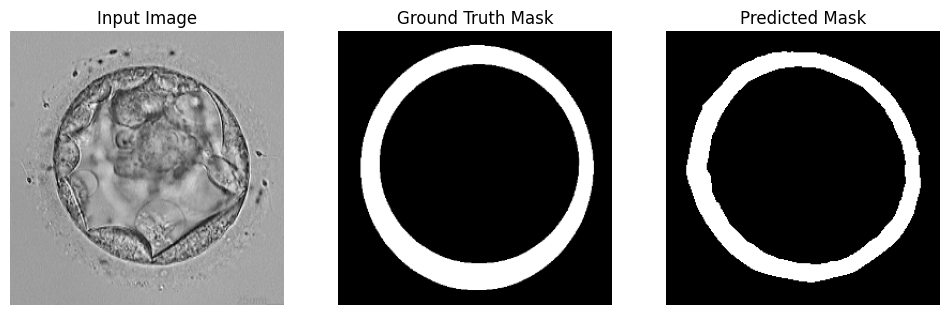

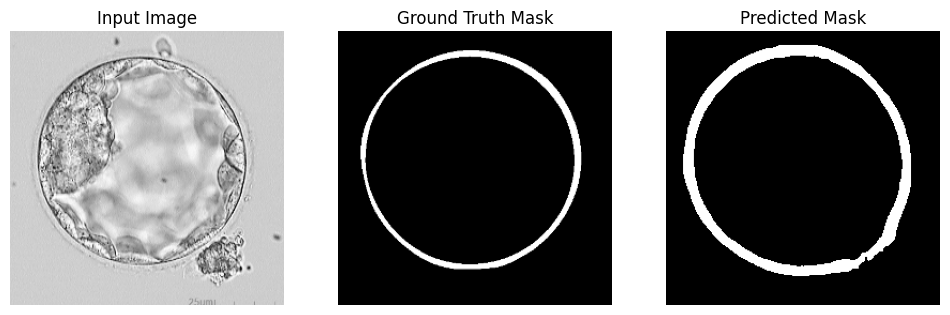

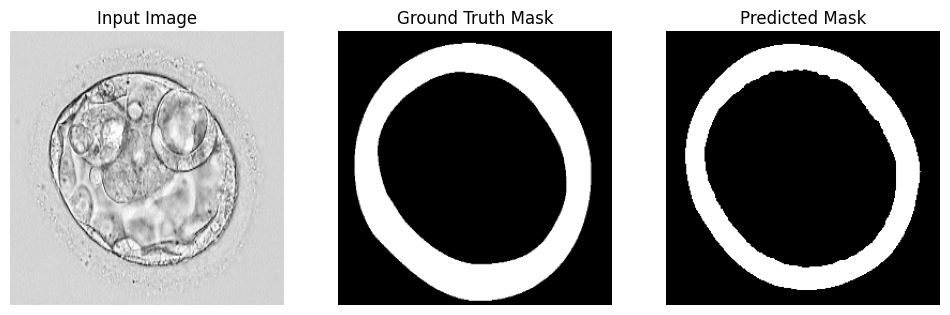

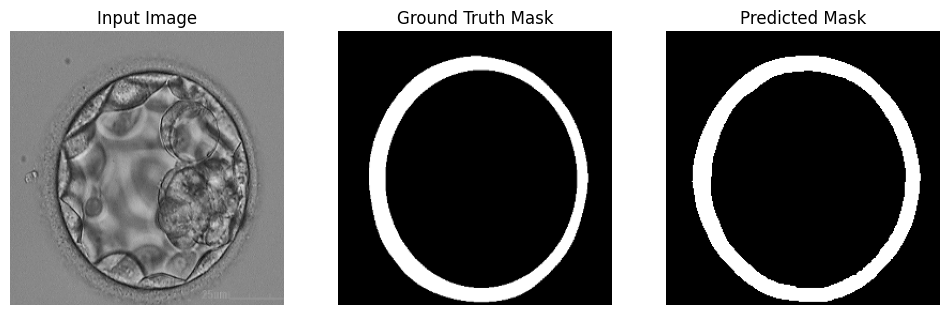

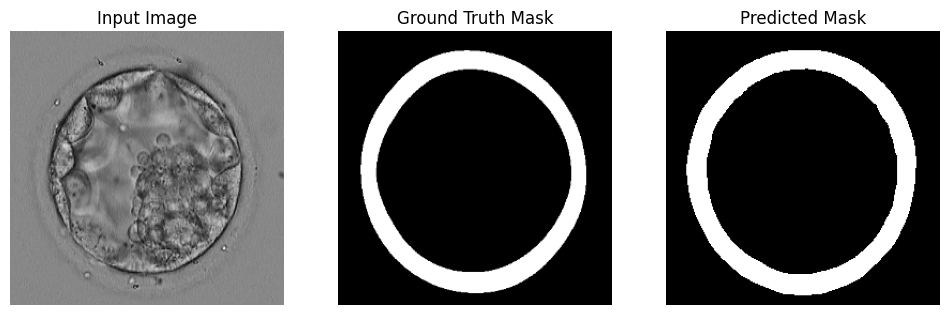

In [ ]:
import matplotlib.pyplot as plt

def visualize_predictions(model, dataloader, device, num_samples=5, threshold=0.5):
    model.eval()
    images_shown = 0

    with torch.no_grad():
        for images, masks in dataloader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)

            for i in range(images.size(0)):
                if images_shown >= num_samples:
                    return

                image = images[i].cpu().numpy()
                image = image.transpose(1, 2, 0)
                gt_mask = masks[i].cpu().squeeze().numpy()
                pred_mask = preds[i].cpu().squeeze().numpy()

                # Threshold the predicted mask
                pred_mask_bin = (pred_mask > threshold).astype(np.uint8)

                # Plot
                plt.figure(figsize=(12, 4))

                plt.subplot(1, 3, 1)
                plt.imshow(image, cmap='gray')
                plt.title('Input Image')
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.imshow(gt_mask, cmap='gray')
                plt.title('Ground Truth Mask')
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.imshow(pred_mask_bin, cmap='gray')
                plt.title('Predicted Mask')
                plt.axis('off')

                plt.show()

                images_shown += 1

visualize_predictions(model, valid_loader, DEVICE, num_samples=5)


In [ ]:
def evaluate_on_test(model, test_loader, device):
    model.eval()
    dice_scores = []
    miou_scores = []
    accuracy_scores = []
    sensitivity_scores = []
    specificity_scores = []

    with torch.no_grad():
        for images, masks in test_loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)

            dice_scores.append(dice_score(masks, preds).item())
            miou_scores.append(mean_iou(masks, preds).item())
            accuracy_scores.append(accuracy(masks, preds).item())
            sensitivity_scores.append(sensitivity(masks, preds).item())
            specificity_scores.append(specificity(masks, preds).item())

    print(f"\n🔍 Test Results:")
    print(f"Dice Score     = {np.mean(dice_scores):.4f}")
    print(f"mIoU           = {np.mean(miou_scores):.4f}")
    print(f"Accuracy       = {np.mean(accuracy_scores):.4f}")
    print(f"Sensitivity    = {np.mean(sensitivity_scores):.4f}")
    print(f"Specificity    = {np.mean(specificity_scores):.4f}")

evaluate_on_test(model, test_loader, DEVICE)



🔍 Test Results:
Dice Score     = 0.8598
mIoU           = 0.7552
Accuracy       = 0.9548
Sensitivity    = 0.8686
Specificity    = 0.9701


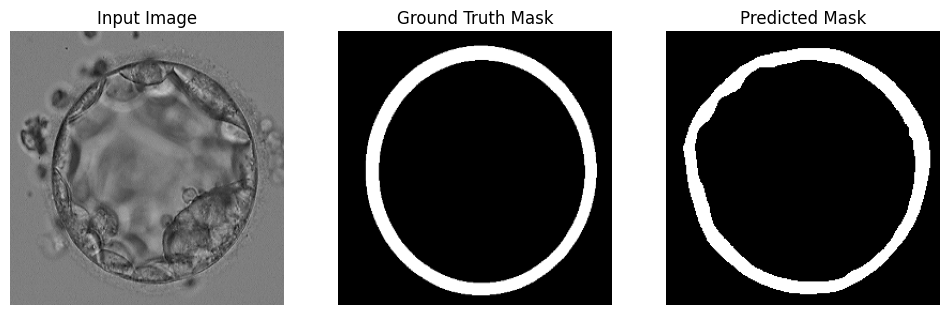

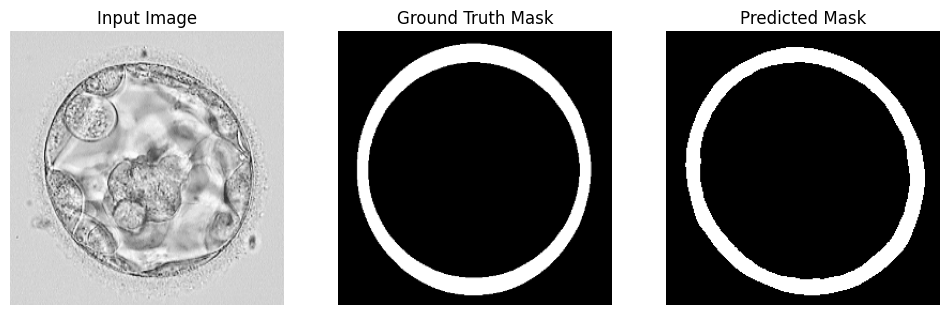

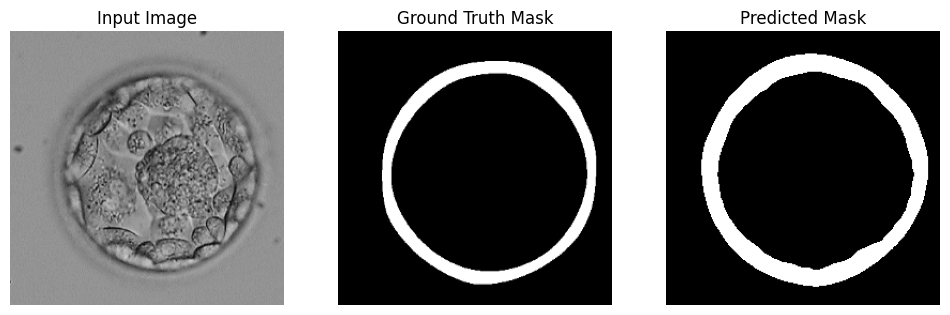

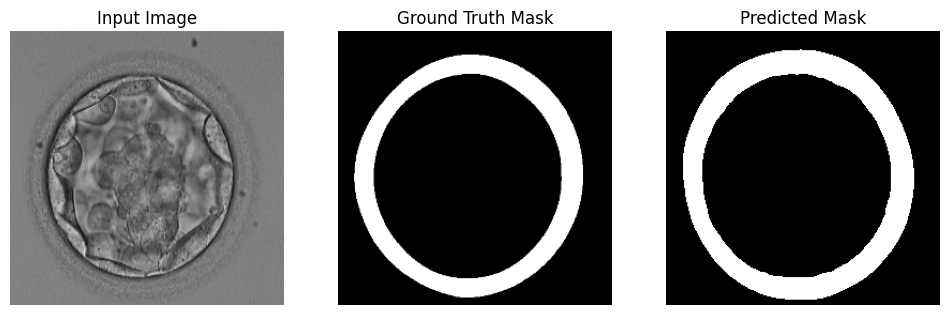

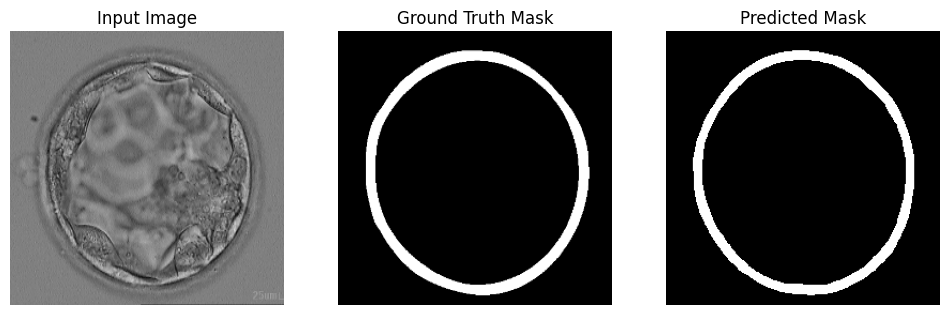

In [ ]:
visualize_predictions(model, test_loader, DEVICE, num_samples=5)


In [ ]:
pip install ptflops


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 97.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 72.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 48.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 62.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
from ptflops import get_model_complexity_info

# Add this right after model initialization
model = MALUNet().to(DEVICE)

# Calculate parameters and FLOPs
with torch.no_grad():
    macs, params = get_model_complexity_info(model, (3, 256, 256), as_strings=False,
                                           print_per_layer_stat=False, verbose=False)

# Convert to same units as paper (Millions and GFLOPs)
total_params = params / 1e6
total_flops = macs / 1e9

print(f"\nModel Statistics:")
print(f"Parameters: {total_params:.3f}M")
print(f"GFLOPs: {total_flops:.3f}\n")

# Add this to your training output
print(f"Model Params ↓ GFLOPs↓ mIoU↑ DSC↑ Acc↑ Spe↑ Sen↑")
print(f"{total_params:.3f} {total_flops:.3f} {np.mean(val_miou)*100:.2f} {np.mean(val_dice)*100:.2f} "
      f"{np.mean(val_accuracy)*100:.2f} {np.mean(val_specificity)*100:.2f} {np.mean(val_sensitivity)*100:.2f}")

SC_Att_Bridge was used

Model Statistics:
Parameters: 0.178M
GFLOPs: 0.090

Model Params ↓ GFLOPs↓ mIoU↑ DSC↑ Acc↑ Spe↑ Sen↑
0.178 0.090 73.60 84.67 95.92 97.72 83.86


SC_Att_Bridge was used


Epoch 1/100: 100%|██████████| 125/125 [01:36<00:00,  1.30it/s]


[Epoch 1] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


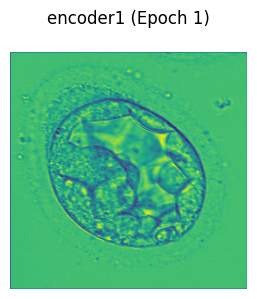

encoder2: torch.Size([3, 16, 128, 128])


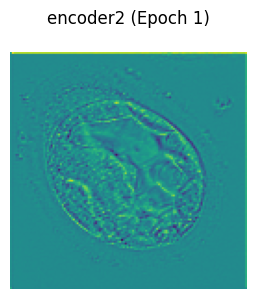

encoder3: torch.Size([3, 24, 64, 64])


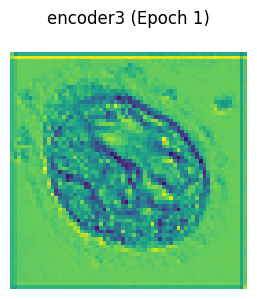

encoder4: torch.Size([3, 32, 32, 32])


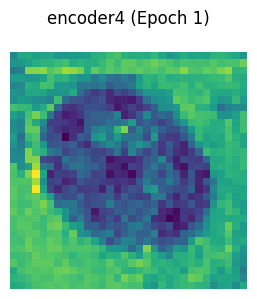

encoder5: torch.Size([3, 48, 16, 16])


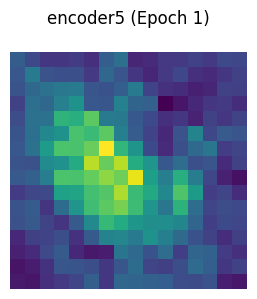

encoder6: torch.Size([3, 64, 8, 8])


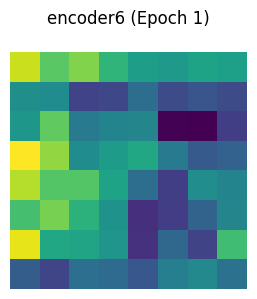

decoder1: torch.Size([3, 48, 8, 8])


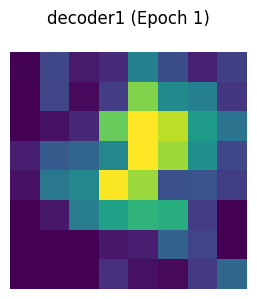

decoder2: torch.Size([3, 32, 8, 8])


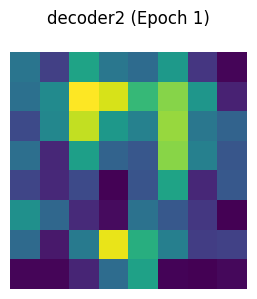

decoder3: torch.Size([3, 24, 16, 16])


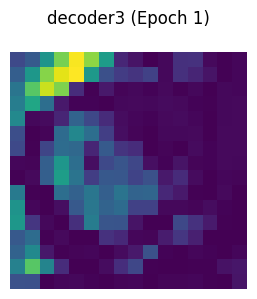

decoder4: torch.Size([3, 16, 32, 32])


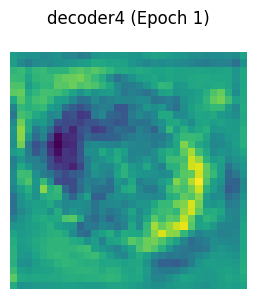

decoder5: torch.Size([3, 8, 64, 64])


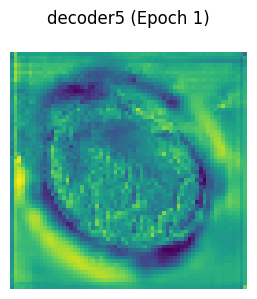

Epoch 1: Loss = 139.0488, Val Dice = 0.7660, Val mIoU = 0.6248, Val Accuracy = 0.9290, Val Sensitivity = 0.8771, Val Specificity = 0.9389


Epoch 2/100: 100%|██████████| 125/125 [01:36<00:00,  1.29it/s]


[Epoch 2] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


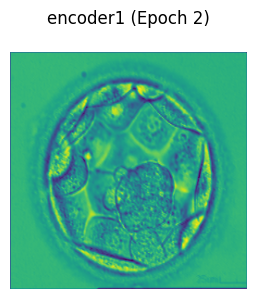

encoder2: torch.Size([3, 16, 128, 128])


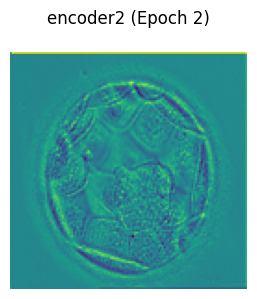

encoder3: torch.Size([3, 24, 64, 64])


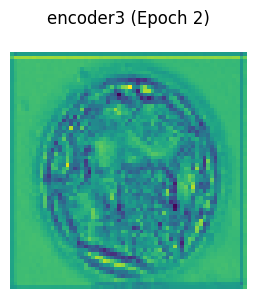

encoder4: torch.Size([3, 32, 32, 32])


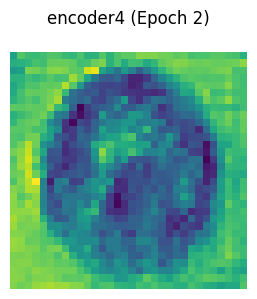

encoder5: torch.Size([3, 48, 16, 16])


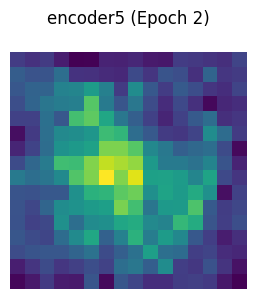

encoder6: torch.Size([3, 64, 8, 8])


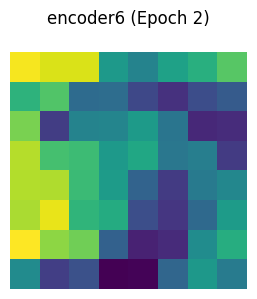

decoder1: torch.Size([3, 48, 8, 8])


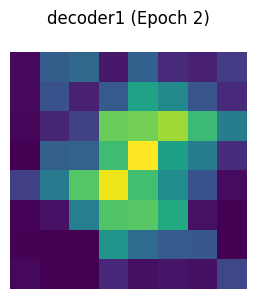

decoder2: torch.Size([3, 32, 8, 8])


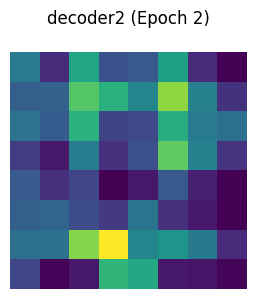

decoder3: torch.Size([3, 24, 16, 16])


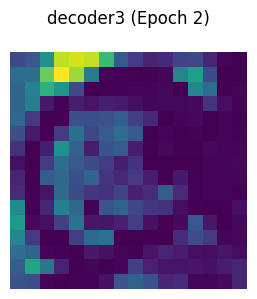

decoder4: torch.Size([3, 16, 32, 32])


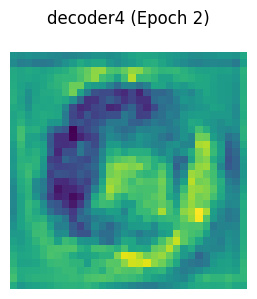

decoder5: torch.Size([3, 8, 64, 64])


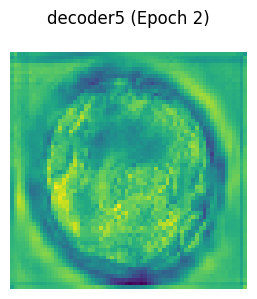

Epoch 2: Loss = 112.4136, Val Dice = 0.8252, Val mIoU = 0.7036, Val Accuracy = 0.9500, Val Sensitivity = 0.8734, Val Specificity = 0.9628


Epoch 3/100: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


[Epoch 3] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


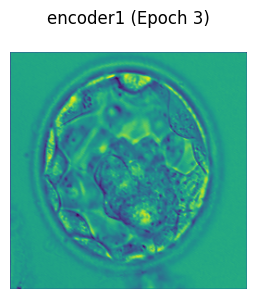

encoder2: torch.Size([3, 16, 128, 128])


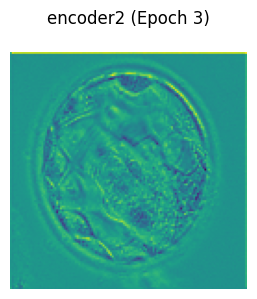

encoder3: torch.Size([3, 24, 64, 64])


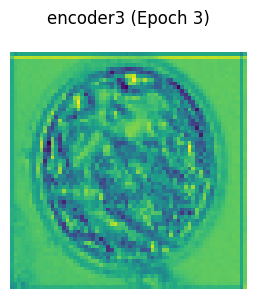

encoder4: torch.Size([3, 32, 32, 32])


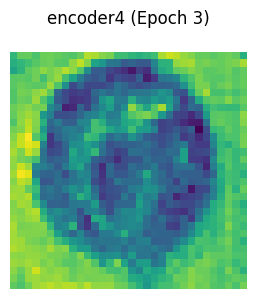

encoder5: torch.Size([3, 48, 16, 16])


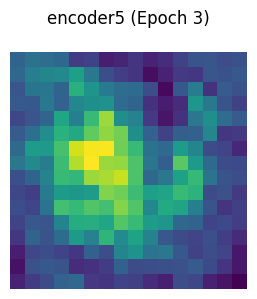

encoder6: torch.Size([3, 64, 8, 8])


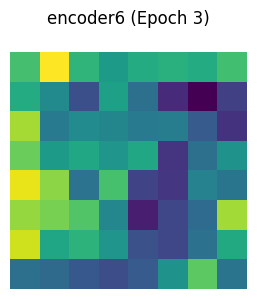

decoder1: torch.Size([3, 48, 8, 8])


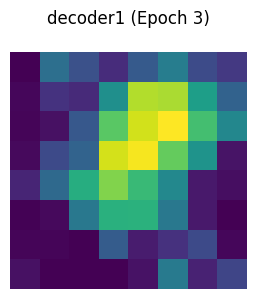

decoder2: torch.Size([3, 32, 8, 8])


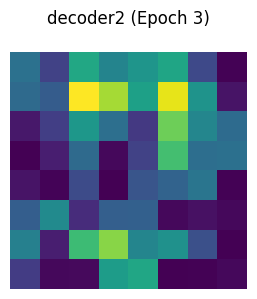

decoder3: torch.Size([3, 24, 16, 16])


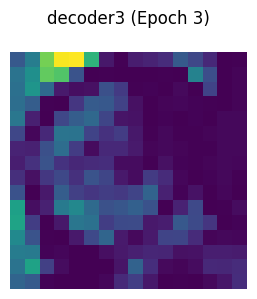

decoder4: torch.Size([3, 16, 32, 32])


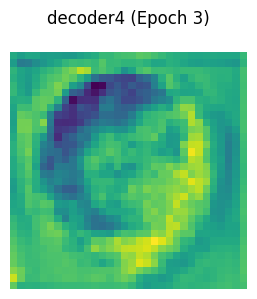

decoder5: torch.Size([3, 8, 64, 64])


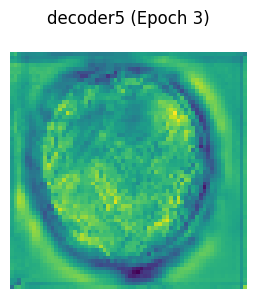

Epoch 3: Loss = 108.4501, Val Dice = 0.8299, Val mIoU = 0.7105, Val Accuracy = 0.9534, Val Sensitivity = 0.8373, Val Specificity = 0.9718


Epoch 4/100: 100%|██████████| 125/125 [01:35<00:00,  1.30it/s]


[Epoch 4] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


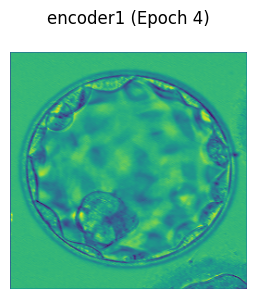

encoder2: torch.Size([3, 16, 128, 128])


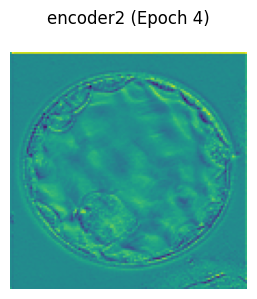

encoder3: torch.Size([3, 24, 64, 64])


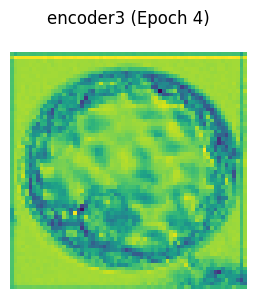

encoder4: torch.Size([3, 32, 32, 32])


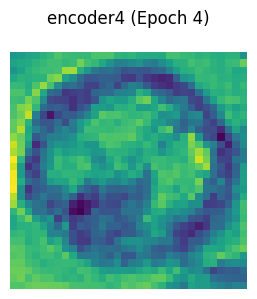

encoder5: torch.Size([3, 48, 16, 16])


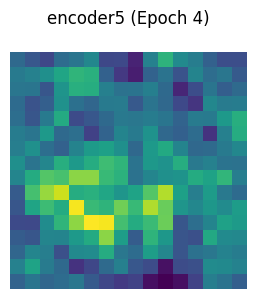

encoder6: torch.Size([3, 64, 8, 8])


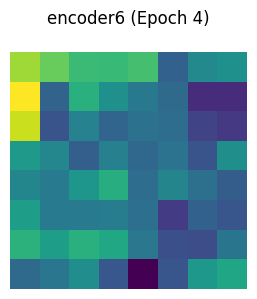

decoder1: torch.Size([3, 48, 8, 8])


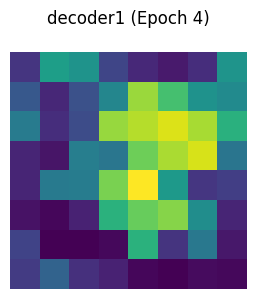

decoder2: torch.Size([3, 32, 8, 8])


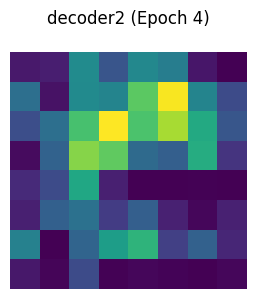

decoder3: torch.Size([3, 24, 16, 16])


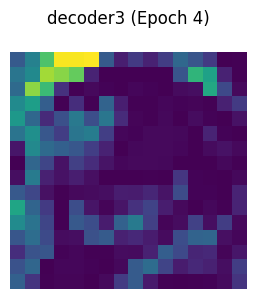

decoder4: torch.Size([3, 16, 32, 32])


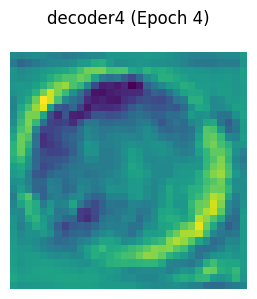

decoder5: torch.Size([3, 8, 64, 64])


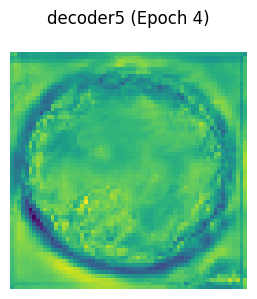

Epoch 4: Loss = 106.4729, Val Dice = 0.8365, Val mIoU = 0.7203, Val Accuracy = 0.9559, Val Sensitivity = 0.8382, Val Specificity = 0.9742


Epoch 5/100: 100%|██████████| 125/125 [01:34<00:00,  1.32it/s]


[Epoch 5] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


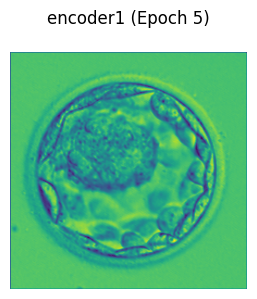

encoder2: torch.Size([3, 16, 128, 128])


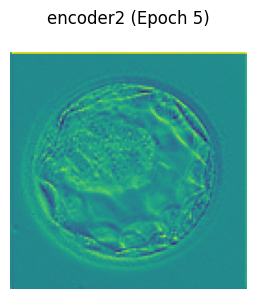

encoder3: torch.Size([3, 24, 64, 64])


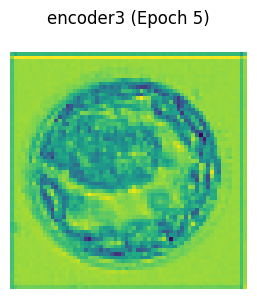

encoder4: torch.Size([3, 32, 32, 32])


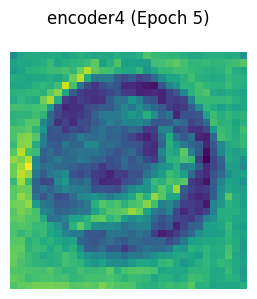

encoder5: torch.Size([3, 48, 16, 16])


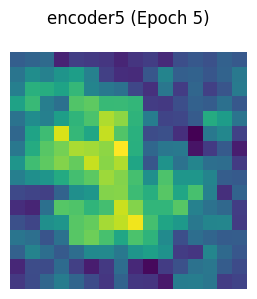

encoder6: torch.Size([3, 64, 8, 8])


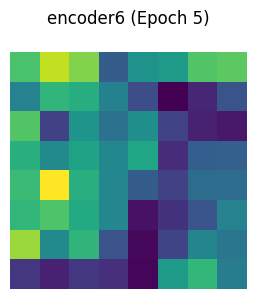

decoder1: torch.Size([3, 48, 8, 8])


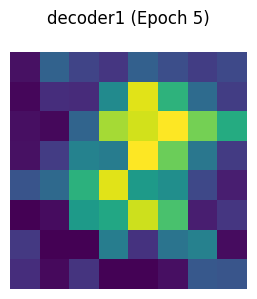

decoder2: torch.Size([3, 32, 8, 8])


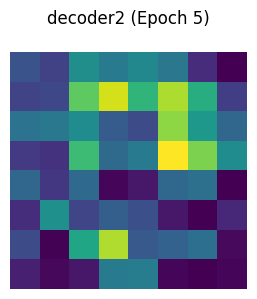

decoder3: torch.Size([3, 24, 16, 16])


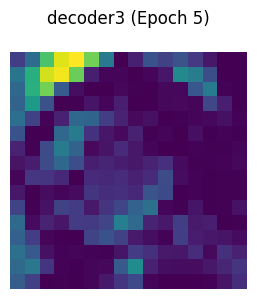

decoder4: torch.Size([3, 16, 32, 32])


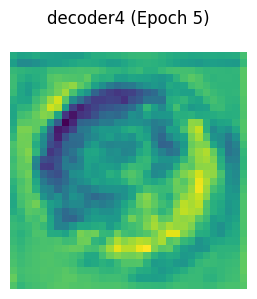

decoder5: torch.Size([3, 8, 64, 64])


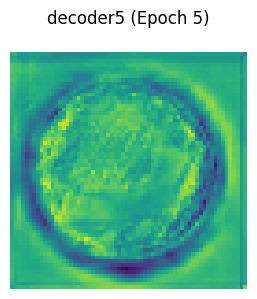

Epoch 5: Loss = 105.5414, Val Dice = 0.8415, Val mIoU = 0.7273, Val Accuracy = 0.9557, Val Sensitivity = 0.8565, Val Specificity = 0.9714


Epoch 6/100: 100%|██████████| 125/125 [01:36<00:00,  1.29it/s]


[Epoch 6] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


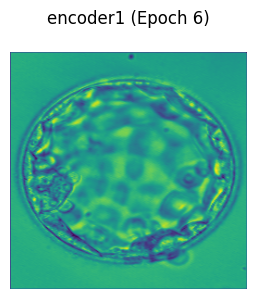

encoder2: torch.Size([3, 16, 128, 128])


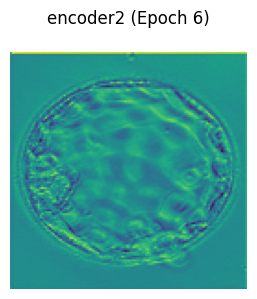

encoder3: torch.Size([3, 24, 64, 64])


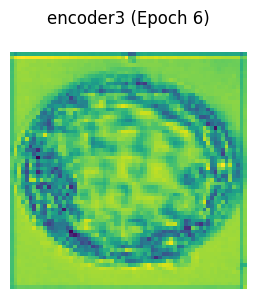

encoder4: torch.Size([3, 32, 32, 32])


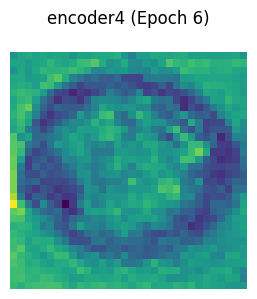

encoder5: torch.Size([3, 48, 16, 16])


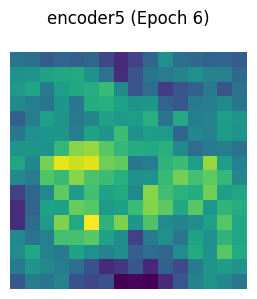

encoder6: torch.Size([3, 64, 8, 8])


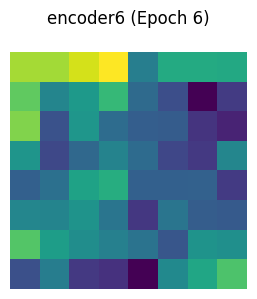

decoder1: torch.Size([3, 48, 8, 8])


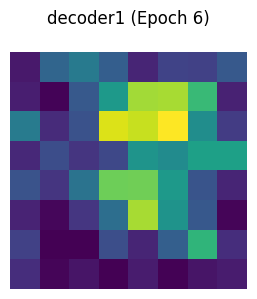

decoder2: torch.Size([3, 32, 8, 8])


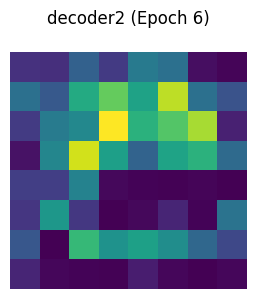

decoder3: torch.Size([3, 24, 16, 16])


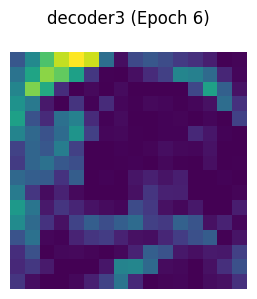

decoder4: torch.Size([3, 16, 32, 32])


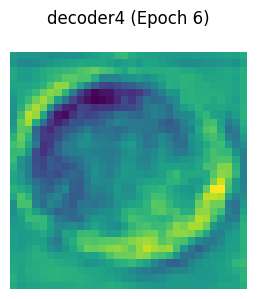

decoder5: torch.Size([3, 8, 64, 64])


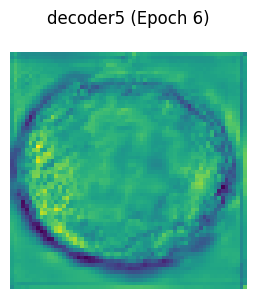

Epoch 6: Loss = 103.8603, Val Dice = 0.8253, Val mIoU = 0.7038, Val Accuracy = 0.9510, Val Sensitivity = 0.8472, Val Specificity = 0.9666


Epoch 7/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 7] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


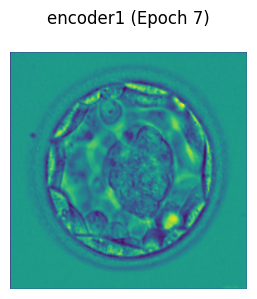

encoder2: torch.Size([3, 16, 128, 128])


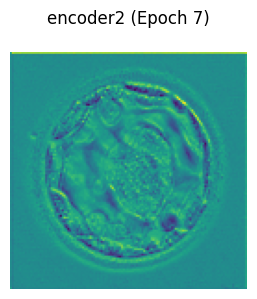

encoder3: torch.Size([3, 24, 64, 64])


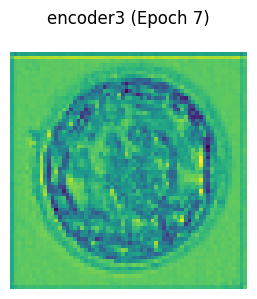

encoder4: torch.Size([3, 32, 32, 32])


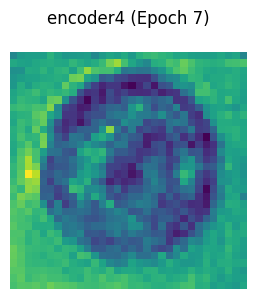

encoder5: torch.Size([3, 48, 16, 16])


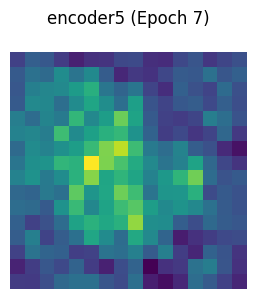

encoder6: torch.Size([3, 64, 8, 8])


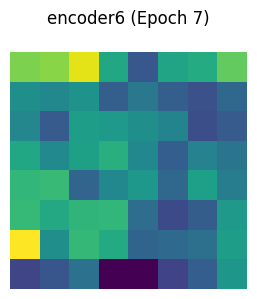

decoder1: torch.Size([3, 48, 8, 8])


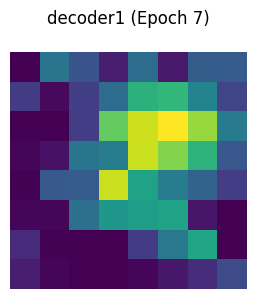

decoder2: torch.Size([3, 32, 8, 8])


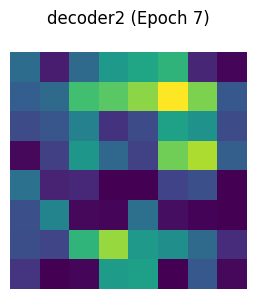

decoder3: torch.Size([3, 24, 16, 16])


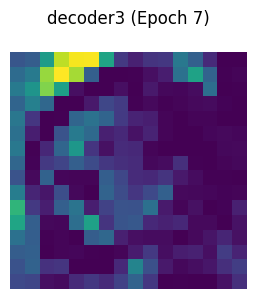

decoder4: torch.Size([3, 16, 32, 32])


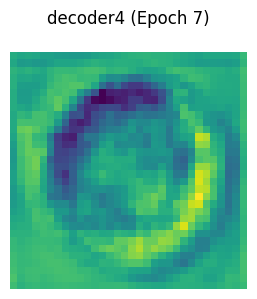

decoder5: torch.Size([3, 8, 64, 64])


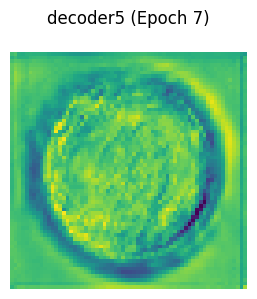

Epoch 7: Loss = 102.9275, Val Dice = 0.8370, Val mIoU = 0.7220, Val Accuracy = 0.9569, Val Sensitivity = 0.8297, Val Specificity = 0.9761


Epoch 8/100: 100%|██████████| 125/125 [01:36<00:00,  1.30it/s]


[Epoch 8] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


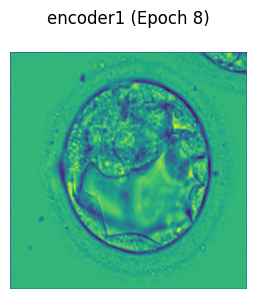

encoder2: torch.Size([3, 16, 128, 128])


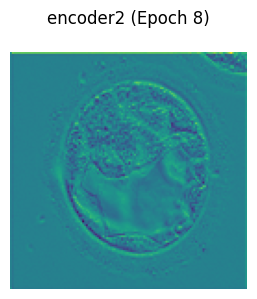

encoder3: torch.Size([3, 24, 64, 64])


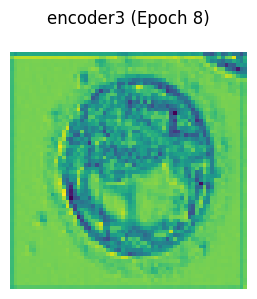

encoder4: torch.Size([3, 32, 32, 32])


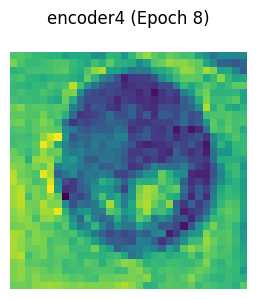

encoder5: torch.Size([3, 48, 16, 16])


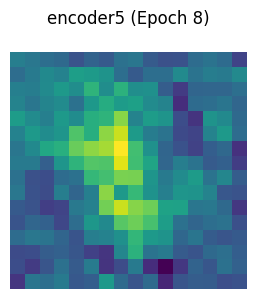

encoder6: torch.Size([3, 64, 8, 8])


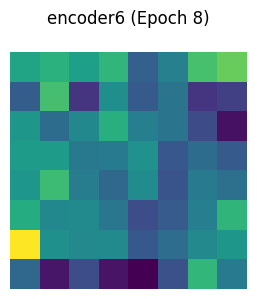

decoder1: torch.Size([3, 48, 8, 8])


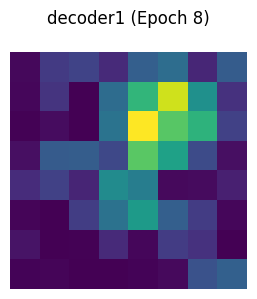

decoder2: torch.Size([3, 32, 8, 8])


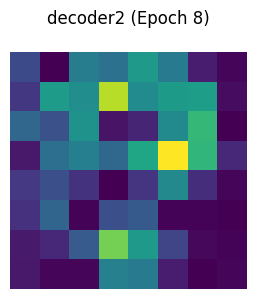

decoder3: torch.Size([3, 24, 16, 16])


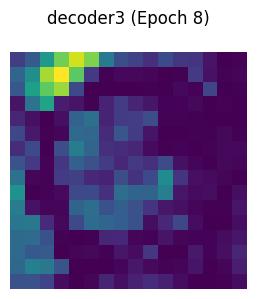

decoder4: torch.Size([3, 16, 32, 32])


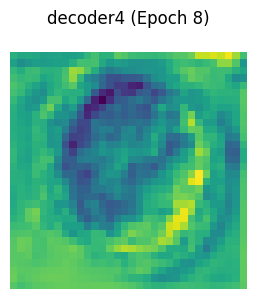

decoder5: torch.Size([3, 8, 64, 64])


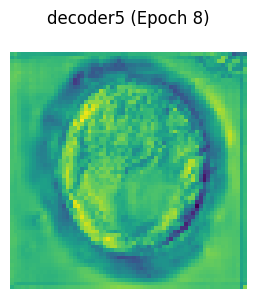

Epoch 8: Loss = 101.7756, Val Dice = 0.8511, Val mIoU = 0.7417, Val Accuracy = 0.9591, Val Sensitivity = 0.8537, Val Specificity = 0.9759


Epoch 9/100: 100%|██████████| 125/125 [01:36<00:00,  1.30it/s]


[Epoch 9] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


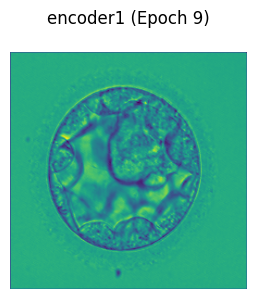

encoder2: torch.Size([3, 16, 128, 128])


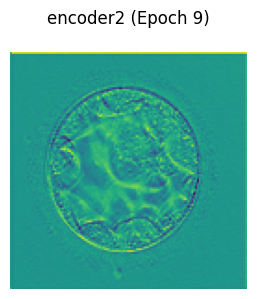

encoder3: torch.Size([3, 24, 64, 64])


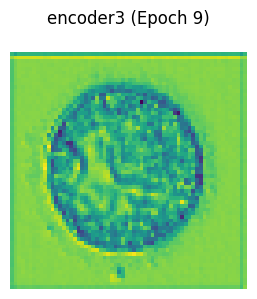

encoder4: torch.Size([3, 32, 32, 32])


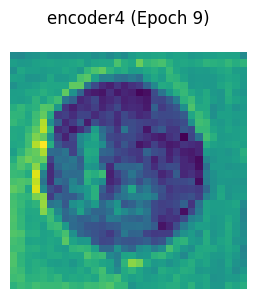

encoder5: torch.Size([3, 48, 16, 16])


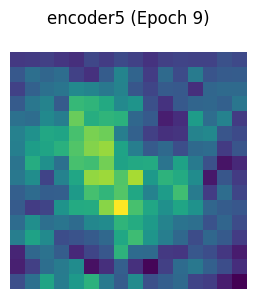

encoder6: torch.Size([3, 64, 8, 8])


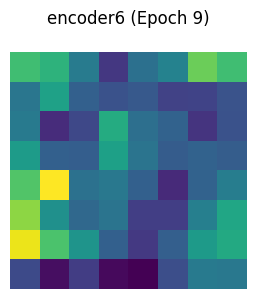

decoder1: torch.Size([3, 48, 8, 8])


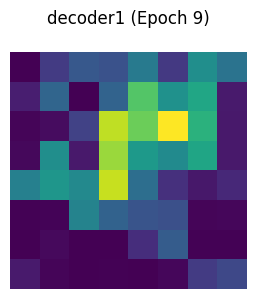

decoder2: torch.Size([3, 32, 8, 8])


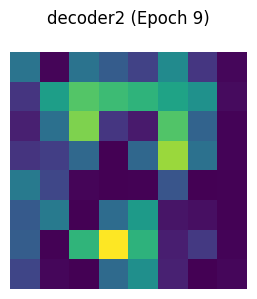

decoder3: torch.Size([3, 24, 16, 16])


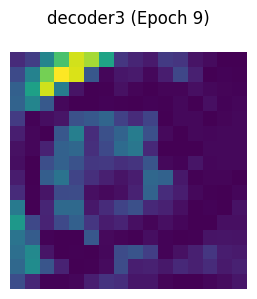

decoder4: torch.Size([3, 16, 32, 32])


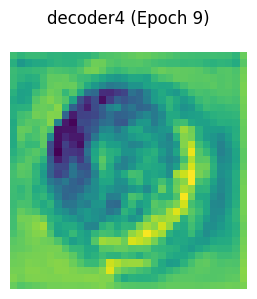

decoder5: torch.Size([3, 8, 64, 64])


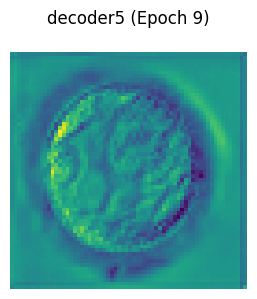

Epoch 9: Loss = 100.9155, Val Dice = 0.8494, Val mIoU = 0.7392, Val Accuracy = 0.9563, Val Sensitivity = 0.8911, Val Specificity = 0.9673


Epoch 10/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 10] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


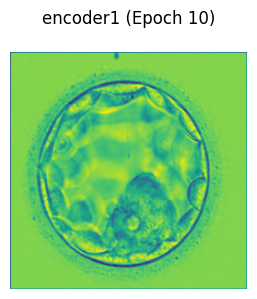

encoder2: torch.Size([3, 16, 128, 128])


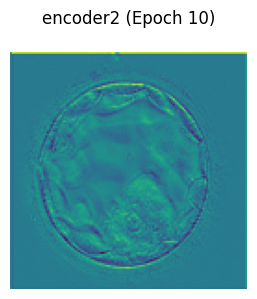

encoder3: torch.Size([3, 24, 64, 64])


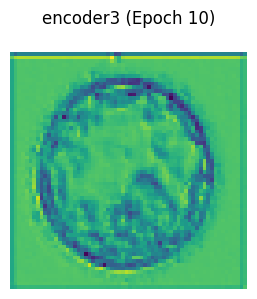

encoder4: torch.Size([3, 32, 32, 32])


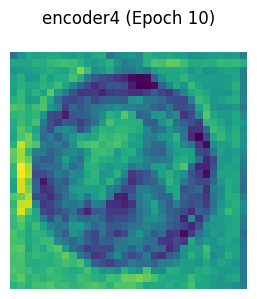

encoder5: torch.Size([3, 48, 16, 16])


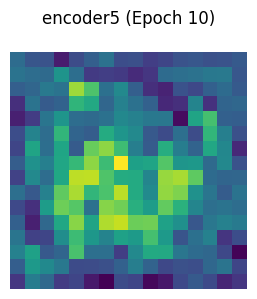

encoder6: torch.Size([3, 64, 8, 8])


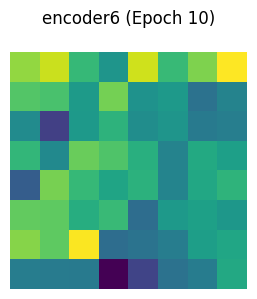

decoder1: torch.Size([3, 48, 8, 8])


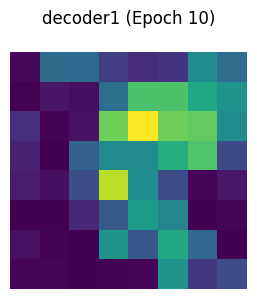

decoder2: torch.Size([3, 32, 8, 8])


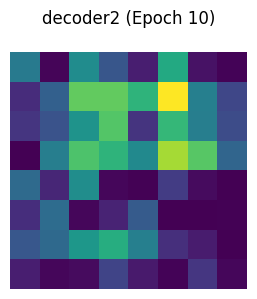

decoder3: torch.Size([3, 24, 16, 16])


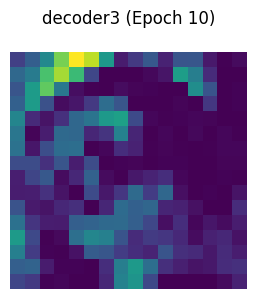

decoder4: torch.Size([3, 16, 32, 32])


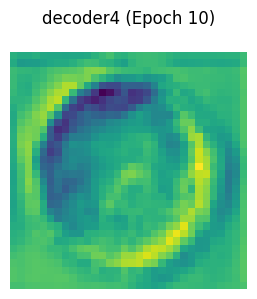

decoder5: torch.Size([3, 8, 64, 64])


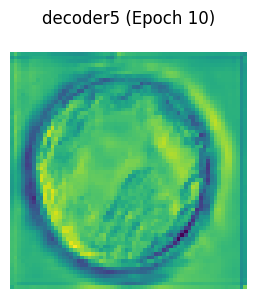

Epoch 10: Loss = 99.5403, Val Dice = 0.8379, Val mIoU = 0.7224, Val Accuracy = 0.9516, Val Sensitivity = 0.9144, Val Specificity = 0.9571


Epoch 11/100: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


[Epoch 11] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


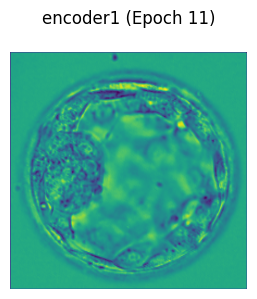

encoder2: torch.Size([3, 16, 128, 128])


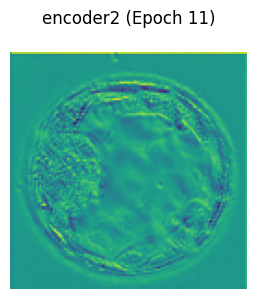

encoder3: torch.Size([3, 24, 64, 64])


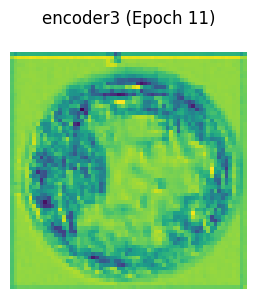

encoder4: torch.Size([3, 32, 32, 32])


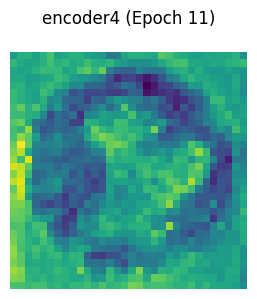

encoder5: torch.Size([3, 48, 16, 16])


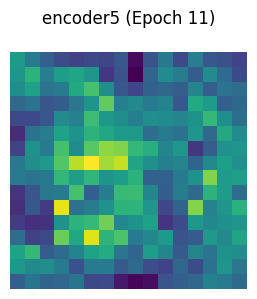

encoder6: torch.Size([3, 64, 8, 8])


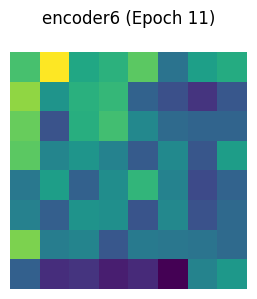

decoder1: torch.Size([3, 48, 8, 8])


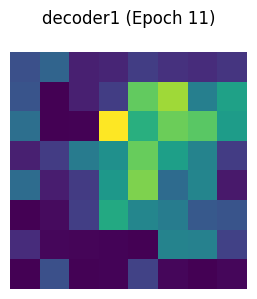

decoder2: torch.Size([3, 32, 8, 8])


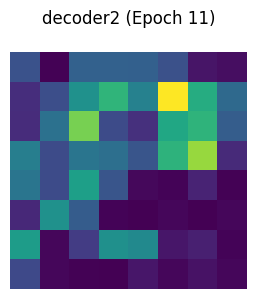

decoder3: torch.Size([3, 24, 16, 16])


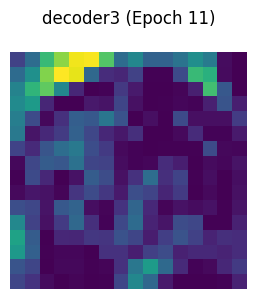

decoder4: torch.Size([3, 16, 32, 32])


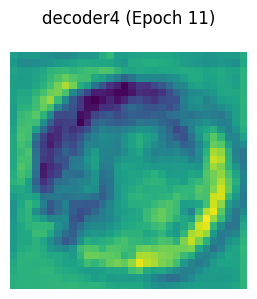

decoder5: torch.Size([3, 8, 64, 64])


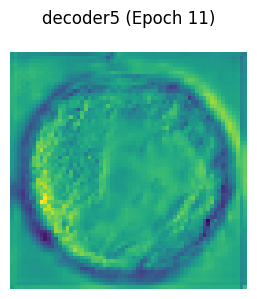

Epoch 11: Loss = 98.7281, Val Dice = 0.8455, Val mIoU = 0.7344, Val Accuracy = 0.9586, Val Sensitivity = 0.8456, Val Specificity = 0.9755


Epoch 12/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 12] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


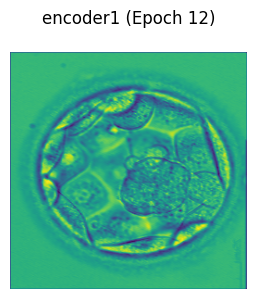

encoder2: torch.Size([3, 16, 128, 128])


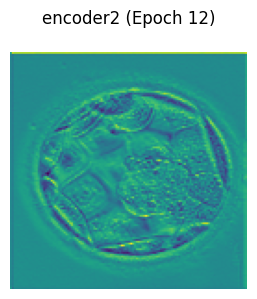

encoder3: torch.Size([3, 24, 64, 64])


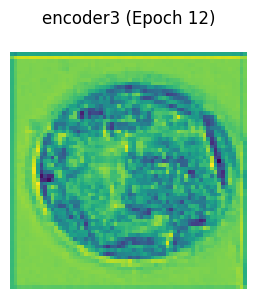

encoder4: torch.Size([3, 32, 32, 32])


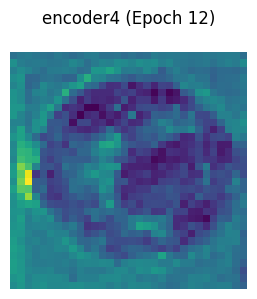

encoder5: torch.Size([3, 48, 16, 16])


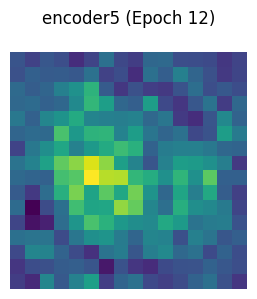

encoder6: torch.Size([3, 64, 8, 8])


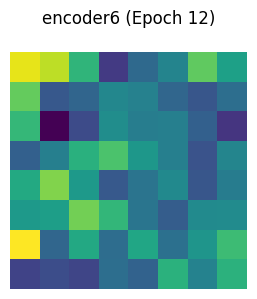

decoder1: torch.Size([3, 48, 8, 8])


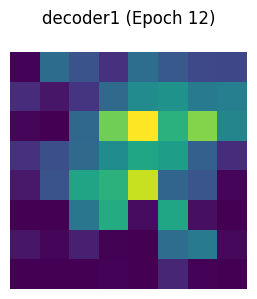

decoder2: torch.Size([3, 32, 8, 8])


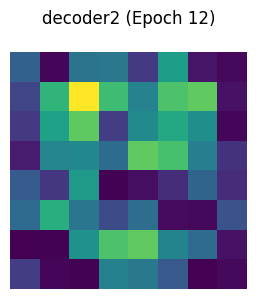

decoder3: torch.Size([3, 24, 16, 16])


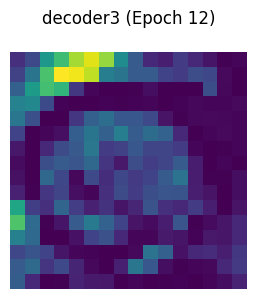

decoder4: torch.Size([3, 16, 32, 32])


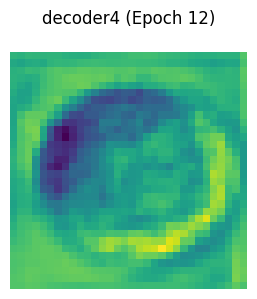

decoder5: torch.Size([3, 8, 64, 64])


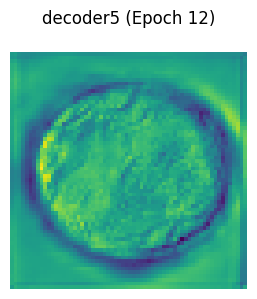

Epoch 12: Loss = 97.8364, Val Dice = 0.8435, Val mIoU = 0.7307, Val Accuracy = 0.9555, Val Sensitivity = 0.8790, Val Specificity = 0.9671


Epoch 13/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 13] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


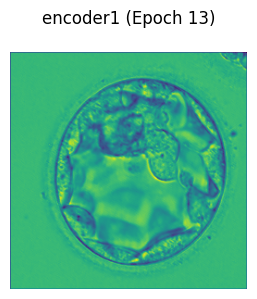

encoder2: torch.Size([3, 16, 128, 128])


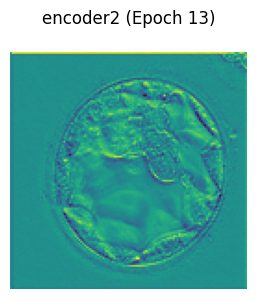

encoder3: torch.Size([3, 24, 64, 64])


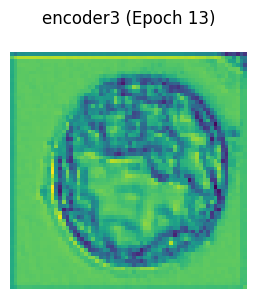

encoder4: torch.Size([3, 32, 32, 32])


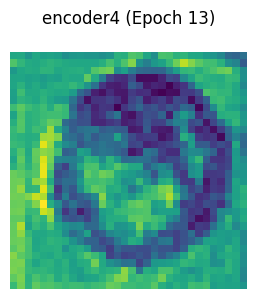

encoder5: torch.Size([3, 48, 16, 16])


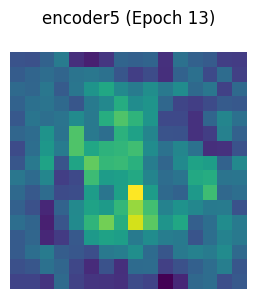

encoder6: torch.Size([3, 64, 8, 8])


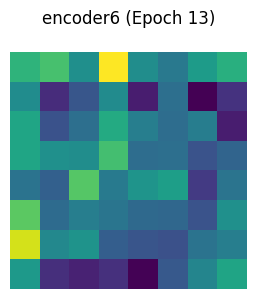

decoder1: torch.Size([3, 48, 8, 8])


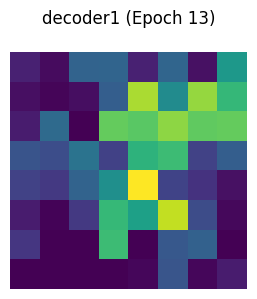

decoder2: torch.Size([3, 32, 8, 8])


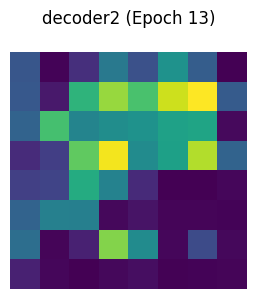

decoder3: torch.Size([3, 24, 16, 16])


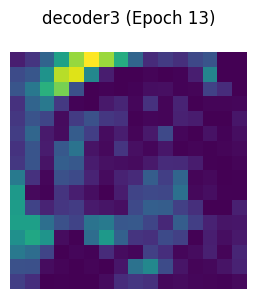

decoder4: torch.Size([3, 16, 32, 32])


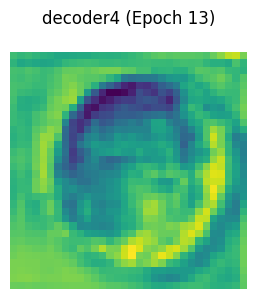

decoder5: torch.Size([3, 8, 64, 64])


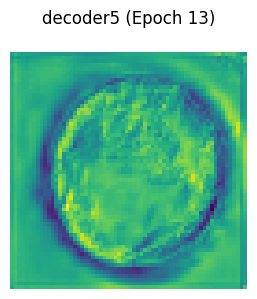

Epoch 13: Loss = 96.8412, Val Dice = 0.8440, Val mIoU = 0.7322, Val Accuracy = 0.9570, Val Sensitivity = 0.8727, Val Specificity = 0.9692


Epoch 14/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 14] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


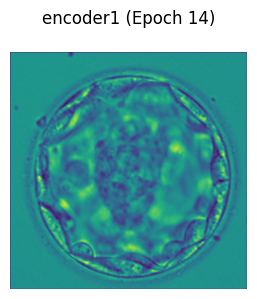

encoder2: torch.Size([3, 16, 128, 128])


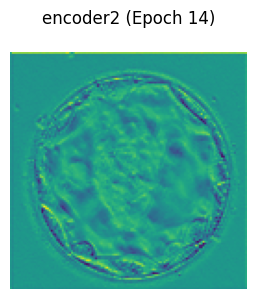

encoder3: torch.Size([3, 24, 64, 64])


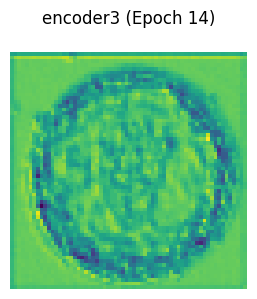

encoder4: torch.Size([3, 32, 32, 32])


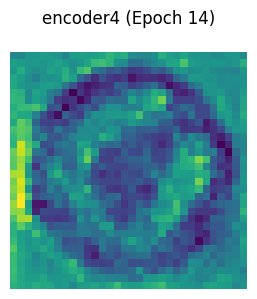

encoder5: torch.Size([3, 48, 16, 16])


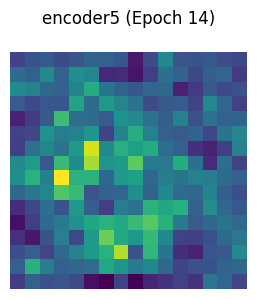

encoder6: torch.Size([3, 64, 8, 8])


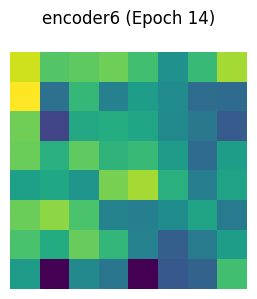

decoder1: torch.Size([3, 48, 8, 8])


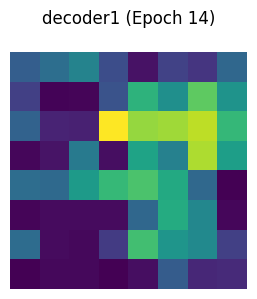

decoder2: torch.Size([3, 32, 8, 8])


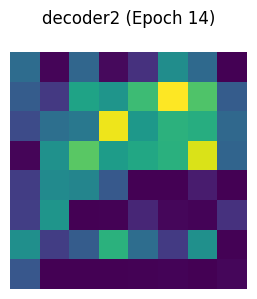

decoder3: torch.Size([3, 24, 16, 16])


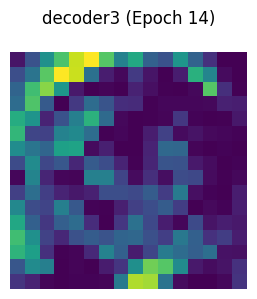

decoder4: torch.Size([3, 16, 32, 32])


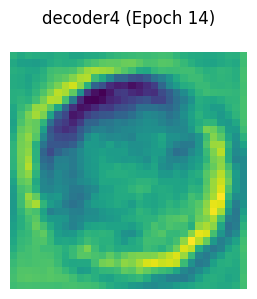

decoder5: torch.Size([3, 8, 64, 64])


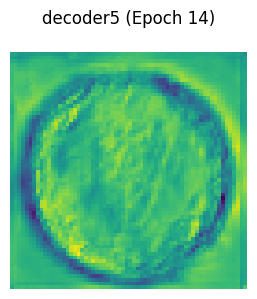

Epoch 14: Loss = 95.8396, Val Dice = 0.8575, Val mIoU = 0.7513, Val Accuracy = 0.9598, Val Sensitivity = 0.8757, Val Specificity = 0.9740


Epoch 15/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 15] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


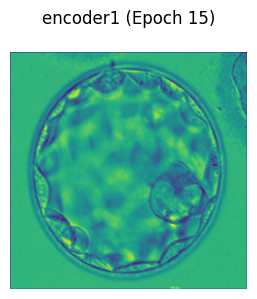

encoder2: torch.Size([3, 16, 128, 128])


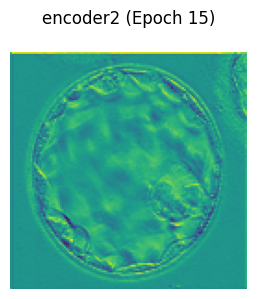

encoder3: torch.Size([3, 24, 64, 64])


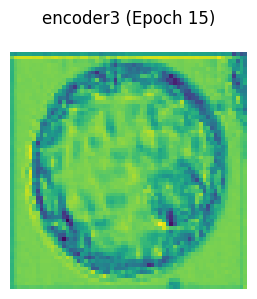

encoder4: torch.Size([3, 32, 32, 32])


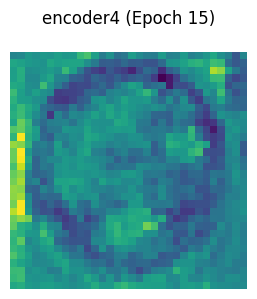

encoder5: torch.Size([3, 48, 16, 16])


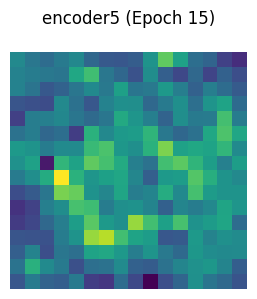

encoder6: torch.Size([3, 64, 8, 8])


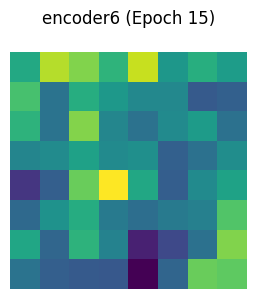

decoder1: torch.Size([3, 48, 8, 8])


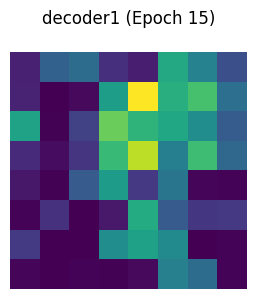

decoder2: torch.Size([3, 32, 8, 8])


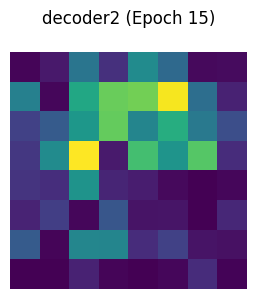

decoder3: torch.Size([3, 24, 16, 16])


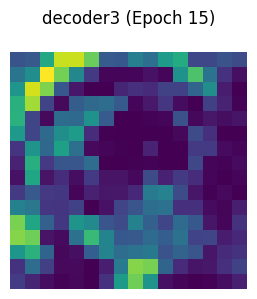

decoder4: torch.Size([3, 16, 32, 32])


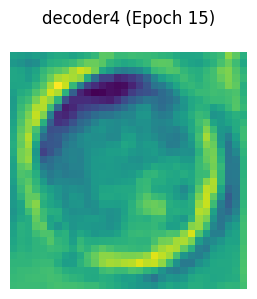

decoder5: torch.Size([3, 8, 64, 64])


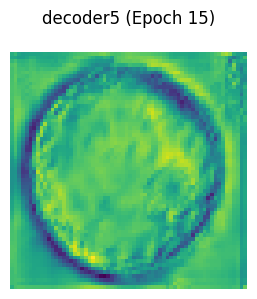

Epoch 15: Loss = 95.8105, Val Dice = 0.8528, Val mIoU = 0.7436, Val Accuracy = 0.9560, Val Sensitivity = 0.9122, Val Specificity = 0.9623


Epoch 16/100: 100%|██████████| 125/125 [01:36<00:00,  1.29it/s]


[Epoch 16] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


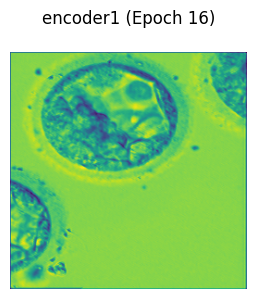

encoder2: torch.Size([3, 16, 128, 128])


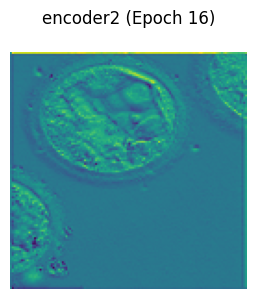

encoder3: torch.Size([3, 24, 64, 64])


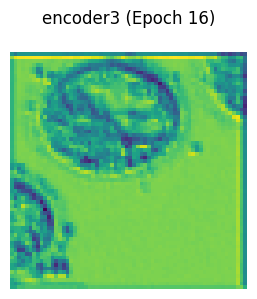

encoder4: torch.Size([3, 32, 32, 32])


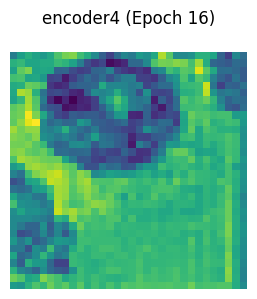

encoder5: torch.Size([3, 48, 16, 16])


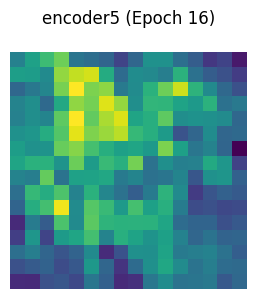

encoder6: torch.Size([3, 64, 8, 8])


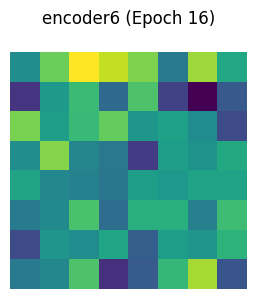

decoder1: torch.Size([3, 48, 8, 8])


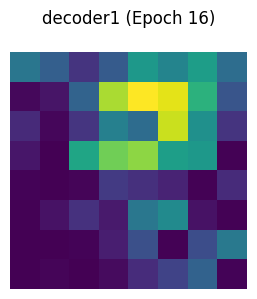

decoder2: torch.Size([3, 32, 8, 8])


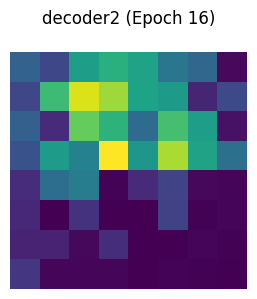

decoder3: torch.Size([3, 24, 16, 16])


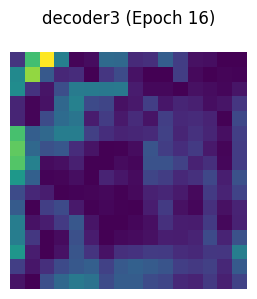

decoder4: torch.Size([3, 16, 32, 32])


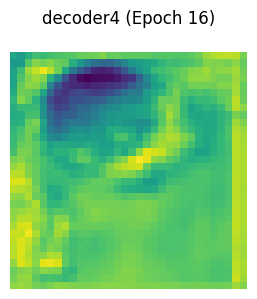

decoder5: torch.Size([3, 8, 64, 64])


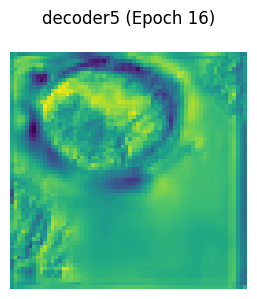

Epoch 16: Loss = 95.3092, Val Dice = 0.8543, Val mIoU = 0.7476, Val Accuracy = 0.9604, Val Sensitivity = 0.8725, Val Specificity = 0.9738


Epoch 17/100: 100%|██████████| 125/125 [01:33<00:00,  1.34it/s]


[Epoch 17] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


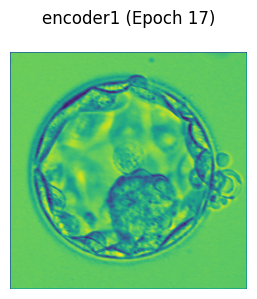

encoder2: torch.Size([3, 16, 128, 128])


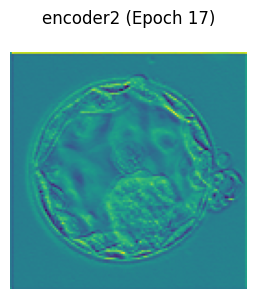

encoder3: torch.Size([3, 24, 64, 64])


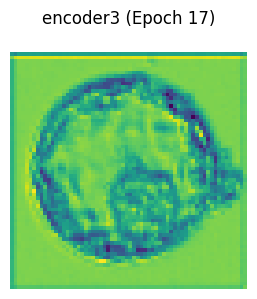

encoder4: torch.Size([3, 32, 32, 32])


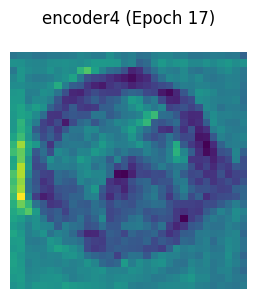

encoder5: torch.Size([3, 48, 16, 16])


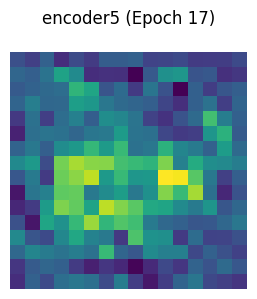

encoder6: torch.Size([3, 64, 8, 8])


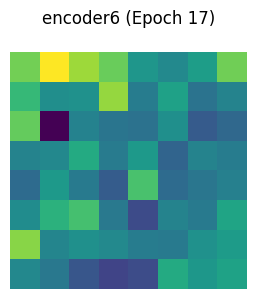

decoder1: torch.Size([3, 48, 8, 8])


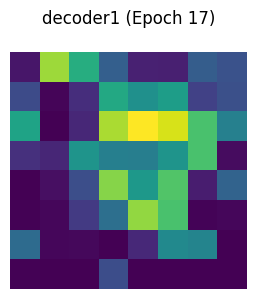

decoder2: torch.Size([3, 32, 8, 8])


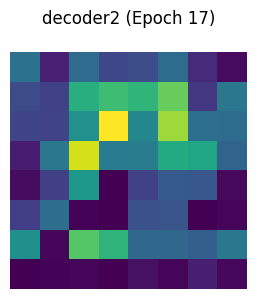

decoder3: torch.Size([3, 24, 16, 16])


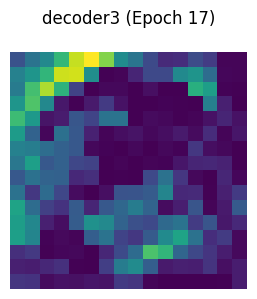

decoder4: torch.Size([3, 16, 32, 32])


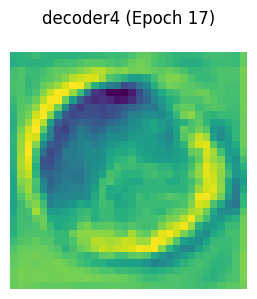

decoder5: torch.Size([3, 8, 64, 64])


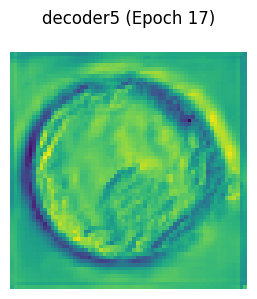

Epoch 17: Loss = 94.1721, Val Dice = 0.8503, Val mIoU = 0.7401, Val Accuracy = 0.9597, Val Sensitivity = 0.8324, Val Specificity = 0.9801


Epoch 18/100: 100%|██████████| 125/125 [01:34<00:00,  1.32it/s]


[Epoch 18] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


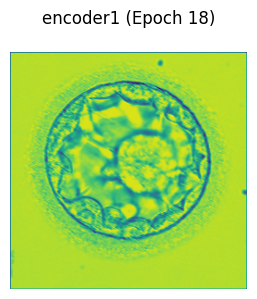

encoder2: torch.Size([3, 16, 128, 128])


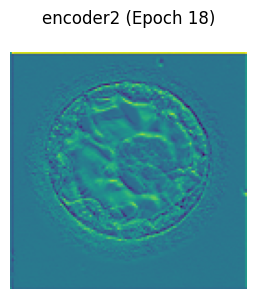

encoder3: torch.Size([3, 24, 64, 64])


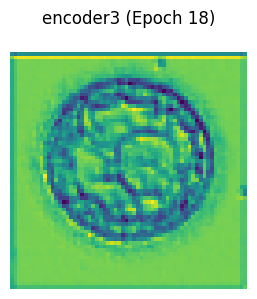

encoder4: torch.Size([3, 32, 32, 32])


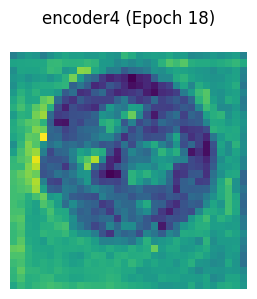

encoder5: torch.Size([3, 48, 16, 16])


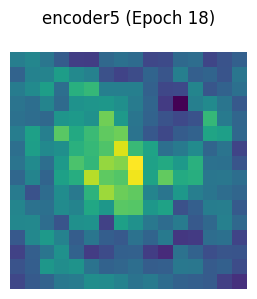

encoder6: torch.Size([3, 64, 8, 8])


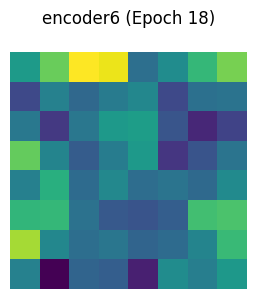

decoder1: torch.Size([3, 48, 8, 8])


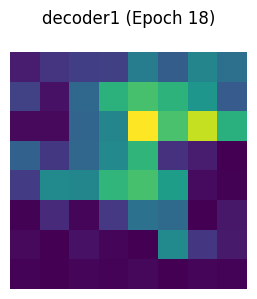

decoder2: torch.Size([3, 32, 8, 8])


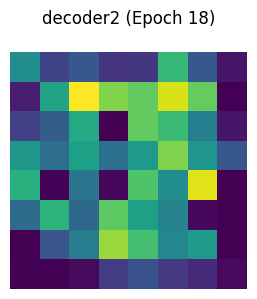

decoder3: torch.Size([3, 24, 16, 16])


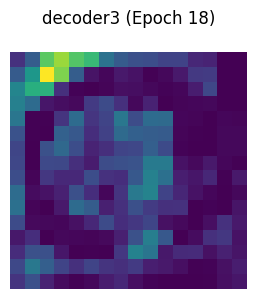

decoder4: torch.Size([3, 16, 32, 32])


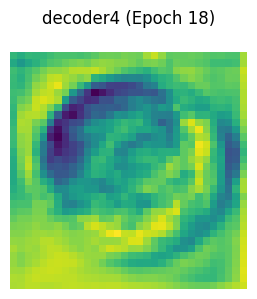

decoder5: torch.Size([3, 8, 64, 64])


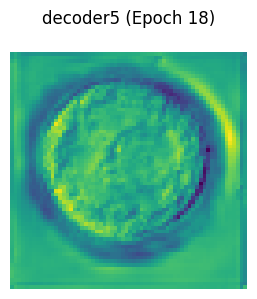

Epoch 18: Loss = 93.8212, Val Dice = 0.8540, Val mIoU = 0.7467, Val Accuracy = 0.9599, Val Sensitivity = 0.8739, Val Specificity = 0.9734


Epoch 19/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 19] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


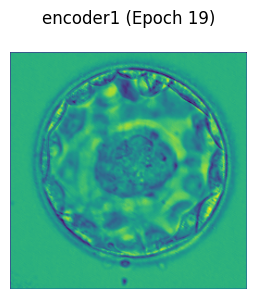

encoder2: torch.Size([3, 16, 128, 128])


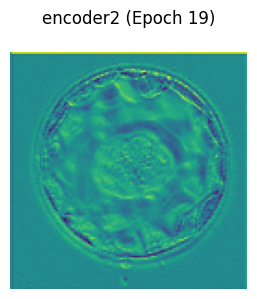

encoder3: torch.Size([3, 24, 64, 64])


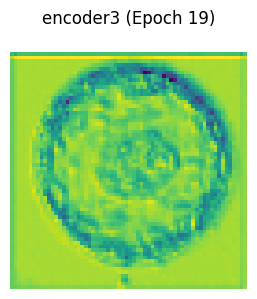

encoder4: torch.Size([3, 32, 32, 32])


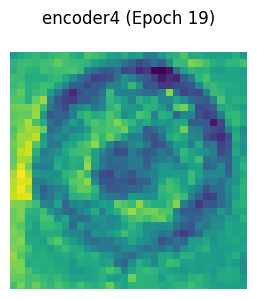

encoder5: torch.Size([3, 48, 16, 16])


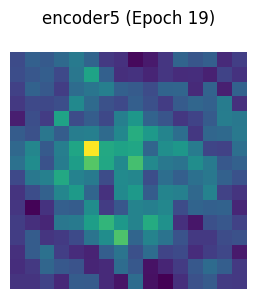

encoder6: torch.Size([3, 64, 8, 8])


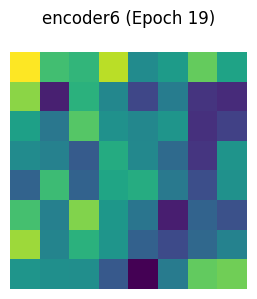

decoder1: torch.Size([3, 48, 8, 8])


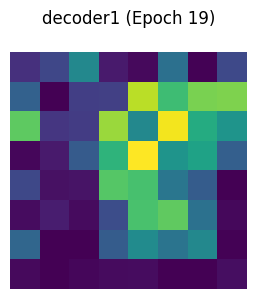

decoder2: torch.Size([3, 32, 8, 8])


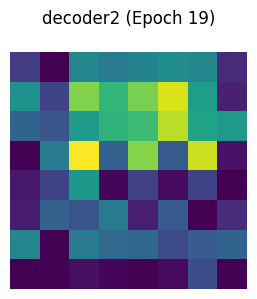

decoder3: torch.Size([3, 24, 16, 16])


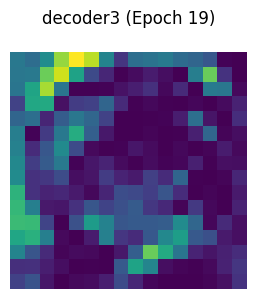

decoder4: torch.Size([3, 16, 32, 32])


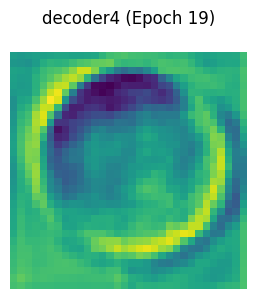

decoder5: torch.Size([3, 8, 64, 64])


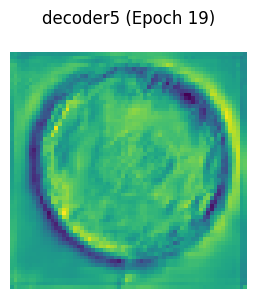

Epoch 19: Loss = 93.5186, Val Dice = 0.8518, Val mIoU = 0.7440, Val Accuracy = 0.9609, Val Sensitivity = 0.8501, Val Specificity = 0.9774


Epoch 20/100: 100%|██████████| 125/125 [01:36<00:00,  1.30it/s]


[Epoch 20] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


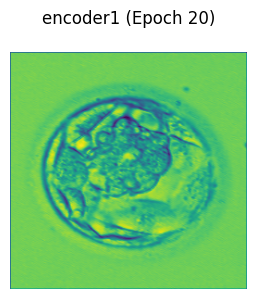

encoder2: torch.Size([3, 16, 128, 128])


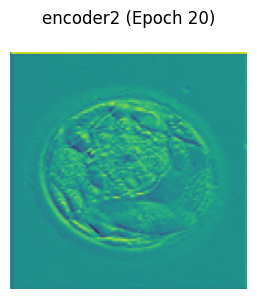

encoder3: torch.Size([3, 24, 64, 64])


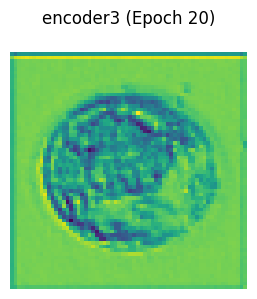

encoder4: torch.Size([3, 32, 32, 32])


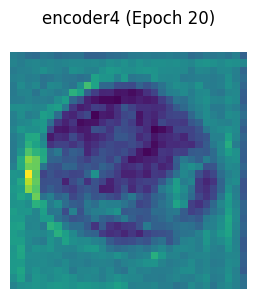

encoder5: torch.Size([3, 48, 16, 16])


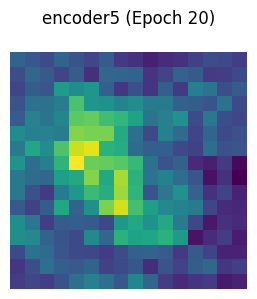

encoder6: torch.Size([3, 64, 8, 8])


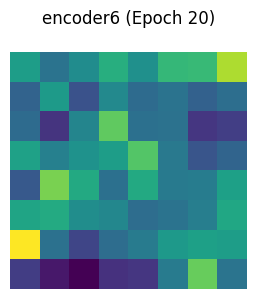

decoder1: torch.Size([3, 48, 8, 8])


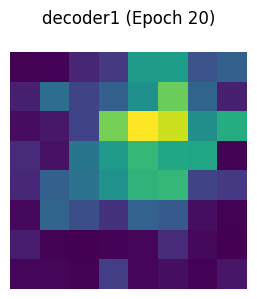

decoder2: torch.Size([3, 32, 8, 8])


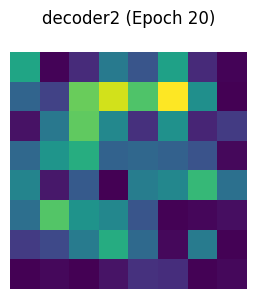

decoder3: torch.Size([3, 24, 16, 16])


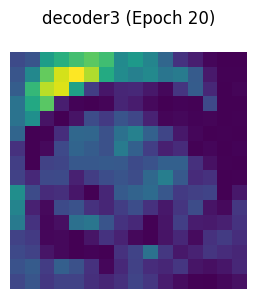

decoder4: torch.Size([3, 16, 32, 32])


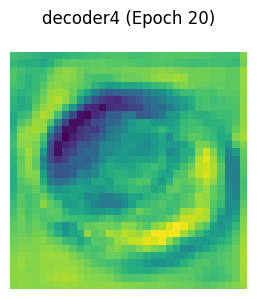

decoder5: torch.Size([3, 8, 64, 64])


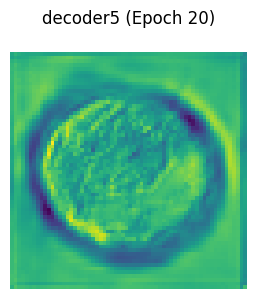

Epoch 20: Loss = 92.7681, Val Dice = 0.8461, Val mIoU = 0.7348, Val Accuracy = 0.9578, Val Sensitivity = 0.8645, Val Specificity = 0.9719


Epoch 21/100: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


[Epoch 21] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


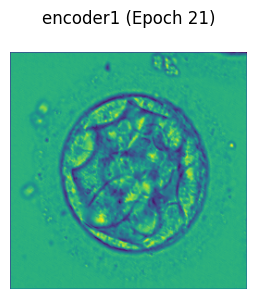

encoder2: torch.Size([3, 16, 128, 128])


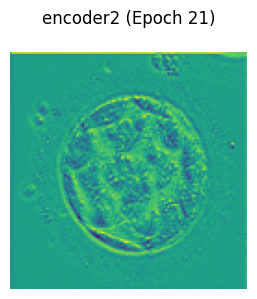

encoder3: torch.Size([3, 24, 64, 64])


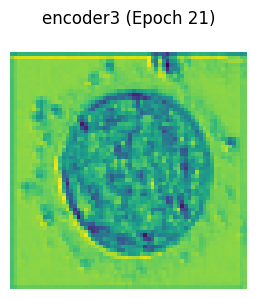

encoder4: torch.Size([3, 32, 32, 32])


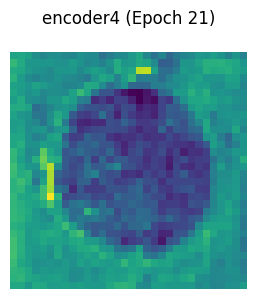

encoder5: torch.Size([3, 48, 16, 16])


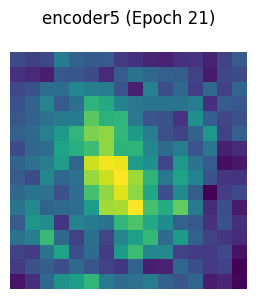

encoder6: torch.Size([3, 64, 8, 8])


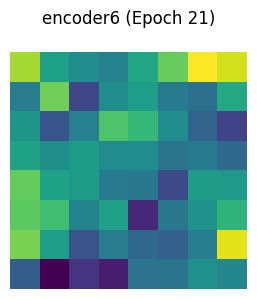

decoder1: torch.Size([3, 48, 8, 8])


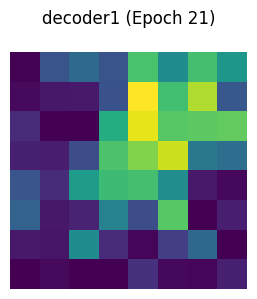

decoder2: torch.Size([3, 32, 8, 8])


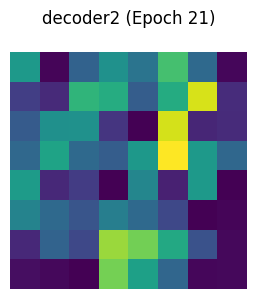

decoder3: torch.Size([3, 24, 16, 16])


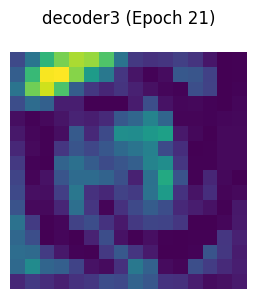

decoder4: torch.Size([3, 16, 32, 32])


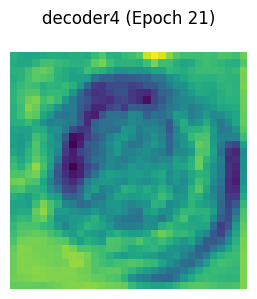

decoder5: torch.Size([3, 8, 64, 64])


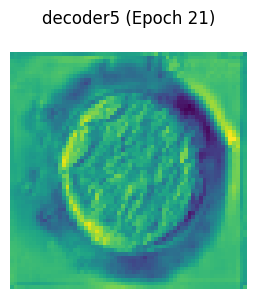

Epoch 21: Loss = 92.1836, Val Dice = 0.8555, Val mIoU = 0.7483, Val Accuracy = 0.9609, Val Sensitivity = 0.8509, Val Specificity = 0.9776


Epoch 22/100: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


[Epoch 22] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


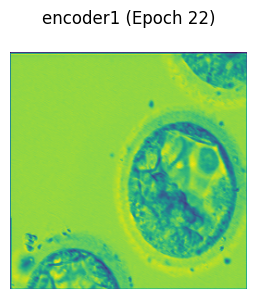

encoder2: torch.Size([3, 16, 128, 128])


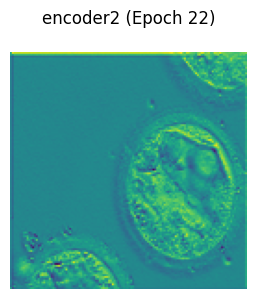

encoder3: torch.Size([3, 24, 64, 64])


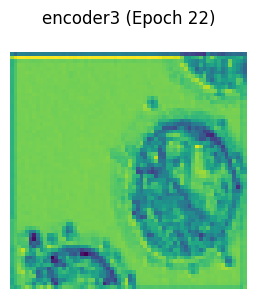

encoder4: torch.Size([3, 32, 32, 32])


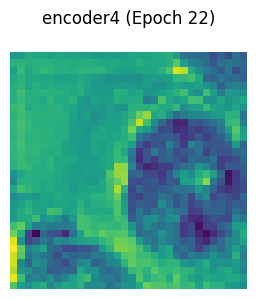

encoder5: torch.Size([3, 48, 16, 16])


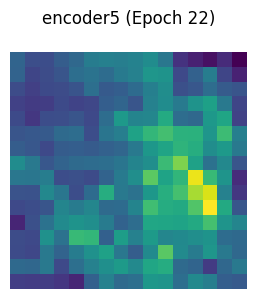

encoder6: torch.Size([3, 64, 8, 8])


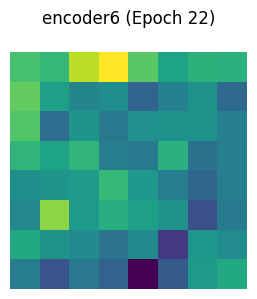

decoder1: torch.Size([3, 48, 8, 8])


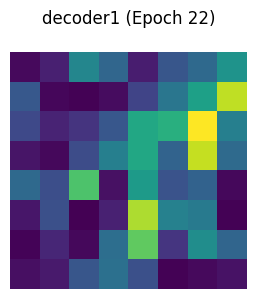

decoder2: torch.Size([3, 32, 8, 8])


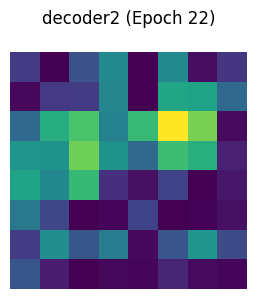

decoder3: torch.Size([3, 24, 16, 16])


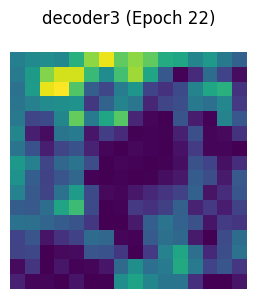

decoder4: torch.Size([3, 16, 32, 32])


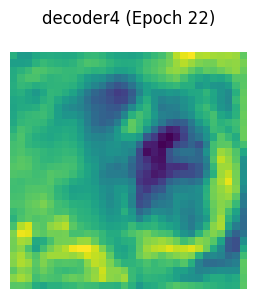

decoder5: torch.Size([3, 8, 64, 64])


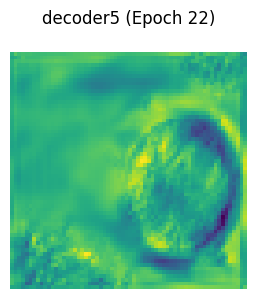

Epoch 22: Loss = 91.6692, Val Dice = 0.8228, Val mIoU = 0.7026, Val Accuracy = 0.9543, Val Sensitivity = 0.8104, Val Specificity = 0.9758


Epoch 23/100: 100%|██████████| 125/125 [01:37<00:00,  1.28it/s]


[Epoch 23] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


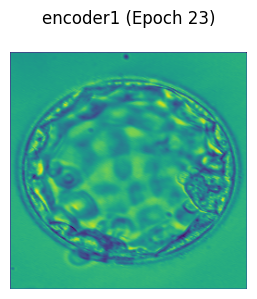

encoder2: torch.Size([3, 16, 128, 128])


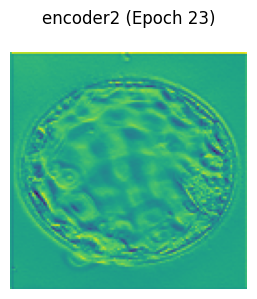

encoder3: torch.Size([3, 24, 64, 64])


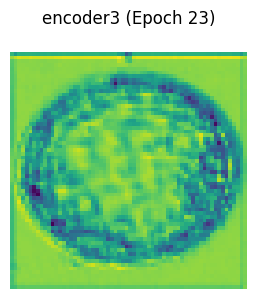

encoder4: torch.Size([3, 32, 32, 32])


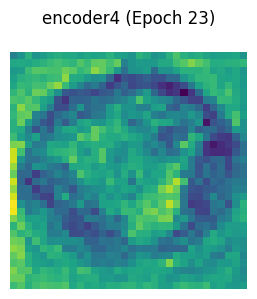

encoder5: torch.Size([3, 48, 16, 16])


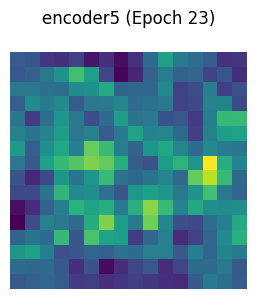

encoder6: torch.Size([3, 64, 8, 8])


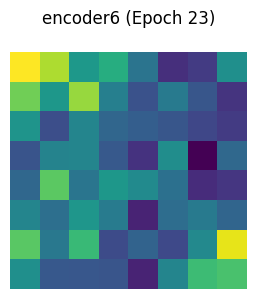

decoder1: torch.Size([3, 48, 8, 8])


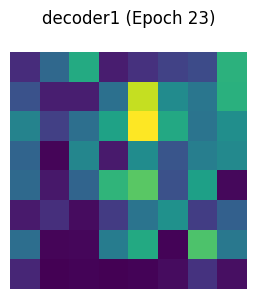

decoder2: torch.Size([3, 32, 8, 8])


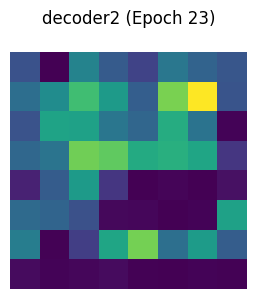

decoder3: torch.Size([3, 24, 16, 16])


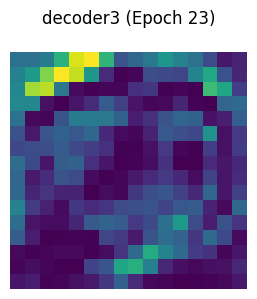

decoder4: torch.Size([3, 16, 32, 32])


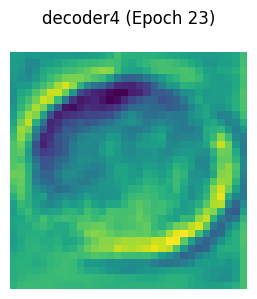

decoder5: torch.Size([3, 8, 64, 64])


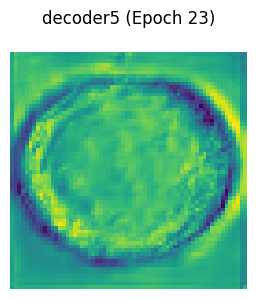

Epoch 23: Loss = 91.3961, Val Dice = 0.8431, Val mIoU = 0.7310, Val Accuracy = 0.9579, Val Sensitivity = 0.8549, Val Specificity = 0.9730


Epoch 24/100: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


[Epoch 24] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


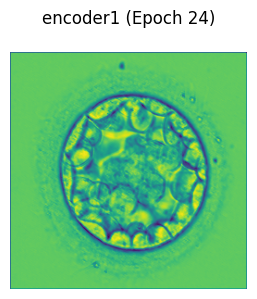

encoder2: torch.Size([3, 16, 128, 128])


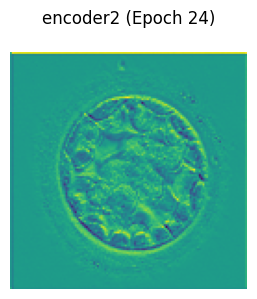

encoder3: torch.Size([3, 24, 64, 64])


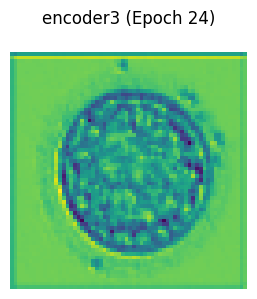

encoder4: torch.Size([3, 32, 32, 32])


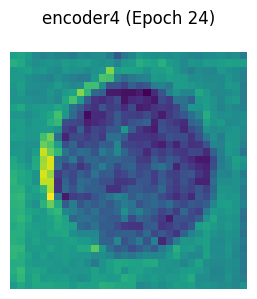

encoder5: torch.Size([3, 48, 16, 16])


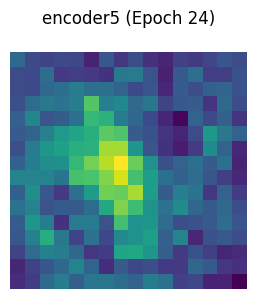

encoder6: torch.Size([3, 64, 8, 8])


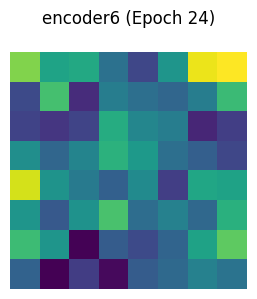

decoder1: torch.Size([3, 48, 8, 8])


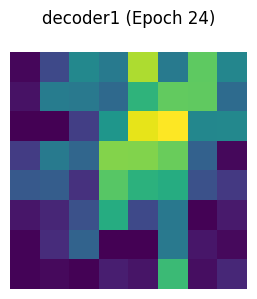

decoder2: torch.Size([3, 32, 8, 8])


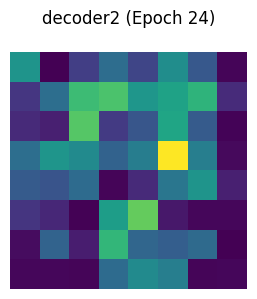

decoder3: torch.Size([3, 24, 16, 16])


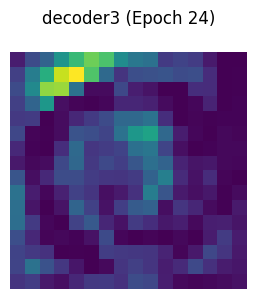

decoder4: torch.Size([3, 16, 32, 32])


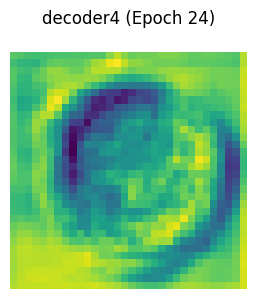

decoder5: torch.Size([3, 8, 64, 64])


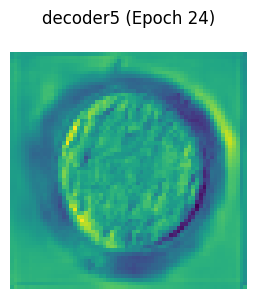

Epoch 24: Loss = 90.8609, Val Dice = 0.8506, Val mIoU = 0.7410, Val Accuracy = 0.9589, Val Sensitivity = 0.8574, Val Specificity = 0.9748


Epoch 25/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 25] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


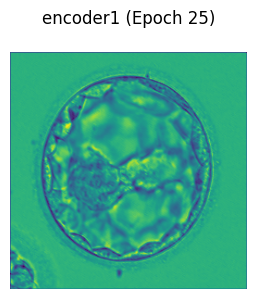

encoder2: torch.Size([3, 16, 128, 128])


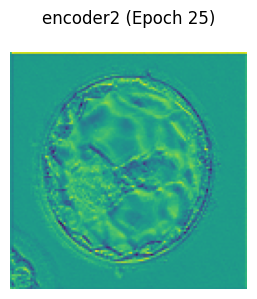

encoder3: torch.Size([3, 24, 64, 64])


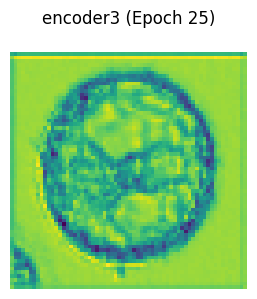

encoder4: torch.Size([3, 32, 32, 32])


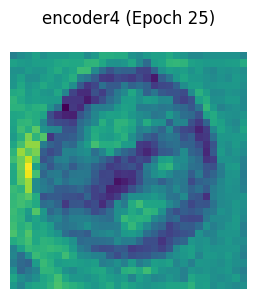

encoder5: torch.Size([3, 48, 16, 16])


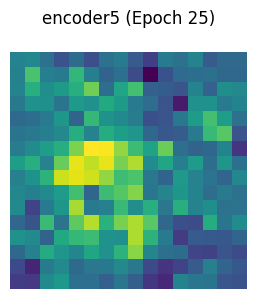

encoder6: torch.Size([3, 64, 8, 8])


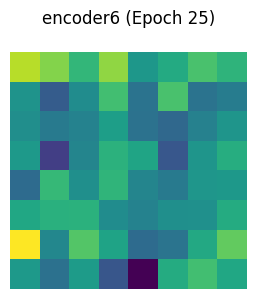

decoder1: torch.Size([3, 48, 8, 8])


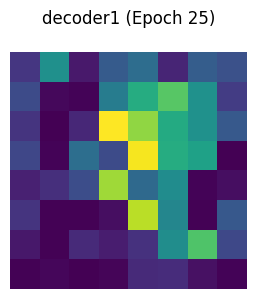

decoder2: torch.Size([3, 32, 8, 8])


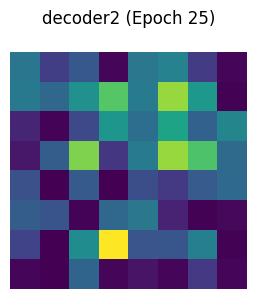

decoder3: torch.Size([3, 24, 16, 16])


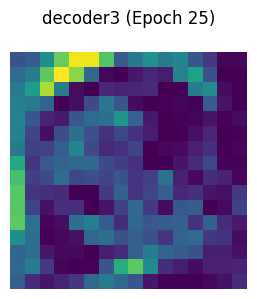

decoder4: torch.Size([3, 16, 32, 32])


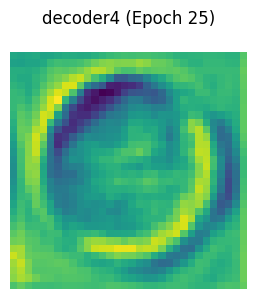

decoder5: torch.Size([3, 8, 64, 64])


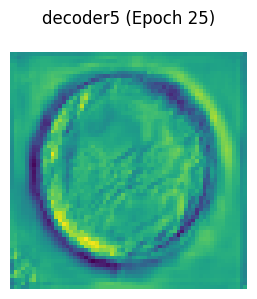

Epoch 25: Loss = 90.4980, Val Dice = 0.8467, Val mIoU = 0.7357, Val Accuracy = 0.9594, Val Sensitivity = 0.8379, Val Specificity = 0.9777


Epoch 26/100: 100%|██████████| 125/125 [01:37<00:00,  1.28it/s]


[Epoch 26] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


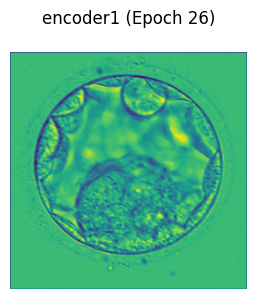

encoder2: torch.Size([3, 16, 128, 128])


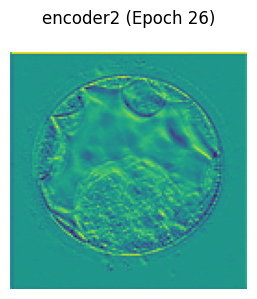

encoder3: torch.Size([3, 24, 64, 64])


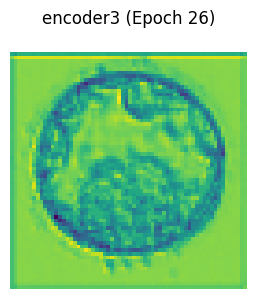

encoder4: torch.Size([3, 32, 32, 32])


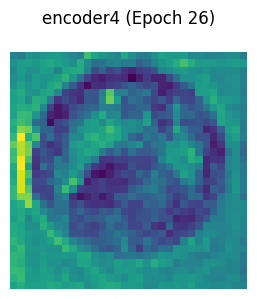

encoder5: torch.Size([3, 48, 16, 16])


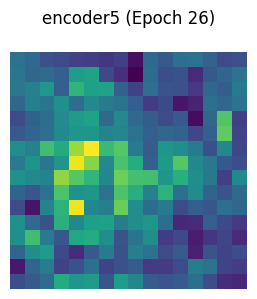

encoder6: torch.Size([3, 64, 8, 8])


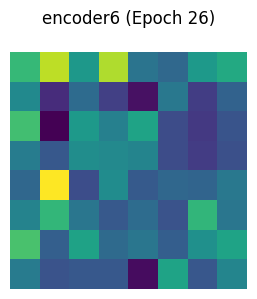

decoder1: torch.Size([3, 48, 8, 8])


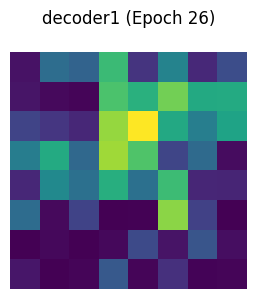

decoder2: torch.Size([3, 32, 8, 8])


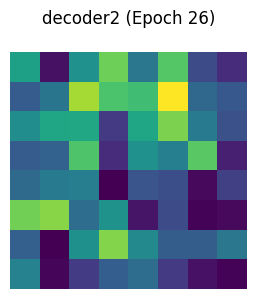

decoder3: torch.Size([3, 24, 16, 16])


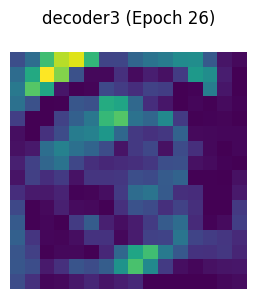

decoder4: torch.Size([3, 16, 32, 32])


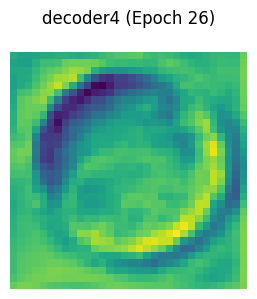

decoder5: torch.Size([3, 8, 64, 64])


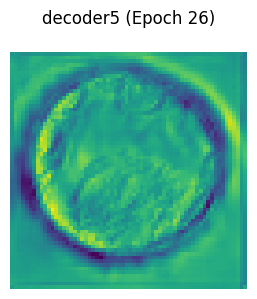

Epoch 26: Loss = 90.0528, Val Dice = 0.8544, Val mIoU = 0.7464, Val Accuracy = 0.9605, Val Sensitivity = 0.8468, Val Specificity = 0.9786


Epoch 27/100: 100%|██████████| 125/125 [01:38<00:00,  1.26it/s]


[Epoch 27] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


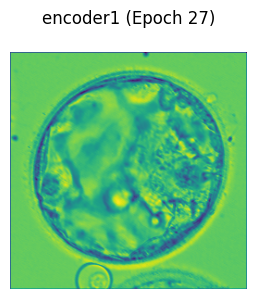

encoder2: torch.Size([3, 16, 128, 128])


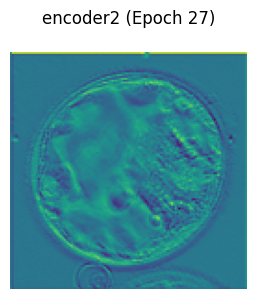

encoder3: torch.Size([3, 24, 64, 64])


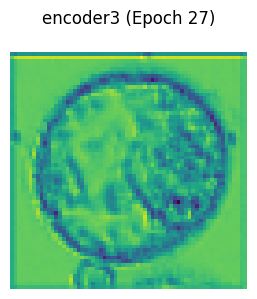

encoder4: torch.Size([3, 32, 32, 32])


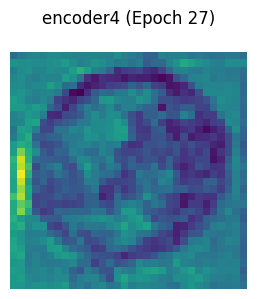

encoder5: torch.Size([3, 48, 16, 16])


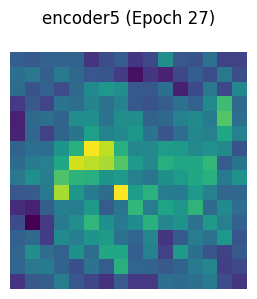

encoder6: torch.Size([3, 64, 8, 8])


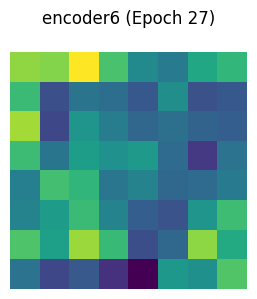

decoder1: torch.Size([3, 48, 8, 8])


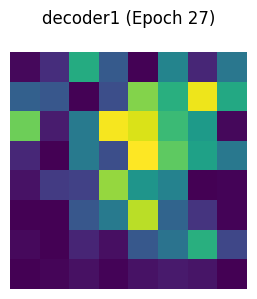

decoder2: torch.Size([3, 32, 8, 8])


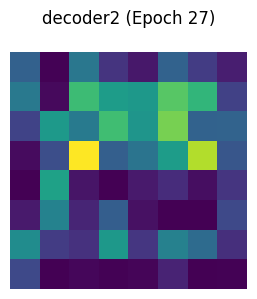

decoder3: torch.Size([3, 24, 16, 16])


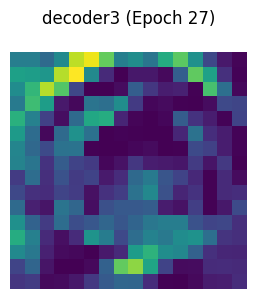

decoder4: torch.Size([3, 16, 32, 32])


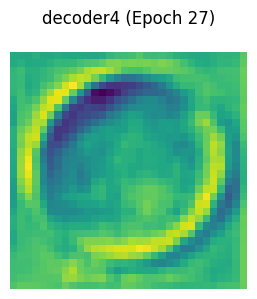

decoder5: torch.Size([3, 8, 64, 64])


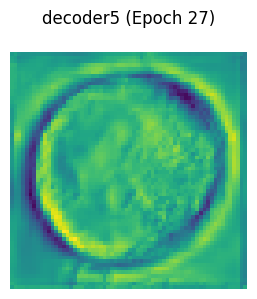

Epoch 27: Loss = 89.8120, Val Dice = 0.8496, Val mIoU = 0.7393, Val Accuracy = 0.9582, Val Sensitivity = 0.8641, Val Specificity = 0.9725


Epoch 28/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 28] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


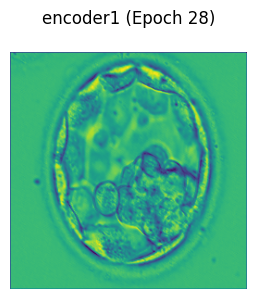

encoder2: torch.Size([3, 16, 128, 128])


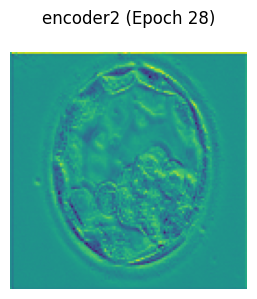

encoder3: torch.Size([3, 24, 64, 64])


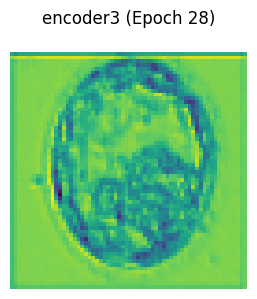

encoder4: torch.Size([3, 32, 32, 32])


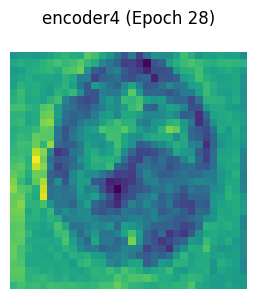

encoder5: torch.Size([3, 48, 16, 16])


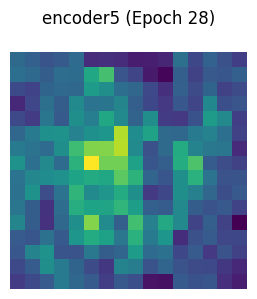

encoder6: torch.Size([3, 64, 8, 8])


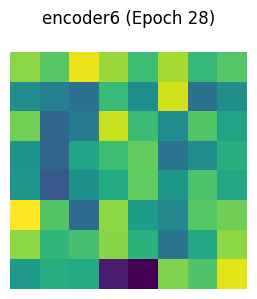

decoder1: torch.Size([3, 48, 8, 8])


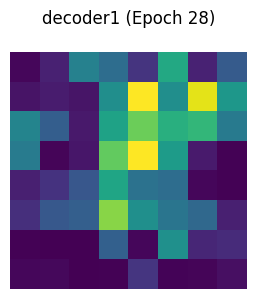

decoder2: torch.Size([3, 32, 8, 8])


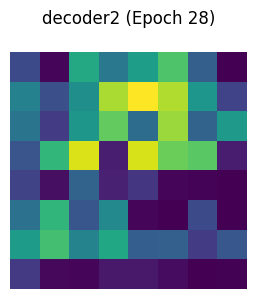

decoder3: torch.Size([3, 24, 16, 16])


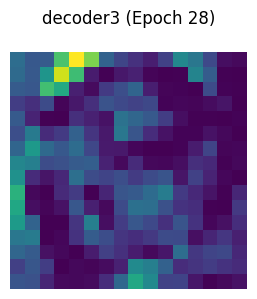

decoder4: torch.Size([3, 16, 32, 32])


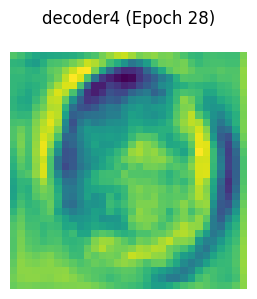

decoder5: torch.Size([3, 8, 64, 64])


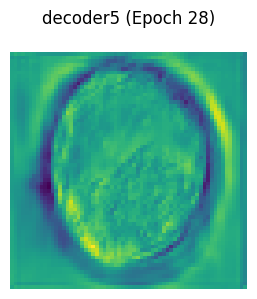

Epoch 28: Loss = 89.2772, Val Dice = 0.8417, Val mIoU = 0.7284, Val Accuracy = 0.9575, Val Sensitivity = 0.8452, Val Specificity = 0.9746


Epoch 29/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 29] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


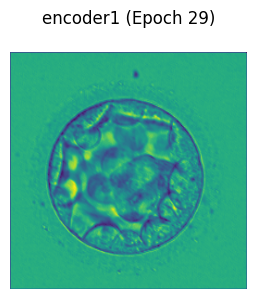

encoder2: torch.Size([3, 16, 128, 128])


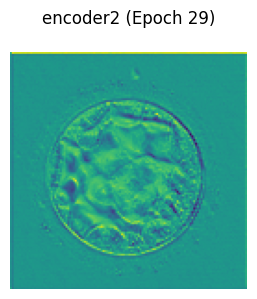

encoder3: torch.Size([3, 24, 64, 64])


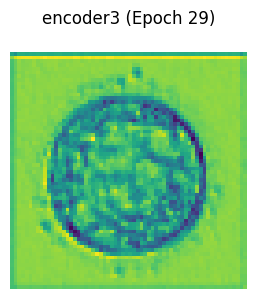

encoder4: torch.Size([3, 32, 32, 32])


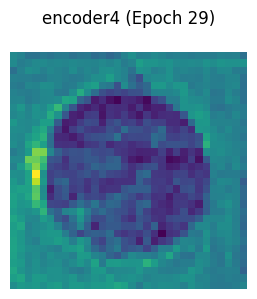

encoder5: torch.Size([3, 48, 16, 16])


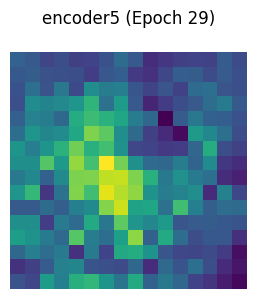

encoder6: torch.Size([3, 64, 8, 8])


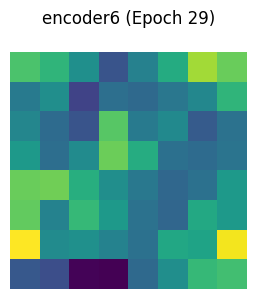

decoder1: torch.Size([3, 48, 8, 8])


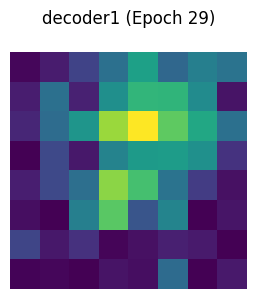

decoder2: torch.Size([3, 32, 8, 8])


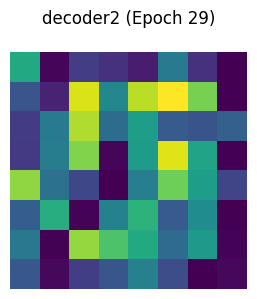

decoder3: torch.Size([3, 24, 16, 16])


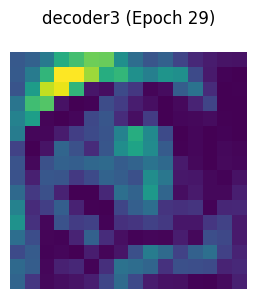

decoder4: torch.Size([3, 16, 32, 32])


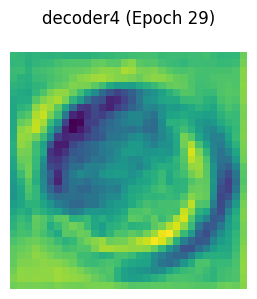

decoder5: torch.Size([3, 8, 64, 64])


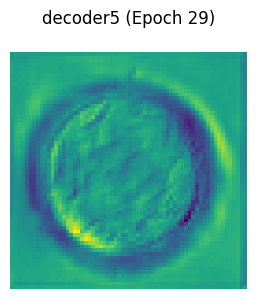

Epoch 29: Loss = 89.0345, Val Dice = 0.8456, Val mIoU = 0.7339, Val Accuracy = 0.9580, Val Sensitivity = 0.8524, Val Specificity = 0.9743


Epoch 30/100: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


[Epoch 30] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


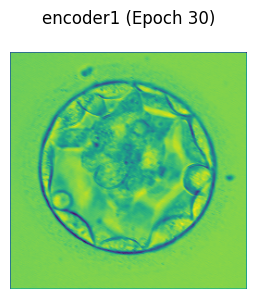

encoder2: torch.Size([3, 16, 128, 128])


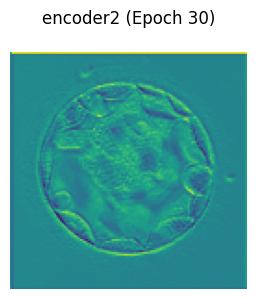

encoder3: torch.Size([3, 24, 64, 64])


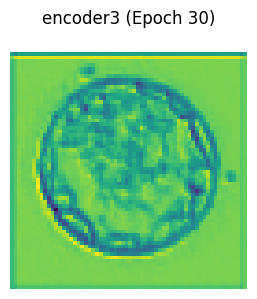

encoder4: torch.Size([3, 32, 32, 32])


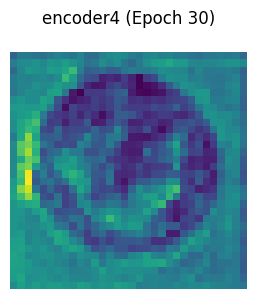

encoder5: torch.Size([3, 48, 16, 16])


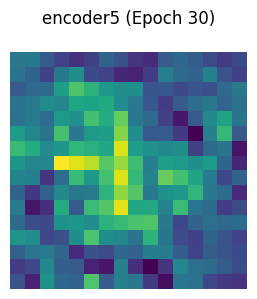

encoder6: torch.Size([3, 64, 8, 8])


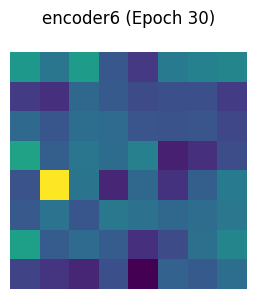

decoder1: torch.Size([3, 48, 8, 8])


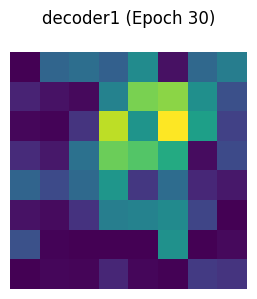

decoder2: torch.Size([3, 32, 8, 8])


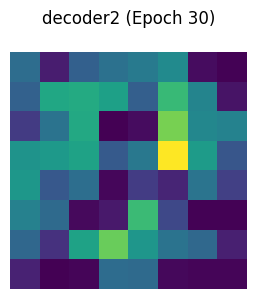

decoder3: torch.Size([3, 24, 16, 16])


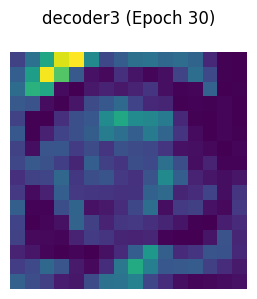

decoder4: torch.Size([3, 16, 32, 32])


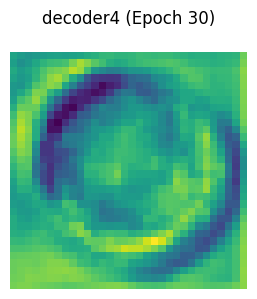

decoder5: torch.Size([3, 8, 64, 64])


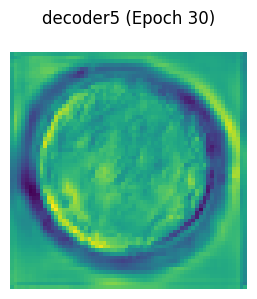

Epoch 30: Loss = 88.6885, Val Dice = 0.8394, Val mIoU = 0.7248, Val Accuracy = 0.9566, Val Sensitivity = 0.8419, Val Specificity = 0.9743


Epoch 31/100: 100%|██████████| 125/125 [01:37<00:00,  1.29it/s]


[Epoch 31] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


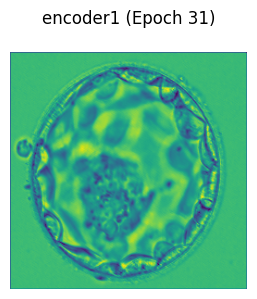

encoder2: torch.Size([3, 16, 128, 128])


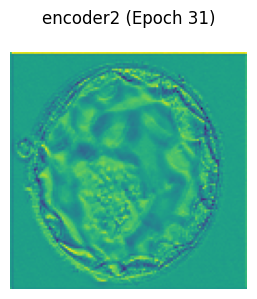

encoder3: torch.Size([3, 24, 64, 64])


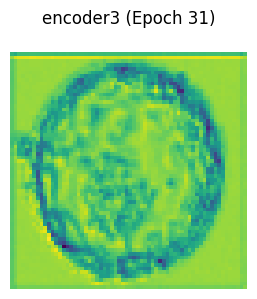

encoder4: torch.Size([3, 32, 32, 32])


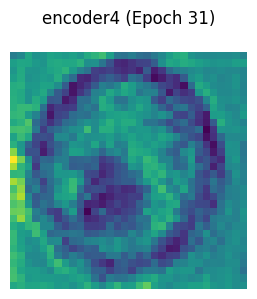

encoder5: torch.Size([3, 48, 16, 16])


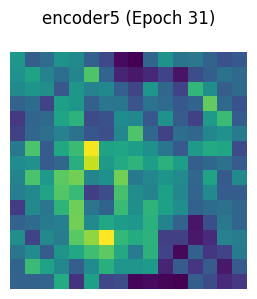

encoder6: torch.Size([3, 64, 8, 8])


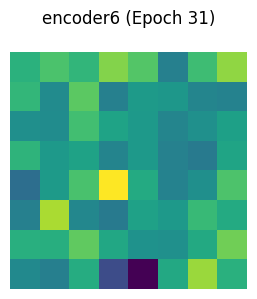

decoder1: torch.Size([3, 48, 8, 8])


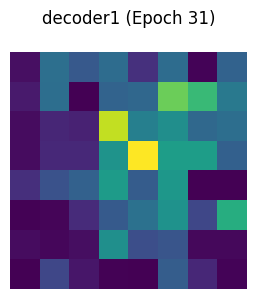

decoder2: torch.Size([3, 32, 8, 8])


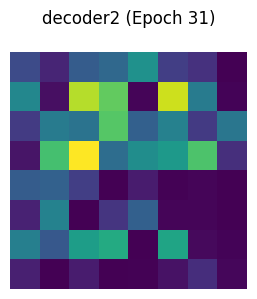

decoder3: torch.Size([3, 24, 16, 16])


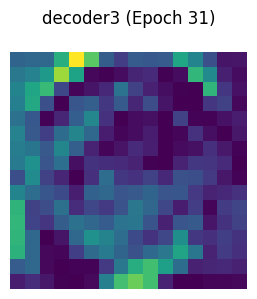

decoder4: torch.Size([3, 16, 32, 32])


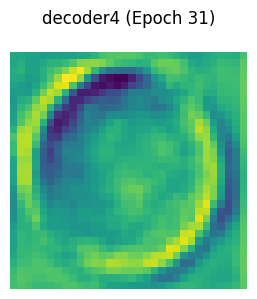

decoder5: torch.Size([3, 8, 64, 64])


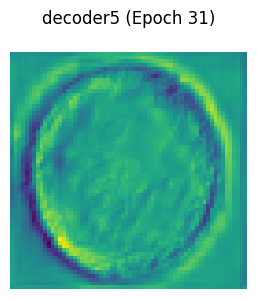

Epoch 31: Loss = 88.3723, Val Dice = 0.8425, Val mIoU = 0.7296, Val Accuracy = 0.9584, Val Sensitivity = 0.8312, Val Specificity = 0.9781


Epoch 32/100: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


[Epoch 32] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


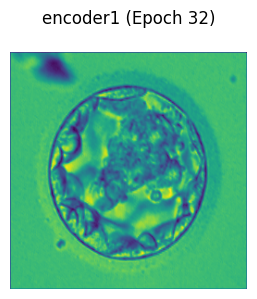

encoder2: torch.Size([3, 16, 128, 128])


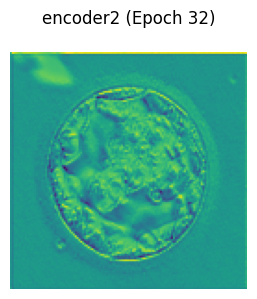

encoder3: torch.Size([3, 24, 64, 64])


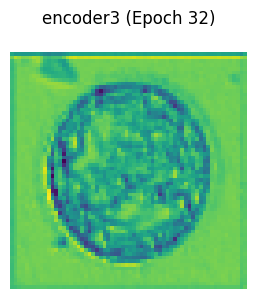

encoder4: torch.Size([3, 32, 32, 32])


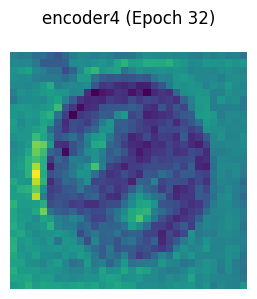

encoder5: torch.Size([3, 48, 16, 16])


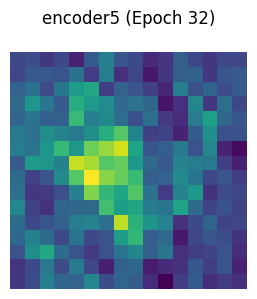

encoder6: torch.Size([3, 64, 8, 8])


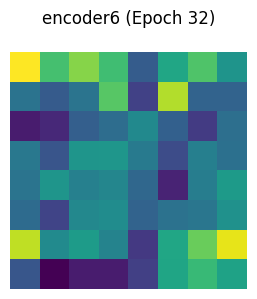

decoder1: torch.Size([3, 48, 8, 8])


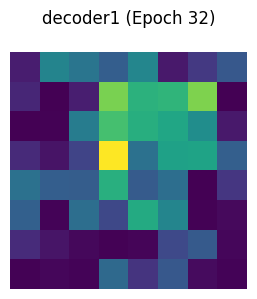

decoder2: torch.Size([3, 32, 8, 8])


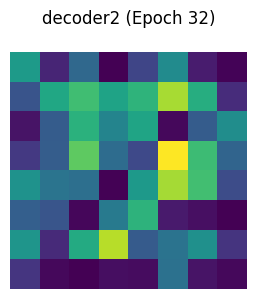

decoder3: torch.Size([3, 24, 16, 16])


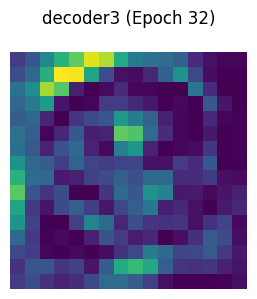

decoder4: torch.Size([3, 16, 32, 32])


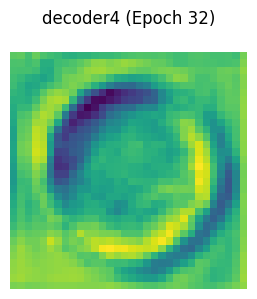

decoder5: torch.Size([3, 8, 64, 64])


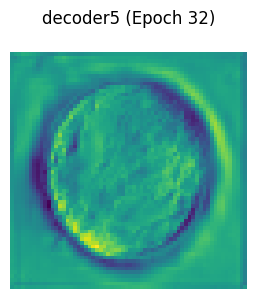

Epoch 32: Loss = 88.2220, Val Dice = 0.8408, Val mIoU = 0.7269, Val Accuracy = 0.9576, Val Sensitivity = 0.8322, Val Specificity = 0.9768


Epoch 33/100: 100%|██████████| 125/125 [01:37<00:00,  1.28it/s]


[Epoch 33] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


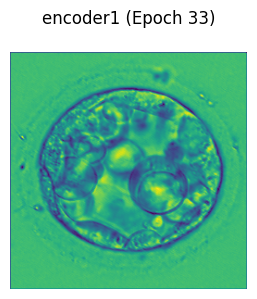

encoder2: torch.Size([3, 16, 128, 128])


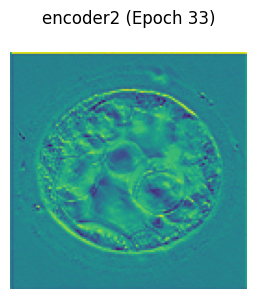

encoder3: torch.Size([3, 24, 64, 64])


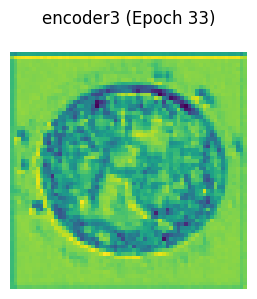

encoder4: torch.Size([3, 32, 32, 32])


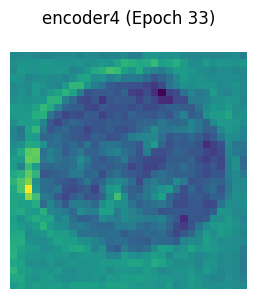

encoder5: torch.Size([3, 48, 16, 16])


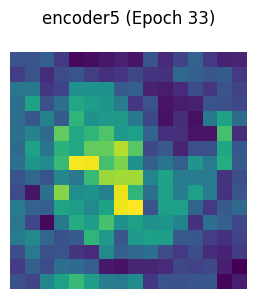

encoder6: torch.Size([3, 64, 8, 8])


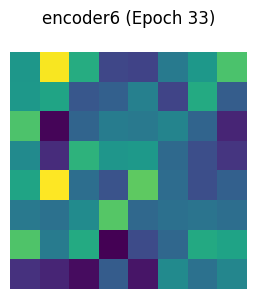

decoder1: torch.Size([3, 48, 8, 8])


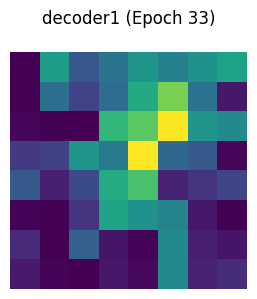

decoder2: torch.Size([3, 32, 8, 8])


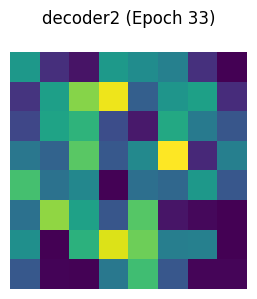

decoder3: torch.Size([3, 24, 16, 16])


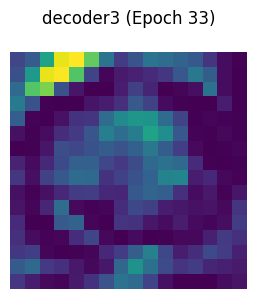

decoder4: torch.Size([3, 16, 32, 32])


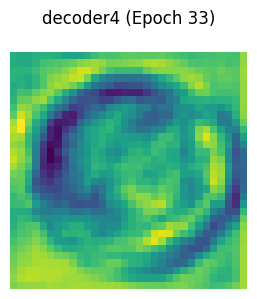

decoder5: torch.Size([3, 8, 64, 64])


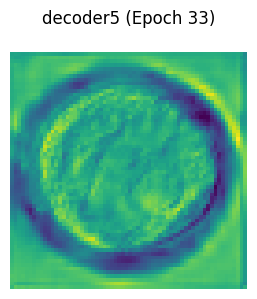

Epoch 33: Loss = 87.7926, Val Dice = 0.8463, Val mIoU = 0.7346, Val Accuracy = 0.9578, Val Sensitivity = 0.8582, Val Specificity = 0.9730


Epoch 34/100: 100%|██████████| 125/125 [01:36<00:00,  1.29it/s]


[Epoch 34] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


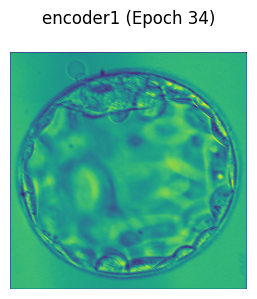

encoder2: torch.Size([3, 16, 128, 128])


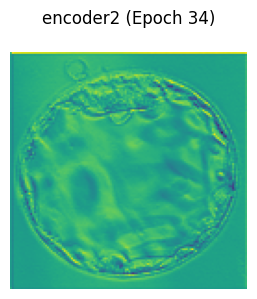

encoder3: torch.Size([3, 24, 64, 64])


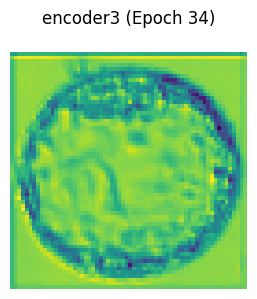

encoder4: torch.Size([3, 32, 32, 32])


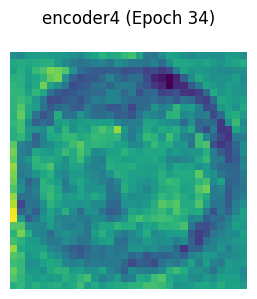

encoder5: torch.Size([3, 48, 16, 16])


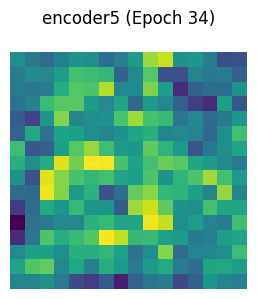

encoder6: torch.Size([3, 64, 8, 8])


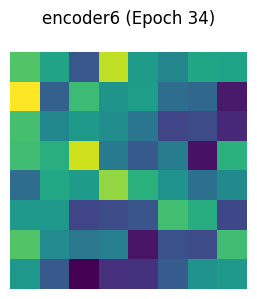

decoder1: torch.Size([3, 48, 8, 8])


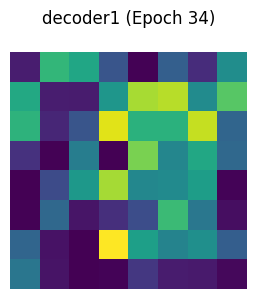

decoder2: torch.Size([3, 32, 8, 8])


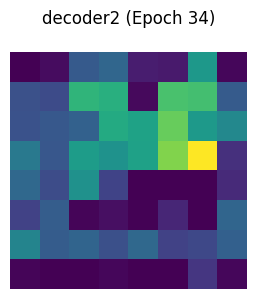

decoder3: torch.Size([3, 24, 16, 16])


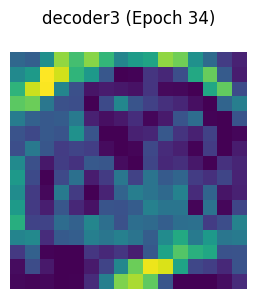

decoder4: torch.Size([3, 16, 32, 32])


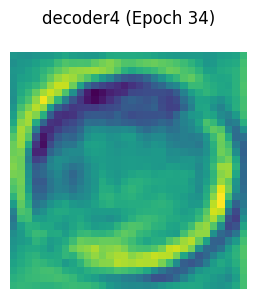

decoder5: torch.Size([3, 8, 64, 64])


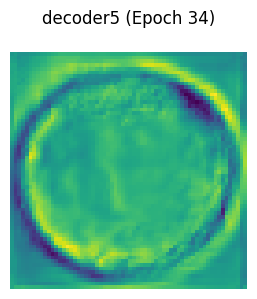

Epoch 34: Loss = 87.4571, Val Dice = 0.8419, Val mIoU = 0.7286, Val Accuracy = 0.9573, Val Sensitivity = 0.8482, Val Specificity = 0.9741


Epoch 35/100: 100%|██████████| 125/125 [01:37<00:00,  1.28it/s]


[Epoch 35] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


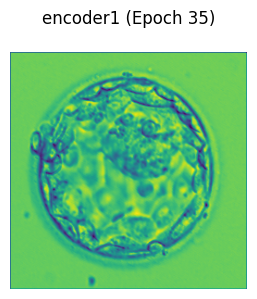

encoder2: torch.Size([3, 16, 128, 128])


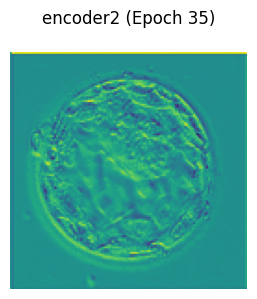

encoder3: torch.Size([3, 24, 64, 64])


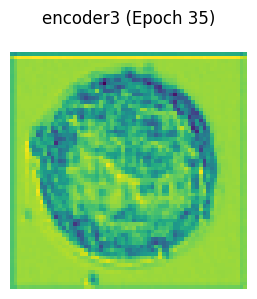

encoder4: torch.Size([3, 32, 32, 32])


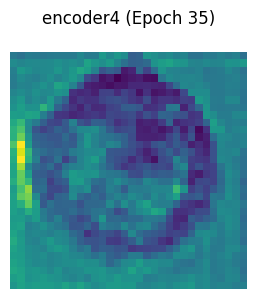

encoder5: torch.Size([3, 48, 16, 16])


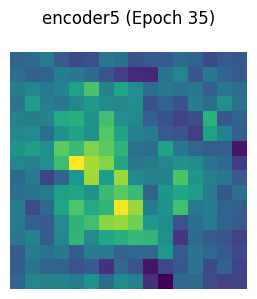

encoder6: torch.Size([3, 64, 8, 8])


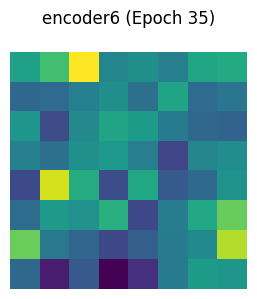

decoder1: torch.Size([3, 48, 8, 8])


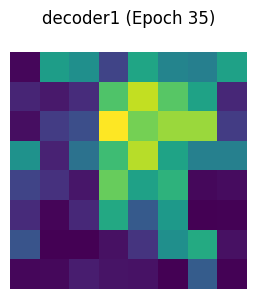

decoder2: torch.Size([3, 32, 8, 8])


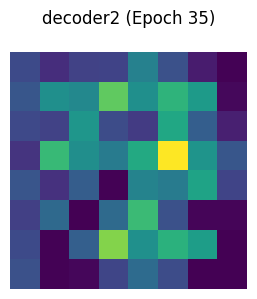

decoder3: torch.Size([3, 24, 16, 16])


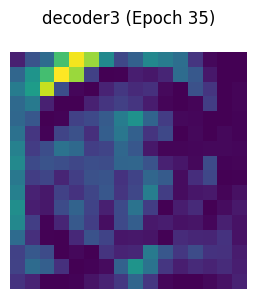

decoder4: torch.Size([3, 16, 32, 32])


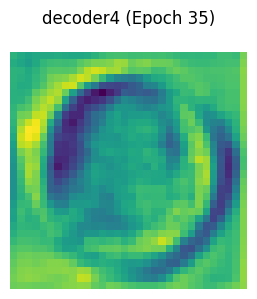

decoder5: torch.Size([3, 8, 64, 64])


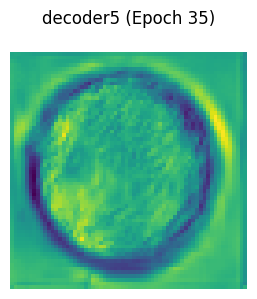

Epoch 35: Loss = 87.2791, Val Dice = 0.8404, Val mIoU = 0.7261, Val Accuracy = 0.9567, Val Sensitivity = 0.8455, Val Specificity = 0.9736


Epoch 36/100: 100%|██████████| 125/125 [01:37<00:00,  1.28it/s]


[Epoch 36] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


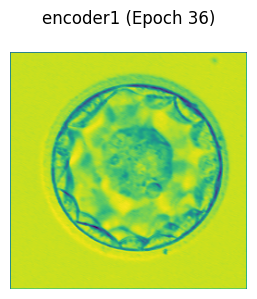

encoder2: torch.Size([3, 16, 128, 128])


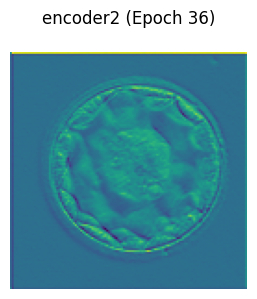

encoder3: torch.Size([3, 24, 64, 64])


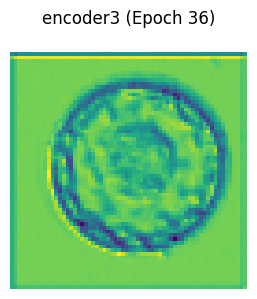

encoder4: torch.Size([3, 32, 32, 32])


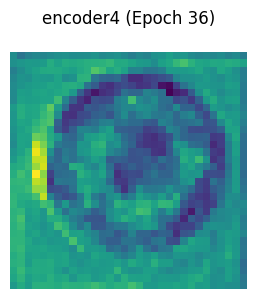

encoder5: torch.Size([3, 48, 16, 16])


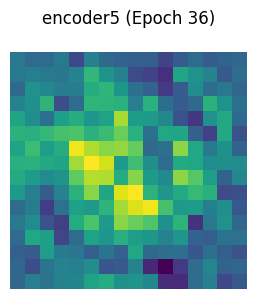

encoder6: torch.Size([3, 64, 8, 8])


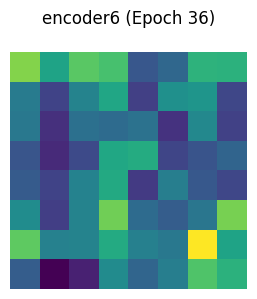

decoder1: torch.Size([3, 48, 8, 8])


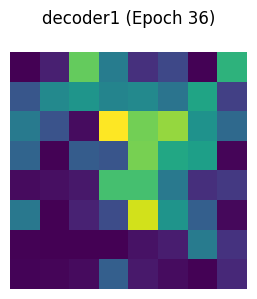

decoder2: torch.Size([3, 32, 8, 8])


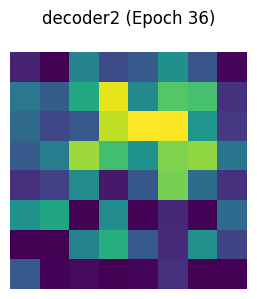

decoder3: torch.Size([3, 24, 16, 16])


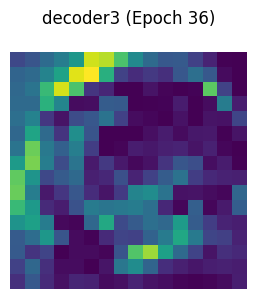

decoder4: torch.Size([3, 16, 32, 32])


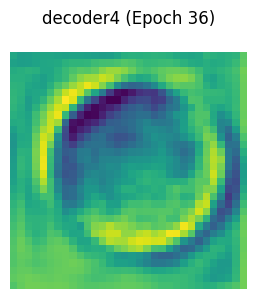

decoder5: torch.Size([3, 8, 64, 64])


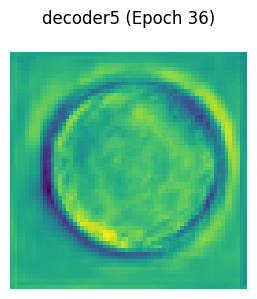

Epoch 36: Loss = 87.0382, Val Dice = 0.8383, Val mIoU = 0.7232, Val Accuracy = 0.9567, Val Sensitivity = 0.8355, Val Specificity = 0.9752


Epoch 37/100: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


[Epoch 37] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


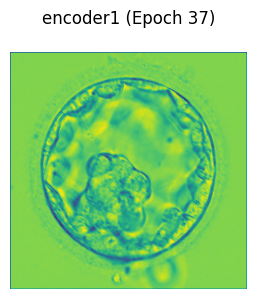

encoder2: torch.Size([3, 16, 128, 128])


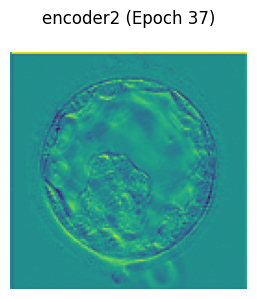

encoder3: torch.Size([3, 24, 64, 64])


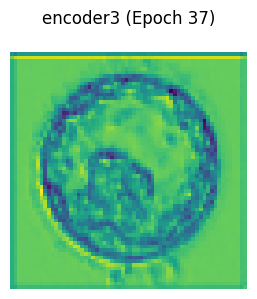

encoder4: torch.Size([3, 32, 32, 32])


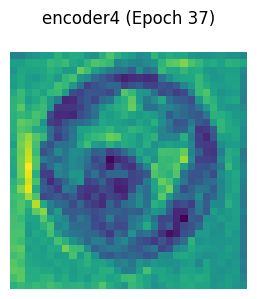

encoder5: torch.Size([3, 48, 16, 16])


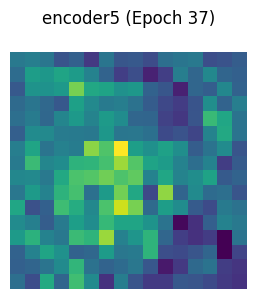

encoder6: torch.Size([3, 64, 8, 8])


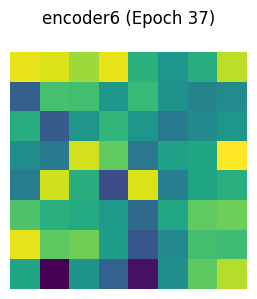

decoder1: torch.Size([3, 48, 8, 8])


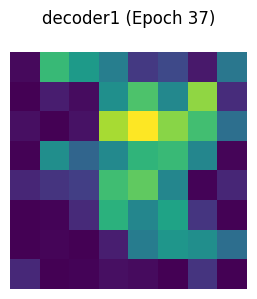

decoder2: torch.Size([3, 32, 8, 8])


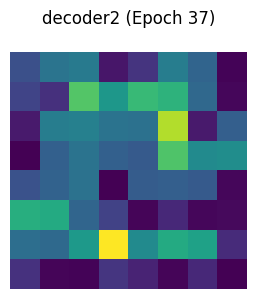

decoder3: torch.Size([3, 24, 16, 16])


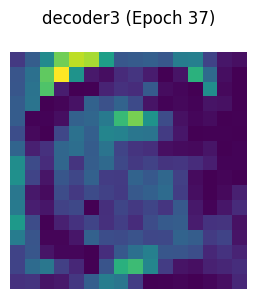

decoder4: torch.Size([3, 16, 32, 32])


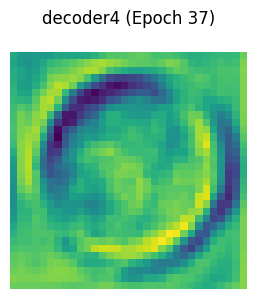

decoder5: torch.Size([3, 8, 64, 64])


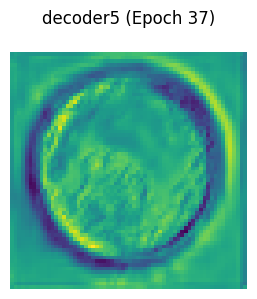

Epoch 37: Loss = 86.7384, Val Dice = 0.8367, Val mIoU = 0.7208, Val Accuracy = 0.9565, Val Sensitivity = 0.8284, Val Specificity = 0.9761


Epoch 38/100: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


[Epoch 38] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


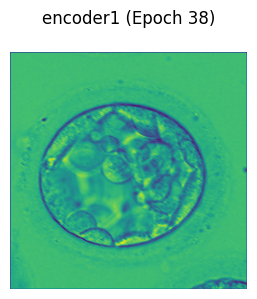

encoder2: torch.Size([3, 16, 128, 128])


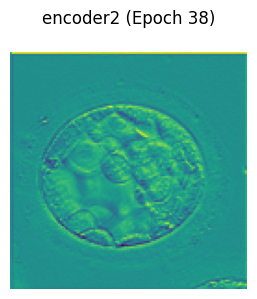

encoder3: torch.Size([3, 24, 64, 64])


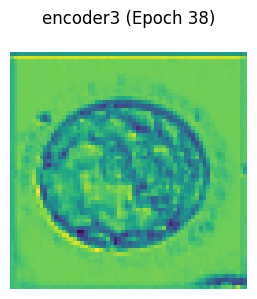

encoder4: torch.Size([3, 32, 32, 32])


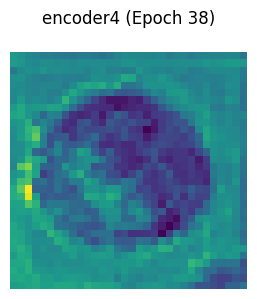

encoder5: torch.Size([3, 48, 16, 16])


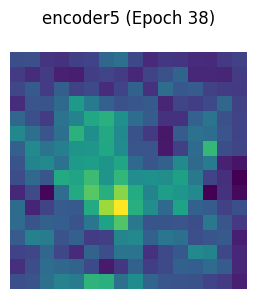

encoder6: torch.Size([3, 64, 8, 8])


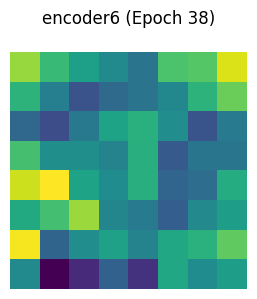

decoder1: torch.Size([3, 48, 8, 8])


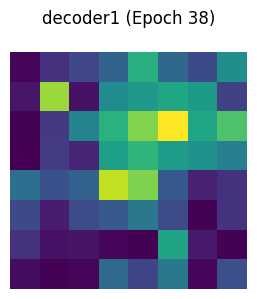

decoder2: torch.Size([3, 32, 8, 8])


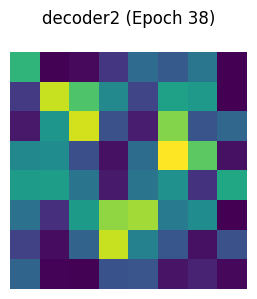

decoder3: torch.Size([3, 24, 16, 16])


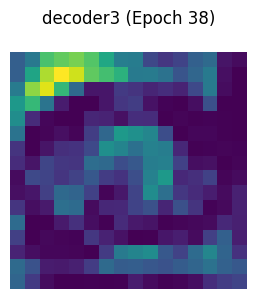

decoder4: torch.Size([3, 16, 32, 32])


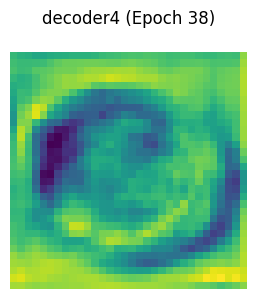

decoder5: torch.Size([3, 8, 64, 64])


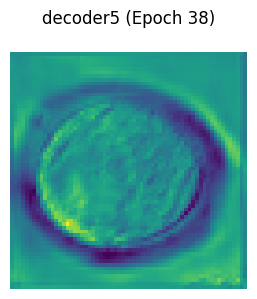

Epoch 38: Loss = 86.5049, Val Dice = 0.8369, Val mIoU = 0.7210, Val Accuracy = 0.9561, Val Sensitivity = 0.8365, Val Specificity = 0.9743


Epoch 39/100: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


[Epoch 39] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


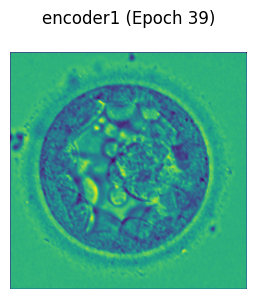

encoder2: torch.Size([3, 16, 128, 128])


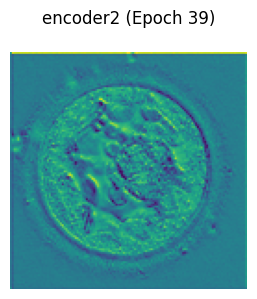

encoder3: torch.Size([3, 24, 64, 64])


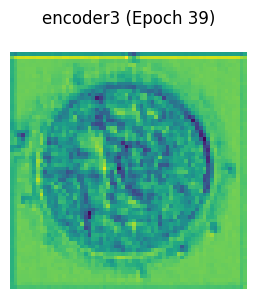

encoder4: torch.Size([3, 32, 32, 32])


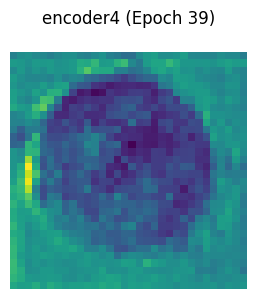

encoder5: torch.Size([3, 48, 16, 16])


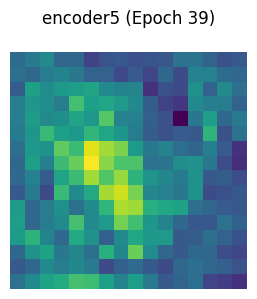

encoder6: torch.Size([3, 64, 8, 8])


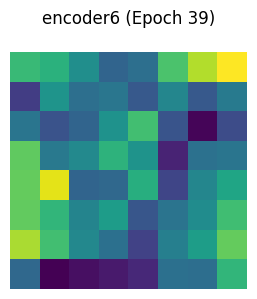

decoder1: torch.Size([3, 48, 8, 8])


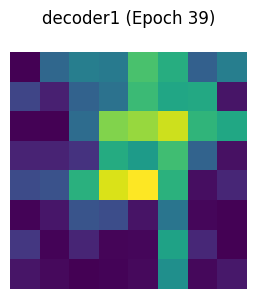

decoder2: torch.Size([3, 32, 8, 8])


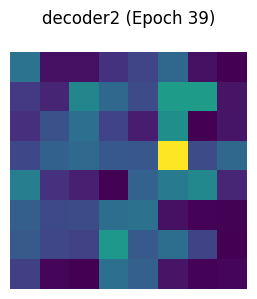

decoder3: torch.Size([3, 24, 16, 16])


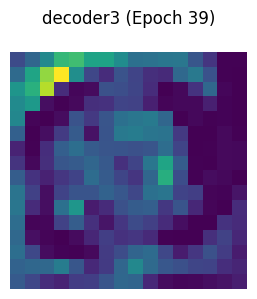

decoder4: torch.Size([3, 16, 32, 32])


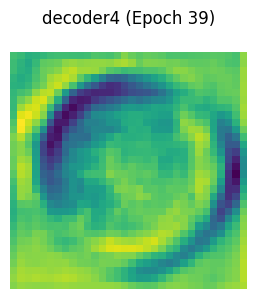

decoder5: torch.Size([3, 8, 64, 64])


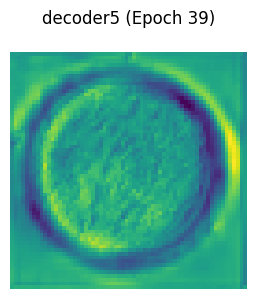

Epoch 39: Loss = 86.2646, Val Dice = 0.8369, Val mIoU = 0.7210, Val Accuracy = 0.9561, Val Sensitivity = 0.8346, Val Specificity = 0.9748


Epoch 40/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 40] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


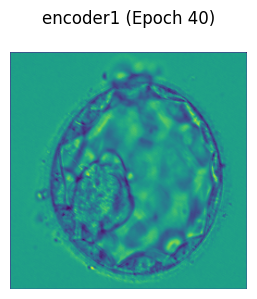

encoder2: torch.Size([3, 16, 128, 128])


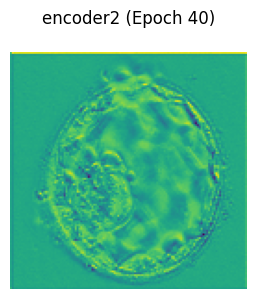

encoder3: torch.Size([3, 24, 64, 64])


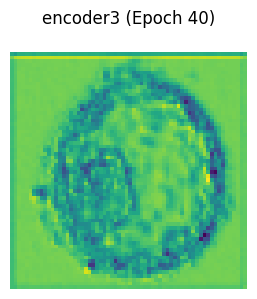

encoder4: torch.Size([3, 32, 32, 32])


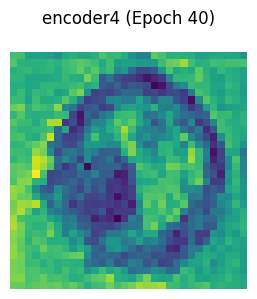

encoder5: torch.Size([3, 48, 16, 16])


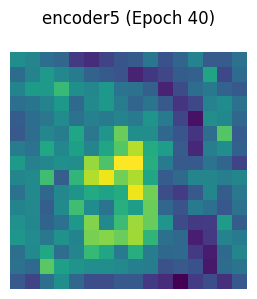

encoder6: torch.Size([3, 64, 8, 8])


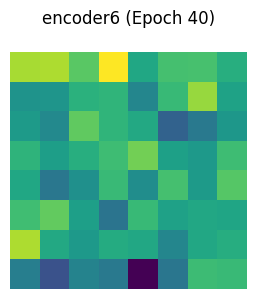

decoder1: torch.Size([3, 48, 8, 8])


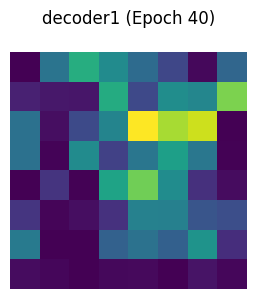

decoder2: torch.Size([3, 32, 8, 8])


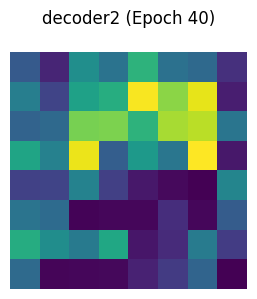

decoder3: torch.Size([3, 24, 16, 16])


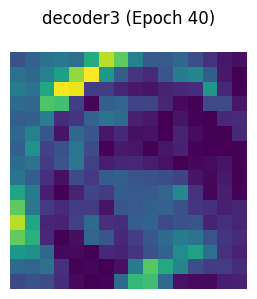

decoder4: torch.Size([3, 16, 32, 32])


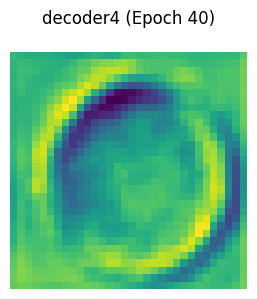

decoder5: torch.Size([3, 8, 64, 64])


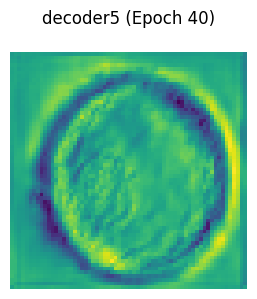

Epoch 40: Loss = 86.1630, Val Dice = 0.8334, Val mIoU = 0.7163, Val Accuracy = 0.9555, Val Sensitivity = 0.8306, Val Specificity = 0.9745


Epoch 41/100: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


[Epoch 41] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


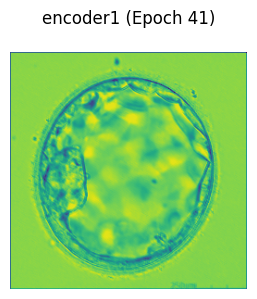

encoder2: torch.Size([3, 16, 128, 128])


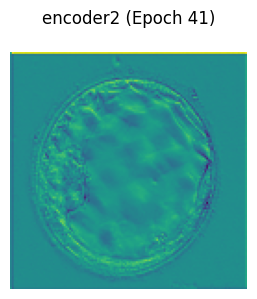

encoder3: torch.Size([3, 24, 64, 64])


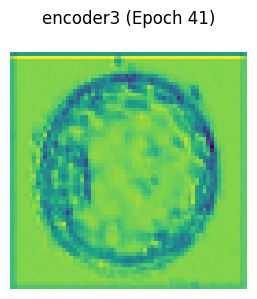

encoder4: torch.Size([3, 32, 32, 32])


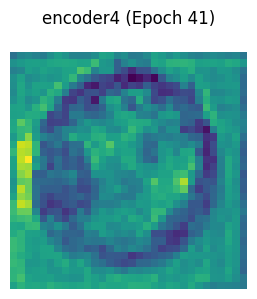

encoder5: torch.Size([3, 48, 16, 16])


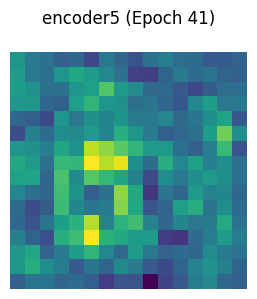

encoder6: torch.Size([3, 64, 8, 8])


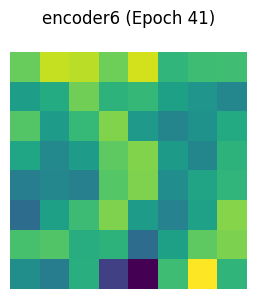

decoder1: torch.Size([3, 48, 8, 8])


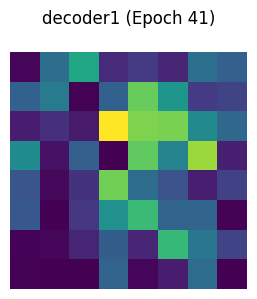

decoder2: torch.Size([3, 32, 8, 8])


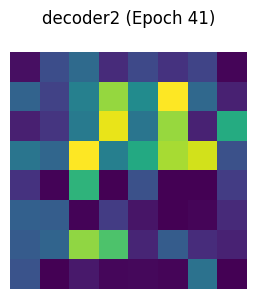

decoder3: torch.Size([3, 24, 16, 16])


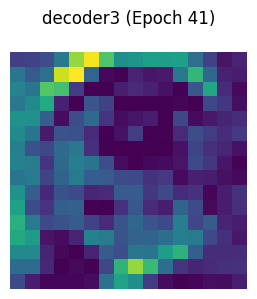

decoder4: torch.Size([3, 16, 32, 32])


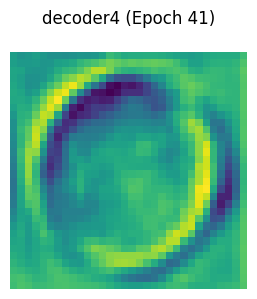

decoder5: torch.Size([3, 8, 64, 64])


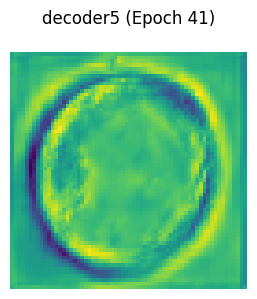

Epoch 41: Loss = 86.0907, Val Dice = 0.8355, Val mIoU = 0.7190, Val Accuracy = 0.9558, Val Sensitivity = 0.8332, Val Specificity = 0.9746


Epoch 42/100: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


[Epoch 42] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


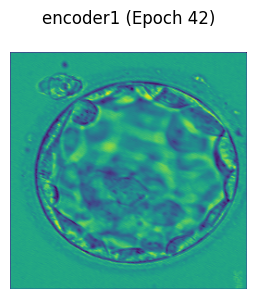

encoder2: torch.Size([3, 16, 128, 128])


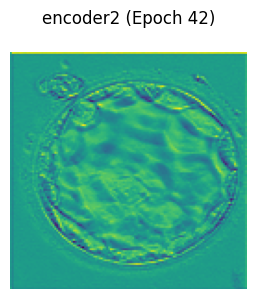

encoder3: torch.Size([3, 24, 64, 64])


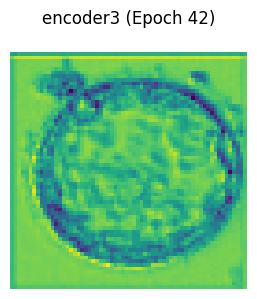

encoder4: torch.Size([3, 32, 32, 32])


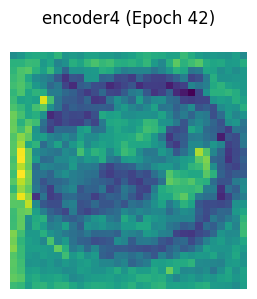

encoder5: torch.Size([3, 48, 16, 16])


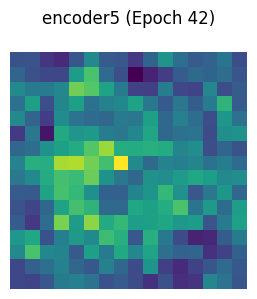

encoder6: torch.Size([3, 64, 8, 8])


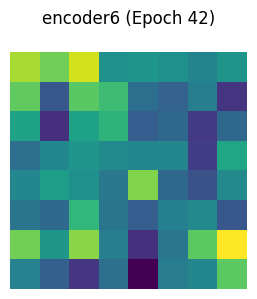

decoder1: torch.Size([3, 48, 8, 8])


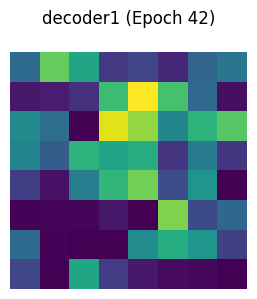

decoder2: torch.Size([3, 32, 8, 8])


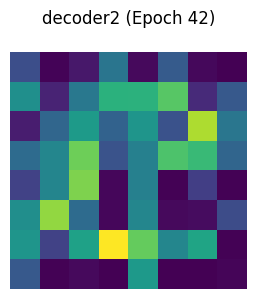

decoder3: torch.Size([3, 24, 16, 16])


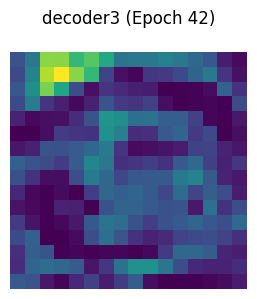

decoder4: torch.Size([3, 16, 32, 32])


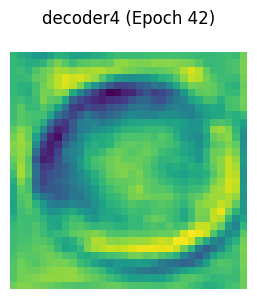

decoder5: torch.Size([3, 8, 64, 64])


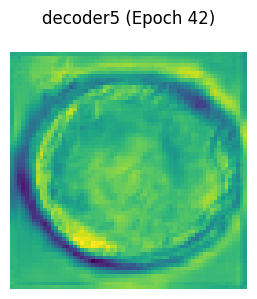

Epoch 42: Loss = 85.9339, Val Dice = 0.8339, Val mIoU = 0.7168, Val Accuracy = 0.9555, Val Sensitivity = 0.8299, Val Specificity = 0.9748


Epoch 43/100: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


[Epoch 43] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


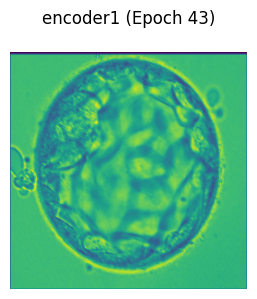

encoder2: torch.Size([3, 16, 128, 128])


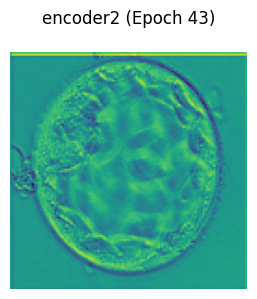

encoder3: torch.Size([3, 24, 64, 64])


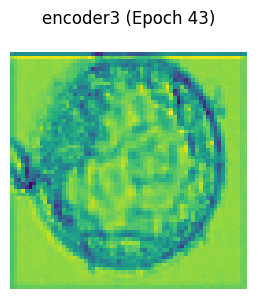

encoder4: torch.Size([3, 32, 32, 32])


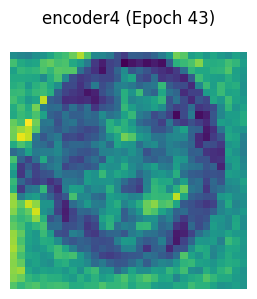

encoder5: torch.Size([3, 48, 16, 16])


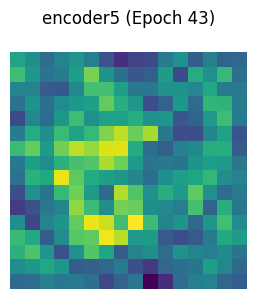

encoder6: torch.Size([3, 64, 8, 8])


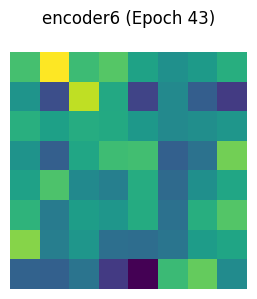

decoder1: torch.Size([3, 48, 8, 8])


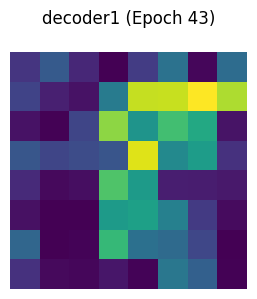

decoder2: torch.Size([3, 32, 8, 8])


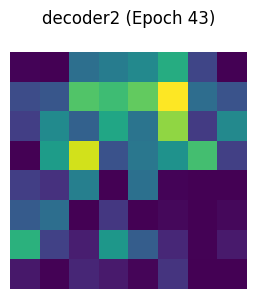

decoder3: torch.Size([3, 24, 16, 16])


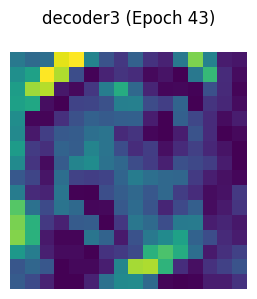

decoder4: torch.Size([3, 16, 32, 32])


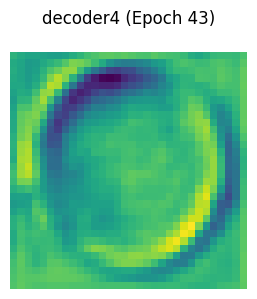

decoder5: torch.Size([3, 8, 64, 64])


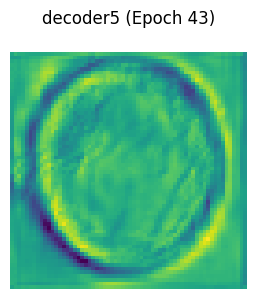

Epoch 43: Loss = 85.8493, Val Dice = 0.8333, Val mIoU = 0.7159, Val Accuracy = 0.9555, Val Sensitivity = 0.8268, Val Specificity = 0.9752


Epoch 44/100: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


[Epoch 44] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


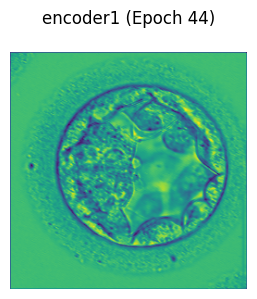

encoder2: torch.Size([3, 16, 128, 128])


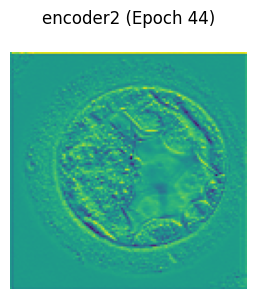

encoder3: torch.Size([3, 24, 64, 64])


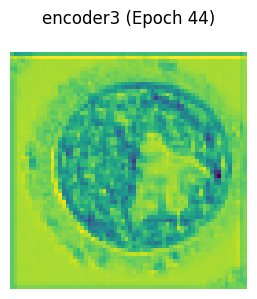

encoder4: torch.Size([3, 32, 32, 32])


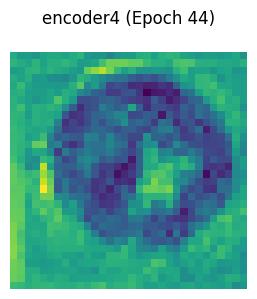

encoder5: torch.Size([3, 48, 16, 16])


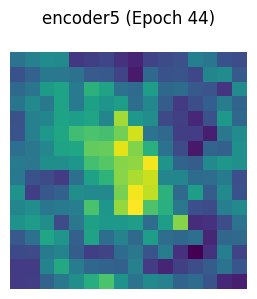

encoder6: torch.Size([3, 64, 8, 8])


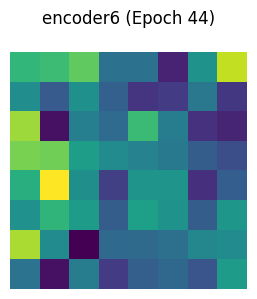

decoder1: torch.Size([3, 48, 8, 8])


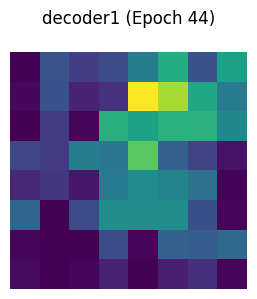

decoder2: torch.Size([3, 32, 8, 8])


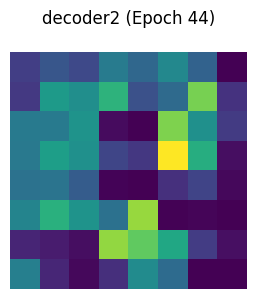

decoder3: torch.Size([3, 24, 16, 16])


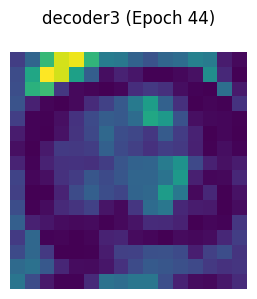

decoder4: torch.Size([3, 16, 32, 32])


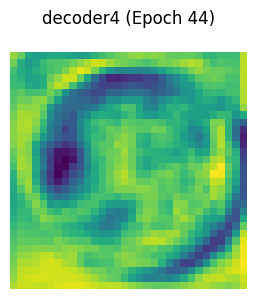

decoder5: torch.Size([3, 8, 64, 64])


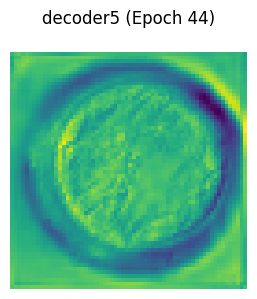

Epoch 44: Loss = 85.7165, Val Dice = 0.8334, Val mIoU = 0.7160, Val Accuracy = 0.9554, Val Sensitivity = 0.8290, Val Specificity = 0.9748


Epoch 45/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 45] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


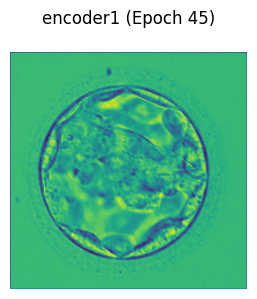

encoder2: torch.Size([3, 16, 128, 128])


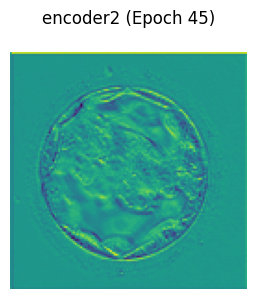

encoder3: torch.Size([3, 24, 64, 64])


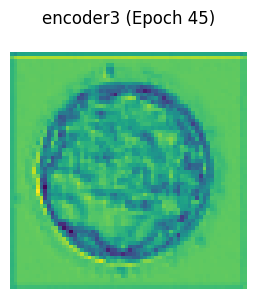

encoder4: torch.Size([3, 32, 32, 32])


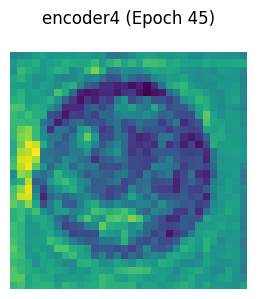

encoder5: torch.Size([3, 48, 16, 16])


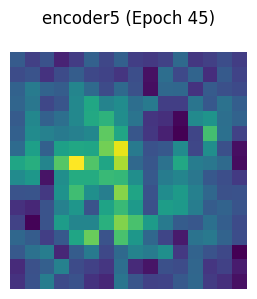

encoder6: torch.Size([3, 64, 8, 8])


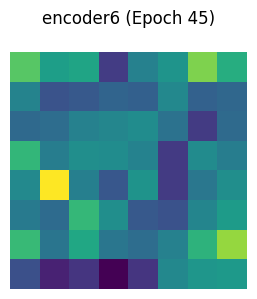

decoder1: torch.Size([3, 48, 8, 8])


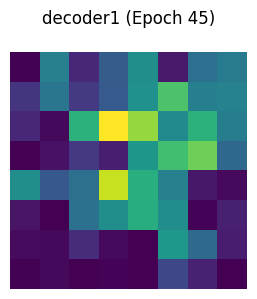

decoder2: torch.Size([3, 32, 8, 8])


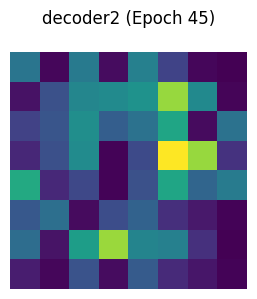

decoder3: torch.Size([3, 24, 16, 16])


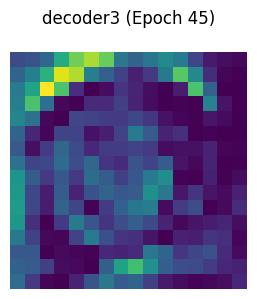

decoder4: torch.Size([3, 16, 32, 32])


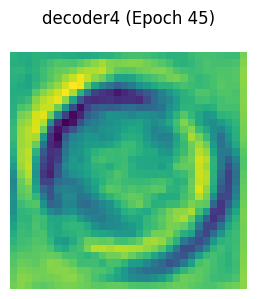

decoder5: torch.Size([3, 8, 64, 64])


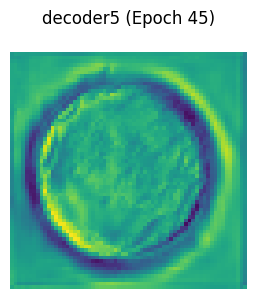

Epoch 45: Loss = 85.6486, Val Dice = 0.8324, Val mIoU = 0.7147, Val Accuracy = 0.9552, Val Sensitivity = 0.8279, Val Specificity = 0.9747


Epoch 46/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 46] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


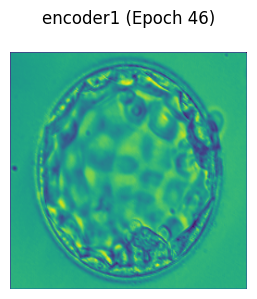

encoder2: torch.Size([3, 16, 128, 128])


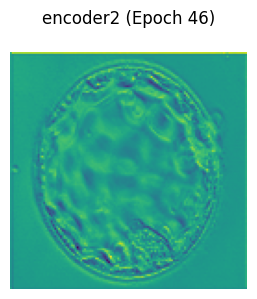

encoder3: torch.Size([3, 24, 64, 64])


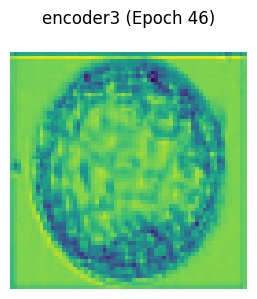

encoder4: torch.Size([3, 32, 32, 32])


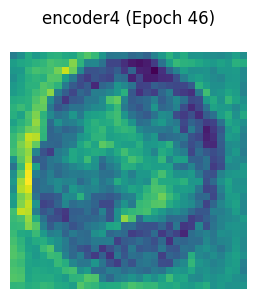

encoder5: torch.Size([3, 48, 16, 16])


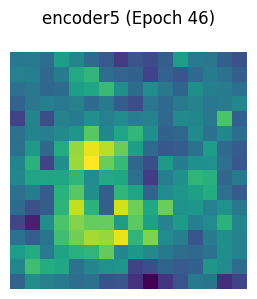

encoder6: torch.Size([3, 64, 8, 8])


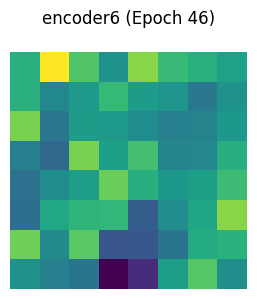

decoder1: torch.Size([3, 48, 8, 8])


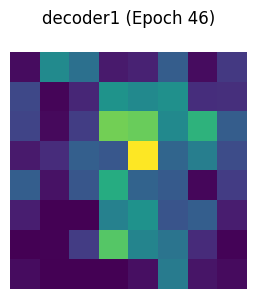

decoder2: torch.Size([3, 32, 8, 8])


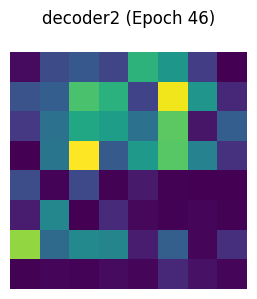

decoder3: torch.Size([3, 24, 16, 16])


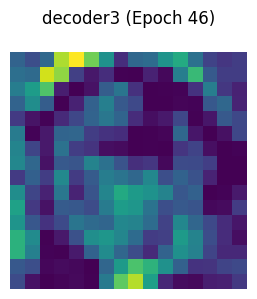

decoder4: torch.Size([3, 16, 32, 32])


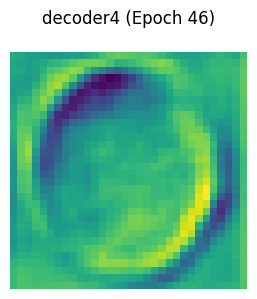

decoder5: torch.Size([3, 8, 64, 64])


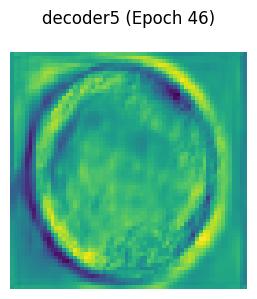

Epoch 46: Loss = 85.6996, Val Dice = 0.8323, Val mIoU = 0.7145, Val Accuracy = 0.9552, Val Sensitivity = 0.8279, Val Specificity = 0.9746


Epoch 47/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 47] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


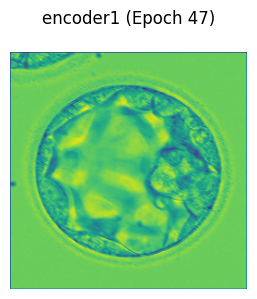

encoder2: torch.Size([3, 16, 128, 128])


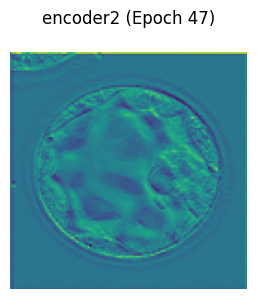

encoder3: torch.Size([3, 24, 64, 64])


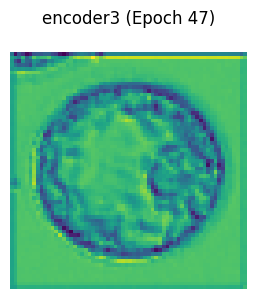

encoder4: torch.Size([3, 32, 32, 32])


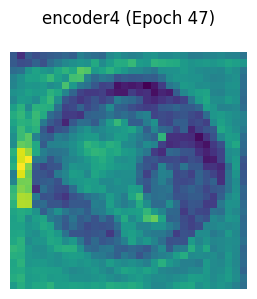

encoder5: torch.Size([3, 48, 16, 16])


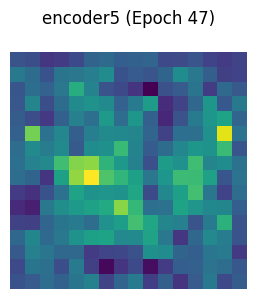

encoder6: torch.Size([3, 64, 8, 8])


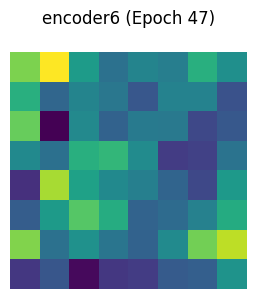

decoder1: torch.Size([3, 48, 8, 8])


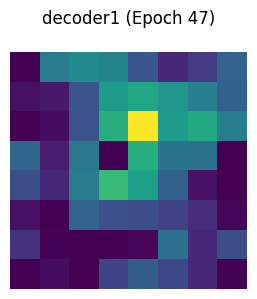

decoder2: torch.Size([3, 32, 8, 8])


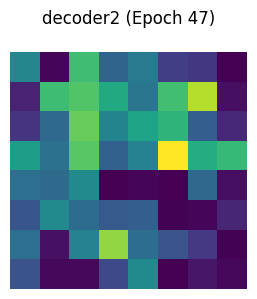

decoder3: torch.Size([3, 24, 16, 16])


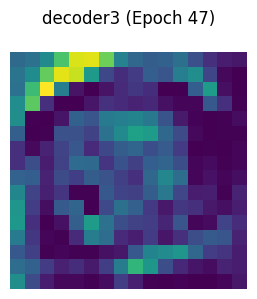

decoder4: torch.Size([3, 16, 32, 32])


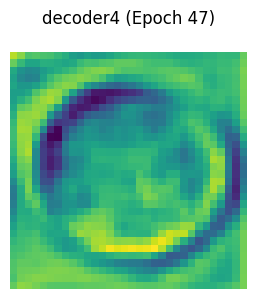

decoder5: torch.Size([3, 8, 64, 64])


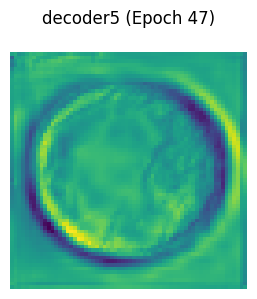

Epoch 47: Loss = 85.6226, Val Dice = 0.8315, Val mIoU = 0.7133, Val Accuracy = 0.9550, Val Sensitivity = 0.8253, Val Specificity = 0.9749


Epoch 48/100: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


[Epoch 48] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


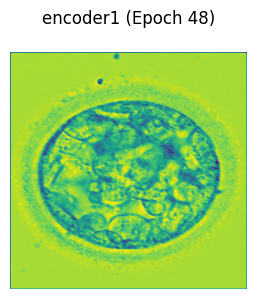

encoder2: torch.Size([3, 16, 128, 128])


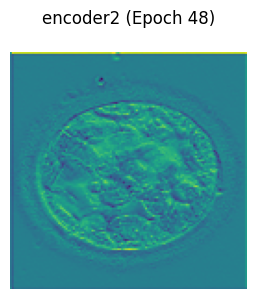

encoder3: torch.Size([3, 24, 64, 64])


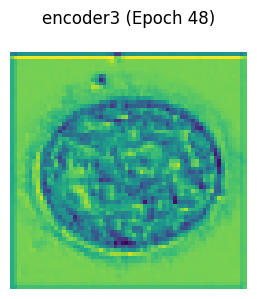

encoder4: torch.Size([3, 32, 32, 32])


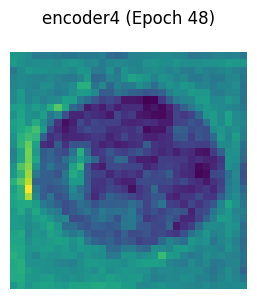

encoder5: torch.Size([3, 48, 16, 16])


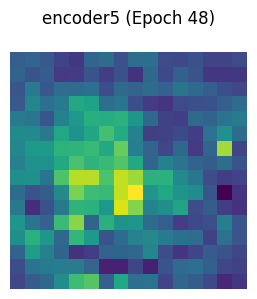

encoder6: torch.Size([3, 64, 8, 8])


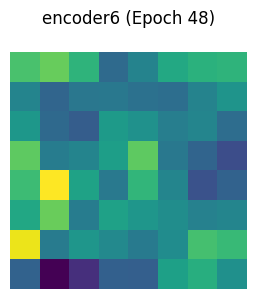

decoder1: torch.Size([3, 48, 8, 8])


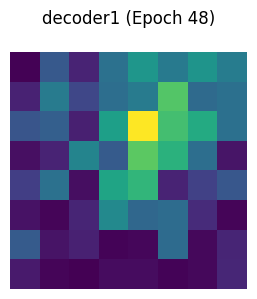

decoder2: torch.Size([3, 32, 8, 8])


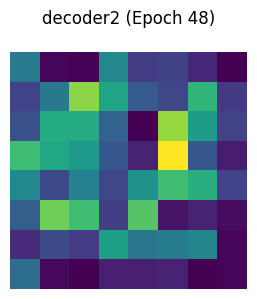

decoder3: torch.Size([3, 24, 16, 16])


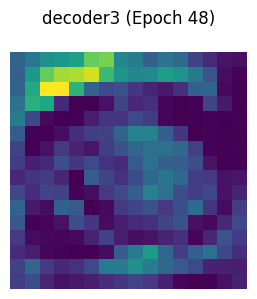

decoder4: torch.Size([3, 16, 32, 32])


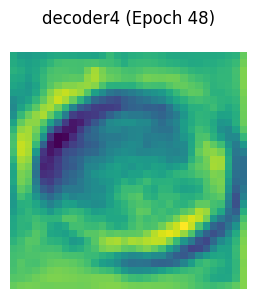

decoder5: torch.Size([3, 8, 64, 64])


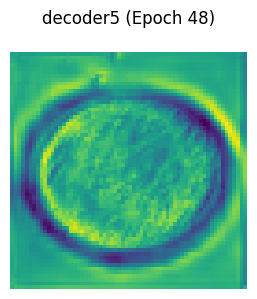

Epoch 48: Loss = 85.5772, Val Dice = 0.8324, Val mIoU = 0.7146, Val Accuracy = 0.9551, Val Sensitivity = 0.8296, Val Specificity = 0.9743


Epoch 49/100: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


[Epoch 49] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


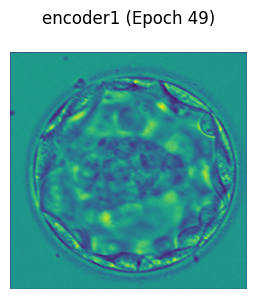

encoder2: torch.Size([3, 16, 128, 128])


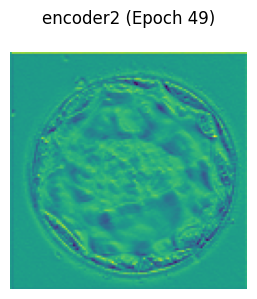

encoder3: torch.Size([3, 24, 64, 64])


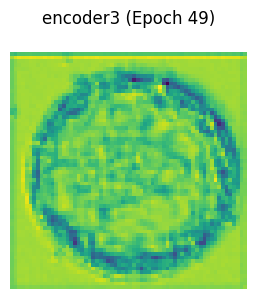

encoder4: torch.Size([3, 32, 32, 32])


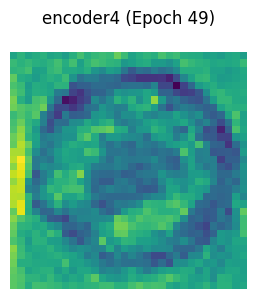

encoder5: torch.Size([3, 48, 16, 16])


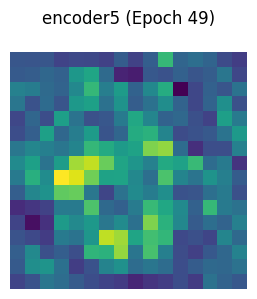

encoder6: torch.Size([3, 64, 8, 8])


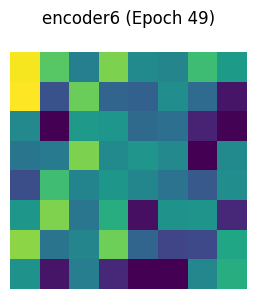

decoder1: torch.Size([3, 48, 8, 8])


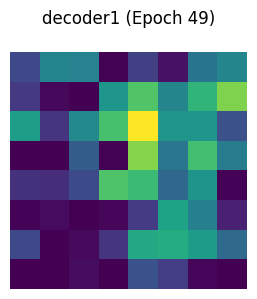

decoder2: torch.Size([3, 32, 8, 8])


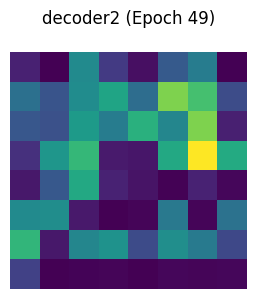

decoder3: torch.Size([3, 24, 16, 16])


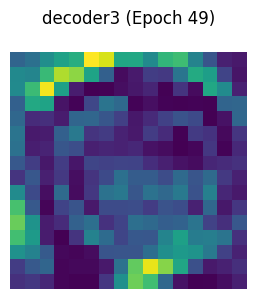

decoder4: torch.Size([3, 16, 32, 32])


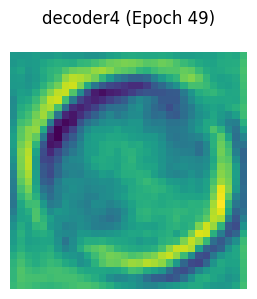

decoder5: torch.Size([3, 8, 64, 64])


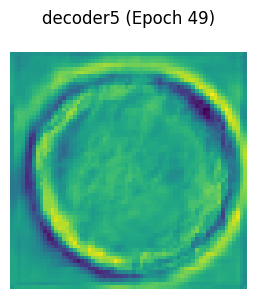

Epoch 49: Loss = 85.6662, Val Dice = 0.8316, Val mIoU = 0.7136, Val Accuracy = 0.9550, Val Sensitivity = 0.8272, Val Specificity = 0.9746


Epoch 50/100: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


[Epoch 50] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


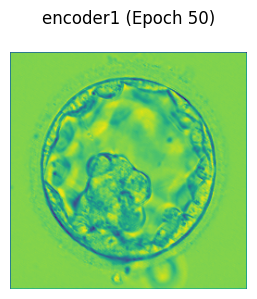

encoder2: torch.Size([3, 16, 128, 128])


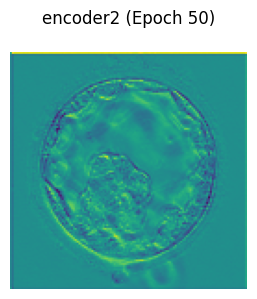

encoder3: torch.Size([3, 24, 64, 64])


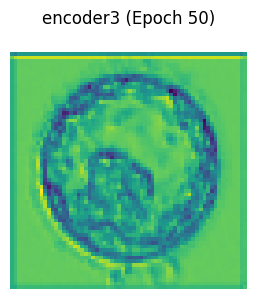

encoder4: torch.Size([3, 32, 32, 32])


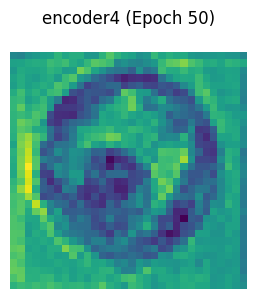

encoder5: torch.Size([3, 48, 16, 16])


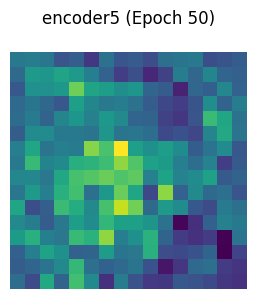

encoder6: torch.Size([3, 64, 8, 8])


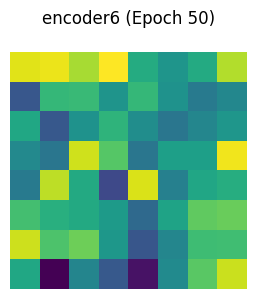

decoder1: torch.Size([3, 48, 8, 8])


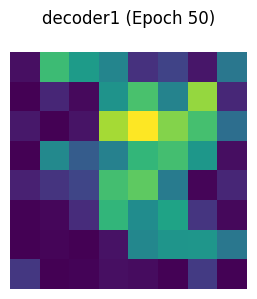

decoder2: torch.Size([3, 32, 8, 8])


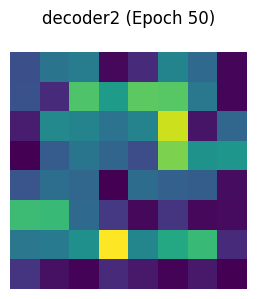

decoder3: torch.Size([3, 24, 16, 16])


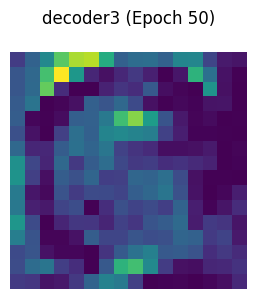

decoder4: torch.Size([3, 16, 32, 32])


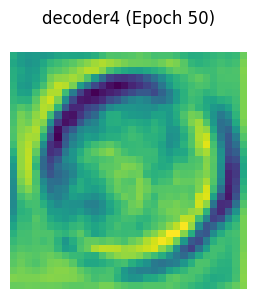

decoder5: torch.Size([3, 8, 64, 64])


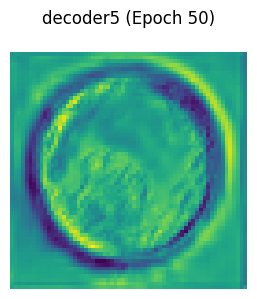

Epoch 50: Loss = 85.5701, Val Dice = 0.8314, Val mIoU = 0.7133, Val Accuracy = 0.9550, Val Sensitivity = 0.8268, Val Specificity = 0.9746


Epoch 51/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 51] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


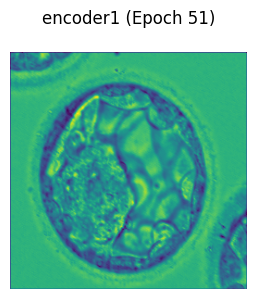

encoder2: torch.Size([3, 16, 128, 128])


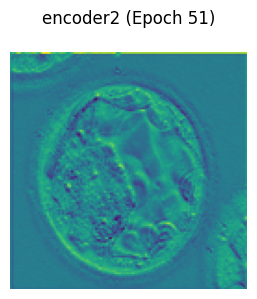

encoder3: torch.Size([3, 24, 64, 64])


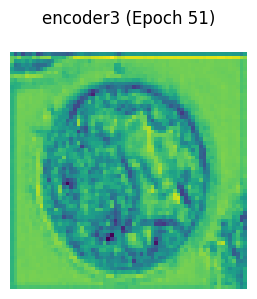

encoder4: torch.Size([3, 32, 32, 32])


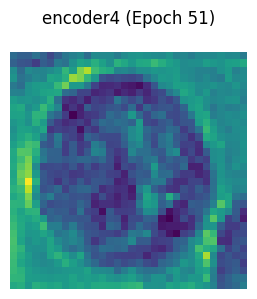

encoder5: torch.Size([3, 48, 16, 16])


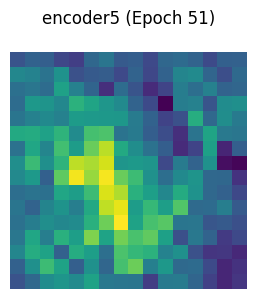

encoder6: torch.Size([3, 64, 8, 8])


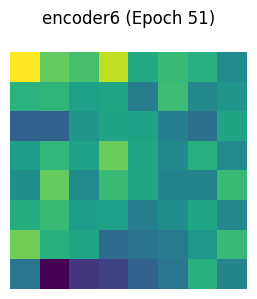

decoder1: torch.Size([3, 48, 8, 8])


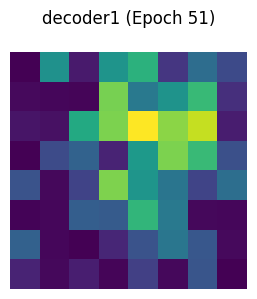

decoder2: torch.Size([3, 32, 8, 8])


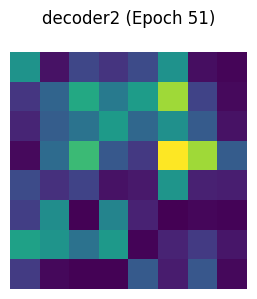

decoder3: torch.Size([3, 24, 16, 16])


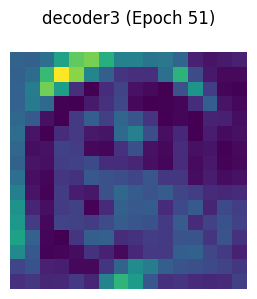

decoder4: torch.Size([3, 16, 32, 32])


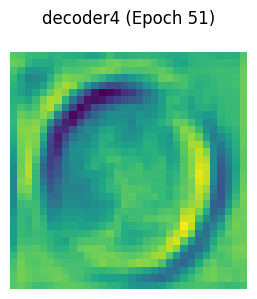

decoder5: torch.Size([3, 8, 64, 64])


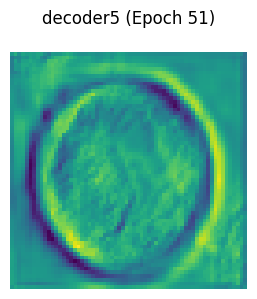

Epoch 51: Loss = 85.5540, Val Dice = 0.8315, Val mIoU = 0.7133, Val Accuracy = 0.9550, Val Sensitivity = 0.8268, Val Specificity = 0.9746


Epoch 52/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 52] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


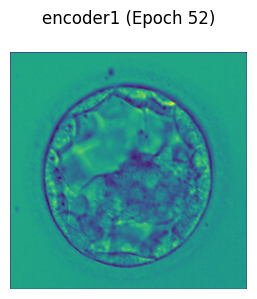

encoder2: torch.Size([3, 16, 128, 128])


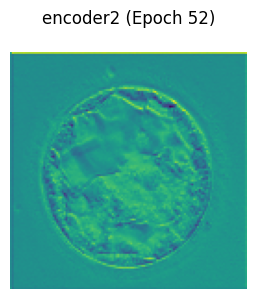

encoder3: torch.Size([3, 24, 64, 64])


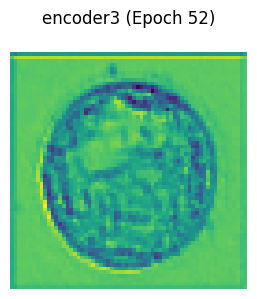

encoder4: torch.Size([3, 32, 32, 32])


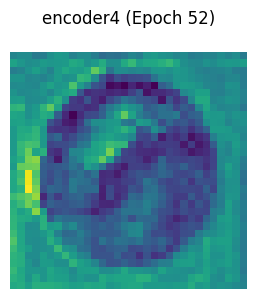

encoder5: torch.Size([3, 48, 16, 16])


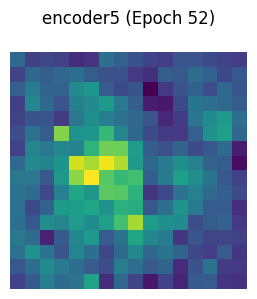

encoder6: torch.Size([3, 64, 8, 8])


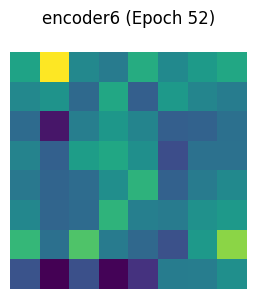

decoder1: torch.Size([3, 48, 8, 8])


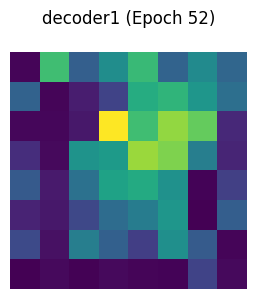

decoder2: torch.Size([3, 32, 8, 8])


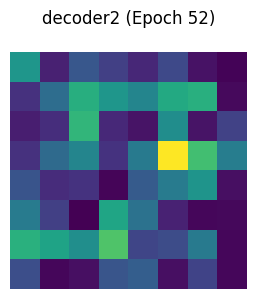

decoder3: torch.Size([3, 24, 16, 16])


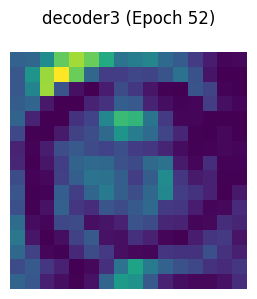

decoder4: torch.Size([3, 16, 32, 32])


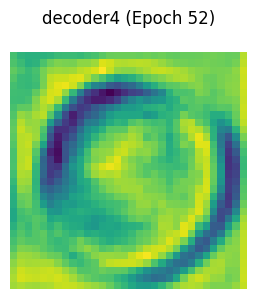

decoder5: torch.Size([3, 8, 64, 64])


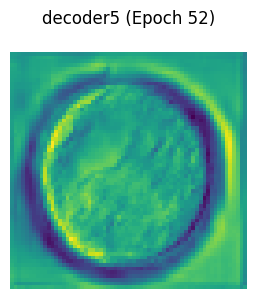

Epoch 52: Loss = 85.5748, Val Dice = 0.8310, Val mIoU = 0.7127, Val Accuracy = 0.9549, Val Sensitivity = 0.8260, Val Specificity = 0.9746


Epoch 53/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 53] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


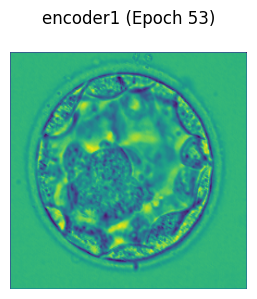

encoder2: torch.Size([3, 16, 128, 128])


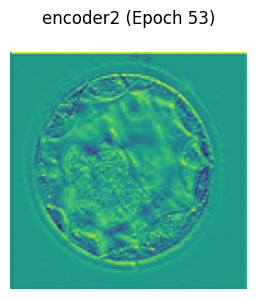

encoder3: torch.Size([3, 24, 64, 64])


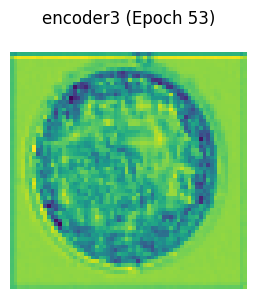

encoder4: torch.Size([3, 32, 32, 32])


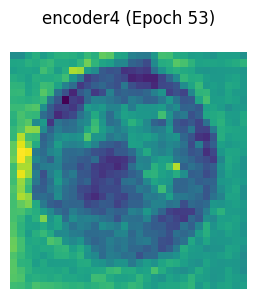

encoder5: torch.Size([3, 48, 16, 16])


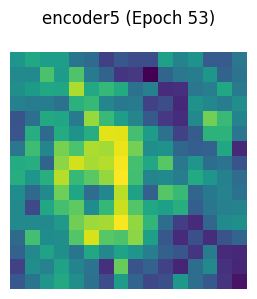

encoder6: torch.Size([3, 64, 8, 8])


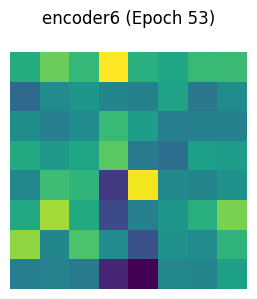

decoder1: torch.Size([3, 48, 8, 8])


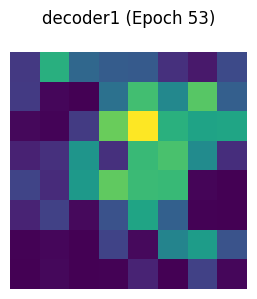

decoder2: torch.Size([3, 32, 8, 8])


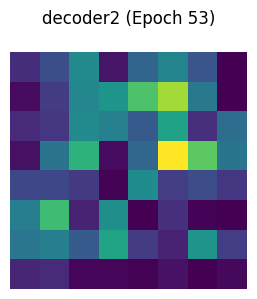

decoder3: torch.Size([3, 24, 16, 16])


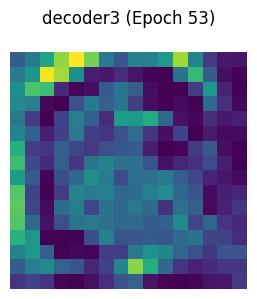

decoder4: torch.Size([3, 16, 32, 32])


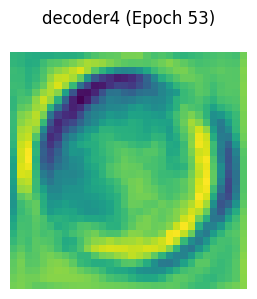

decoder5: torch.Size([3, 8, 64, 64])


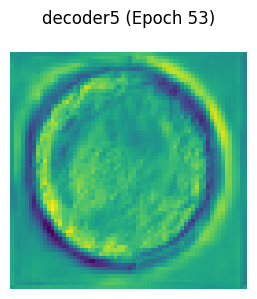

Epoch 53: Loss = 85.5496, Val Dice = 0.8309, Val mIoU = 0.7126, Val Accuracy = 0.9549, Val Sensitivity = 0.8261, Val Specificity = 0.9745


Epoch 54/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 54] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


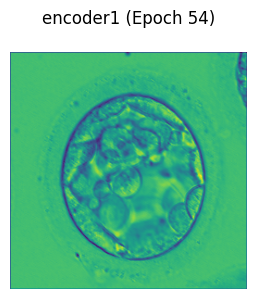

encoder2: torch.Size([3, 16, 128, 128])


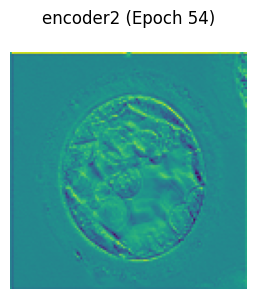

encoder3: torch.Size([3, 24, 64, 64])


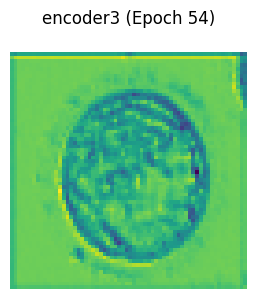

encoder4: torch.Size([3, 32, 32, 32])


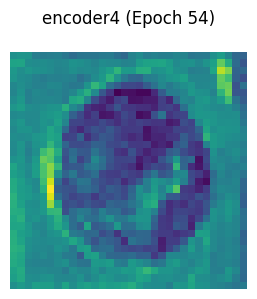

encoder5: torch.Size([3, 48, 16, 16])


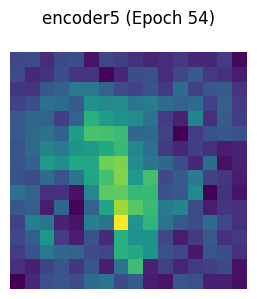

encoder6: torch.Size([3, 64, 8, 8])


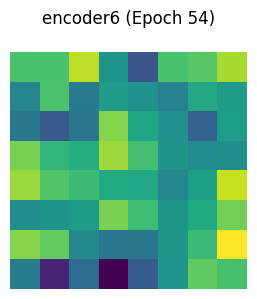

decoder1: torch.Size([3, 48, 8, 8])


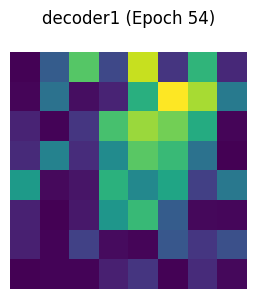

decoder2: torch.Size([3, 32, 8, 8])


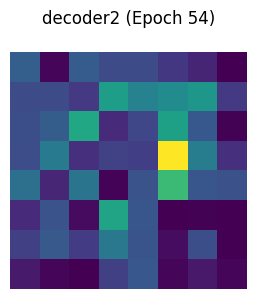

decoder3: torch.Size([3, 24, 16, 16])


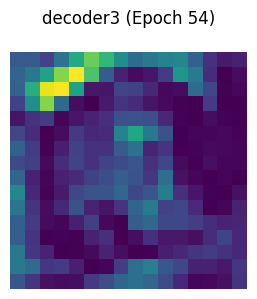

decoder4: torch.Size([3, 16, 32, 32])


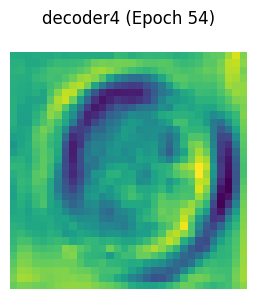

decoder5: torch.Size([3, 8, 64, 64])


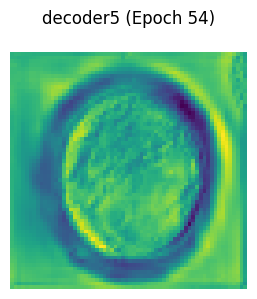

Epoch 54: Loss = 85.5370, Val Dice = 0.8314, Val mIoU = 0.7132, Val Accuracy = 0.9550, Val Sensitivity = 0.8272, Val Specificity = 0.9745


Epoch 55/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 55] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


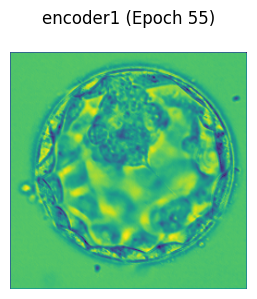

encoder2: torch.Size([3, 16, 128, 128])


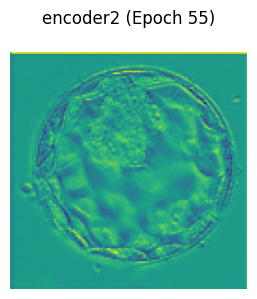

encoder3: torch.Size([3, 24, 64, 64])


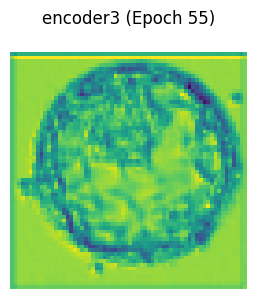

encoder4: torch.Size([3, 32, 32, 32])


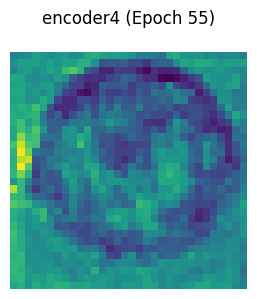

encoder5: torch.Size([3, 48, 16, 16])


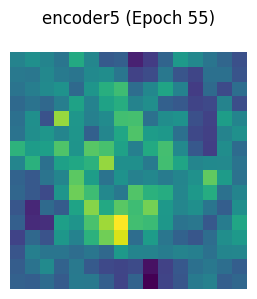

encoder6: torch.Size([3, 64, 8, 8])


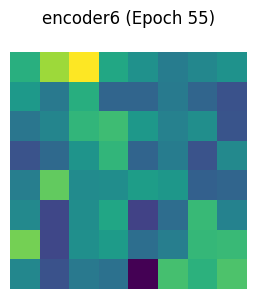

decoder1: torch.Size([3, 48, 8, 8])


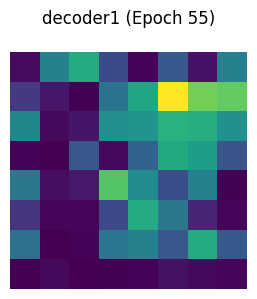

decoder2: torch.Size([3, 32, 8, 8])


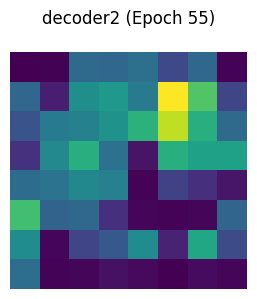

decoder3: torch.Size([3, 24, 16, 16])


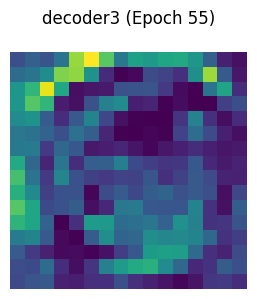

decoder4: torch.Size([3, 16, 32, 32])


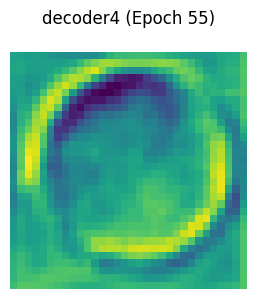

decoder5: torch.Size([3, 8, 64, 64])


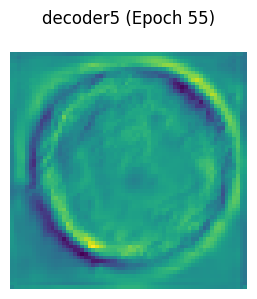

Epoch 55: Loss = 85.5372, Val Dice = 0.8310, Val mIoU = 0.7127, Val Accuracy = 0.9549, Val Sensitivity = 0.8265, Val Specificity = 0.9745


Epoch 56/100: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


[Epoch 56] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


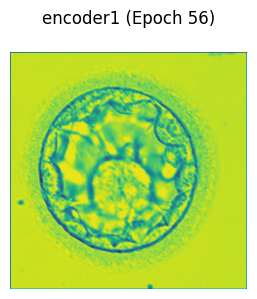

encoder2: torch.Size([3, 16, 128, 128])


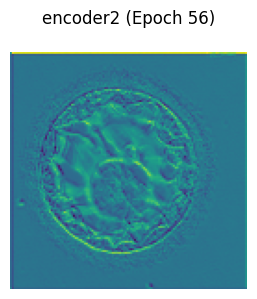

encoder3: torch.Size([3, 24, 64, 64])


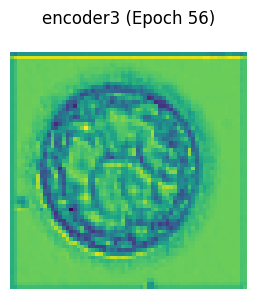

encoder4: torch.Size([3, 32, 32, 32])


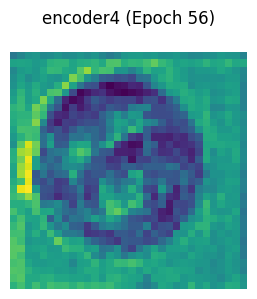

encoder5: torch.Size([3, 48, 16, 16])


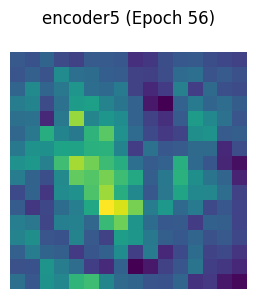

encoder6: torch.Size([3, 64, 8, 8])


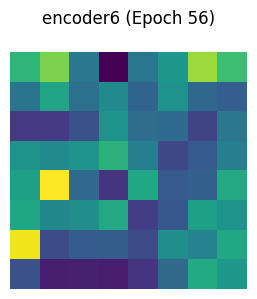

decoder1: torch.Size([3, 48, 8, 8])


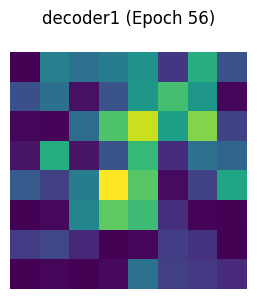

decoder2: torch.Size([3, 32, 8, 8])


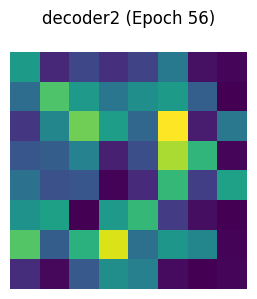

decoder3: torch.Size([3, 24, 16, 16])


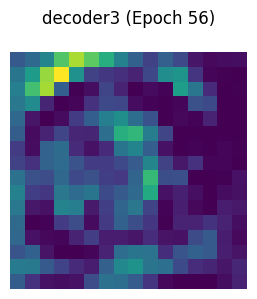

decoder4: torch.Size([3, 16, 32, 32])


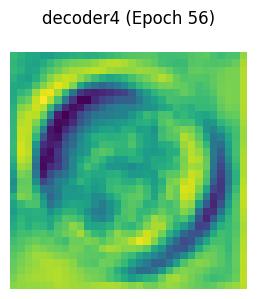

decoder5: torch.Size([3, 8, 64, 64])


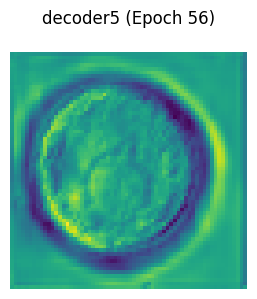

Epoch 56: Loss = 85.5128, Val Dice = 0.8301, Val mIoU = 0.7115, Val Accuracy = 0.9547, Val Sensitivity = 0.8247, Val Specificity = 0.9746


Epoch 57/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 57] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


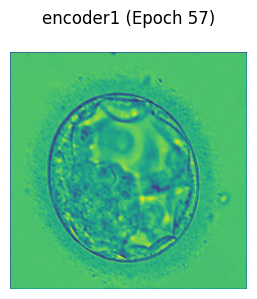

encoder2: torch.Size([3, 16, 128, 128])


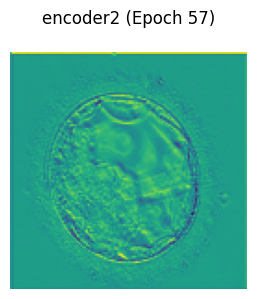

encoder3: torch.Size([3, 24, 64, 64])


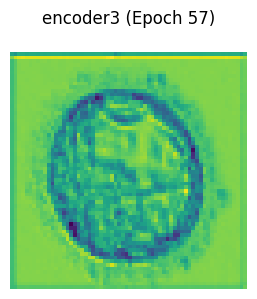

encoder4: torch.Size([3, 32, 32, 32])


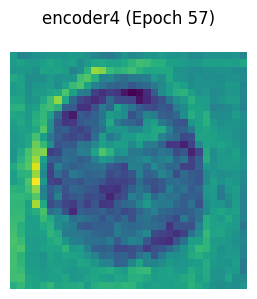

encoder5: torch.Size([3, 48, 16, 16])


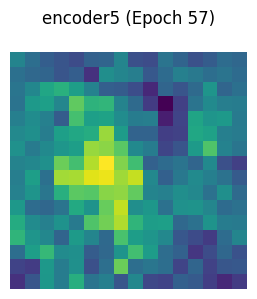

encoder6: torch.Size([3, 64, 8, 8])


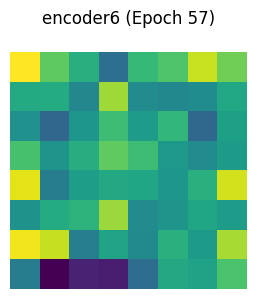

decoder1: torch.Size([3, 48, 8, 8])


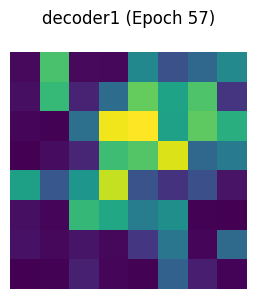

decoder2: torch.Size([3, 32, 8, 8])


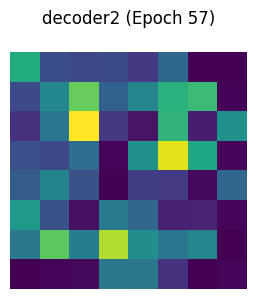

decoder3: torch.Size([3, 24, 16, 16])


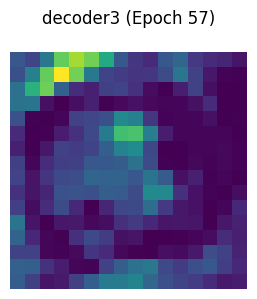

decoder4: torch.Size([3, 16, 32, 32])


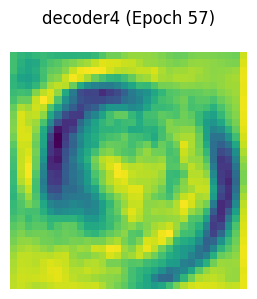

decoder5: torch.Size([3, 8, 64, 64])


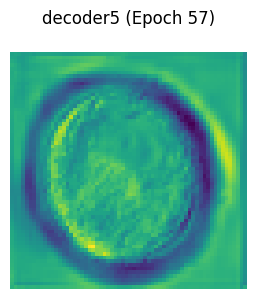

Epoch 57: Loss = 85.4838, Val Dice = 0.8304, Val mIoU = 0.7119, Val Accuracy = 0.9547, Val Sensitivity = 0.8275, Val Specificity = 0.9741


Epoch 58/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 58] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


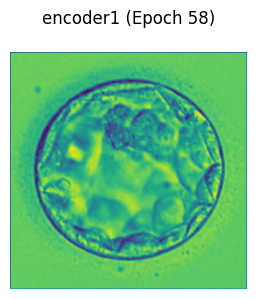

encoder2: torch.Size([3, 16, 128, 128])


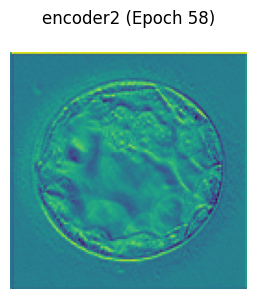

encoder3: torch.Size([3, 24, 64, 64])


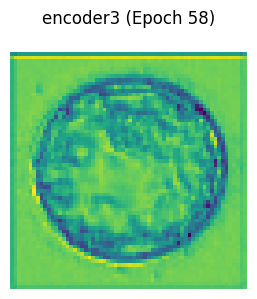

encoder4: torch.Size([3, 32, 32, 32])


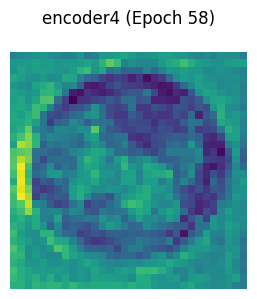

encoder5: torch.Size([3, 48, 16, 16])


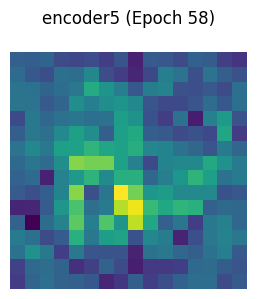

encoder6: torch.Size([3, 64, 8, 8])


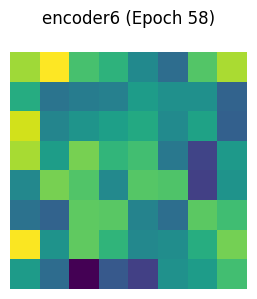

decoder1: torch.Size([3, 48, 8, 8])


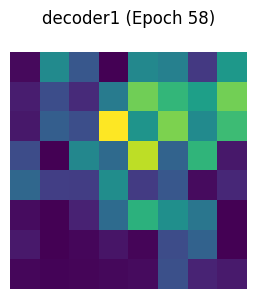

decoder2: torch.Size([3, 32, 8, 8])


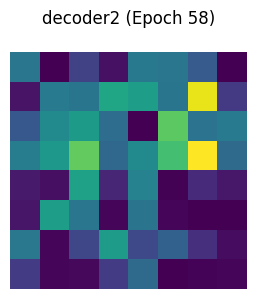

decoder3: torch.Size([3, 24, 16, 16])


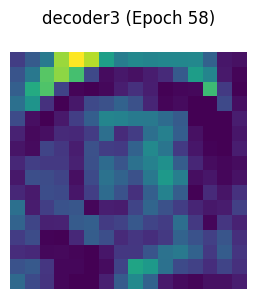

decoder4: torch.Size([3, 16, 32, 32])


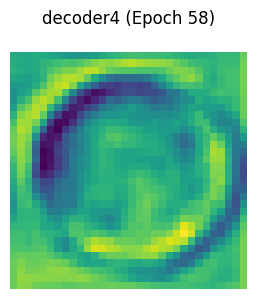

decoder5: torch.Size([3, 8, 64, 64])


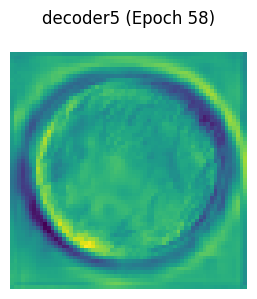

Epoch 58: Loss = 85.4713, Val Dice = 0.8298, Val mIoU = 0.7109, Val Accuracy = 0.9547, Val Sensitivity = 0.8226, Val Specificity = 0.9749


Epoch 59/100: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


[Epoch 59] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


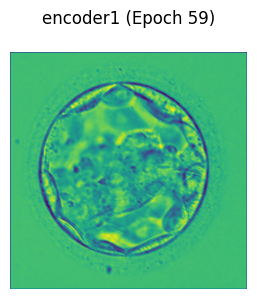

encoder2: torch.Size([3, 16, 128, 128])


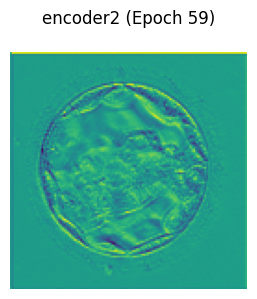

encoder3: torch.Size([3, 24, 64, 64])


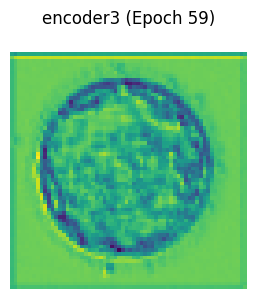

encoder4: torch.Size([3, 32, 32, 32])


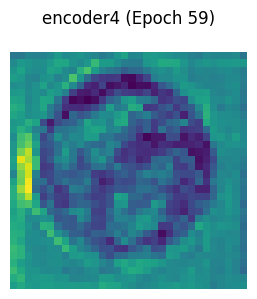

encoder5: torch.Size([3, 48, 16, 16])


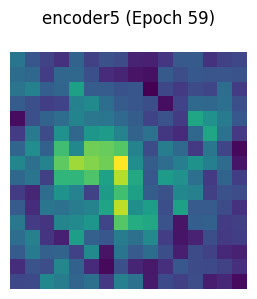

encoder6: torch.Size([3, 64, 8, 8])


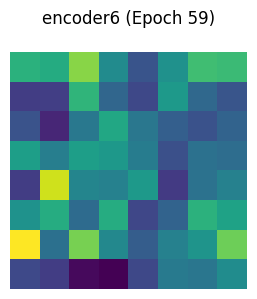

decoder1: torch.Size([3, 48, 8, 8])


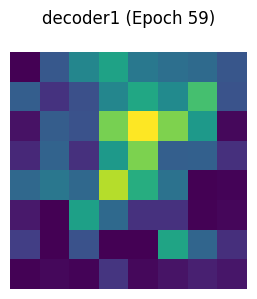

decoder2: torch.Size([3, 32, 8, 8])


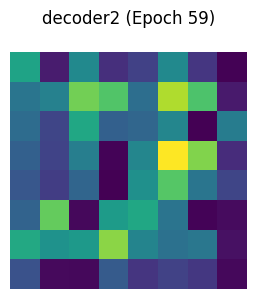

decoder3: torch.Size([3, 24, 16, 16])


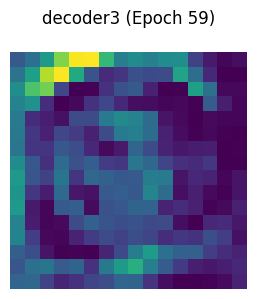

decoder4: torch.Size([3, 16, 32, 32])


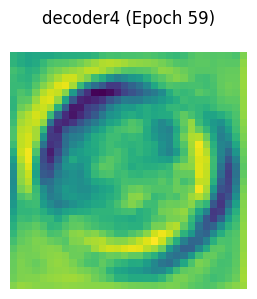

decoder5: torch.Size([3, 8, 64, 64])


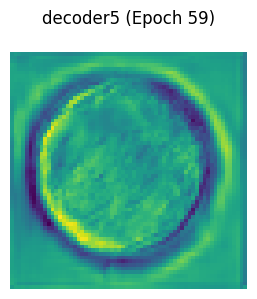

Epoch 59: Loss = 85.4953, Val Dice = 0.8299, Val mIoU = 0.7112, Val Accuracy = 0.9547, Val Sensitivity = 0.8244, Val Specificity = 0.9745


Epoch 60/100: 100%|██████████| 125/125 [01:42<00:00,  1.21it/s]


[Epoch 60] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


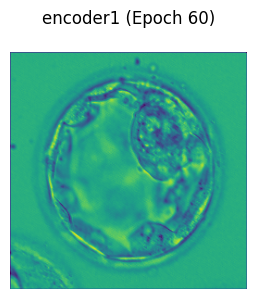

encoder2: torch.Size([3, 16, 128, 128])


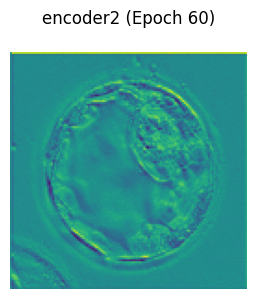

encoder3: torch.Size([3, 24, 64, 64])


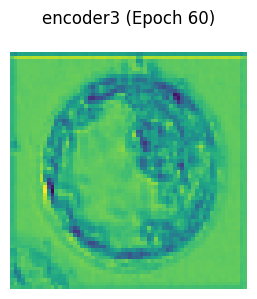

encoder4: torch.Size([3, 32, 32, 32])


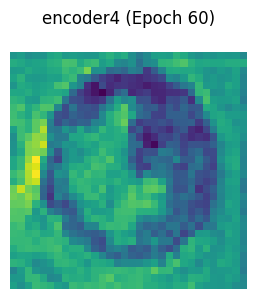

encoder5: torch.Size([3, 48, 16, 16])


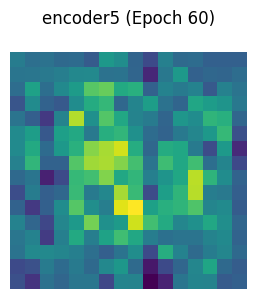

encoder6: torch.Size([3, 64, 8, 8])


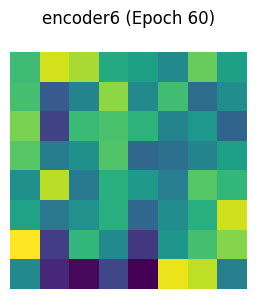

decoder1: torch.Size([3, 48, 8, 8])


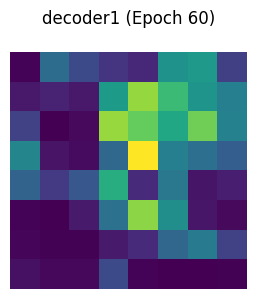

decoder2: torch.Size([3, 32, 8, 8])


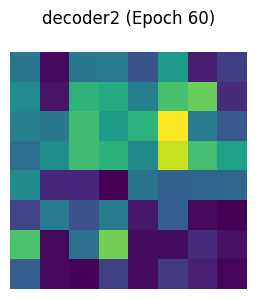

decoder3: torch.Size([3, 24, 16, 16])


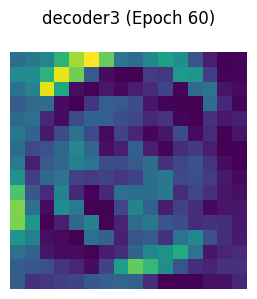

decoder4: torch.Size([3, 16, 32, 32])


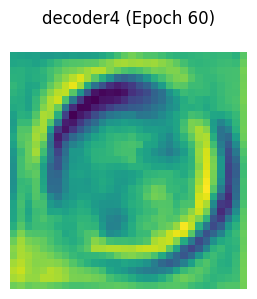

decoder5: torch.Size([3, 8, 64, 64])


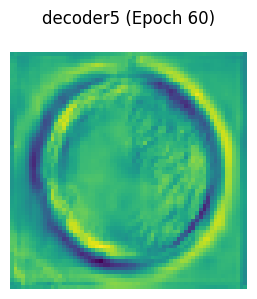

Epoch 60: Loss = 85.5770, Val Dice = 0.8289, Val mIoU = 0.7100, Val Accuracy = 0.9546, Val Sensitivity = 0.8230, Val Specificity = 0.9746


Epoch 61/100: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


[Epoch 61] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


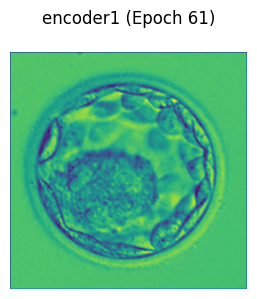

encoder2: torch.Size([3, 16, 128, 128])


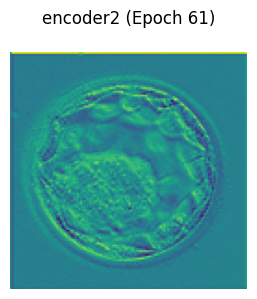

encoder3: torch.Size([3, 24, 64, 64])


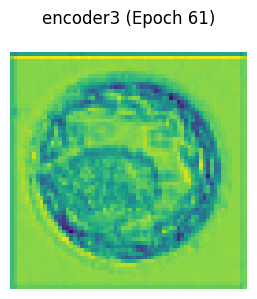

encoder4: torch.Size([3, 32, 32, 32])


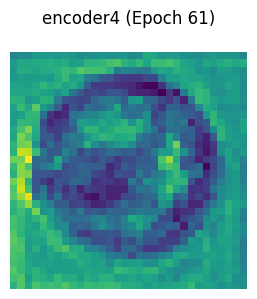

encoder5: torch.Size([3, 48, 16, 16])


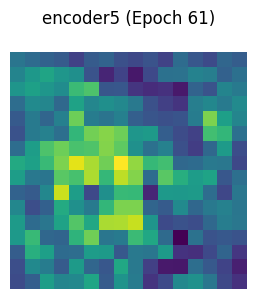

encoder6: torch.Size([3, 64, 8, 8])


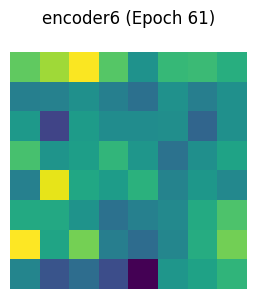

decoder1: torch.Size([3, 48, 8, 8])


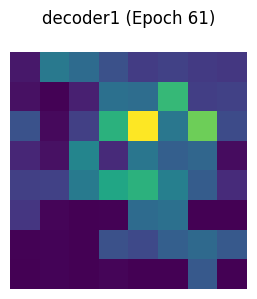

decoder2: torch.Size([3, 32, 8, 8])


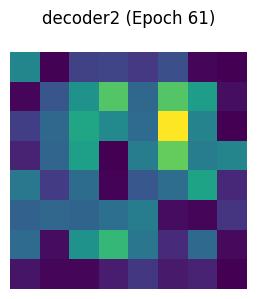

decoder3: torch.Size([3, 24, 16, 16])


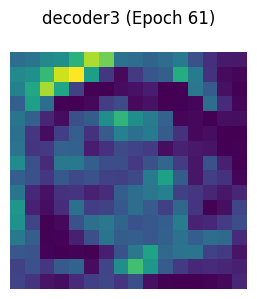

decoder4: torch.Size([3, 16, 32, 32])


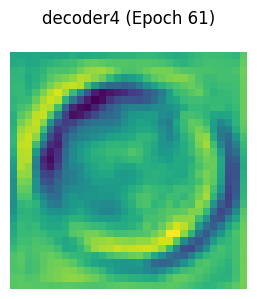

decoder5: torch.Size([3, 8, 64, 64])


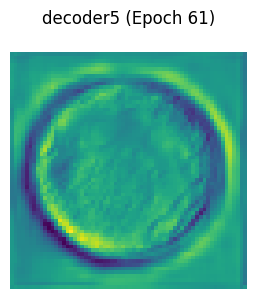

Epoch 61: Loss = 85.7732, Val Dice = 0.8301, Val mIoU = 0.7112, Val Accuracy = 0.9545, Val Sensitivity = 0.8275, Val Specificity = 0.9739


Epoch 62/100: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


[Epoch 62] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


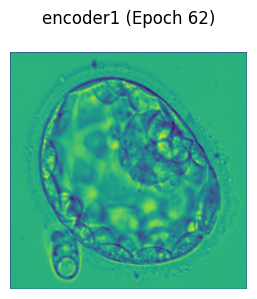

encoder2: torch.Size([3, 16, 128, 128])


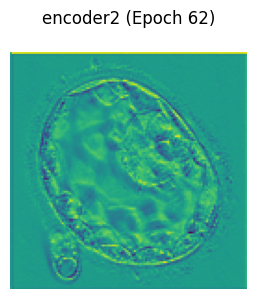

encoder3: torch.Size([3, 24, 64, 64])


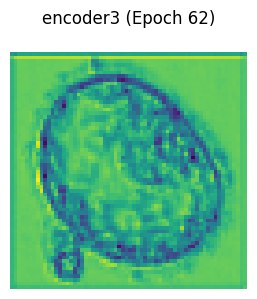

encoder4: torch.Size([3, 32, 32, 32])


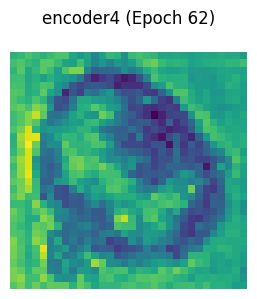

encoder5: torch.Size([3, 48, 16, 16])


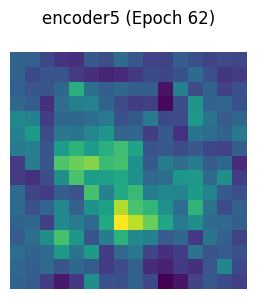

encoder6: torch.Size([3, 64, 8, 8])


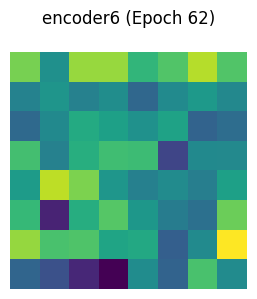

decoder1: torch.Size([3, 48, 8, 8])


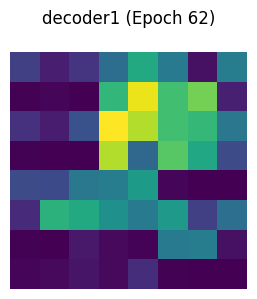

decoder2: torch.Size([3, 32, 8, 8])


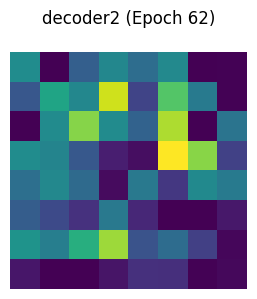

decoder3: torch.Size([3, 24, 16, 16])


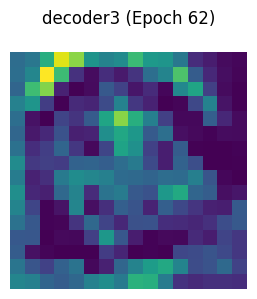

decoder4: torch.Size([3, 16, 32, 32])


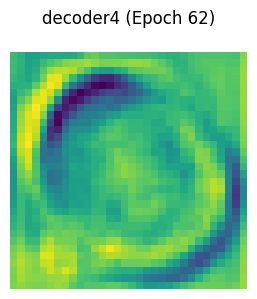

decoder5: torch.Size([3, 8, 64, 64])


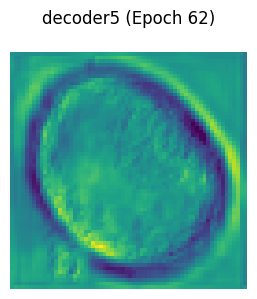

Epoch 62: Loss = 85.9408, Val Dice = 0.8278, Val mIoU = 0.7083, Val Accuracy = 0.9542, Val Sensitivity = 0.8243, Val Specificity = 0.9739


Epoch 63/100: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


[Epoch 63] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


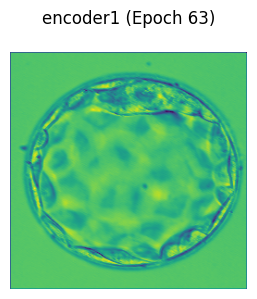

encoder2: torch.Size([3, 16, 128, 128])


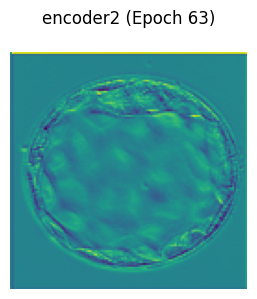

encoder3: torch.Size([3, 24, 64, 64])


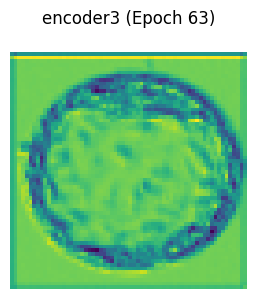

encoder4: torch.Size([3, 32, 32, 32])


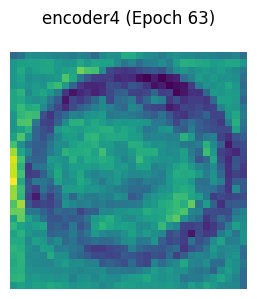

encoder5: torch.Size([3, 48, 16, 16])


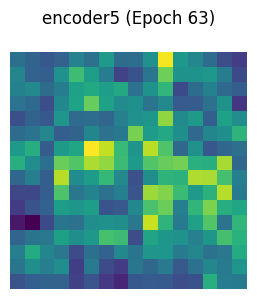

encoder6: torch.Size([3, 64, 8, 8])


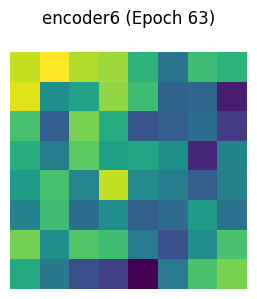

decoder1: torch.Size([3, 48, 8, 8])


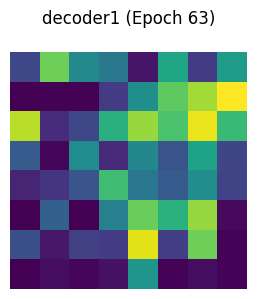

decoder2: torch.Size([3, 32, 8, 8])


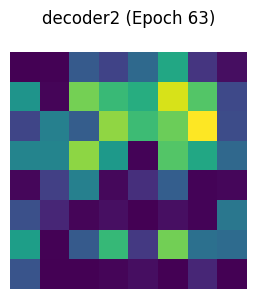

decoder3: torch.Size([3, 24, 16, 16])


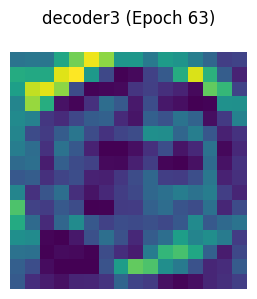

decoder4: torch.Size([3, 16, 32, 32])


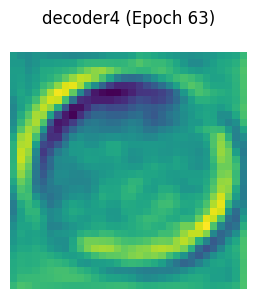

decoder5: torch.Size([3, 8, 64, 64])


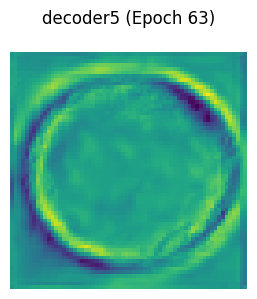

Epoch 63: Loss = 86.0491, Val Dice = 0.8301, Val mIoU = 0.7114, Val Accuracy = 0.9542, Val Sensitivity = 0.8365, Val Specificity = 0.9722


Epoch 64/100: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


[Epoch 64] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


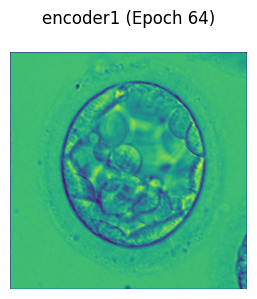

encoder2: torch.Size([3, 16, 128, 128])


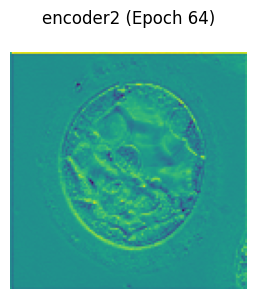

encoder3: torch.Size([3, 24, 64, 64])


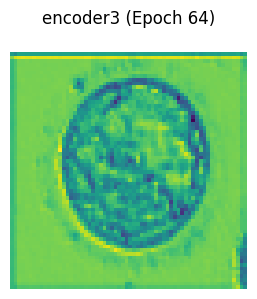

encoder4: torch.Size([3, 32, 32, 32])


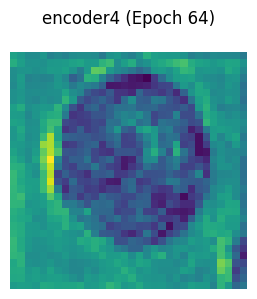

encoder5: torch.Size([3, 48, 16, 16])


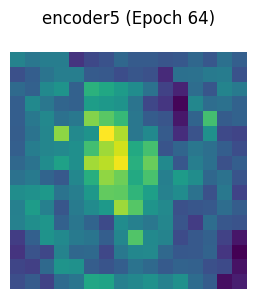

encoder6: torch.Size([3, 64, 8, 8])


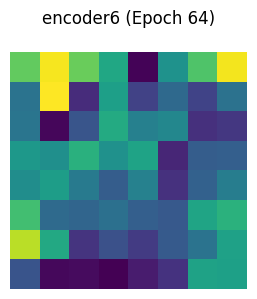

decoder1: torch.Size([3, 48, 8, 8])


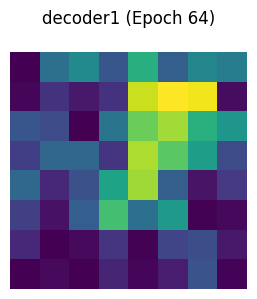

decoder2: torch.Size([3, 32, 8, 8])


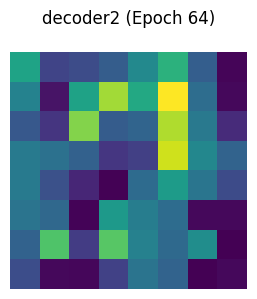

decoder3: torch.Size([3, 24, 16, 16])


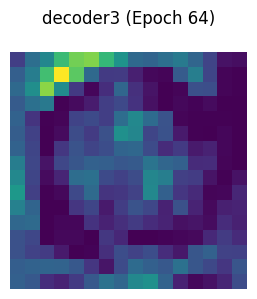

decoder4: torch.Size([3, 16, 32, 32])


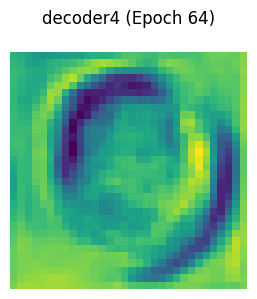

decoder5: torch.Size([3, 8, 64, 64])


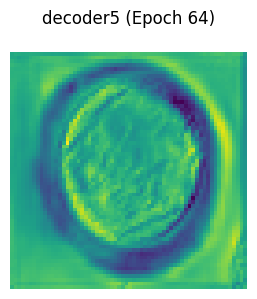

Epoch 64: Loss = 86.0273, Val Dice = 0.8279, Val mIoU = 0.7083, Val Accuracy = 0.9538, Val Sensitivity = 0.8283, Val Specificity = 0.9730


Epoch 65/100: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


[Epoch 65] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


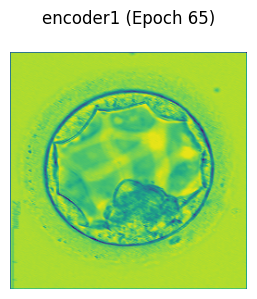

encoder2: torch.Size([3, 16, 128, 128])


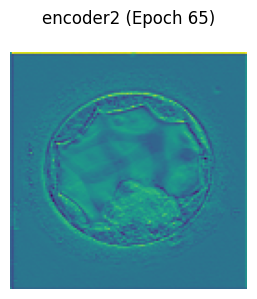

encoder3: torch.Size([3, 24, 64, 64])


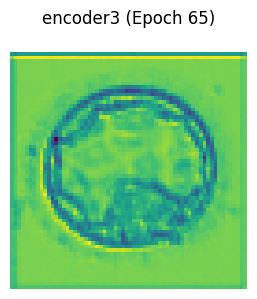

encoder4: torch.Size([3, 32, 32, 32])


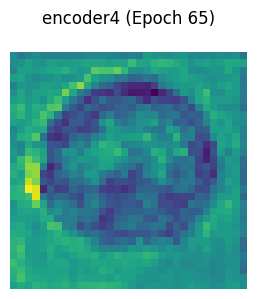

encoder5: torch.Size([3, 48, 16, 16])


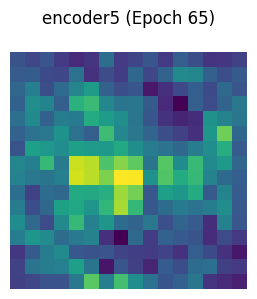

encoder6: torch.Size([3, 64, 8, 8])


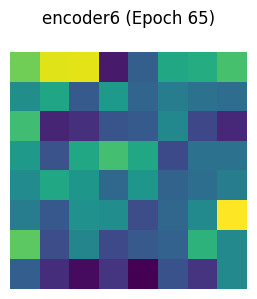

decoder1: torch.Size([3, 48, 8, 8])


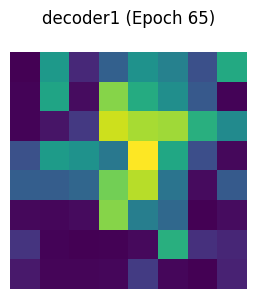

decoder2: torch.Size([3, 32, 8, 8])


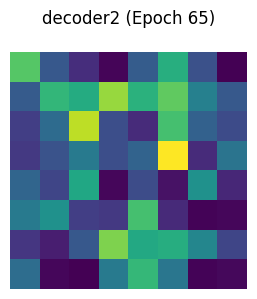

decoder3: torch.Size([3, 24, 16, 16])


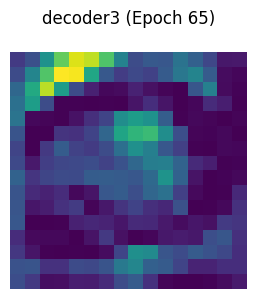

decoder4: torch.Size([3, 16, 32, 32])


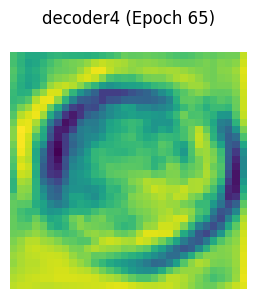

decoder5: torch.Size([3, 8, 64, 64])


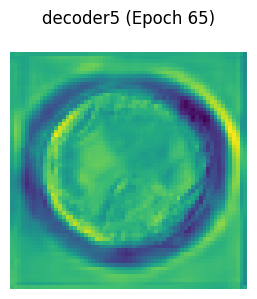

Epoch 65: Loss = 86.0430, Val Dice = 0.8313, Val mIoU = 0.7132, Val Accuracy = 0.9540, Val Sensitivity = 0.8471, Val Specificity = 0.9705


Epoch 66/100: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


[Epoch 66] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


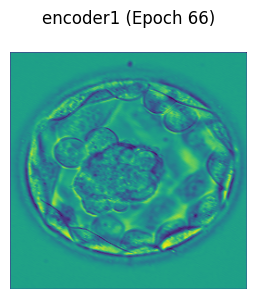

encoder2: torch.Size([3, 16, 128, 128])


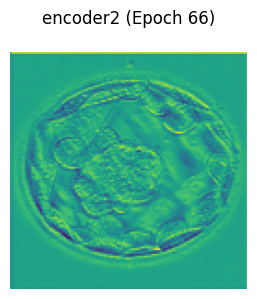

encoder3: torch.Size([3, 24, 64, 64])


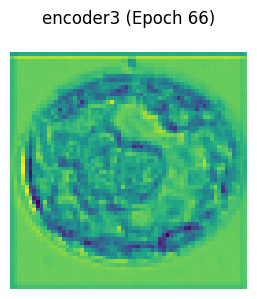

encoder4: torch.Size([3, 32, 32, 32])


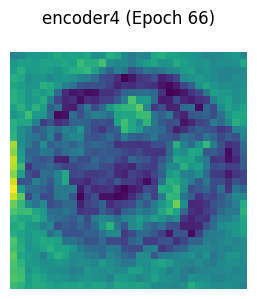

encoder5: torch.Size([3, 48, 16, 16])


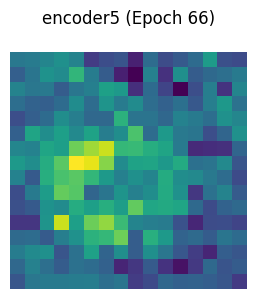

encoder6: torch.Size([3, 64, 8, 8])


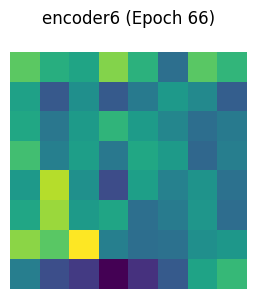

decoder1: torch.Size([3, 48, 8, 8])


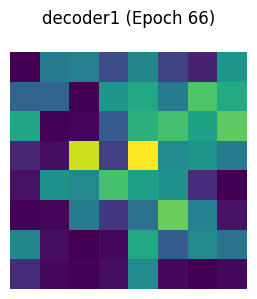

decoder2: torch.Size([3, 32, 8, 8])


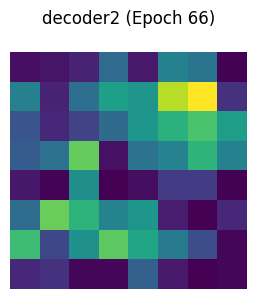

decoder3: torch.Size([3, 24, 16, 16])


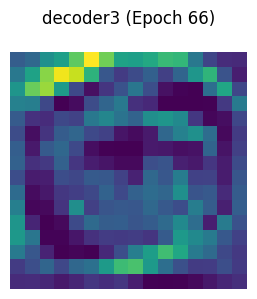

decoder4: torch.Size([3, 16, 32, 32])


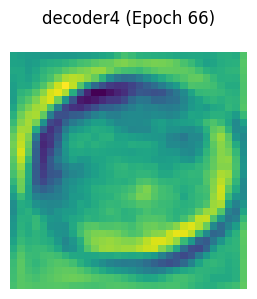

decoder5: torch.Size([3, 8, 64, 64])


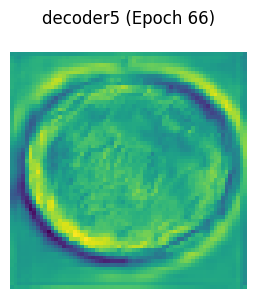

Epoch 66: Loss = 86.2239, Val Dice = 0.8242, Val mIoU = 0.7032, Val Accuracy = 0.9530, Val Sensitivity = 0.8247, Val Specificity = 0.9726


Epoch 67/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 67] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


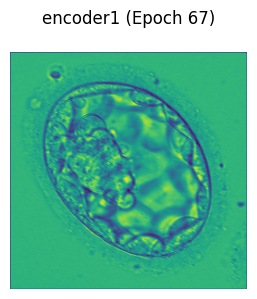

encoder2: torch.Size([3, 16, 128, 128])


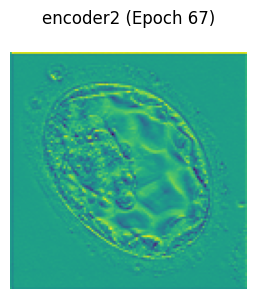

encoder3: torch.Size([3, 24, 64, 64])


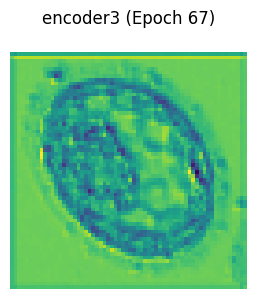

encoder4: torch.Size([3, 32, 32, 32])


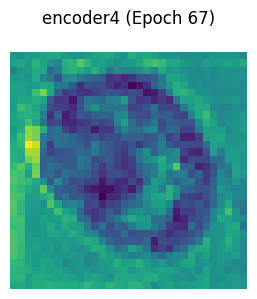

encoder5: torch.Size([3, 48, 16, 16])


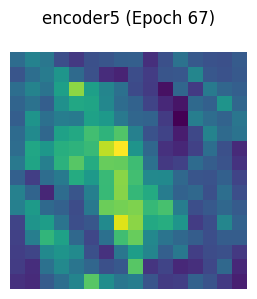

encoder6: torch.Size([3, 64, 8, 8])


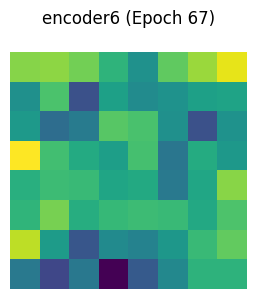

decoder1: torch.Size([3, 48, 8, 8])


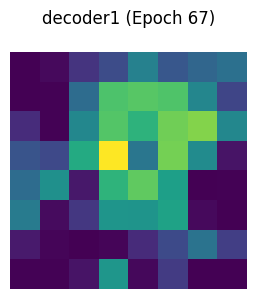

decoder2: torch.Size([3, 32, 8, 8])


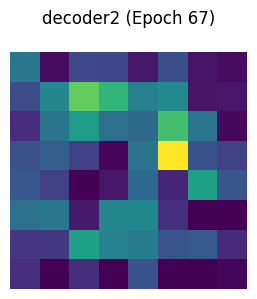

decoder3: torch.Size([3, 24, 16, 16])


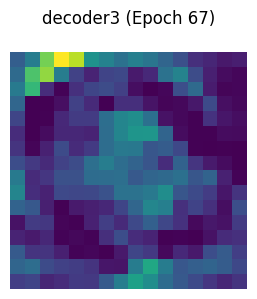

decoder4: torch.Size([3, 16, 32, 32])


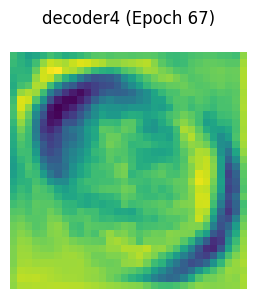

decoder5: torch.Size([3, 8, 64, 64])


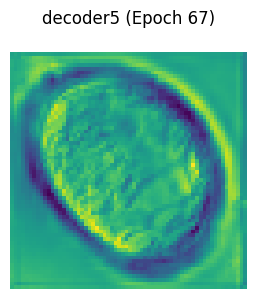

Epoch 67: Loss = 86.6124, Val Dice = 0.8325, Val mIoU = 0.7148, Val Accuracy = 0.9547, Val Sensitivity = 0.8399, Val Specificity = 0.9719


Epoch 68/100: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


[Epoch 68] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


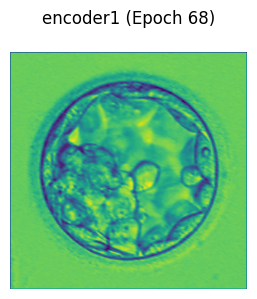

encoder2: torch.Size([3, 16, 128, 128])


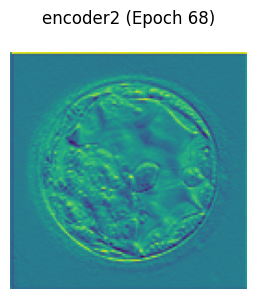

encoder3: torch.Size([3, 24, 64, 64])


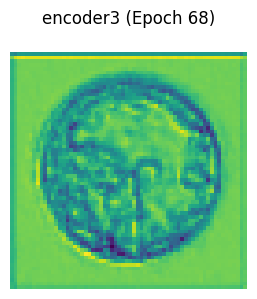

encoder4: torch.Size([3, 32, 32, 32])


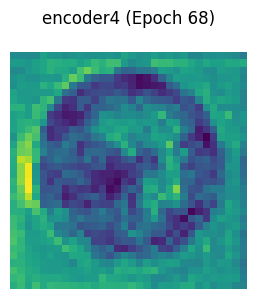

encoder5: torch.Size([3, 48, 16, 16])


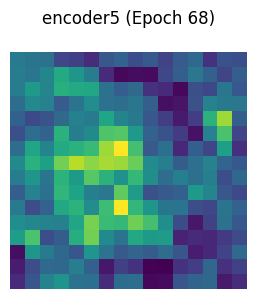

encoder6: torch.Size([3, 64, 8, 8])


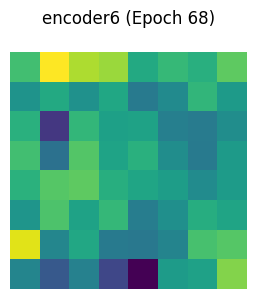

decoder1: torch.Size([3, 48, 8, 8])


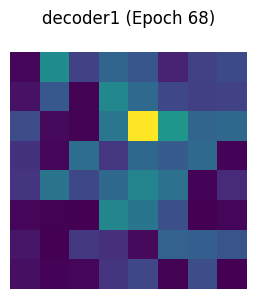

decoder2: torch.Size([3, 32, 8, 8])


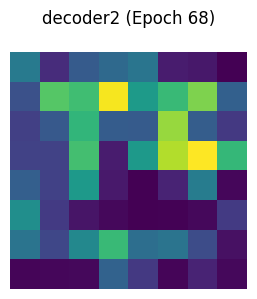

decoder3: torch.Size([3, 24, 16, 16])


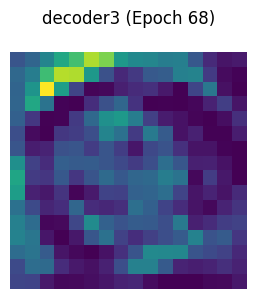

decoder4: torch.Size([3, 16, 32, 32])


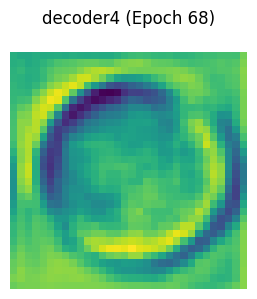

decoder5: torch.Size([3, 8, 64, 64])


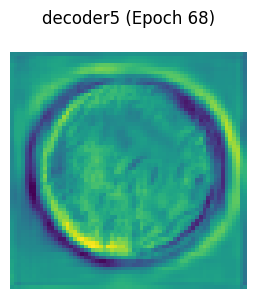

Epoch 68: Loss = 86.5886, Val Dice = 0.8335, Val mIoU = 0.7164, Val Accuracy = 0.9561, Val Sensitivity = 0.8202, Val Specificity = 0.9765


Epoch 69/100: 100%|██████████| 125/125 [01:46<00:00,  1.18it/s]


[Epoch 69] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


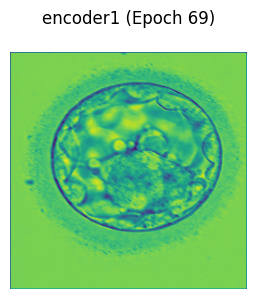

encoder2: torch.Size([3, 16, 128, 128])


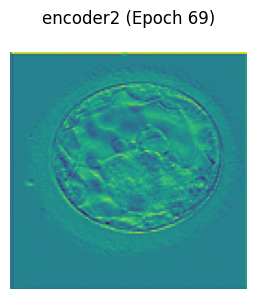

encoder3: torch.Size([3, 24, 64, 64])


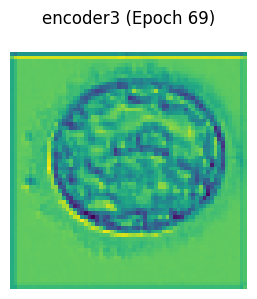

encoder4: torch.Size([3, 32, 32, 32])


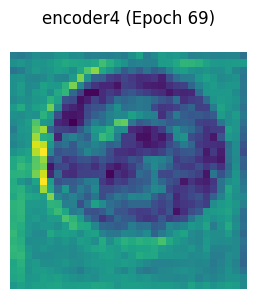

encoder5: torch.Size([3, 48, 16, 16])


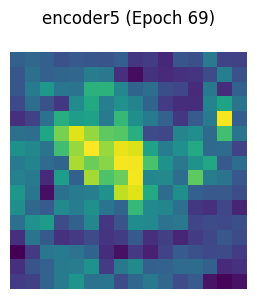

encoder6: torch.Size([3, 64, 8, 8])


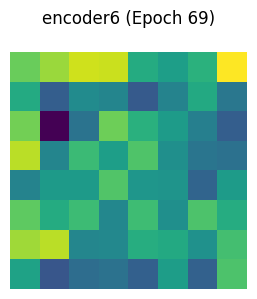

decoder1: torch.Size([3, 48, 8, 8])


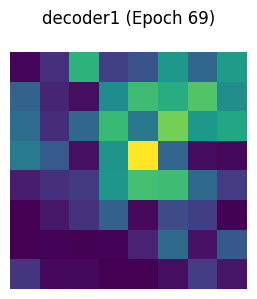

decoder2: torch.Size([3, 32, 8, 8])


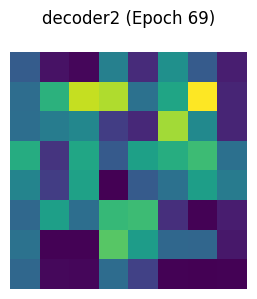

decoder3: torch.Size([3, 24, 16, 16])


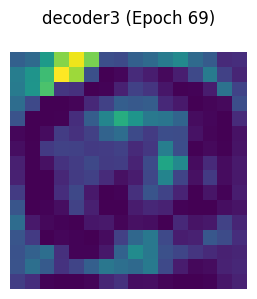

decoder4: torch.Size([3, 16, 32, 32])


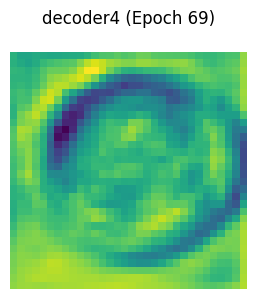

decoder5: torch.Size([3, 8, 64, 64])


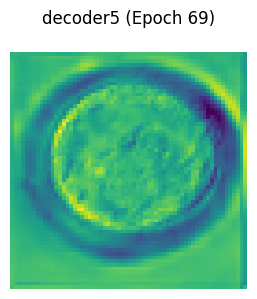

Epoch 69: Loss = 86.6607, Val Dice = 0.8353, Val mIoU = 0.7183, Val Accuracy = 0.9549, Val Sensitivity = 0.8418, Val Specificity = 0.9724


Epoch 70/100: 100%|██████████| 125/125 [01:44<00:00,  1.19it/s]


[Epoch 70] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


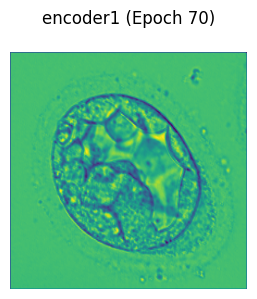

encoder2: torch.Size([3, 16, 128, 128])


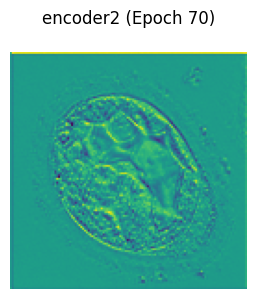

encoder3: torch.Size([3, 24, 64, 64])


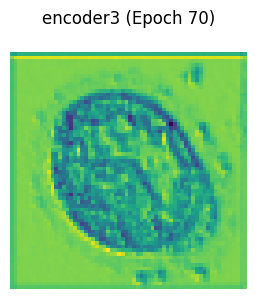

encoder4: torch.Size([3, 32, 32, 32])


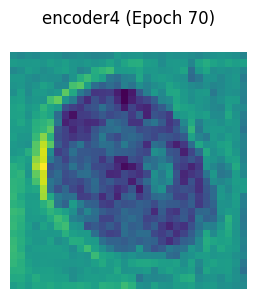

encoder5: torch.Size([3, 48, 16, 16])


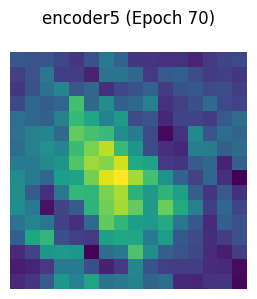

encoder6: torch.Size([3, 64, 8, 8])


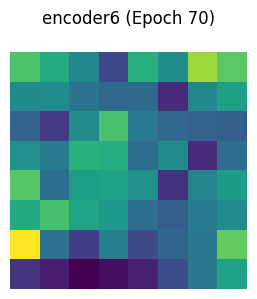

decoder1: torch.Size([3, 48, 8, 8])


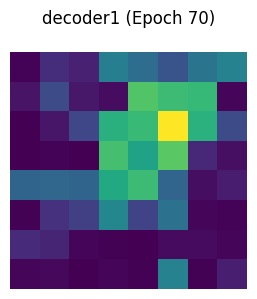

decoder2: torch.Size([3, 32, 8, 8])


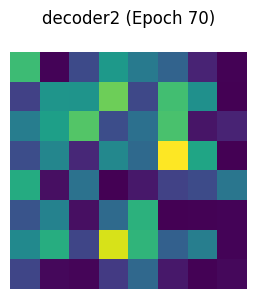

decoder3: torch.Size([3, 24, 16, 16])


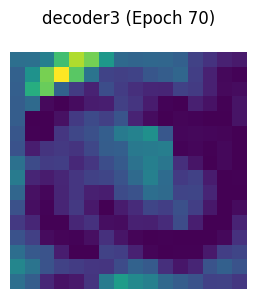

decoder4: torch.Size([3, 16, 32, 32])


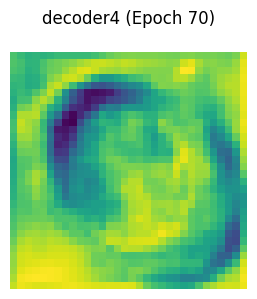

decoder5: torch.Size([3, 8, 64, 64])


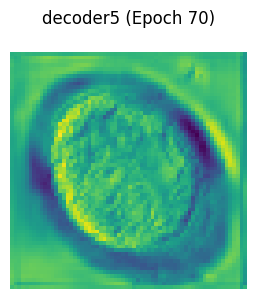

Epoch 70: Loss = 86.7946, Val Dice = 0.8321, Val mIoU = 0.7146, Val Accuracy = 0.9548, Val Sensitivity = 0.8391, Val Specificity = 0.9723


Epoch 71/100: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


[Epoch 71] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


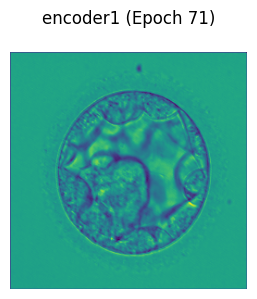

encoder2: torch.Size([3, 16, 128, 128])


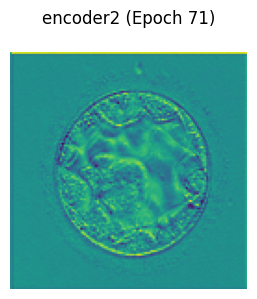

encoder3: torch.Size([3, 24, 64, 64])


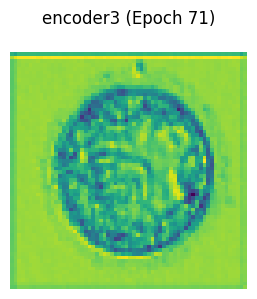

encoder4: torch.Size([3, 32, 32, 32])


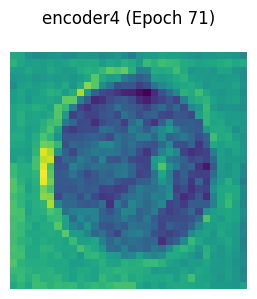

encoder5: torch.Size([3, 48, 16, 16])


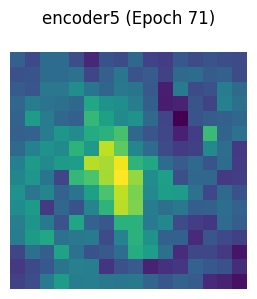

encoder6: torch.Size([3, 64, 8, 8])


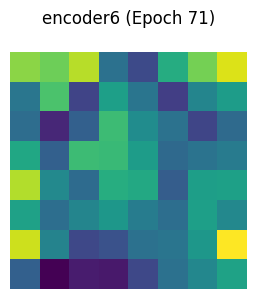

decoder1: torch.Size([3, 48, 8, 8])


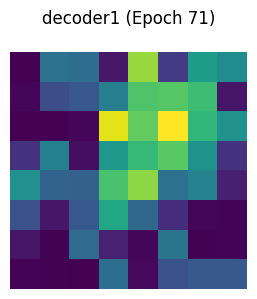

decoder2: torch.Size([3, 32, 8, 8])


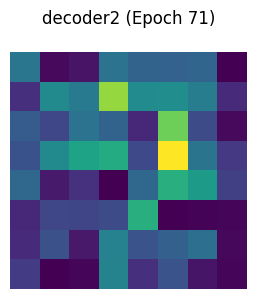

decoder3: torch.Size([3, 24, 16, 16])


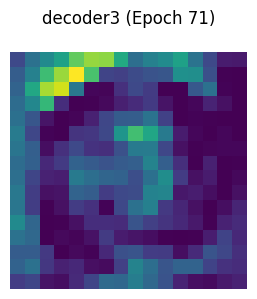

decoder4: torch.Size([3, 16, 32, 32])


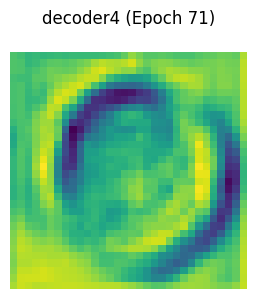

decoder5: torch.Size([3, 8, 64, 64])


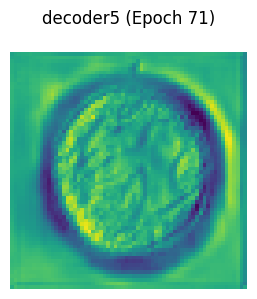

Epoch 71: Loss = 86.8503, Val Dice = 0.8365, Val mIoU = 0.7202, Val Accuracy = 0.9551, Val Sensitivity = 0.8506, Val Specificity = 0.9711


Epoch 72/100: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


[Epoch 72] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


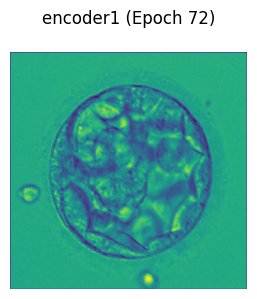

encoder2: torch.Size([3, 16, 128, 128])


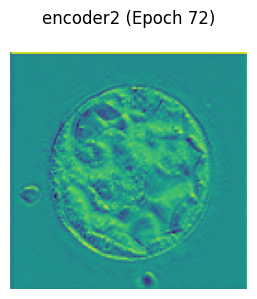

encoder3: torch.Size([3, 24, 64, 64])


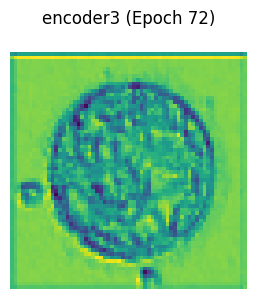

encoder4: torch.Size([3, 32, 32, 32])


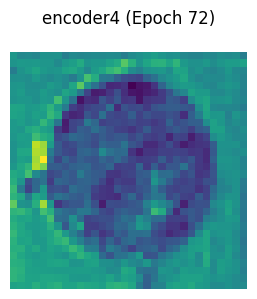

encoder5: torch.Size([3, 48, 16, 16])


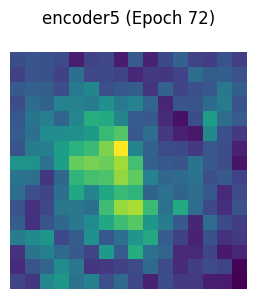

encoder6: torch.Size([3, 64, 8, 8])


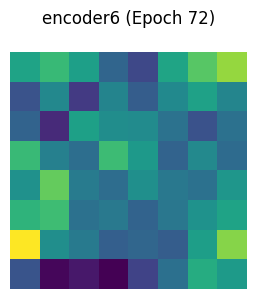

decoder1: torch.Size([3, 48, 8, 8])


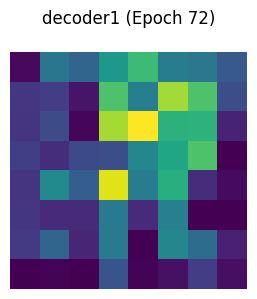

decoder2: torch.Size([3, 32, 8, 8])


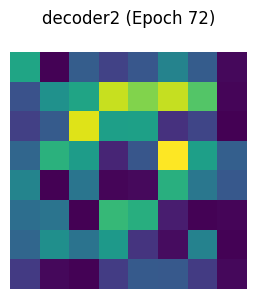

decoder3: torch.Size([3, 24, 16, 16])


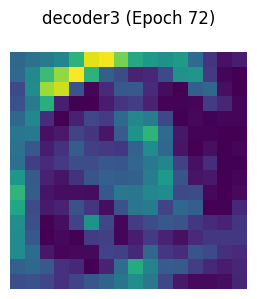

decoder4: torch.Size([3, 16, 32, 32])


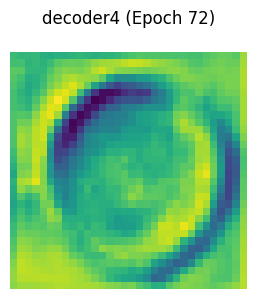

decoder5: torch.Size([3, 8, 64, 64])


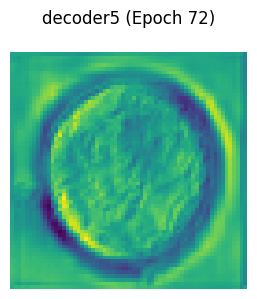

Epoch 72: Loss = 87.0939, Val Dice = 0.8245, Val mIoU = 0.7048, Val Accuracy = 0.9542, Val Sensitivity = 0.8181, Val Specificity = 0.9747


Epoch 73/100: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


[Epoch 73] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


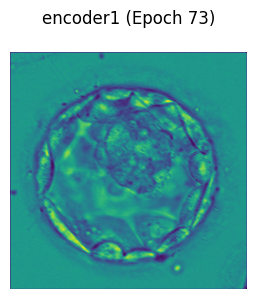

encoder2: torch.Size([3, 16, 128, 128])


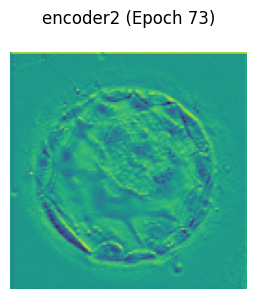

encoder3: torch.Size([3, 24, 64, 64])


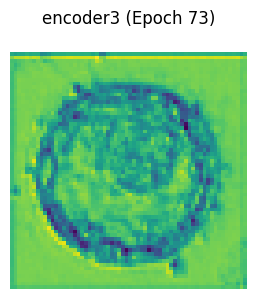

encoder4: torch.Size([3, 32, 32, 32])


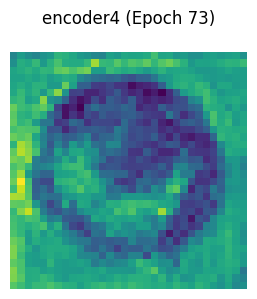

encoder5: torch.Size([3, 48, 16, 16])


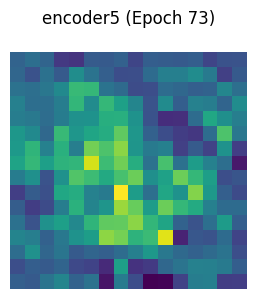

encoder6: torch.Size([3, 64, 8, 8])


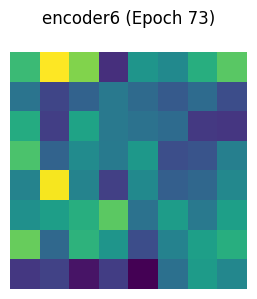

decoder1: torch.Size([3, 48, 8, 8])


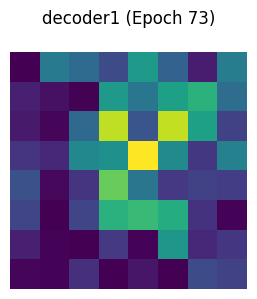

decoder2: torch.Size([3, 32, 8, 8])


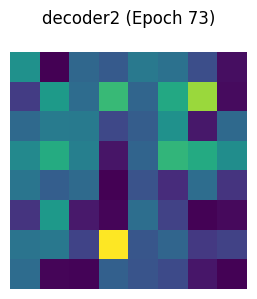

decoder3: torch.Size([3, 24, 16, 16])


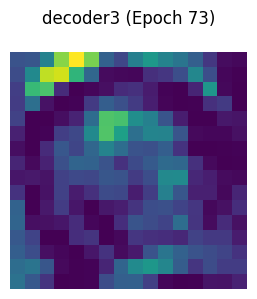

decoder4: torch.Size([3, 16, 32, 32])


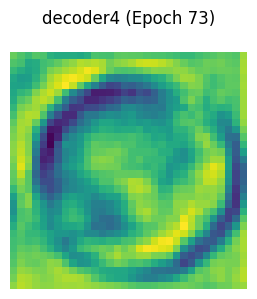

decoder5: torch.Size([3, 8, 64, 64])


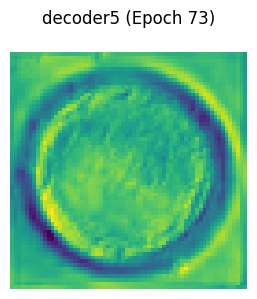

Epoch 73: Loss = 87.3337, Val Dice = 0.8267, Val mIoU = 0.7078, Val Accuracy = 0.9543, Val Sensitivity = 0.8255, Val Specificity = 0.9737


Epoch 74/100: 100%|██████████| 125/125 [01:45<00:00,  1.18it/s]


[Epoch 74] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


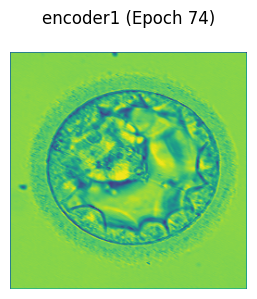

encoder2: torch.Size([3, 16, 128, 128])


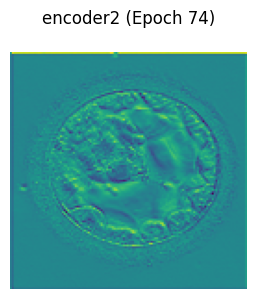

encoder3: torch.Size([3, 24, 64, 64])


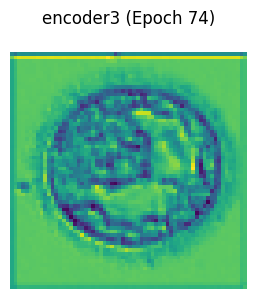

encoder4: torch.Size([3, 32, 32, 32])


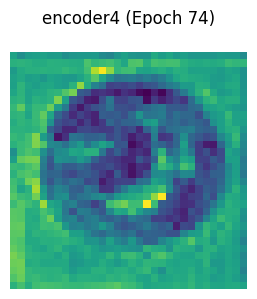

encoder5: torch.Size([3, 48, 16, 16])


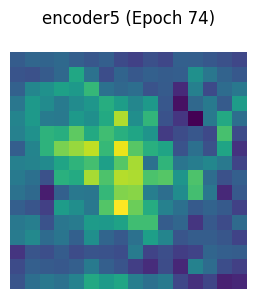

encoder6: torch.Size([3, 64, 8, 8])


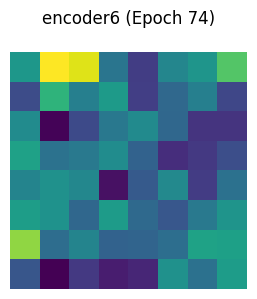

decoder1: torch.Size([3, 48, 8, 8])


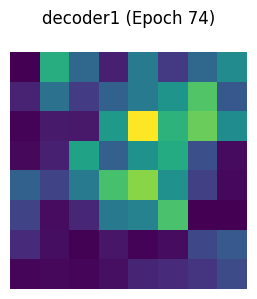

decoder2: torch.Size([3, 32, 8, 8])


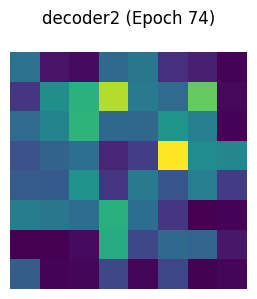

decoder3: torch.Size([3, 24, 16, 16])


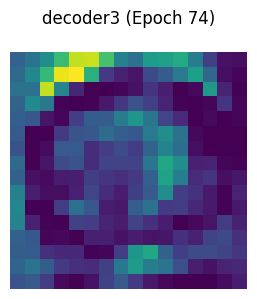

decoder4: torch.Size([3, 16, 32, 32])


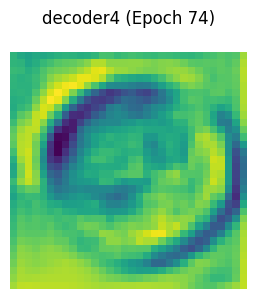

decoder5: torch.Size([3, 8, 64, 64])


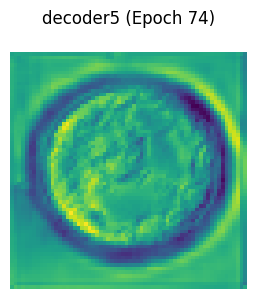

Epoch 74: Loss = 87.2477, Val Dice = 0.8397, Val mIoU = 0.7255, Val Accuracy = 0.9573, Val Sensitivity = 0.8389, Val Specificity = 0.9752


Epoch 75/100: 100%|██████████| 125/125 [01:46<00:00,  1.18it/s]


[Epoch 75] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


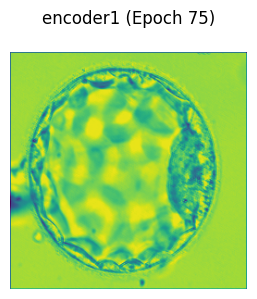

encoder2: torch.Size([3, 16, 128, 128])


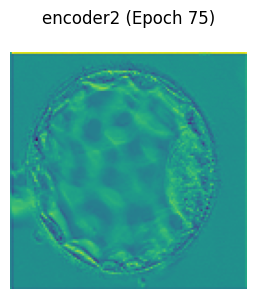

encoder3: torch.Size([3, 24, 64, 64])


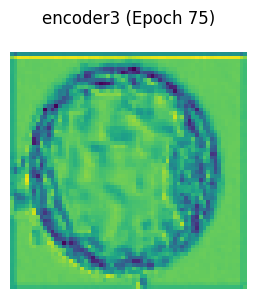

encoder4: torch.Size([3, 32, 32, 32])


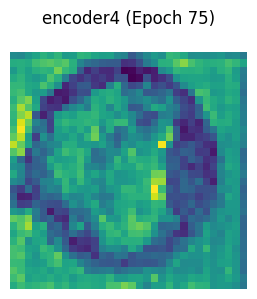

encoder5: torch.Size([3, 48, 16, 16])


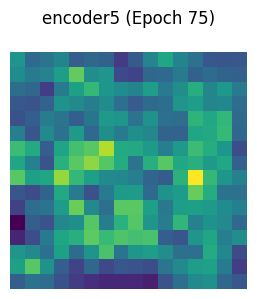

encoder6: torch.Size([3, 64, 8, 8])


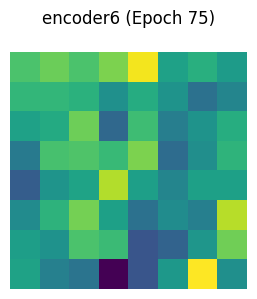

decoder1: torch.Size([3, 48, 8, 8])


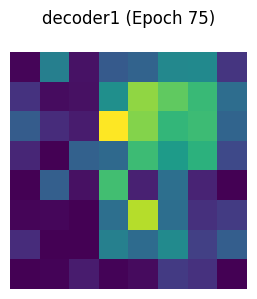

decoder2: torch.Size([3, 32, 8, 8])


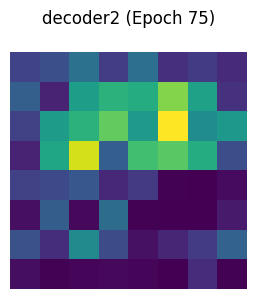

decoder3: torch.Size([3, 24, 16, 16])


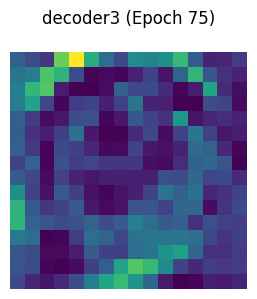

decoder4: torch.Size([3, 16, 32, 32])


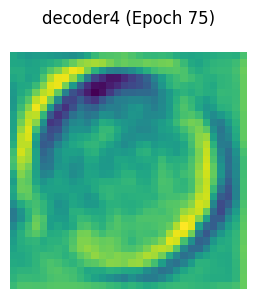

decoder5: torch.Size([3, 8, 64, 64])


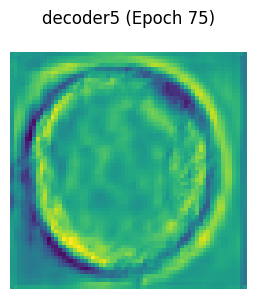

Epoch 75: Loss = 87.4921, Val Dice = 0.8281, Val mIoU = 0.7087, Val Accuracy = 0.9547, Val Sensitivity = 0.8145, Val Specificity = 0.9767


Epoch 76/100: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


[Epoch 76] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


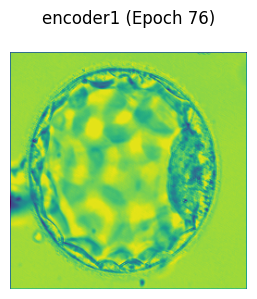

encoder2: torch.Size([3, 16, 128, 128])


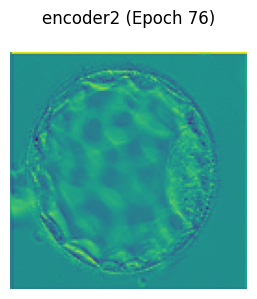

encoder3: torch.Size([3, 24, 64, 64])


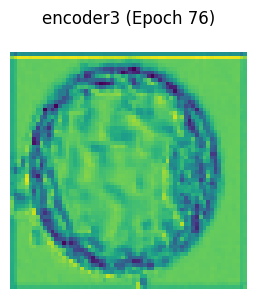

encoder4: torch.Size([3, 32, 32, 32])


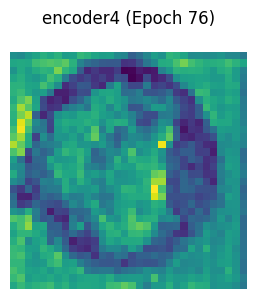

encoder5: torch.Size([3, 48, 16, 16])


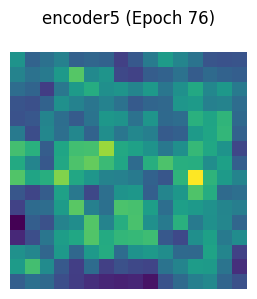

encoder6: torch.Size([3, 64, 8, 8])


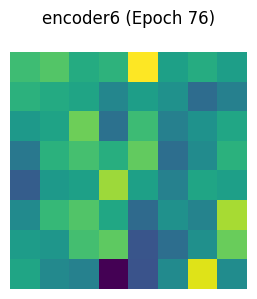

decoder1: torch.Size([3, 48, 8, 8])


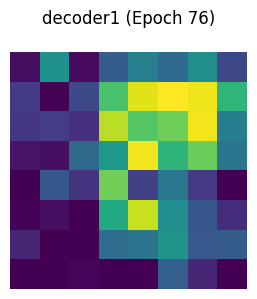

decoder2: torch.Size([3, 32, 8, 8])


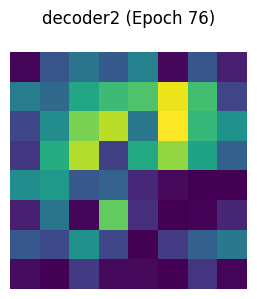

decoder3: torch.Size([3, 24, 16, 16])


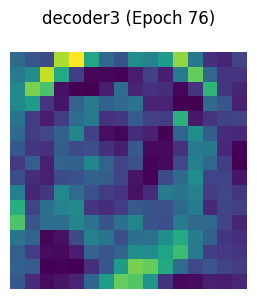

decoder4: torch.Size([3, 16, 32, 32])


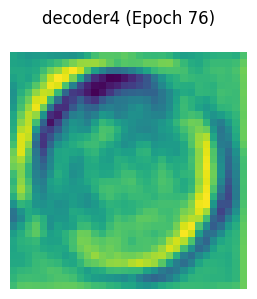

decoder5: torch.Size([3, 8, 64, 64])


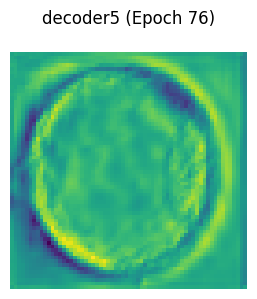

Epoch 76: Loss = 87.6660, Val Dice = 0.8360, Val mIoU = 0.7203, Val Accuracy = 0.9549, Val Sensitivity = 0.8636, Val Specificity = 0.9686


Epoch 77/100: 100%|██████████| 125/125 [01:46<00:00,  1.18it/s]


[Epoch 77] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


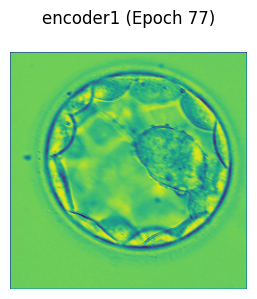

encoder2: torch.Size([3, 16, 128, 128])


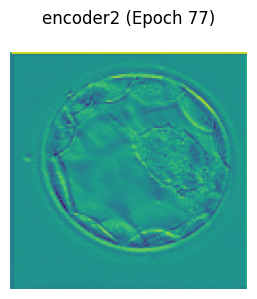

encoder3: torch.Size([3, 24, 64, 64])


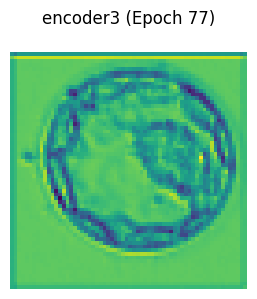

encoder4: torch.Size([3, 32, 32, 32])


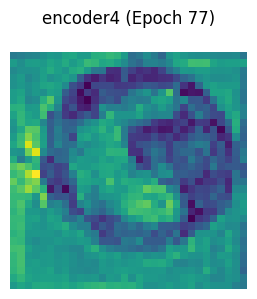

encoder5: torch.Size([3, 48, 16, 16])


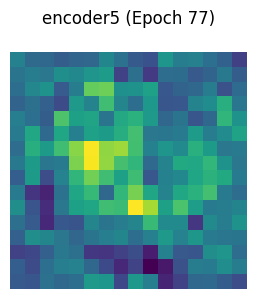

encoder6: torch.Size([3, 64, 8, 8])


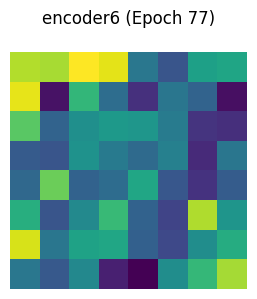

decoder1: torch.Size([3, 48, 8, 8])


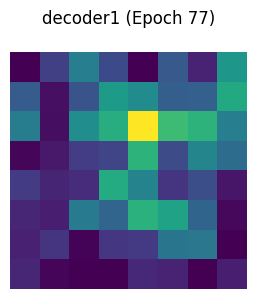

decoder2: torch.Size([3, 32, 8, 8])


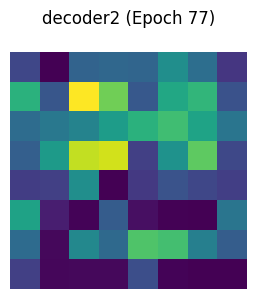

decoder3: torch.Size([3, 24, 16, 16])


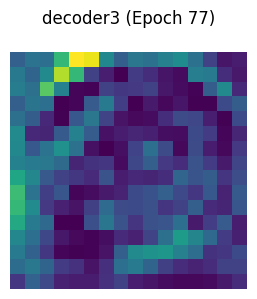

decoder4: torch.Size([3, 16, 32, 32])


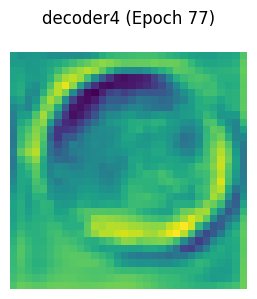

decoder5: torch.Size([3, 8, 64, 64])


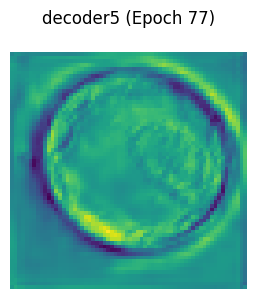

Epoch 77: Loss = 87.9095, Val Dice = 0.8330, Val mIoU = 0.7162, Val Accuracy = 0.9567, Val Sensitivity = 0.8141, Val Specificity = 0.9777


Epoch 78/100: 100%|██████████| 125/125 [01:46<00:00,  1.17it/s]


[Epoch 78] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


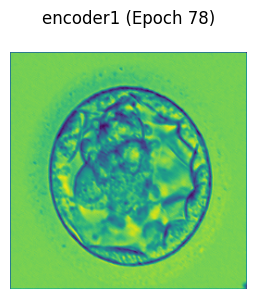

encoder2: torch.Size([3, 16, 128, 128])


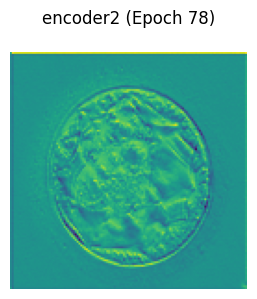

encoder3: torch.Size([3, 24, 64, 64])


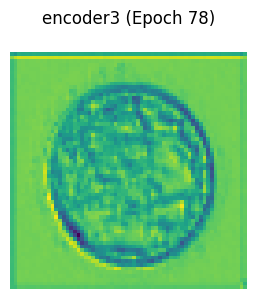

encoder4: torch.Size([3, 32, 32, 32])


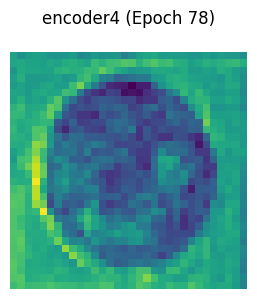

encoder5: torch.Size([3, 48, 16, 16])


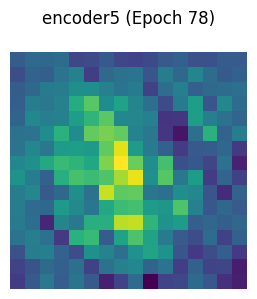

encoder6: torch.Size([3, 64, 8, 8])


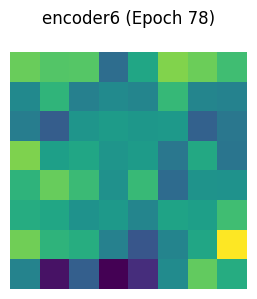

decoder1: torch.Size([3, 48, 8, 8])


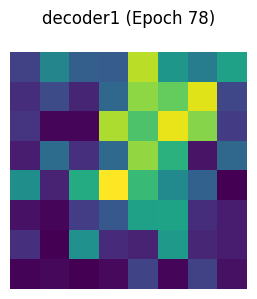

decoder2: torch.Size([3, 32, 8, 8])


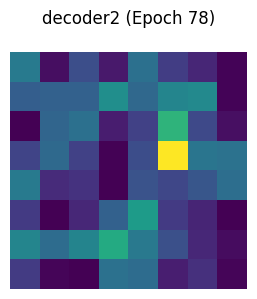

decoder3: torch.Size([3, 24, 16, 16])


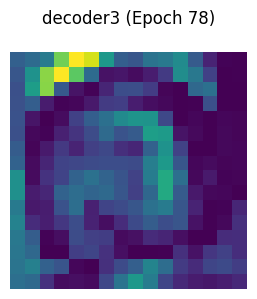

decoder4: torch.Size([3, 16, 32, 32])


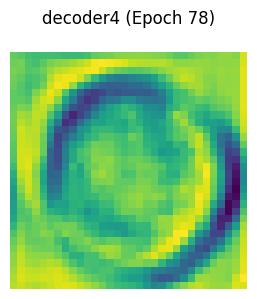

decoder5: torch.Size([3, 8, 64, 64])


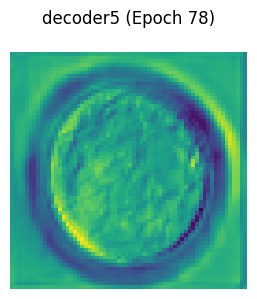

Epoch 78: Loss = 87.6338, Val Dice = 0.8330, Val mIoU = 0.7162, Val Accuracy = 0.9562, Val Sensitivity = 0.8201, Val Specificity = 0.9769


Epoch 79/100: 100%|██████████| 125/125 [01:48<00:00,  1.15it/s]


[Epoch 79] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


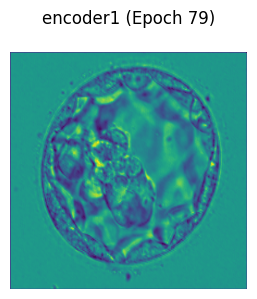

encoder2: torch.Size([3, 16, 128, 128])


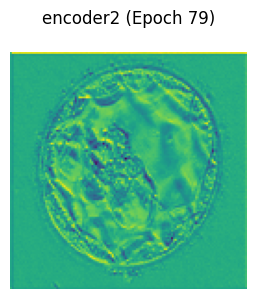

encoder3: torch.Size([3, 24, 64, 64])


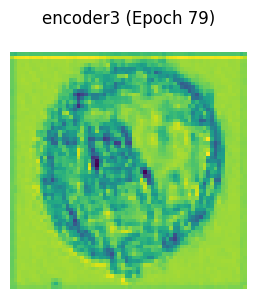

encoder4: torch.Size([3, 32, 32, 32])


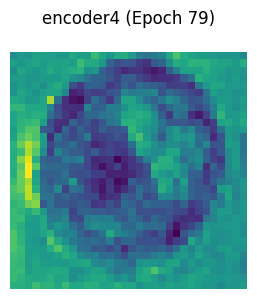

encoder5: torch.Size([3, 48, 16, 16])


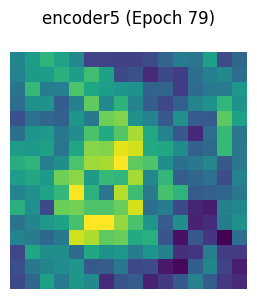

encoder6: torch.Size([3, 64, 8, 8])


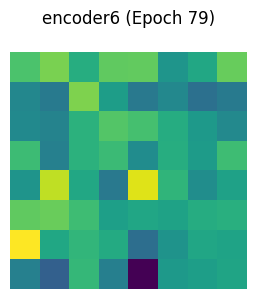

decoder1: torch.Size([3, 48, 8, 8])


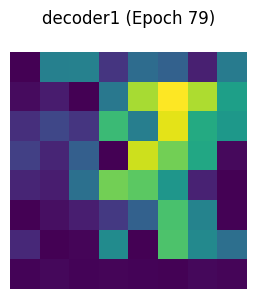

decoder2: torch.Size([3, 32, 8, 8])


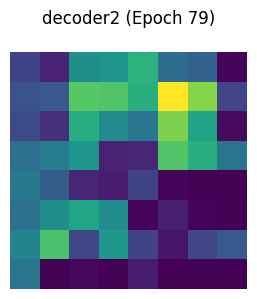

decoder3: torch.Size([3, 24, 16, 16])


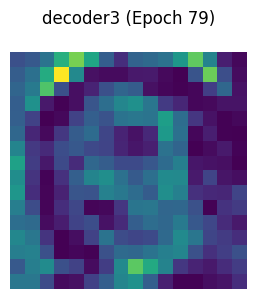

decoder4: torch.Size([3, 16, 32, 32])


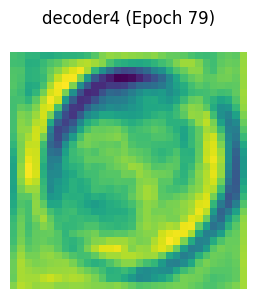

decoder5: torch.Size([3, 8, 64, 64])


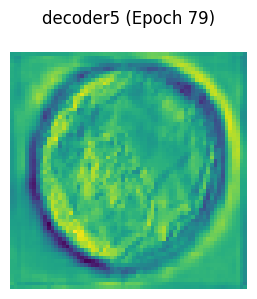

Epoch 79: Loss = 87.7246, Val Dice = 0.8259, Val mIoU = 0.7068, Val Accuracy = 0.9550, Val Sensitivity = 0.8103, Val Specificity = 0.9767


Epoch 80/100: 100%|██████████| 125/125 [01:49<00:00,  1.14it/s]


[Epoch 80] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


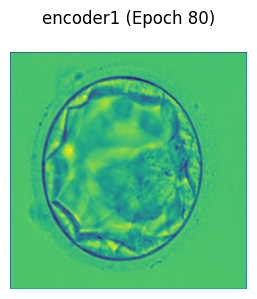

encoder2: torch.Size([3, 16, 128, 128])


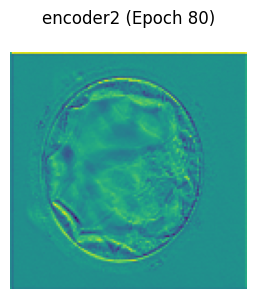

encoder3: torch.Size([3, 24, 64, 64])


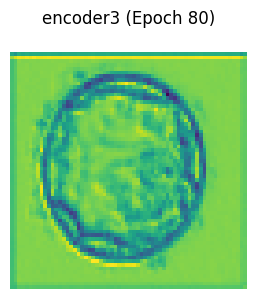

encoder4: torch.Size([3, 32, 32, 32])


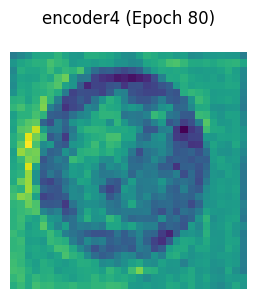

encoder5: torch.Size([3, 48, 16, 16])


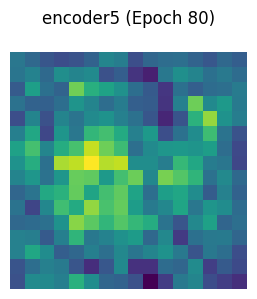

encoder6: torch.Size([3, 64, 8, 8])


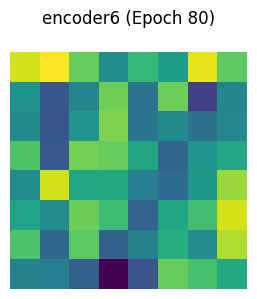

decoder1: torch.Size([3, 48, 8, 8])


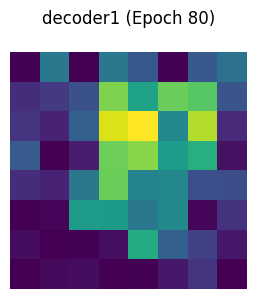

decoder2: torch.Size([3, 32, 8, 8])


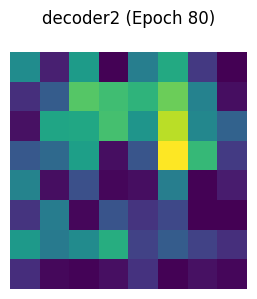

decoder3: torch.Size([3, 24, 16, 16])


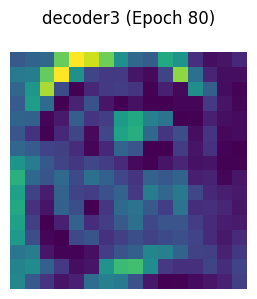

decoder4: torch.Size([3, 16, 32, 32])


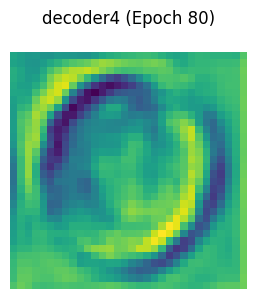

decoder5: torch.Size([3, 8, 64, 64])


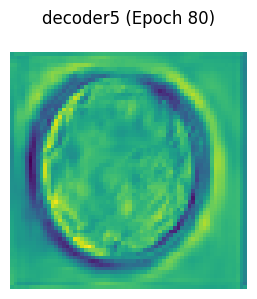

Epoch 80: Loss = 88.1816, Val Dice = 0.8287, Val mIoU = 0.7091, Val Accuracy = 0.9542, Val Sensitivity = 0.8262, Val Specificity = 0.9735


Epoch 81/100: 100%|██████████| 125/125 [01:49<00:00,  1.14it/s]


[Epoch 81] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


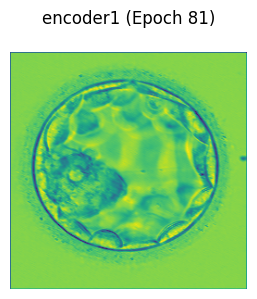

encoder2: torch.Size([3, 16, 128, 128])


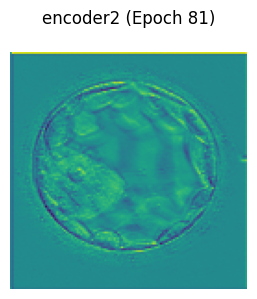

encoder3: torch.Size([3, 24, 64, 64])


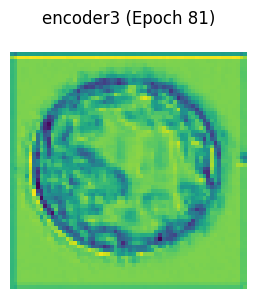

encoder4: torch.Size([3, 32, 32, 32])


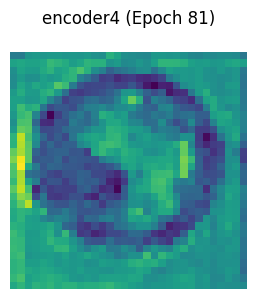

encoder5: torch.Size([3, 48, 16, 16])


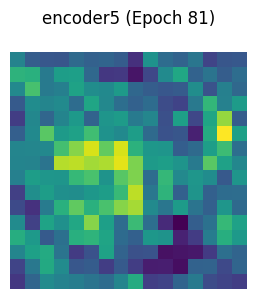

encoder6: torch.Size([3, 64, 8, 8])


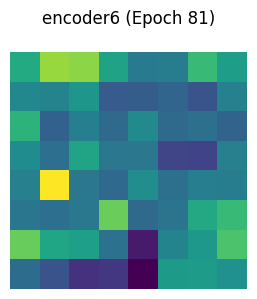

decoder1: torch.Size([3, 48, 8, 8])


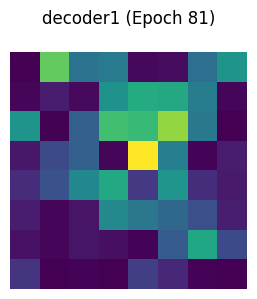

decoder2: torch.Size([3, 32, 8, 8])


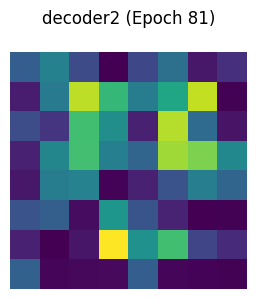

decoder3: torch.Size([3, 24, 16, 16])


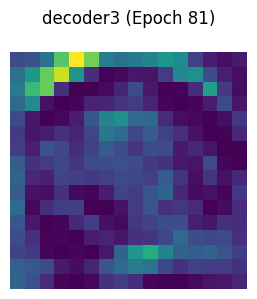

decoder4: torch.Size([3, 16, 32, 32])


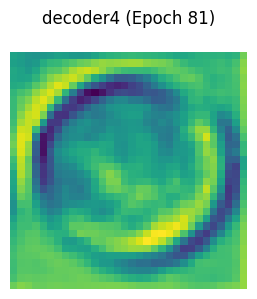

decoder5: torch.Size([3, 8, 64, 64])


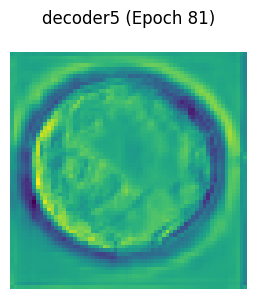

Epoch 81: Loss = 88.2907, Val Dice = 0.8273, Val mIoU = 0.7094, Val Accuracy = 0.9549, Val Sensitivity = 0.8322, Val Specificity = 0.9725


Epoch 82/100: 100%|██████████| 125/125 [01:50<00:00,  1.13it/s]


[Epoch 82] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


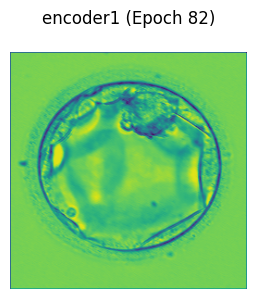

encoder2: torch.Size([3, 16, 128, 128])


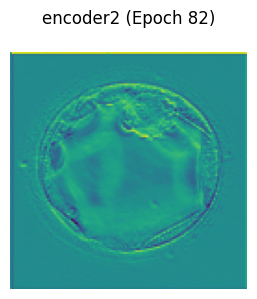

encoder3: torch.Size([3, 24, 64, 64])


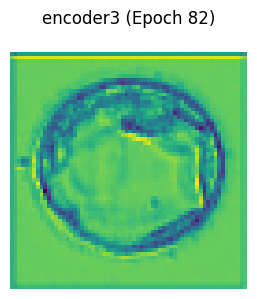

encoder4: torch.Size([3, 32, 32, 32])


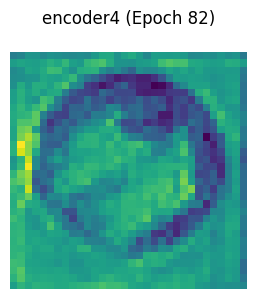

encoder5: torch.Size([3, 48, 16, 16])


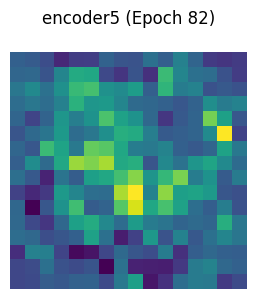

encoder6: torch.Size([3, 64, 8, 8])


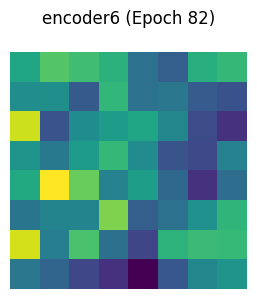

decoder1: torch.Size([3, 48, 8, 8])


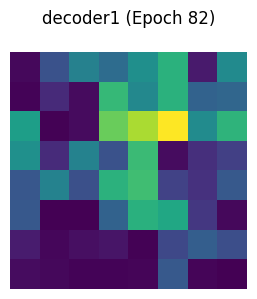

decoder2: torch.Size([3, 32, 8, 8])


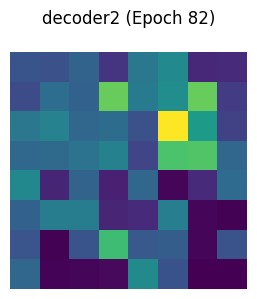

decoder3: torch.Size([3, 24, 16, 16])


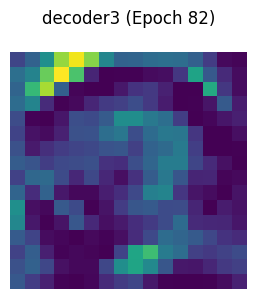

decoder4: torch.Size([3, 16, 32, 32])


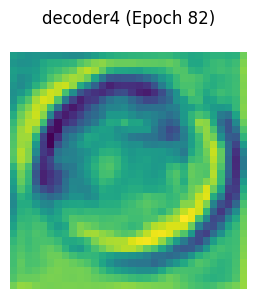

decoder5: torch.Size([3, 8, 64, 64])


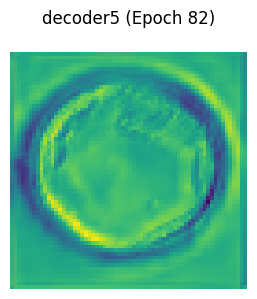

Epoch 82: Loss = 88.5783, Val Dice = 0.8402, Val mIoU = 0.7265, Val Accuracy = 0.9566, Val Sensitivity = 0.8509, Val Specificity = 0.9722


Epoch 83/100: 100%|██████████| 125/125 [01:50<00:00,  1.13it/s]


[Epoch 83] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


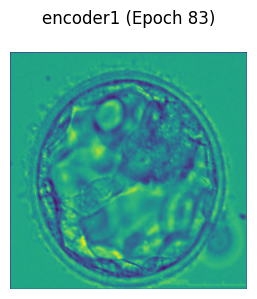

encoder2: torch.Size([3, 16, 128, 128])


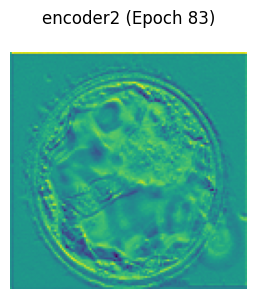

encoder3: torch.Size([3, 24, 64, 64])


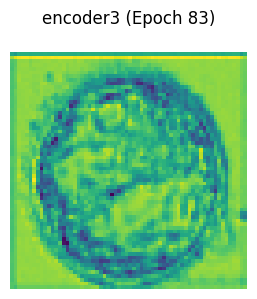

encoder4: torch.Size([3, 32, 32, 32])


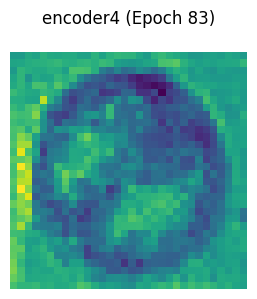

encoder5: torch.Size([3, 48, 16, 16])


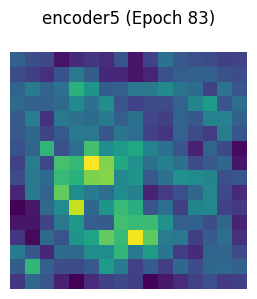

encoder6: torch.Size([3, 64, 8, 8])


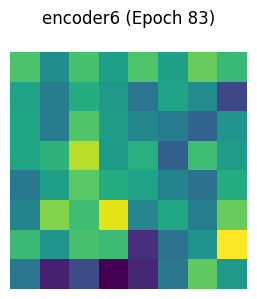

decoder1: torch.Size([3, 48, 8, 8])


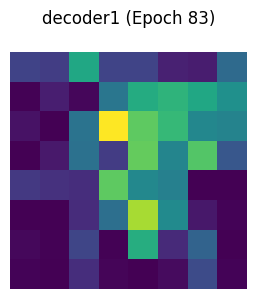

decoder2: torch.Size([3, 32, 8, 8])


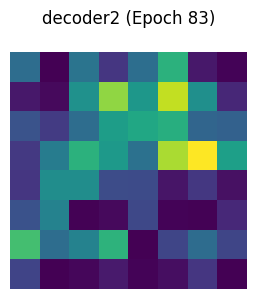

decoder3: torch.Size([3, 24, 16, 16])


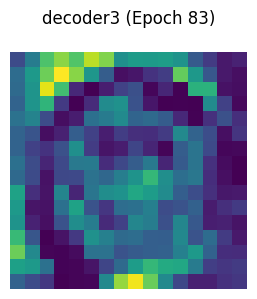

decoder4: torch.Size([3, 16, 32, 32])


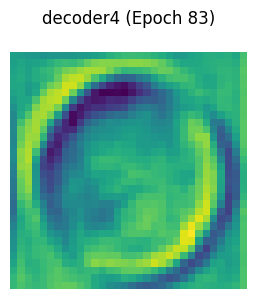

decoder5: torch.Size([3, 8, 64, 64])


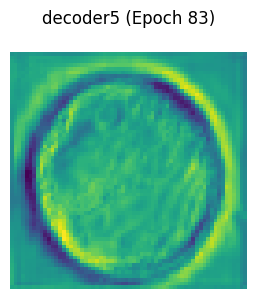

Epoch 83: Loss = 88.9418, Val Dice = 0.8308, Val mIoU = 0.7128, Val Accuracy = 0.9557, Val Sensitivity = 0.8213, Val Specificity = 0.9759


Epoch 84/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 84] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


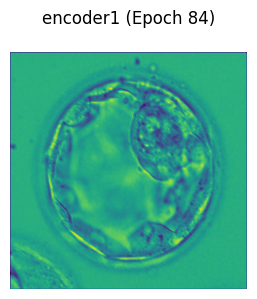

encoder2: torch.Size([3, 16, 128, 128])


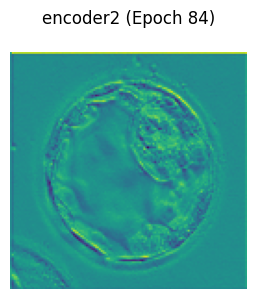

encoder3: torch.Size([3, 24, 64, 64])


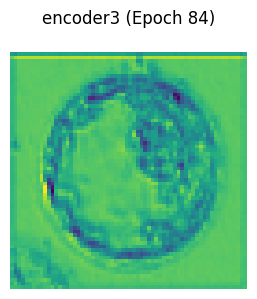

encoder4: torch.Size([3, 32, 32, 32])


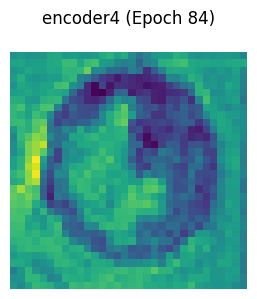

encoder5: torch.Size([3, 48, 16, 16])


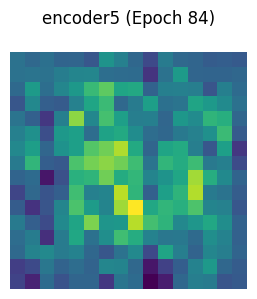

encoder6: torch.Size([3, 64, 8, 8])


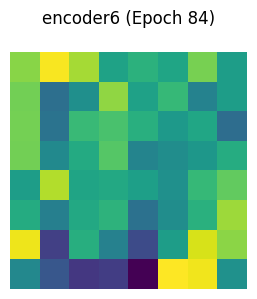

decoder1: torch.Size([3, 48, 8, 8])


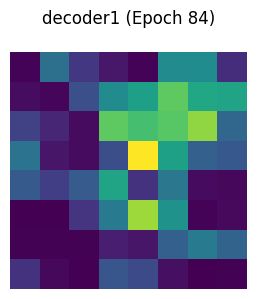

decoder2: torch.Size([3, 32, 8, 8])


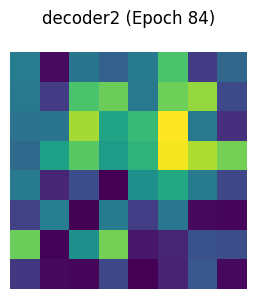

decoder3: torch.Size([3, 24, 16, 16])


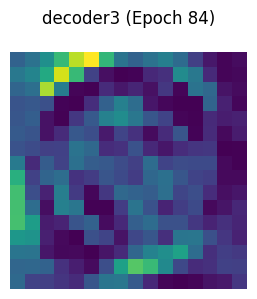

decoder4: torch.Size([3, 16, 32, 32])


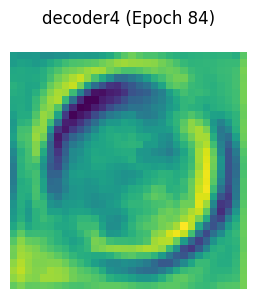

decoder5: torch.Size([3, 8, 64, 64])


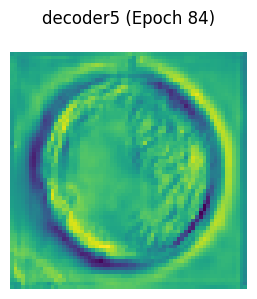

Epoch 84: Loss = 88.5720, Val Dice = 0.8294, Val mIoU = 0.7119, Val Accuracy = 0.9561, Val Sensitivity = 0.8144, Val Specificity = 0.9774


Epoch 85/100: 100%|██████████| 125/125 [01:51<00:00,  1.13it/s]


[Epoch 85] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


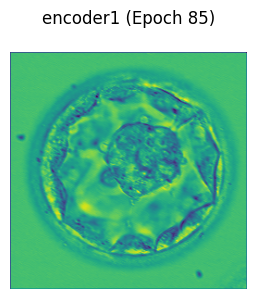

encoder2: torch.Size([3, 16, 128, 128])


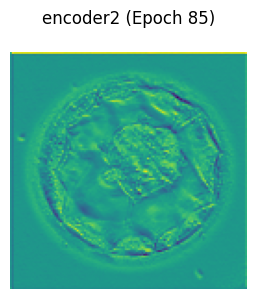

encoder3: torch.Size([3, 24, 64, 64])


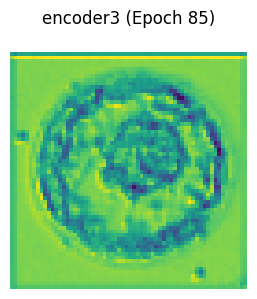

encoder4: torch.Size([3, 32, 32, 32])


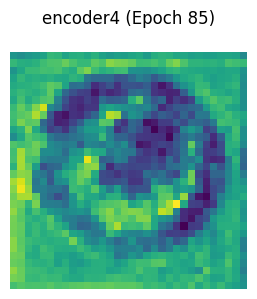

encoder5: torch.Size([3, 48, 16, 16])


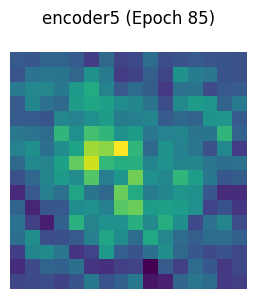

encoder6: torch.Size([3, 64, 8, 8])


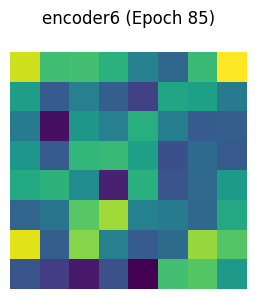

decoder1: torch.Size([3, 48, 8, 8])


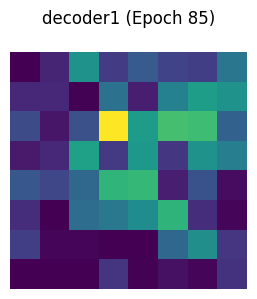

decoder2: torch.Size([3, 32, 8, 8])


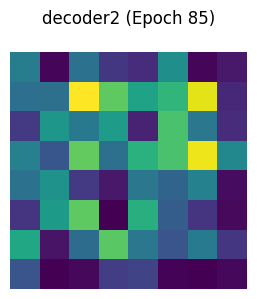

decoder3: torch.Size([3, 24, 16, 16])


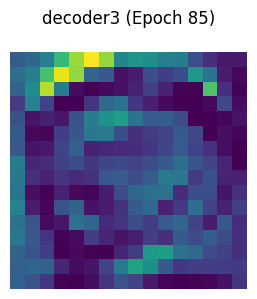

decoder4: torch.Size([3, 16, 32, 32])


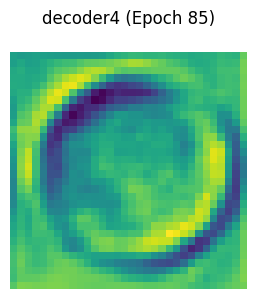

decoder5: torch.Size([3, 8, 64, 64])


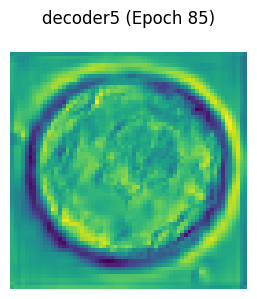

Epoch 85: Loss = 88.2050, Val Dice = 0.8348, Val mIoU = 0.7183, Val Accuracy = 0.9554, Val Sensitivity = 0.8429, Val Specificity = 0.9725


Epoch 86/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 86] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


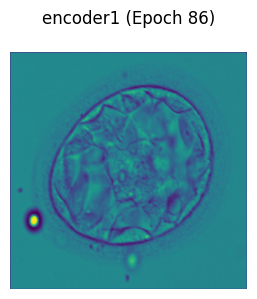

encoder2: torch.Size([3, 16, 128, 128])


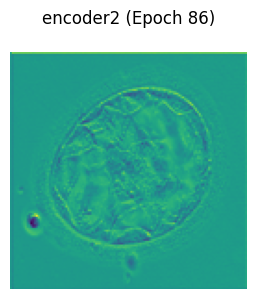

encoder3: torch.Size([3, 24, 64, 64])


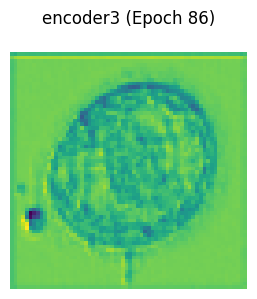

encoder4: torch.Size([3, 32, 32, 32])


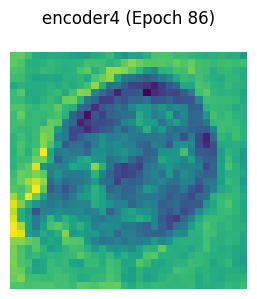

encoder5: torch.Size([3, 48, 16, 16])


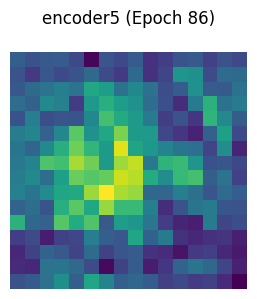

encoder6: torch.Size([3, 64, 8, 8])


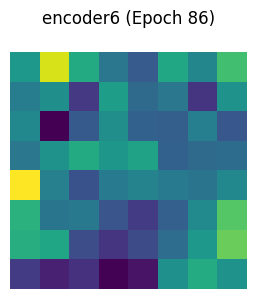

decoder1: torch.Size([3, 48, 8, 8])


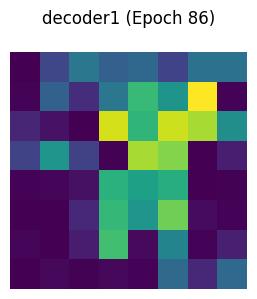

decoder2: torch.Size([3, 32, 8, 8])


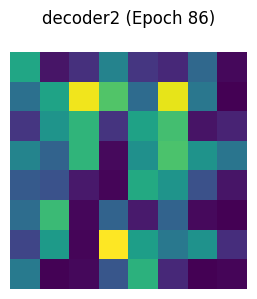

decoder3: torch.Size([3, 24, 16, 16])


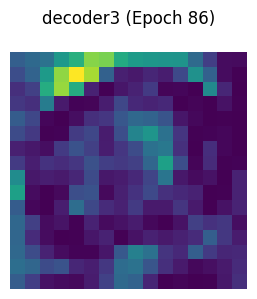

decoder4: torch.Size([3, 16, 32, 32])


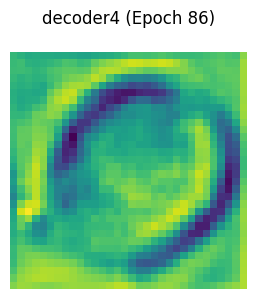

decoder5: torch.Size([3, 8, 64, 64])


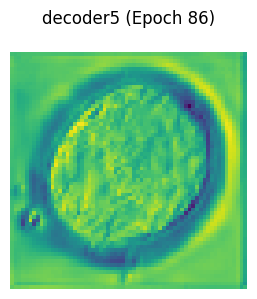

Epoch 86: Loss = 88.4346, Val Dice = 0.8428, Val mIoU = 0.7295, Val Accuracy = 0.9565, Val Sensitivity = 0.8648, Val Specificity = 0.9702


Epoch 87/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 87] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


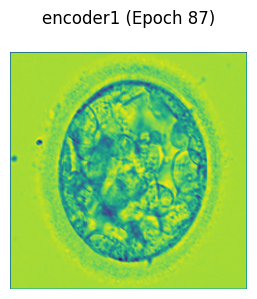

encoder2: torch.Size([3, 16, 128, 128])


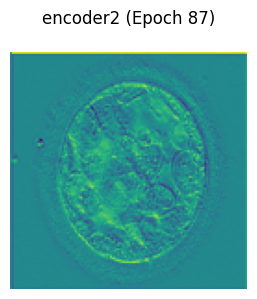

encoder3: torch.Size([3, 24, 64, 64])


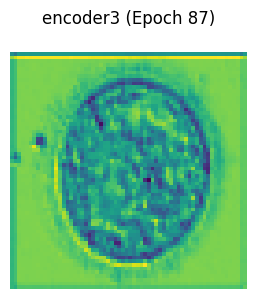

encoder4: torch.Size([3, 32, 32, 32])


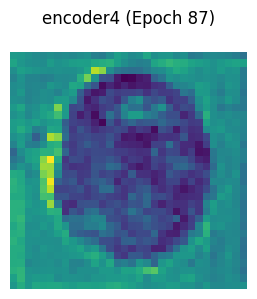

encoder5: torch.Size([3, 48, 16, 16])


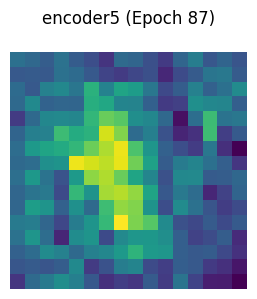

encoder6: torch.Size([3, 64, 8, 8])


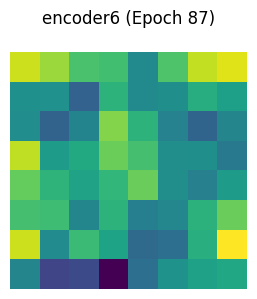

decoder1: torch.Size([3, 48, 8, 8])


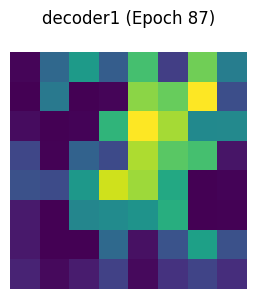

decoder2: torch.Size([3, 32, 8, 8])


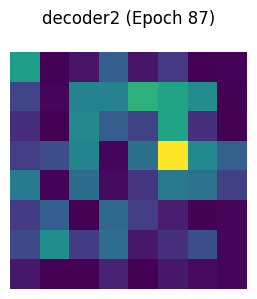

decoder3: torch.Size([3, 24, 16, 16])


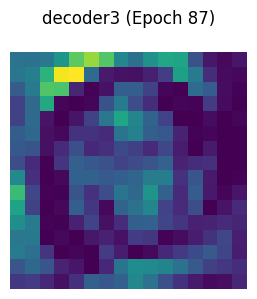

decoder4: torch.Size([3, 16, 32, 32])


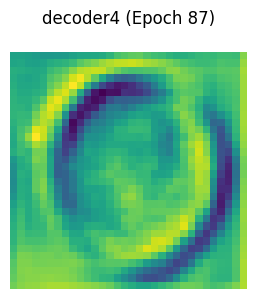

decoder5: torch.Size([3, 8, 64, 64])


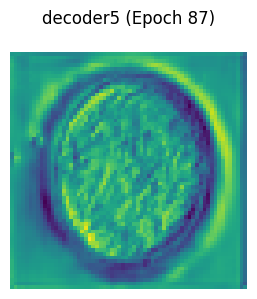

Epoch 87: Loss = 89.1845, Val Dice = 0.8569, Val mIoU = 0.7499, Val Accuracy = 0.9587, Val Sensitivity = 0.8849, Val Specificity = 0.9711


Epoch 88/100: 100%|██████████| 125/125 [01:52<00:00,  1.12it/s]


[Epoch 88] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


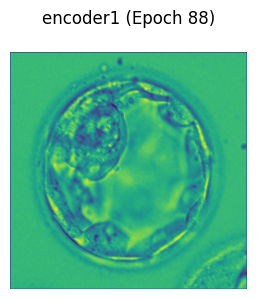

encoder2: torch.Size([3, 16, 128, 128])


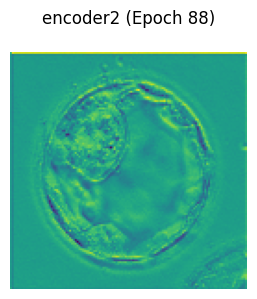

encoder3: torch.Size([3, 24, 64, 64])


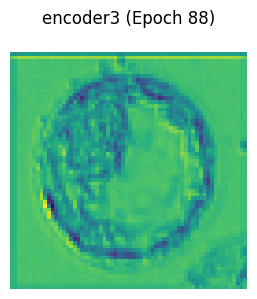

encoder4: torch.Size([3, 32, 32, 32])


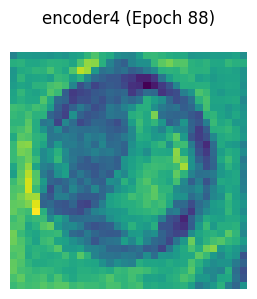

encoder5: torch.Size([3, 48, 16, 16])


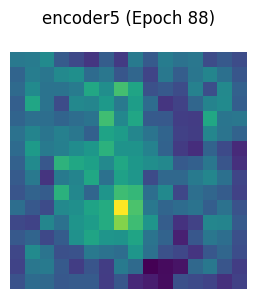

encoder6: torch.Size([3, 64, 8, 8])


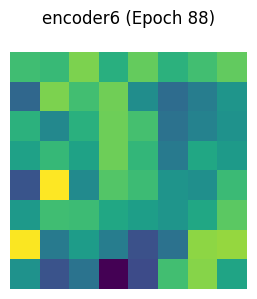

decoder1: torch.Size([3, 48, 8, 8])


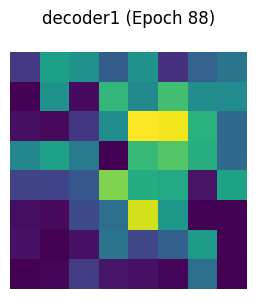

decoder2: torch.Size([3, 32, 8, 8])


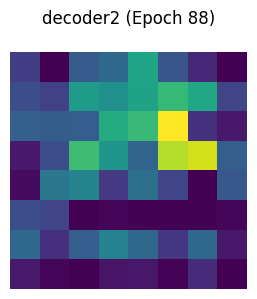

decoder3: torch.Size([3, 24, 16, 16])


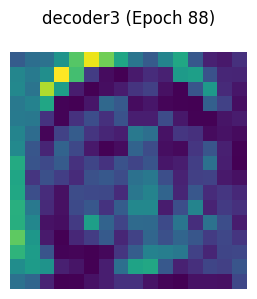

decoder4: torch.Size([3, 16, 32, 32])


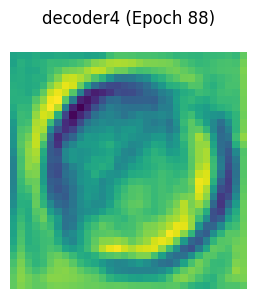

decoder5: torch.Size([3, 8, 64, 64])


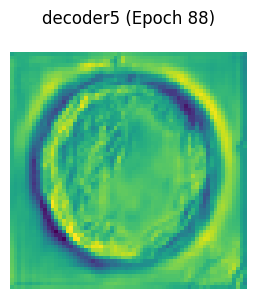

Epoch 88: Loss = 89.1086, Val Dice = 0.8291, Val mIoU = 0.7108, Val Accuracy = 0.9535, Val Sensitivity = 0.8547, Val Specificity = 0.9676


Epoch 89/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]


[Epoch 89] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


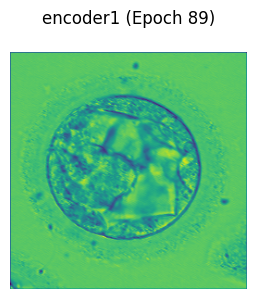

encoder2: torch.Size([3, 16, 128, 128])


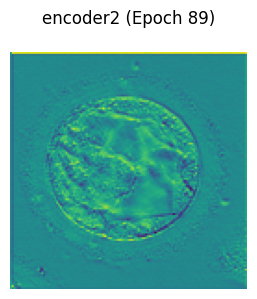

encoder3: torch.Size([3, 24, 64, 64])


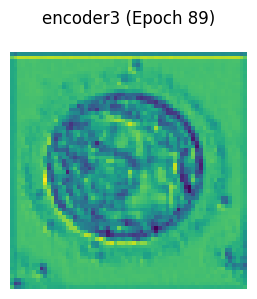

encoder4: torch.Size([3, 32, 32, 32])


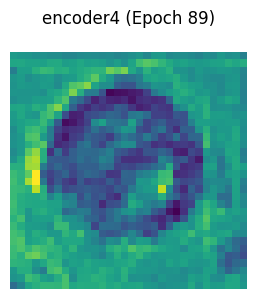

encoder5: torch.Size([3, 48, 16, 16])


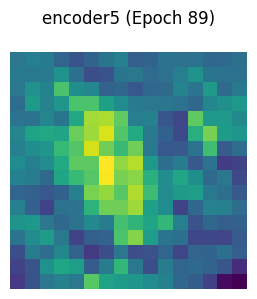

encoder6: torch.Size([3, 64, 8, 8])


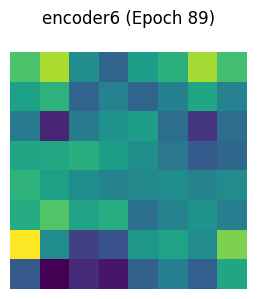

decoder1: torch.Size([3, 48, 8, 8])


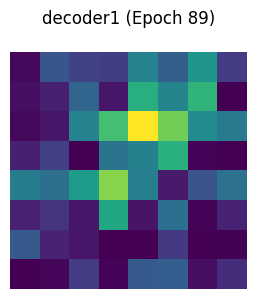

decoder2: torch.Size([3, 32, 8, 8])


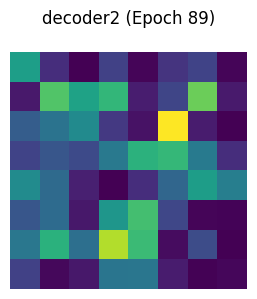

decoder3: torch.Size([3, 24, 16, 16])


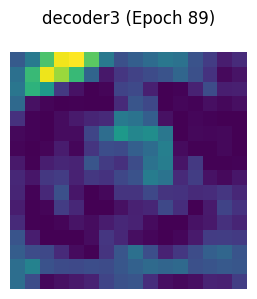

decoder4: torch.Size([3, 16, 32, 32])


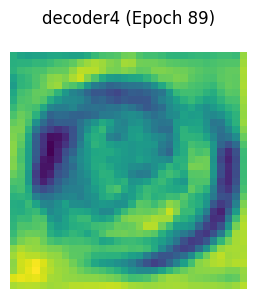

decoder5: torch.Size([3, 8, 64, 64])


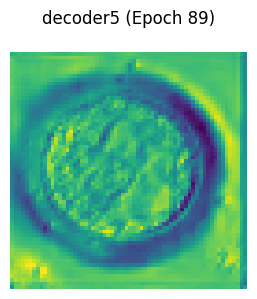

Epoch 89: Loss = 89.2036, Val Dice = 0.8336, Val mIoU = 0.7161, Val Accuracy = 0.9533, Val Sensitivity = 0.8709, Val Specificity = 0.9647


Epoch 90/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]


[Epoch 90] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


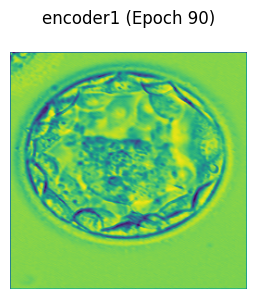

encoder2: torch.Size([3, 16, 128, 128])


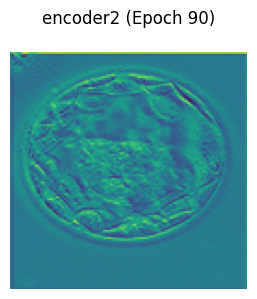

encoder3: torch.Size([3, 24, 64, 64])


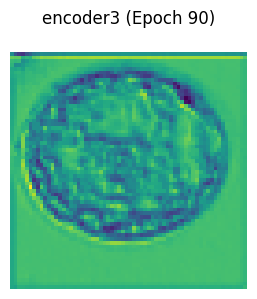

encoder4: torch.Size([3, 32, 32, 32])


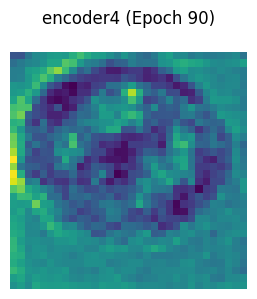

encoder5: torch.Size([3, 48, 16, 16])


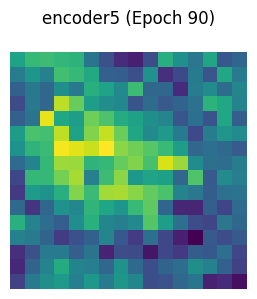

encoder6: torch.Size([3, 64, 8, 8])


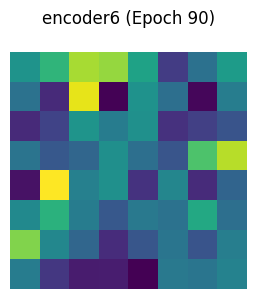

decoder1: torch.Size([3, 48, 8, 8])


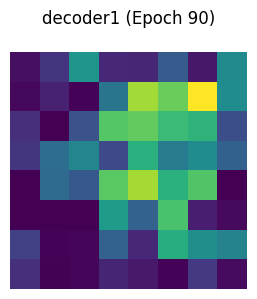

decoder2: torch.Size([3, 32, 8, 8])


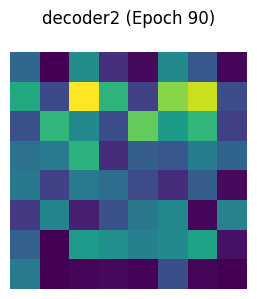

decoder3: torch.Size([3, 24, 16, 16])


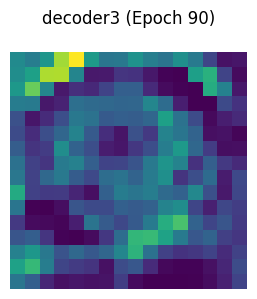

decoder4: torch.Size([3, 16, 32, 32])


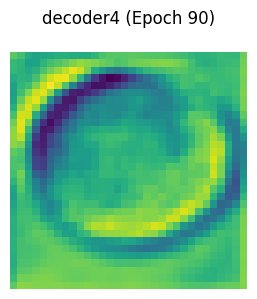

decoder5: torch.Size([3, 8, 64, 64])


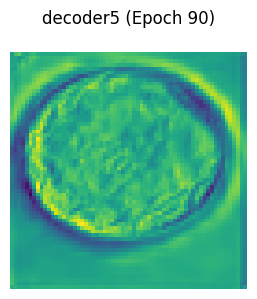

Epoch 90: Loss = 89.1787, Val Dice = 0.8553, Val mIoU = 0.7476, Val Accuracy = 0.9586, Val Sensitivity = 0.8826, Val Specificity = 0.9711


Epoch 91/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]


[Epoch 91] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


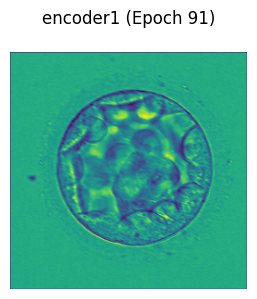

encoder2: torch.Size([3, 16, 128, 128])


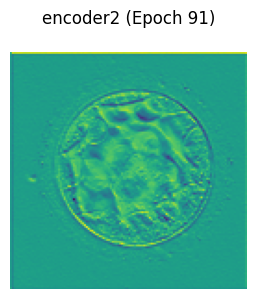

encoder3: torch.Size([3, 24, 64, 64])


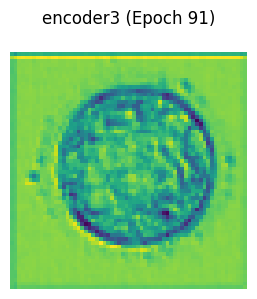

encoder4: torch.Size([3, 32, 32, 32])


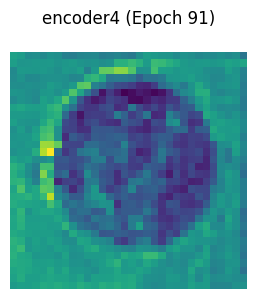

encoder5: torch.Size([3, 48, 16, 16])


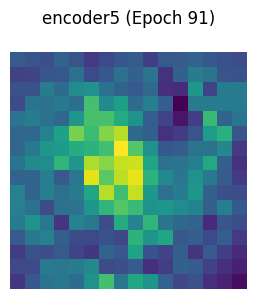

encoder6: torch.Size([3, 64, 8, 8])


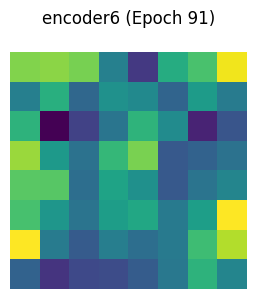

decoder1: torch.Size([3, 48, 8, 8])


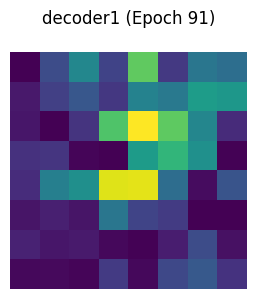

decoder2: torch.Size([3, 32, 8, 8])


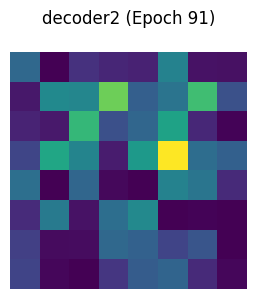

decoder3: torch.Size([3, 24, 16, 16])


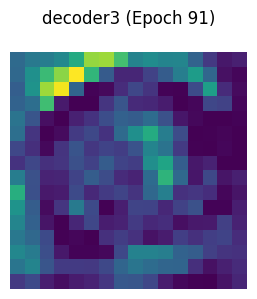

decoder4: torch.Size([3, 16, 32, 32])


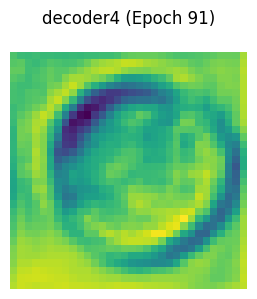

decoder5: torch.Size([3, 8, 64, 64])


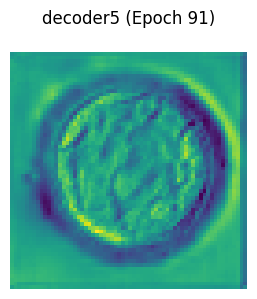

Epoch 91: Loss = 89.0324, Val Dice = 0.8353, Val mIoU = 0.7184, Val Accuracy = 0.9535, Val Sensitivity = 0.8732, Val Specificity = 0.9659


Epoch 92/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 92] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


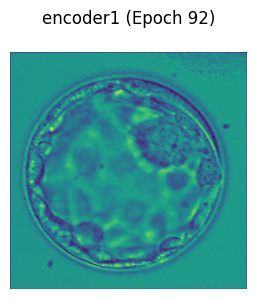

encoder2: torch.Size([3, 16, 128, 128])


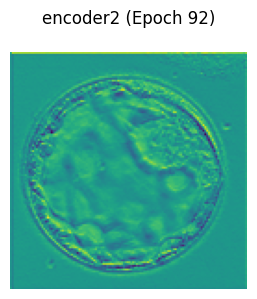

encoder3: torch.Size([3, 24, 64, 64])


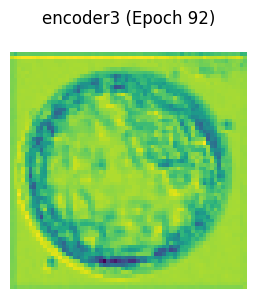

encoder4: torch.Size([3, 32, 32, 32])


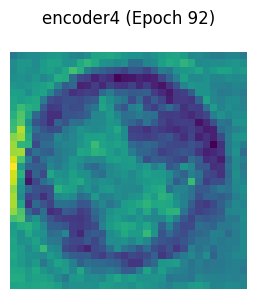

encoder5: torch.Size([3, 48, 16, 16])


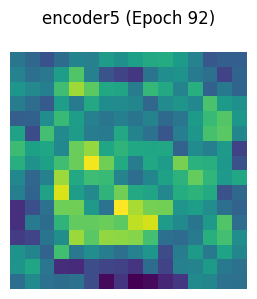

encoder6: torch.Size([3, 64, 8, 8])


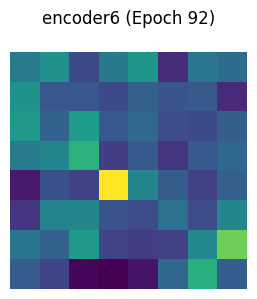

decoder1: torch.Size([3, 48, 8, 8])


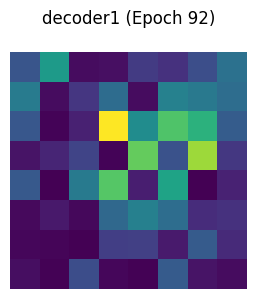

decoder2: torch.Size([3, 32, 8, 8])


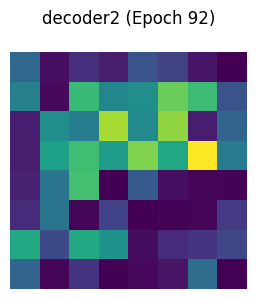

decoder3: torch.Size([3, 24, 16, 16])


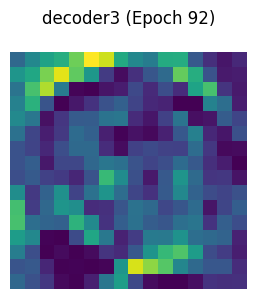

decoder4: torch.Size([3, 16, 32, 32])


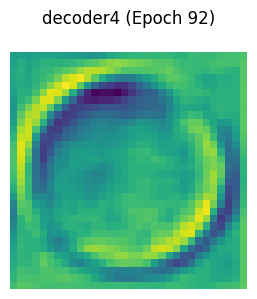

decoder5: torch.Size([3, 8, 64, 64])


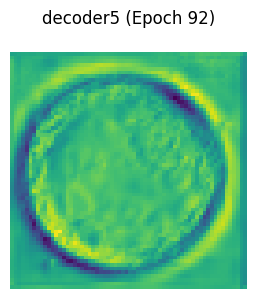

Epoch 92: Loss = 89.2903, Val Dice = 0.8339, Val mIoU = 0.7167, Val Accuracy = 0.9545, Val Sensitivity = 0.8511, Val Specificity = 0.9706


Epoch 93/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 93] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


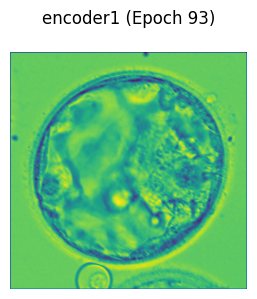

encoder2: torch.Size([3, 16, 128, 128])


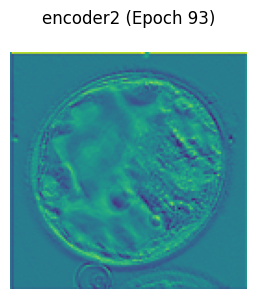

encoder3: torch.Size([3, 24, 64, 64])


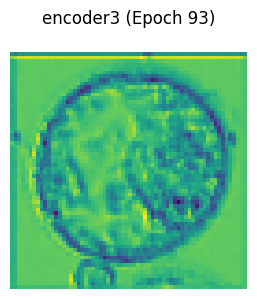

encoder4: torch.Size([3, 32, 32, 32])


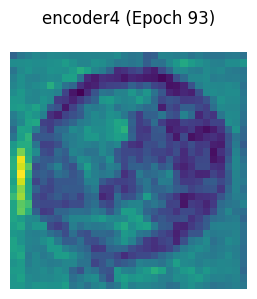

encoder5: torch.Size([3, 48, 16, 16])


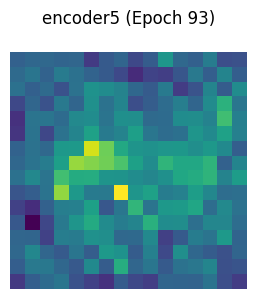

encoder6: torch.Size([3, 64, 8, 8])


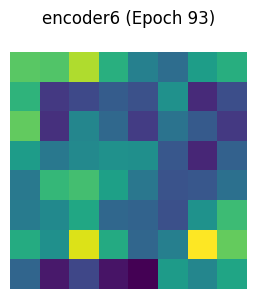

decoder1: torch.Size([3, 48, 8, 8])


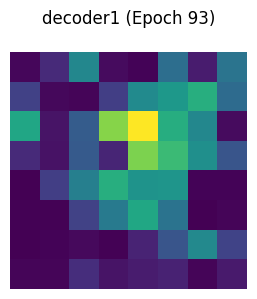

decoder2: torch.Size([3, 32, 8, 8])


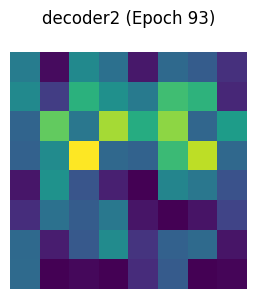

decoder3: torch.Size([3, 24, 16, 16])


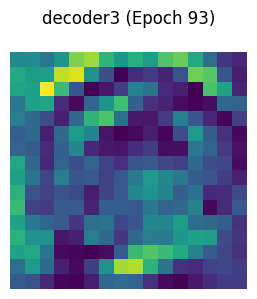

decoder4: torch.Size([3, 16, 32, 32])


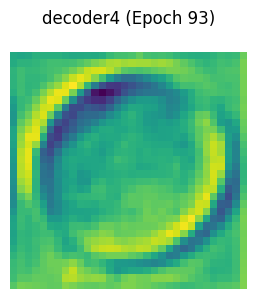

decoder5: torch.Size([3, 8, 64, 64])


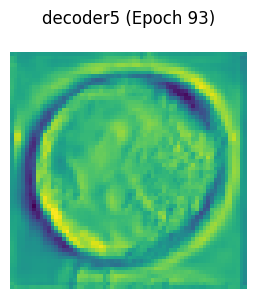

Epoch 93: Loss = 88.8668, Val Dice = 0.8372, Val mIoU = 0.7226, Val Accuracy = 0.9575, Val Sensitivity = 0.8312, Val Specificity = 0.9757


Epoch 94/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 94] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


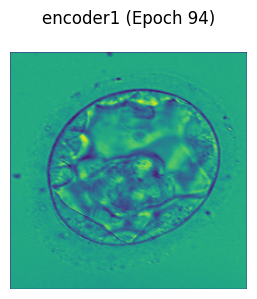

encoder2: torch.Size([3, 16, 128, 128])


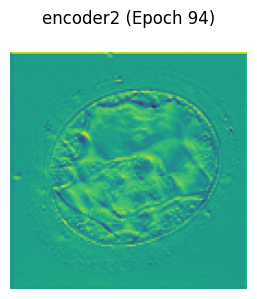

encoder3: torch.Size([3, 24, 64, 64])


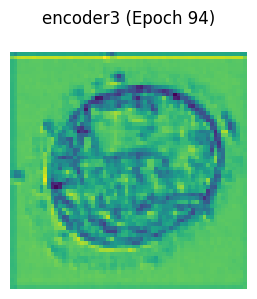

encoder4: torch.Size([3, 32, 32, 32])


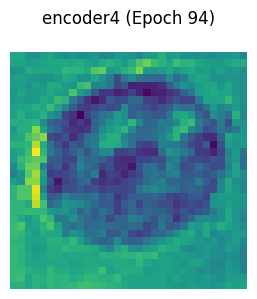

encoder5: torch.Size([3, 48, 16, 16])


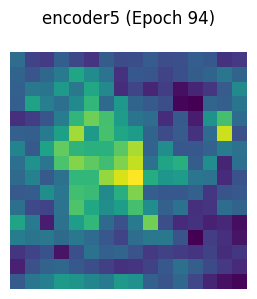

encoder6: torch.Size([3, 64, 8, 8])


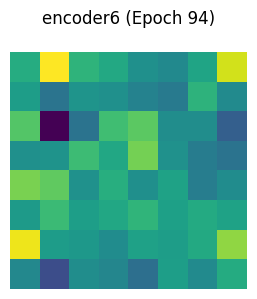

decoder1: torch.Size([3, 48, 8, 8])


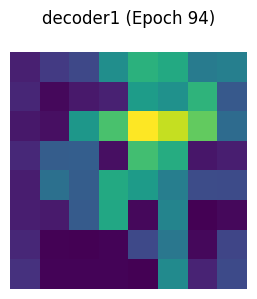

decoder2: torch.Size([3, 32, 8, 8])


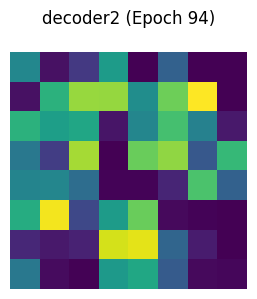

decoder3: torch.Size([3, 24, 16, 16])


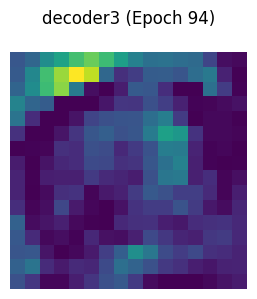

decoder4: torch.Size([3, 16, 32, 32])


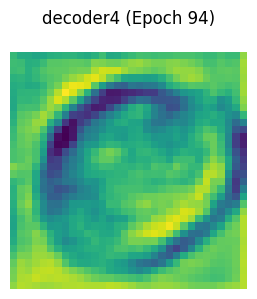

decoder5: torch.Size([3, 8, 64, 64])


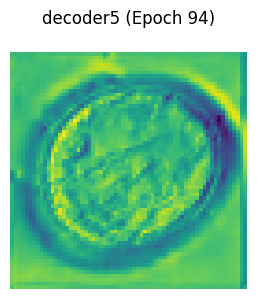

Epoch 94: Loss = 88.8628, Val Dice = 0.8350, Val mIoU = 0.7189, Val Accuracy = 0.9561, Val Sensitivity = 0.8324, Val Specificity = 0.9745


Epoch 95/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 95] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


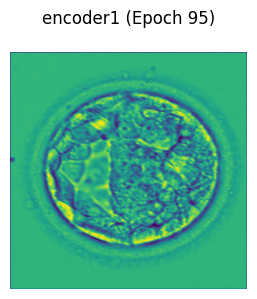

encoder2: torch.Size([3, 16, 128, 128])


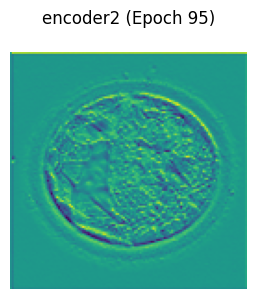

encoder3: torch.Size([3, 24, 64, 64])


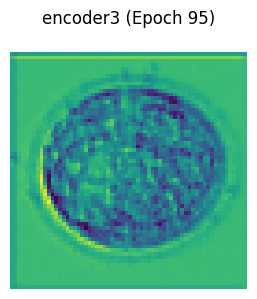

encoder4: torch.Size([3, 32, 32, 32])


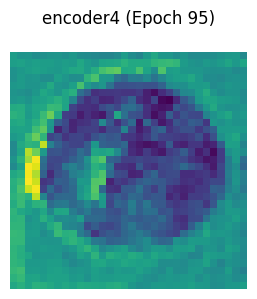

encoder5: torch.Size([3, 48, 16, 16])


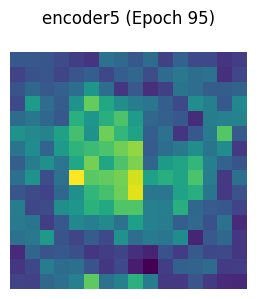

encoder6: torch.Size([3, 64, 8, 8])


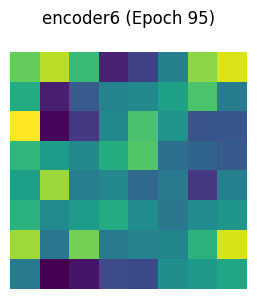

decoder1: torch.Size([3, 48, 8, 8])


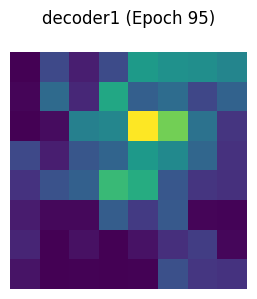

decoder2: torch.Size([3, 32, 8, 8])


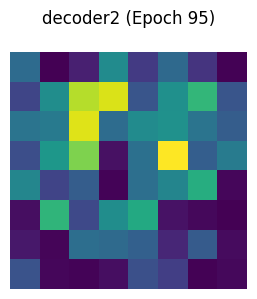

decoder3: torch.Size([3, 24, 16, 16])


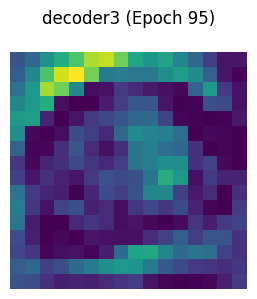

decoder4: torch.Size([3, 16, 32, 32])


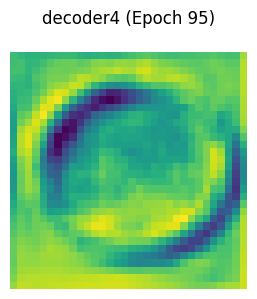

decoder5: torch.Size([3, 8, 64, 64])


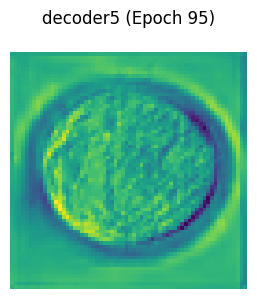

Epoch 95: Loss = 88.6050, Val Dice = 0.8531, Val mIoU = 0.7449, Val Accuracy = 0.9594, Val Sensitivity = 0.8705, Val Specificity = 0.9729


Epoch 96/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]


[Epoch 96] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


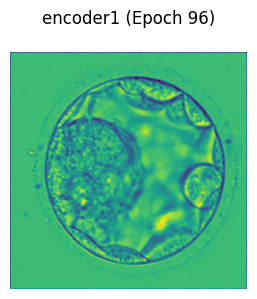

encoder2: torch.Size([3, 16, 128, 128])


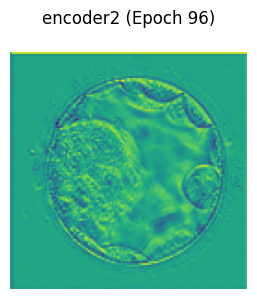

encoder3: torch.Size([3, 24, 64, 64])


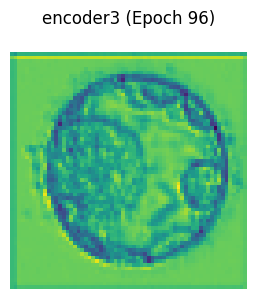

encoder4: torch.Size([3, 32, 32, 32])


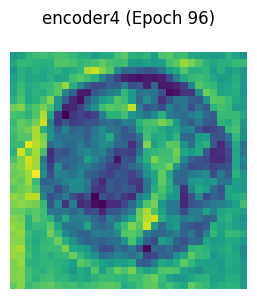

encoder5: torch.Size([3, 48, 16, 16])


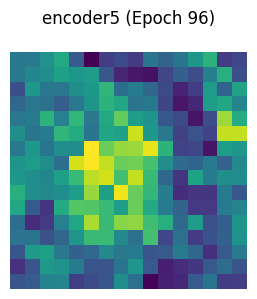

encoder6: torch.Size([3, 64, 8, 8])


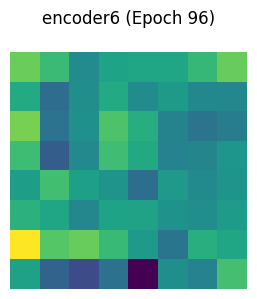

decoder1: torch.Size([3, 48, 8, 8])


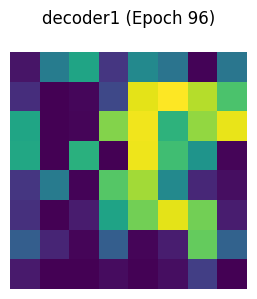

decoder2: torch.Size([3, 32, 8, 8])


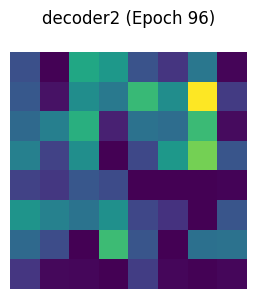

decoder3: torch.Size([3, 24, 16, 16])


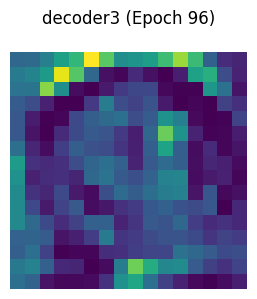

decoder4: torch.Size([3, 16, 32, 32])


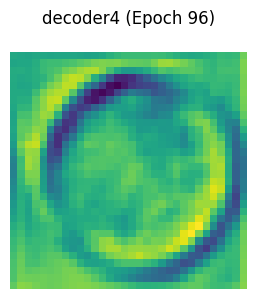

decoder5: torch.Size([3, 8, 64, 64])


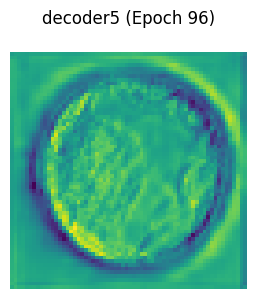

Epoch 96: Loss = 88.7240, Val Dice = 0.8461, Val mIoU = 0.7344, Val Accuracy = 0.9585, Val Sensitivity = 0.8397, Val Specificity = 0.9770


Epoch 97/100: 100%|██████████| 125/125 [01:55<00:00,  1.08it/s]


[Epoch 97] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


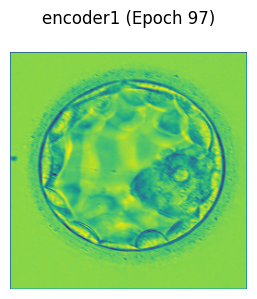

encoder2: torch.Size([3, 16, 128, 128])


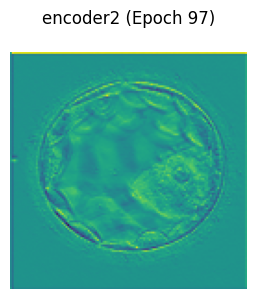

encoder3: torch.Size([3, 24, 64, 64])


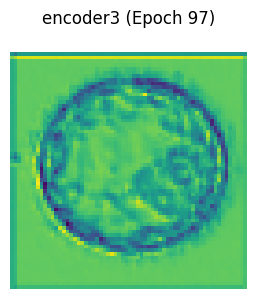

encoder4: torch.Size([3, 32, 32, 32])


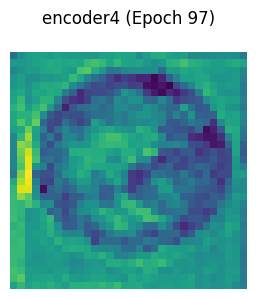

encoder5: torch.Size([3, 48, 16, 16])


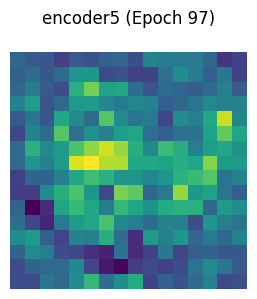

encoder6: torch.Size([3, 64, 8, 8])


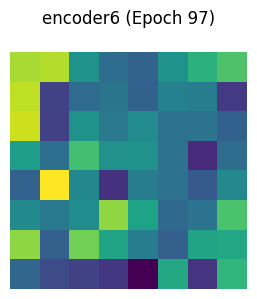

decoder1: torch.Size([3, 48, 8, 8])


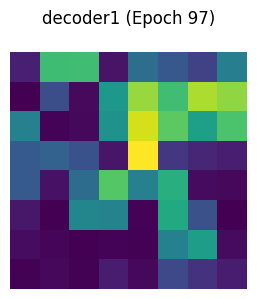

decoder2: torch.Size([3, 32, 8, 8])


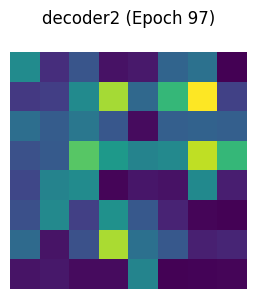

decoder3: torch.Size([3, 24, 16, 16])


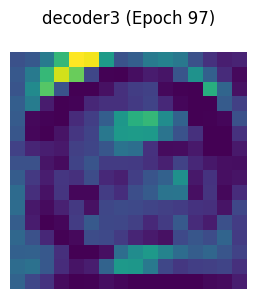

decoder4: torch.Size([3, 16, 32, 32])


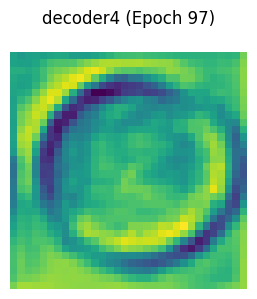

decoder5: torch.Size([3, 8, 64, 64])


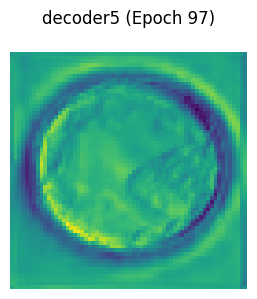

Epoch 97: Loss = 88.7915, Val Dice = 0.8485, Val mIoU = 0.7379, Val Accuracy = 0.9586, Val Sensitivity = 0.8485, Val Specificity = 0.9752


Epoch 98/100: 100%|██████████| 125/125 [01:54<00:00,  1.09it/s]


[Epoch 98] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


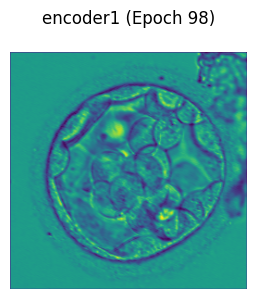

encoder2: torch.Size([3, 16, 128, 128])


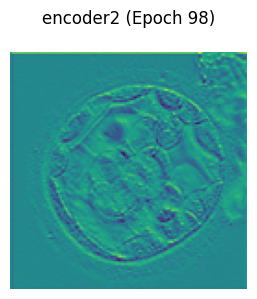

encoder3: torch.Size([3, 24, 64, 64])


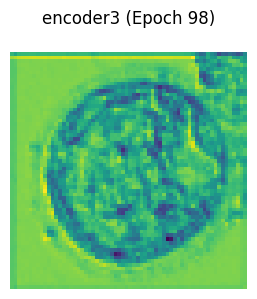

encoder4: torch.Size([3, 32, 32, 32])


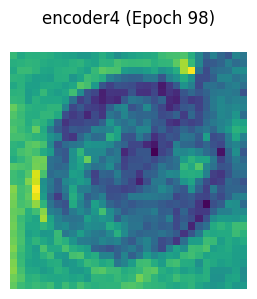

encoder5: torch.Size([3, 48, 16, 16])


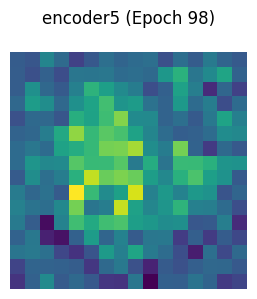

encoder6: torch.Size([3, 64, 8, 8])


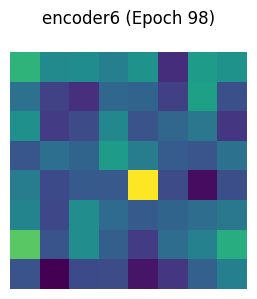

decoder1: torch.Size([3, 48, 8, 8])


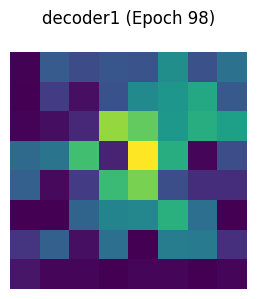

decoder2: torch.Size([3, 32, 8, 8])


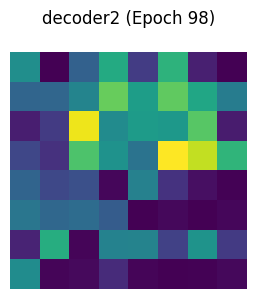

decoder3: torch.Size([3, 24, 16, 16])


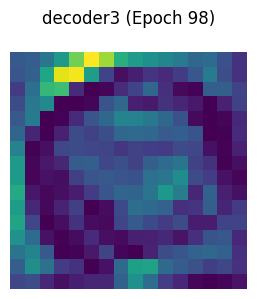

decoder4: torch.Size([3, 16, 32, 32])


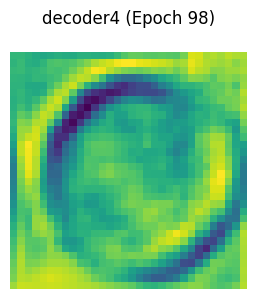

decoder5: torch.Size([3, 8, 64, 64])


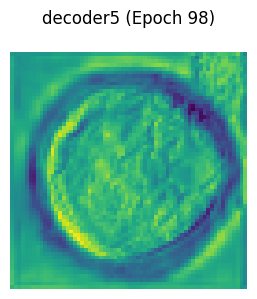

Epoch 98: Loss = 88.8364, Val Dice = 0.8384, Val mIoU = 0.7239, Val Accuracy = 0.9572, Val Sensitivity = 0.8308, Val Specificity = 0.9764


Epoch 99/100: 100%|██████████| 125/125 [01:55<00:00,  1.08it/s]


[Epoch 99] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


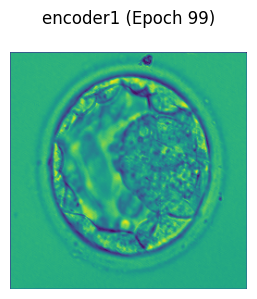

encoder2: torch.Size([3, 16, 128, 128])


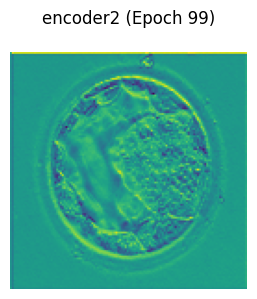

encoder3: torch.Size([3, 24, 64, 64])


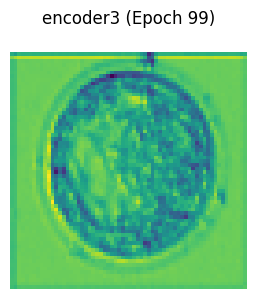

encoder4: torch.Size([3, 32, 32, 32])


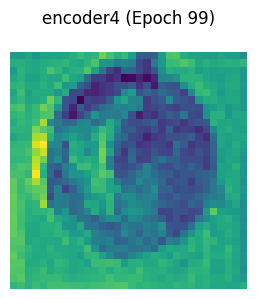

encoder5: torch.Size([3, 48, 16, 16])


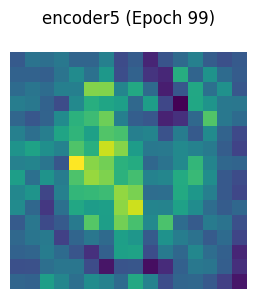

encoder6: torch.Size([3, 64, 8, 8])


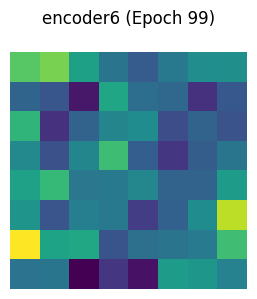

decoder1: torch.Size([3, 48, 8, 8])


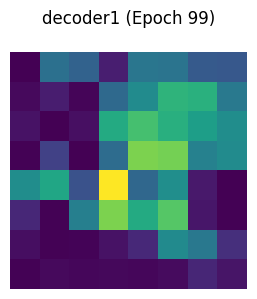

decoder2: torch.Size([3, 32, 8, 8])


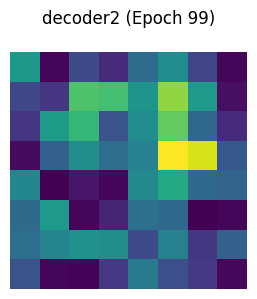

decoder3: torch.Size([3, 24, 16, 16])


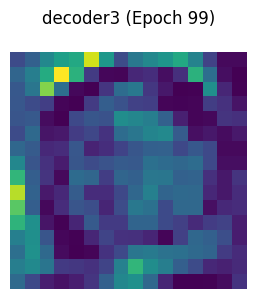

decoder4: torch.Size([3, 16, 32, 32])


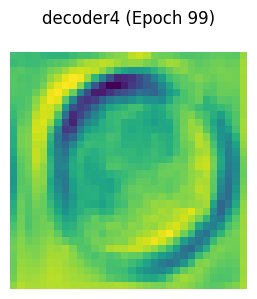

decoder5: torch.Size([3, 8, 64, 64])


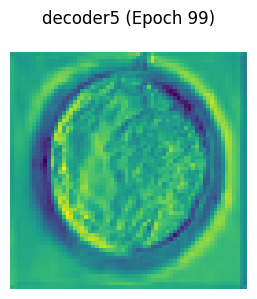

Epoch 99: Loss = 89.0952, Val Dice = 0.8361, Val mIoU = 0.7200, Val Accuracy = 0.9554, Val Sensitivity = 0.8450, Val Specificity = 0.9718


Epoch 100/100: 100%|██████████| 125/125 [01:54<00:00,  1.09it/s]


[Epoch 100] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


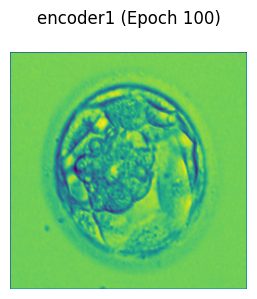

encoder2: torch.Size([3, 16, 128, 128])


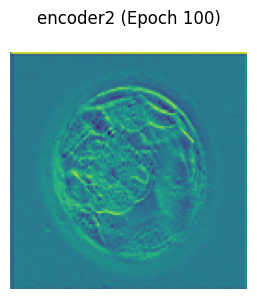

encoder3: torch.Size([3, 24, 64, 64])


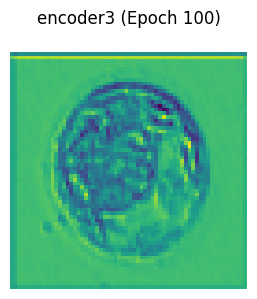

encoder4: torch.Size([3, 32, 32, 32])


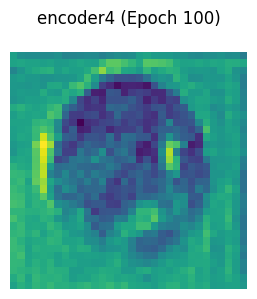

encoder5: torch.Size([3, 48, 16, 16])


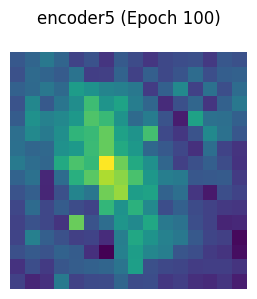

encoder6: torch.Size([3, 64, 8, 8])


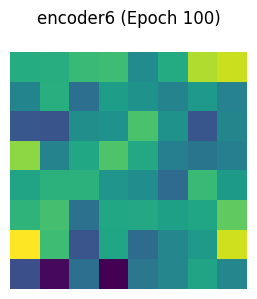

decoder1: torch.Size([3, 48, 8, 8])


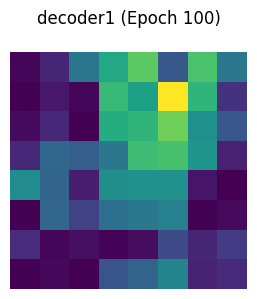

decoder2: torch.Size([3, 32, 8, 8])


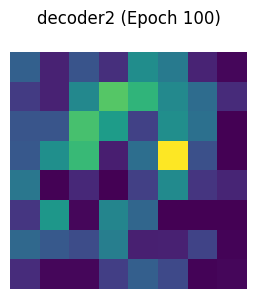

decoder3: torch.Size([3, 24, 16, 16])


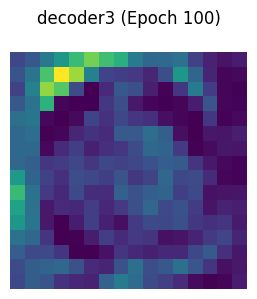

decoder4: torch.Size([3, 16, 32, 32])


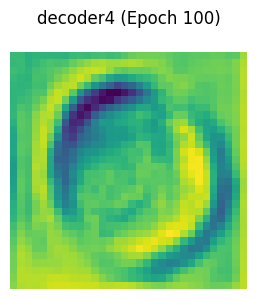

decoder5: torch.Size([3, 8, 64, 64])


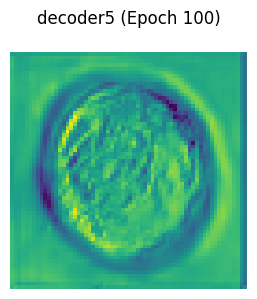

Epoch 100: Loss = 89.1034, Val Dice = 0.8291, Val mIoU = 0.7101, Val Accuracy = 0.9537, Val Sensitivity = 0.8435, Val Specificity = 0.9698


In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np

# === Feature map visualization ===
def visualize_feature_maps(feature_maps, title, n_maps=5):
    num_maps = min(n_maps, feature_maps.shape[1])
    plt.figure(figsize=(3 * num_maps, 3))  # Wider layout for horizontal arrangement
    plt.suptitle(title)

    for i in range(num_maps):
        plt.subplot(1, num_maps, i + 1)
        fmap = feature_maps[0, i].cpu().detach().numpy()
        plt.imshow(fmap, cmap='viridis')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# === Register forward hooks on specific layers ===
def register_hooks(model, layer_names):
    feature_maps = {}

    def get_hook(name):
        def hook(module, input, output):
            feature_maps[name] = output
        return hook

    handles = []
    for name, module in model.named_modules():
        if name in layer_names:
            handles.append(module.register_forward_hook(get_hook(name)))

    return feature_maps, handles

# === CONFIGURATION ===
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
EPOCHS = 100

# === MODEL ===
model = MALUNet().to(DEVICE)
optimizer = optim.AdamW(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=50, eta_min=0.00001)

# === LAYERS TO TRACK ===
tracked_layers = [
    'encoder1', 'encoder2', 'encoder3', 'encoder4', 'encoder5', 'encoder6',
    'decoder1', 'decoder2', 'decoder3', 'decoder4', 'decoder5',
]

# === TRAINING LOOP ===
for epoch in range(EPOCHS):
    model.train()
    total_loss = 0

    # Register hooks
    feature_maps, handles = register_hooks(model, tracked_layers)
    last_batch_images = None

    for images, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}"):
        images, masks = images.to(DEVICE), masks.to(DEVICE)
        last_batch_images = images  # Save last batch for visualization

        optimizer.zero_grad()
        preds = model(images)
        loss = BCEDiceLoss()(preds, masks)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    scheduler.step()

    # === Visualize Feature Maps ===
    if feature_maps:
        print(f"\n[Epoch {epoch + 1}] Feature maps:")
        for name, fmap in feature_maps.items():
            print(f"{name}: {fmap.shape}")
            visualize_feature_maps(fmap, f"{name} (Epoch {epoch+1})", n_maps=1)
    else:
        print(f"\n[Epoch {epoch + 1}] No feature maps captured.")

    # Remove hooks after each epoch
    for h in handles:
        h.remove()

    # === VALIDATION ===
    model.eval()
    with torch.no_grad():
        val_dice, val_miou, val_accuracy, val_sensitivity, val_specificity = [], [], [], [], []

        for images, masks in valid_loader:
            images, masks = images.to(DEVICE), masks.to(DEVICE)
            preds = model(images)

            TP, TN, FP, FN = get_confusion(masks, preds)
            val_dice.append(dice_score(masks, preds).item())
            val_miou.append(mean_iou(masks, preds).item())
            val_accuracy.append(accuracy(masks, preds).item())
            val_sensitivity.append(sensitivity(masks, preds).item())
            val_specificity.append(specificity(masks, preds).item())

        print(f"Epoch {epoch+1}: Loss = {total_loss:.4f}, "
              f"Val Dice = {np.mean(val_dice):.4f}, "
              f"Val mIoU = {np.mean(val_miou):.4f}, "
              f"Val Accuracy = {np.mean(val_accuracy):.4f}, "
              f"Val Sensitivity = {np.mean(val_sensitivity):.4f}, "
              f"Val Specificity = {np.mean(val_specificity):.4f}")


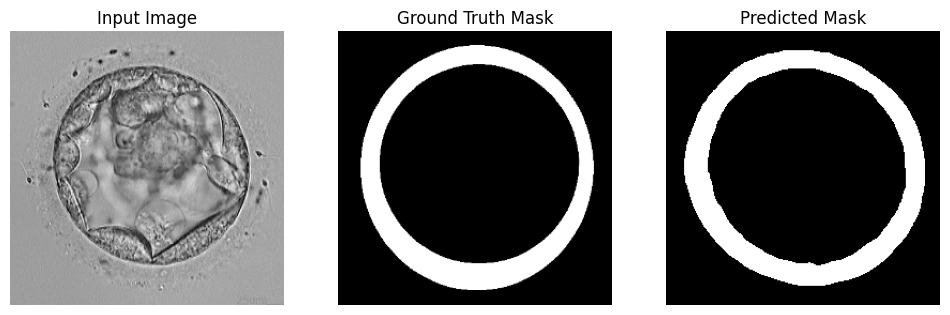

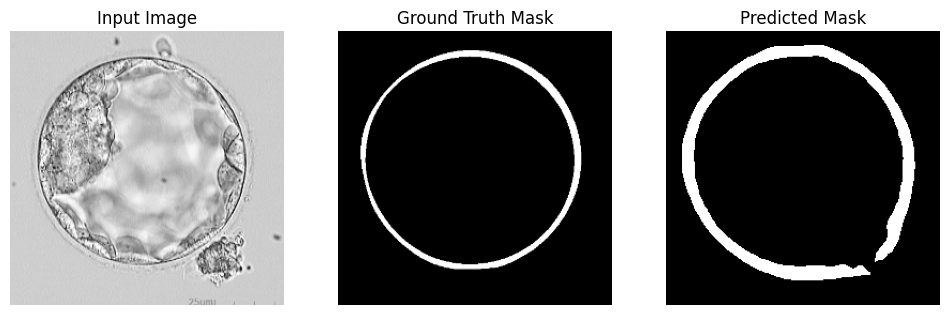

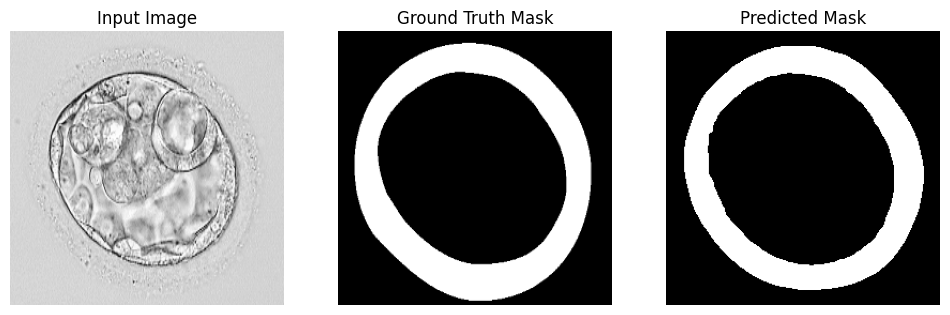

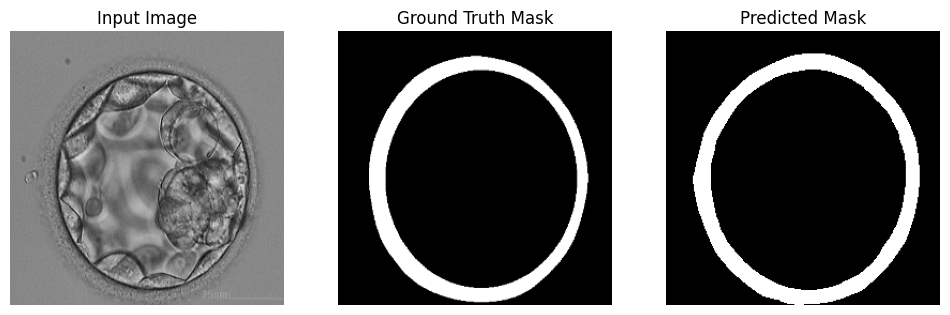

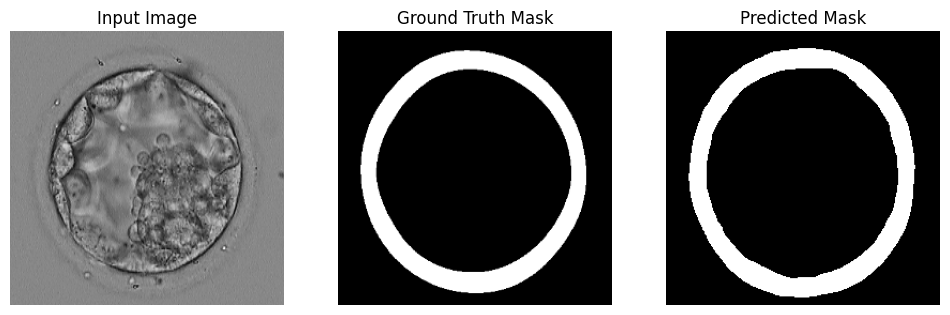

In [22]:
import matplotlib.pyplot as plt

def visualize_predictions(model, dataloader, device, num_samples=5, threshold=0.5):
    model.eval()
    images_shown = 0

    with torch.no_grad():
        for images, masks in dataloader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)

            for i in range(images.size(0)):
                if images_shown >= num_samples:
                    return

                image = images[i].cpu().numpy()
                image = image.transpose(1, 2, 0)
                gt_mask = masks[i].cpu().squeeze().numpy()
                pred_mask = preds[i].cpu().squeeze().numpy()

                # Threshold the predicted mask
                pred_mask_bin = (pred_mask > threshold).astype(np.uint8)

                # Plot
                plt.figure(figsize=(12, 4))

                plt.subplot(1, 3, 1)
                plt.imshow(image, cmap='gray')
                plt.title('Input Image')
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.imshow(gt_mask, cmap='gray')
                plt.title('Ground Truth Mask')
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.imshow(pred_mask_bin, cmap='gray')
                plt.title('Predicted Mask')
                plt.axis('off')

                plt.show()

                images_shown += 1

visualize_predictions(model, valid_loader, DEVICE, num_samples=5)

In [23]:
def evaluate_on_test(model, test_loader, device):
    model.eval()
    dice_scores = []
    miou_scores = []
    accuracy_scores = []
    sensitivity_scores = []
    specificity_scores = []

    with torch.no_grad():
        for images, masks in test_loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)

            dice_scores.append(dice_score(masks, preds).item())
            miou_scores.append(mean_iou(masks, preds).item())
            accuracy_scores.append(accuracy(masks, preds).item())
            sensitivity_scores.append(sensitivity(masks, preds).item())
            specificity_scores.append(specificity(masks, preds).item())

    print(f"\n🔍 Test Results:")
    print(f"Dice Score     = {np.mean(dice_scores):.4f}")
    print(f"mIoU           = {np.mean(miou_scores):.4f}")
    print(f"Accuracy       = {np.mean(accuracy_scores):.4f}")
    print(f"Sensitivity    = {np.mean(sensitivity_scores):.4f}")
    print(f"Specificity    = {np.mean(specificity_scores):.4f}")

evaluate_on_test(model, test_loader, DEVICE)


🔍 Test Results:
Dice Score     = 0.8758
mIoU           = 0.7815
Accuracy       = 0.9608
Sensitivity    = 0.8945
Specificity    = 0.9721


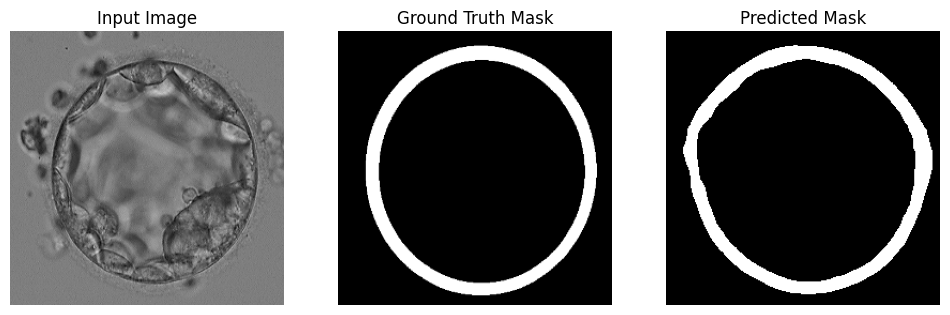

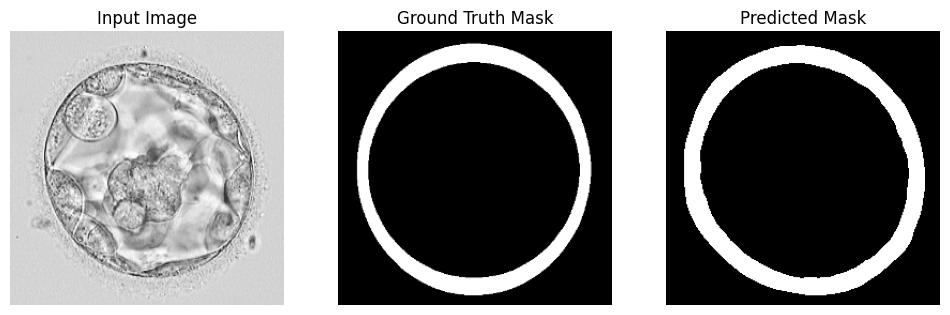

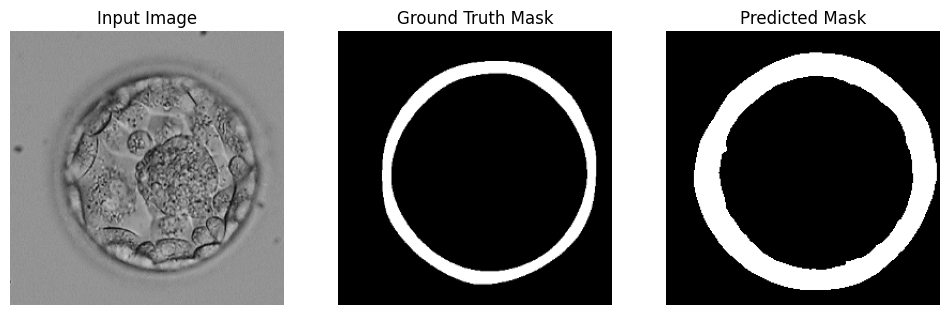

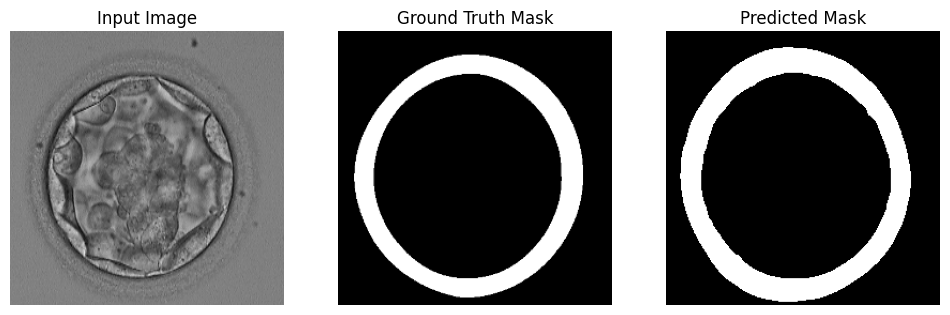

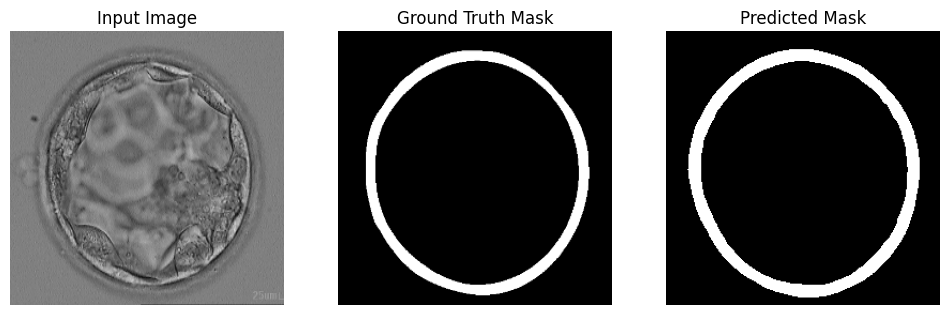

...

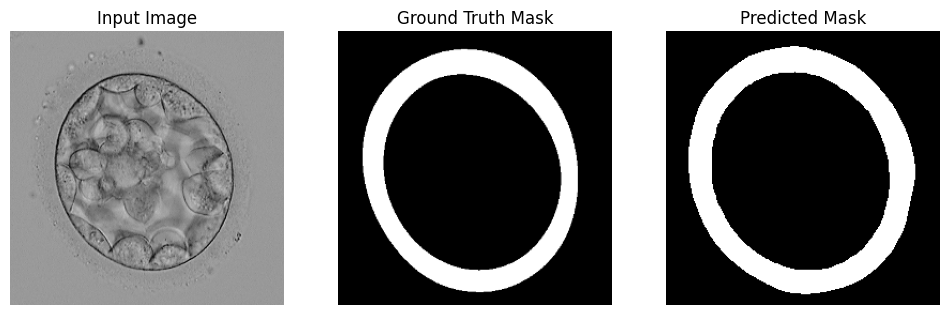

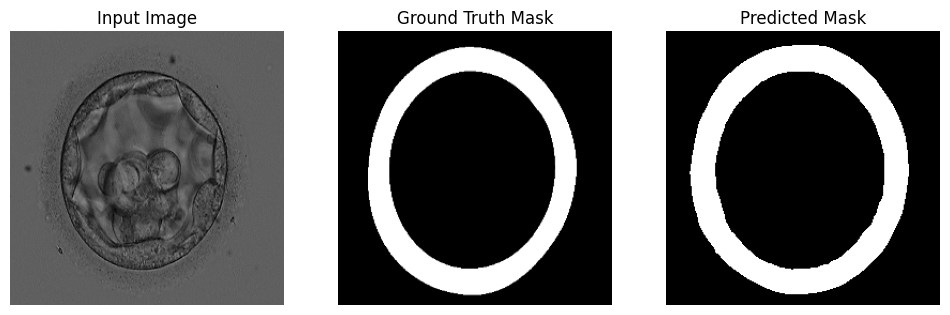

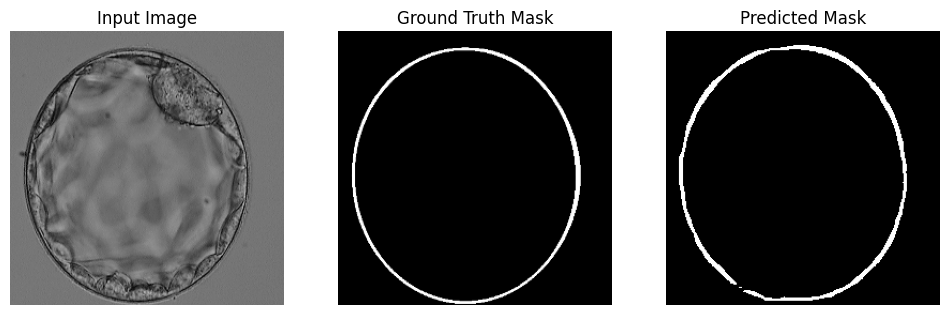

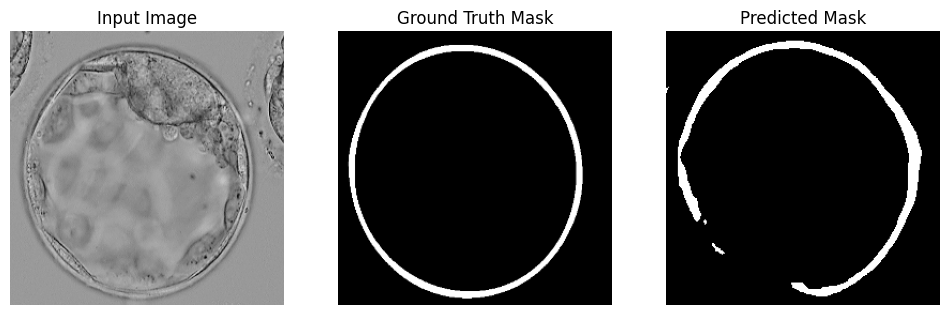

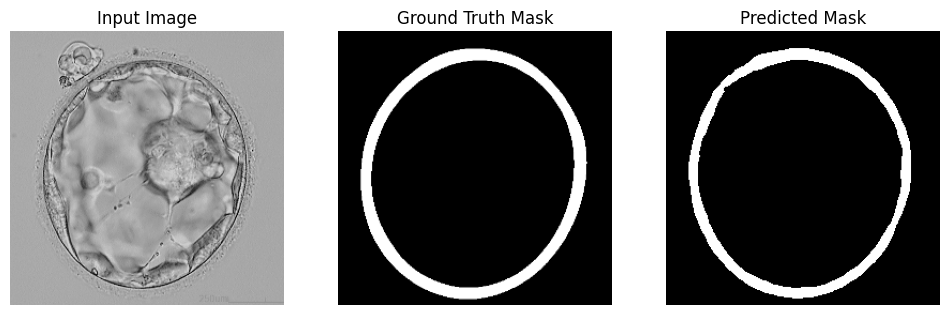

In [24]:
visualize_predictions(model, test_loader, DEVICE, num_samples=20)
